# <img style="float: center;" src='https://github.com/STScI-MIRI/MRS-ExampleNB/raw/main/assets/banner1.png' alt="stsci_logo" width="900px"/> 

<a id="title_ID"></a>
# MIRI MRS Data Reduction Notebook #

**Description**: This notebook is originally based on David Law Flight's notebook + 2 Patrick Kavanagh's notebooks (to take into account residual fringe correction), from which we added complementary steps, external to the official `jwst` pipeline, developed by members of the MINDS collaboration.
<br>
**MINDS Authors**: **Valentin Christiaens** (background subtraction, bad pixel correction, automatic source centroid identification, spectrum extraction, spike filtering), **Matthias Samland** (background subraction, multiprocessing, bad pixel correction fixes and improvements, restructure), **Danny Gasman** (aperture corrections, point source specific corrections (psff) + spectral leak correction), **Milou Temmink** (continuum subtraction), and **Giulia Perotti** (base version - merged David Law and Patrick Kavanagh's notebooks).
<br>
**Attribution**: This notebook is the result of significant efforts from MINDS authors. We released the code on ASCL. If it is useful to your research proper attribution is kindly appreciated: [Christiaens, Samland, Gasman, Temmink & Perotti (2024)](https://ui.adsabs.harvard.edu/abs/2024ascl.soft03007C/abstract).

Please also cite the following references:<br>
- [Gomez Gonzalez et al. (2017)](https://ui.adsabs.harvard.edu/abs/2017AJ....154....7G/abstract) and [Christiaens et al. (2023)](https://ui.adsabs.harvard.edu/abs/2023JOSS....8.4774C/abstract) for the VIP package, which is used to complement `jwst` pipeline steps for bad pixel correction, background subtraction and centroid finding;
- if relevant: [Gasman et al. (2023)](https://ui.adsabs.harvard.edu/abs/2023A%26A...673A.102G/abstract) for point-source specific calibrations (if you use the notebook with `psff=True`);
- if relevant: [Temmink et al. (2024)](https://ui.adsabs.harvard.edu/abs/2024A%26A...686A.117T/abstract) for continuum subtraction methods (if you use the notebook with `contsub=True`).

**Contact**: valentin.christiaens@uliege.be or samland@mpia.de
<br>
**Last Update**: 26 February 2025
<br>
**Compatible JWST Pipeline Versions**: >= 1.13.0 (tested by Valentin up to v1.17.1)

The purpose of this notebook is to provide a framework for batch processing of MIRI MRS data acquired as part of the MINDS project through all three pipeline stages. Input data for this notebook can be obtained by downloading the 'uncal' files from MAST and placing them in directories defined below. Data are assumed to be located in one or two observation folders (science, and background if available) according to paths set up below. 

<font color='white'>-</font> **General comments on the notebook:** <a class="anchor" id="det1"></a>                                       <div class="alert alert-block alert-warning"> To not clutter the notebook with additional custom-made routines for background subtraction, bad pixel correction, continuum subtraction, multiprocessing or spectrum extraction, these are collated in **5** separate modules: **utils_bkg.py**, **utils_bpc.py**, **utils_cs.py**, **utils_mp.py** and **utils_phot.py**, respectively. The routines either depend on the [VIP](https://vip.readthedocs.io/) package, or inspired of routines therein.
    
Final flux errors in output x1d files include **Poisson noise** (propagated from the official pipeline). In the case ``bkg_method`` is set to 'sdither', also includes **background noise** (through estimated background maps propagated to stage 3), combined in quadrature. These should still be considered as lower limits on the final uncertainties (which should consider other sources of uncertainty not yet propagated by the jwst pipeline). Background noise is estimated as the standard deviation of measured photometry in apertures of the same size as used for source spectrum extraction, but on the stage 3 spectral cubes corresponding to propagated background maps.
    
</div>

<font color='white'>-</font> **Comments on fringing:** <a class="anchor" id="det1"></a>                                       <div class="alert alert-block alert-warning"> As is common in IR detectors, effects in the MIRI MRS detectors results in the input signal being modulated as a function of wavelength, so-called 'fringing'. Two fringe components have been identified in MRS data, the primary fringe originating in the detector substrate (see Argyriou et. al, 2020 A&A, 641, 150) and a second high frequency, low amplitude fringe in channels 3 and 4, thought to originate in the MRS dichroics. 

The JWST calibration pipeline contains two steps to remove fringes from MRS data. These are the *fringe* step in Spec2Pipeline and the *residual_fringe* step which should be run before cube building at the level 3 stage. The *fringe* step divides the detector level data by a static fringe flat derived from an extended source for the primary fringe component only. However, this can leave residuals for either spatially unresolved sources or a source with spatial structure. These residuals are corrected for by the *residual_fringe* step on detector level data, which also attemps to correct for the dichroic fringe in channels 3 and 4.
</div>

<hr style="border:1px solid gray"> </hr>

**Table of contents**

* [0. Installation of dependencies](#0.-Installation-of-dependencies) 
* [1. Configuration of reduction parameters](#1.-Configuration-of-reduction-parameters)
* [2. Imports and setup](#2.-Imports-and-setup)    
* [3. Stage 1 processing](#3.-Stage-1-processing)
    - [3.1. **Det1 Pipeline**](#3.1.-Det1-Pipeline)
    - [3.2. Straylight correction](#3.2.-Straylight-correction)
    - [3.3. Background subtraction](#3.3.-Background-subtraction)
    - [~3.4. Optional bad pixel identification~](#3.4.-Bad-pixel-identification)
* [4. Stage 2](#4.-Stage-2)
    - [4.1. Spec2 Pipeline](#4.1.-Spec2-Pipeline)
    - [~4.2. Bad pixel correction~](#4.2.-Bad-pixel-correction)
* [5. Stage 3](#5.-Stage-3)
    - [5.1. Spec3 Pipeline](#5.1.-Spec3-Pipeline)
    - [~5.2. Optional bad pixel correction~](#5.2.-Optional-bad-pixel-correction)
    - [5.3. Spectrum extraction](#5.3.-Spectrum-extraction)
        - [5.3.1 **Centering**](#5.3.1.-Centering)
        - [5.3.2 **Residual background subtraction**](#5.3.2.-Residual-background-subtraction)
        - [5.3.3 Aperture photometry + spike filtering + aperture correction](#5.3.3.-Aperture-photometry-+-spike-filtering)
        - [5.3.4 Spectral leak fix in band 3A](#5.3.4.-Spectral-leak-fix-in-band-3A)
    - [5.4. Stitch and write results in final directory](#5.4.-Stitch-and-write-results-in-final-directory)
    - [5.5. Continuum subtraction](#5.5.-Continuum-subtraction) 
        - [5.5.1 At the spectrum level](#5.5.1.-At-the-spectrum-level)
        - [5.5.2 **At the image level**](#5.5.2.-At-the-image-level)
* [6. Plots](#6.-Plots)
    - [6.1. Plots with DataFrames](#6.1.-Plots-with-DataFrames)
    - [6.2. Comparison spectrum plots](#6.2.-Comparison-plots) 
    - [6.3. Final spectrum plot](#6.3.-Final-plot)
    - [6.4. Aperture image](#6.4.-Aperture-image)
    - [6.5. **Centroid locations and FWHM**](#6.5.-Centroid-locations-and-FWHM)
    - [6.6. **Continuum-subtracted line images**](#6.6.-Continuum-subtracted-line-images)

*Note: Bold face corresponds to changes or new additions compared to example notebook in MINDS v1.0.3* 

<hr style="border:1px solid gray"> </hr>

# 0. Installation of dependencies
------------------

Since this new pipeline makes use of custom-made tools besides the jwst pipeline, a couple of additional dependencies should be installed.
Running the following commands in your terminal *should* get you all set up:


<font color='white'>-</font> **Disclaimer (added by Valentin):** <a class="anchor" id="det1"></a>                                       <div class="alert alert-block alert-warning"> For safety, it is recommended to make a new conda environment for the MINDS pipeline, to not mess up an environment in which your jwst pipeline works flawlessly. The series of commands below in the provided order works on my machine, and *should* hopefully work on yours. 
</div>

`conda create -n minds_env python=3.11 ipython jupyter` (replace ``minds_env`` with the name you want for your conda environment)

`pip install git+https://github.com/VChristiaens/MINDS.git`

`pip install -U "ray[default]"`  (optional, better multiprocessing)

# 1. Configuration of reduction parameters
------------------

<div class="alert alert-block alert-danger"> 
    <b>Important: </b>
<a class="anchor" id="note1"></a>                                       
If you want to run this notebook in <b>multiprocessing</b>, it is recommended to run the following lines in your terminal <b>before</b> launching this jupyter notebook from the same terminal:

`export MKL_NUM_THREADS=1`

`export NUMEXPR_NUM_THREADS=1`

`export OMP_NUM_THREADS=1`

`export OPENBLAS_NUM_THREADS=1`
</div>

If it's your first time running the `jwst` pipeline, you may have to uncomment a few lines below:

In [1]:
import os
from os.path import join

# UNCOMMENT 4 lines below ONLY IF it is your first time running the JWST pipeline
# import pathlib
# ROOT_DIR = pathlib.Path('~/')
# os.environ["CRDS_PATH"] = str(ROOT_DIR / "crds_cache/")
# os.environ["CRDS_SERVER_URL"] = "https://jwst-crds.stsci.edu"

# set the jwst pipeline crds context (leave blank to use latest)
os.environ["CRDS_CONTEXT"] = "" # "jwst_1295.pmap" may be required for v1.16 of the pipeline - to avoid a "pastasoss" error message.
# note from Yannis: if the above does not work, try uncommenting the line below, which does the same thing:
# %env CRDS_CONTEXT jwst_1295.pmap

Let's import minds and check the version:

In [8]:
import minds
vminds = minds.__version__
vminds

'1.0.7.dev15+gd4125d7.d20250307'

Set **dataset-dependent** parameters in the next box.

In [2]:
source = 'PDS70'         # source name, only used in final output file names.
work_dir = '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/'  # Top level directory in which different subfolders containing intermediate products will be automatically created during reduction, corresponding to the different stages of the reduction.
work_dir_bg = None      # Top level directory for the BG observations, if any. This CANNOT be the same as workdir.

# 5 potential sets of values below: 
# 1) bkg_method = 'annulus'; bg_observation = False; dedicated_bg = False <- default recommendation if no dedicated BKG observation is available.
# 2) bkg_method = 'sdither'; bg_observation = False; dedicated_bg = False <- if your source is faint, no dedicated BKG observation is available, and you're interested in a potentially cleaner spectrum than default for the first 3CH or so (this doesn't work well in the 4th CH): 
# 3) bkg_method = 'ddither'; bg_observation = False; dedicated_bg = False <- if your source is faint, no dedicated BKG observation is available, and you'd like an even cleaner spectrum than above but AT THE EXPENSE of a slightly underestimated continuum level.
# 4) bkg_method = 'ddither'; bg_observation = True; dedicated_bg = True   <- default recommendation if dedicated BKG observations are available
# 5) bkg_method = 'ddither'; bg_observation = True; dedicated_bg = False  <- if a fainter source observations is to be used as BKG proxy.
bkg_method = 'annulus'  # {'sdither', 'ddither', 'annulus'} Method used for background subtraction. 'sdither' (median-filtered smoothed background of minimum of 4 dithers; default), 'ddither' (direct corresponding dither subtraction; needs a change of default apsize value from default), or 'annulus' (annular subtraction during aperture photometry)
bg_observation = False  # whether dedicated background observations or other reference observations are available to estimate the BKG. If True, these should be provided through the 'input_bgdir' parameter. If False, the pipeline will assume a dithering strategy was followed and will estimate the BKG from the dithered images themselves.
dedicated_bg = False    # [only relevant if bg_observation = True & bkg_method='ddither'] If provided, does the background proxy correspond to a dedicated (empty field) background [True], or to another reference (faint star) observation [False]?

In [3]:
%matplotlib inline
# change the above to %matplotlib widget if you prefer interactive plots

Set **machine-dependent** parameters in the next box.

In [4]:
# Single CPU processing or multi-threading -> leave below untouched 
# Multiprocessing -> uncomment 4 lines below, and adapt usage or maxp
# os.environ["MKL_NUM_THREADS"] = "1"
# os.environ["NUMEXPR_NUM_THREADS"] = "1"
# os.environ["OMP_NUM_THREADS"] = "1"
# os.environ["OPENBLAS_NUM_THREADS"] = "1"
# Note: the lines above set environmental variable preventing numpy from multithreading while multiprocessing (counter-productive!)
# Whether the lines above work from within the notebook may depend on your machine (fine on Mac).
usage = None    # Usage of multi-CPUs: {None, 'quarter', 'half', 'all'}. Takes precedence over maxp.
if usage is None:
    maxp = 1      # [if 'usage' is None] Set the exact number of CPUs to use.

Set **continuum-subtraction** dependent parameters in the next box (to check for extended emission in images).

In [5]:
# Continuum subtraction parameters  below are first used in Sec 5.5
nch_line = 18 # or 20       # number of channels to consider for line width + some surrounding buffer channels (continuum will be estimated beyond nch_line/2 from line center)
nch_med = 10                # [should be even] number of channels to consider for a median continuum estimate. Half will be at shorter (resp. longer) wavelength if possible.

# Example set of HI lines (comment/uncomment as needed)
# test_lines = [5.1286575, 5.9082134, 5.9568435, 6.291916, 6.7719906, 
#               7.4598577, 7.5024932, 7.5081049, 8.7600642, 9.3920177, 
#               10.503499, 11.308695, 12.371898, 12.387168, 14.183084,
#               19.061898]   # Wavelength of lines of interest for which figures of continuum-subtracted images will be saved.
# test_labels = ['HI_10-6', 'HI_9-6', 'HI_14-7','HI_13-7','HI_12-7', 
#                'HI_6-5', 'HI_8-6', 'HI_11-7', 'HI_10-7', 'HI_13-8', 
#                'HI_12-8', 'HI_9-7', 'HI_7-6', 'HI_11-8', 'HI_13-9',
#                'HI_8-7'] # Name of the lines of interest for which figures of continuum-subtracted images will be saved.

# Set of H2 S(n) lines, with n=1-8, + jet tracers
test_lines = [5.05306, 5.5118, 5.8933, 6.10856, 6.636, 
              6.721283, 6.90951, 6.985274, 8.02504, 9.66491,
              10.6822, 12.2786, 12.7288, 12.814, 17.0348] # Wavelength of lines of interest for which figures of continuum-subtracted images will be saved.
test_labels = ['H2_S(8)', 'H2_S(7)', '[NiII]', 'H2_S(6)', '[NiII]', 
               '[FeII]', 'H2_S(5)', '[ArII]', 'H2_S(4)', 'H2_S(3)',
               '[NiII]', 'H2_S(2)', '[NiII]', '[NeII]', 'H2_S(1)'] # Name of the lines of interest for which figures of continuum-subtracted images will be saved.

More parameters can be set in the following cell, but can be left as default as a first try:

<div class="alert alert-block alert-info"> 
    <b>Note: </b>
<a class="anchor" id="note1"></a>

If you wish to start the reduction from rate files instead of uncal files:

- set in the next cell `det1_dir_ori` to the path where you placed your rate files (example in comment);
- set `overwrite_31 = False` (to avoid the step running Stage 1 to get you rate files from uncal files).
</div>

In [7]:
# directories
input_dir = join(work_dir,'stage0/') # Where you placed the downloaded uncalibrated FITS files (for the science observation). Important: only science fits files should be placed in that folder (i.e. no background nor other observations)! Note: you can run the pipeline starting from rate files, by placing them in a directory defined with 'det1_dir_ori' 3 cells below - in which case the definition of input_dir is not used.
output_dir = work_dir    # Where subdirectories corresponding to other processing stages will be created.
if work_dir_bg is not None:
    input_bgdir = join(work_dir_bg,'stage0/') # Where you placed the downloaded uncalibrated FITS files (for the science observation). Important: only science fits files should be placed in that folder (i.e. no background nor other observations)! Note: you can run the pipeline starting from rate files, by placing them in a directory defined with 'det1_dir_ori' 3 cells below - in which case the definition of input_dir is not used.
    output_bgdir = work_dir_bg    # Where subdirectories corresponding to other processing stages will be created.
else:
    input_bgdir = ''         # Where the uncalibrated FITS files (for the background observation) are located.  If no background observation, leave this blank. 
    output_bgdir = ''        # Where the output background observations should go.                              If no background observation, leave this blank
final_outdir = join(output_dir, 'final_outputs/')  # Where final outputs will be located (cubes & spectra)
det1_dir_ori = None #join(output_dir, 'stage1_MINDSv1.0.6/')   # e.g.: join(output_dir, 'stage1{}/'.format('_MINDSv1.0.2')) #If you ALREADY have rate files, and want to skip running Detector1 stage, which is a bit tedious, just provide the path to your rate files here, and set overwrite_31=False below - this would then skip Detector1 step and consider the rate files in the folder provided here.
det1_bgdir_ori = None  # e.g.: join(output_bgdir, 'stage1{}/'.format('_MINDSv1.0.6'))  #If you ALREADY have rate files for your background observation, and want to skip running Detector1 stage, which is a bit tedious, just provide the path to your rate files here, and set overwrite_31=False below - this would then skip Detector1 step and consider the rate files in the folder provided here.

# Whether or not to run a given pipeline stage, and overwrite its products?
do_sec3 = True # Det1 Pipeline Stage & associated steps
overwrite_31=True # Overwrite output of section 3.1? False will skip section 3.1 if outputs already exist, otherwise will run it - as long as do_sec3 is True
overwrite_32=True # Overwrite output of section 3.1? False will skip section 3.2 if outputs already exist, otherwise will run it - as long as do_sec3 is True
overwrite_33=True # Overwrite output of section 3.1? False will skip section 3.3 if outputs already exist, otherwise will run it - as long as do_sec3 is Truenoddin
overwrite_34=True # Overwrite output of section 3.1? False will skip section 3.4 if outputs already exist, otherwise will run it - as long as do_sec3 is True
do_sec4 = True # Spec2 Pipeline Stage & associated steps
overwrite_41=True # Overwrite output of section 4.1? False will skip section 4.1 if outputs already exist, otherwise will run it - as long as do_sec4 is True
overwrite_42=True # Overwrite output of section 4.2? False will skip section 4.2 if outputs already exist, otherwise will run it - as long as do_sec4 is True
do_sec5 = True # Spec3 Pipeline Stage & associated steps
overwrite_51=True # Overwrite output of section 5.1? False will skip section 5.1 if outputs already exist, otherwise will run it - as long as do_sec5 is True
overwrite_52=True # Overwrite output of section 5.2? False will skip section 5.2 if outputs already exist, otherwise will run it - as long as do_sec5 is True
overwrite_53=True # Overwrite output of section 5.3? False will skip section 5.3 if outputs already exist, otherwise will run it - as long as do_sec5 is True
# note: there is no overwrite_54, as Sec. 5.4 on corresponds to the last part of the notebook with low amount of data processing involved, it is thus always True by default.

# Background subtraction - params below are first used in Sec 3.3
subtract_residual_bkg = True  # whether to subtract residual background level estimated in an annulus before writing the final s3d cubes. This does not affect spectrum extraction by 'annulus' but can be useful before continuum subtraction and identification of extended signals for relative narrow spectral features (spanning at most 10ch).
perc_rbg = 20           # percentile to consider as background in the annulus used for residual background subtraction
smooth_bkg = True       # Whether the residual background level is smoothed in wavelength before subtraction. By default, smoothing is done with an order 1 Savitzky-Goaly filter with a window of 51 channels.
rm_persist = False      # [if bkg_method = 'sdither'] Whether to correct for detector persistence effects during background subtraction. Note: this is a very simplistic approach, but can help reduce the effect of persistence if looking for extended signals - as there is currently no method in the official pipeline to deal with it (as of 1.11)

# Suffix
ver = '_MINDSv{}'.format(vminds[:5])  # suffix you'd like to add to output directories to better identify your different reductions, by default: MINDS version (main part)
if bkg_method != 'annulus': # add the selected background subtraction method to suffix when not the default one
    ver += '_{}'.format(bkg_method)
print(ver)

# Centering
cen_method = None         # {None, 'cc', 'gauss'} Method for alignment of spectral frames before aperture photometry. None for no realignment (just takes median centroid position in each cube), 'cc' for cross-correlation based realignement, 'gauss' for 2D Gaussian fit.

# Spectrum extraction + spike filtering - params below are first used in Sec 5.3
do_leak_correction = True # whether to correct the leak at 12µm, regardless of psff=True.
apsize = 2.0              # Float setting the size of the aperture in FWHM. [if psff=False] Can take any value. [If psff=True] Can only take value in {1.5, 2.0, 2.5, 3.0, 3.5} (recommended: 2.0). 
if bkg_method == 'ddither' and not (bg_observation and dedicated_bg):
    apsize = 1.5          # force aperture to be smaller in case of direct-dither subtraction (to minimize self-subtraction)
## Extract1d parameters
autocen = False           # [only used if psff=False]: whether [True] to use the 'autocen' feature of the pipeline, or [False] the centroid inferred in a weighted average frame for each band, where weights are proportional to the integrated flux (i.e., robust to faint sources)
overwrite_target_classification = True  # [only used if psff=False] Whether to overwrite target classification in header. This will influence the behaviour of default extract1d routine (which is activated if psff=False) at the moment of extracting the spectrum: for an extended source, all spaxels are integrated, while for a point source, only spaxels in a small aperture are used.
new_sourcetype = 'POINT'  # {'POINT','EXTENDED'} [if overwrite_target_classification=True] The new source type, if target classification is requested to change.

# Operations on spectra - params below are first used in Sec 5.4
do_rfc1d = True          # whether to consider residual fringe correction at the spectrum level. RFC is NOT recommeded if psff is True, as it shouldn't be necessary and may suppress molecular features. BUT in some cases (e.g. at least for PDS 70) this is useful to remove residual fringe effects.
do_rfc1d_bef_leak = True # [do_leak_correction=True & do_rfc1d=True] If both leak correction and do_rfc1d are requested, whether to do_rfc1d first (as in the official pipeline), or the opposite (False). In some cases, the opposite order can lead to a lower residual bump.
nch_cut_per_band = "no overlap - cut blue ends" # {None, "no overlap - cut blue ends", "no overlap - cut red ends", int, list of int, or list of tuples of int}. Determine how to cut the channels at the edge of each band.
    # None or 0 -> no removal of spectral channels at the blue and red ends of each band.
    # "no overlap - cut blue ends": Removes exact number of spectral channels at the blue end of each band (starting with the 2nd one) to avoid any overlap with the red end of the previous band
    # "no overlap - cut red ends": Removes exact number of spectral channels at the red end of each band (except the last one) to avoid any overlap with the blue end of the subsequent band
    # int: same number of channels to be removed at both the blue and red ends of all bands.
    # list of 12 int: Respective number of channels to remove at both the blue and red ends of each band 
    # list of 12 tuples of 2 int: Number of channels to remove at the blue and red end (tuples), respectively, of each band (list).
correct_jumps = None # Whether and how to correct for jumps between bands.
# if the above is not satisfactory, set: do_rfc1d = True and correct_jumps = 'occam' (or 'scale_only')
#correct_jumps arguments: {'scale_only', 'occam', None}
    # 'scale_only': allows scaling of bands such that their shortward section have a similar level as the overlapping longward section of previous band above;
    # 'occam': either (i) 'scale_only' above, or (ii) correct for slope of the band to match neighbouring band levels. Default behaviour is (i) EXCEPT if this leads to all subsequent bands to require a similar scaling (e.g. third band requires 1.10 factor to match second band, BUT all subsequent bands also require ~1.10 factor => Occam Razor: it's more likely that the slope of third band is wrong, while all subsequent bands could be well calibrated).
    # None: no correction for jumps
    
# Continuum subtraction (spectrum level) - params below are first used in Sec 5.5
contsub = True              # Whether to also save a continuum-subtracted version of the spectrum.
mask_12mu_feature = True    # Whether to mask a feature between 12.118µm and 12.132µm when estimating the continuum. If True, this region of the spectrum is interpolated for continuum estimation.

## Dictionary of parameters used in the Baseline function used to estimate the continuum:
bl_params = {'WL' : 100, # window length
             'NKf' : 75, # frequency of knots for all bands but Ch.4, such that input number of knots: NK = len(band)/NKf
             'NKf_ch4' : 25, # frequency of knots for Ch.4, such that input number of knots: NK = len(band)/NKf
             'Quant' : 0.05, # quantile used to estimate where the continuum is located
             'Quant_ch4' : 0.1, # quantile used to estimate where the continuum is located, in Ch. 4
             'IP_ch4' : False, # if NKf_ch4 != NKf: whether to smooth the estimated continuum between CH3 and CH4. If False can lead to a jump, but if True can lead to poorer continuum estimate near the transition between CH3 and CH4.
             'SD' : 3, # spline_degree
             'DO' : 3, # diff_order
             'MI' : 9999, # max iter
             'Lam' : 1e2, # lam
             'Tol' : 1e-9, # tolerance
             'sigma_clip' : (3,4), # upper and lower sigma clip thresholds. By default, outliers are clipped at +2sigma and -3sigma. 
             'W_max_out' : 27.8}  # max wavelength beyond which the spectrum is discarded for the calculation of STD enabling the identification of outliers.

# PLOTS - params below are always used (i.e. used in Sec. 6 which is always run)
show_plots = True # whether to show all plots
interactive_plots = True # whether to make the plots interactive
wl_min=4.5        # min wavelength for plots (sec 6.2. and later)
wl_max=27.        # max wavelength for plots (sec 6.2. and later)
DN_count_file = None # Path+filename of an optional csv file which compiles the max. DN count measured in each band for different sources. Will add a row to that table. Such table can be useful to know which observations to use for reference star differential imaging PSF subtraction, since the BFE depends on the max DN count.
spitzer_file = None  # join(work_dir,"PDS_70_-IRS_combined_spectrum_v2.tbl") # Path+filename of Spitzer spectrum. Assumes it is parsable by pandas.read_csv, and contains columns labelled "lambda" and "Flux"
photom_file = None   # join(work_dir,"photom_pds70.txt")  # Path+filename of additional photometry points for comparison. Default: should be parsable with pandas.read_csv, with 4 columns (wavelength, flux (Jy), flux error, instrument name)
compare_spec = True          # whether to also plot other spectra obtained with different reduction parameters (i.e. present in the same output folder).
make_aperture_image = False   # whether to create a figure showing the aperture size with respect to a spectral image at a given wavelength.
make_contsub_images = True       # Whether to also produce continuum-subtracted spectral cubes
make_centroid_and_fwhm_plots = True # whether to make plot showing centroid shifts and FWHM of fitted 2D gaussians.

_MINDSv1.0.7


In [7]:
# ==================================================
# Import some packages and set multiprocessing.
# DO NOT TOUCH

import multiprocessing
import numpy as np
import sys, pdb
import matplotlib

num_cores = multiprocessing.cpu_count()
print('number of cores', num_cores)
if usage == 'quarter':
    maxp = num_cores // 4 or 1
elif usage == 'half':
    maxp = num_cores // 2 or 1
elif usage == 'all':
    maxp = num_cores
    
print('We will use '+str(maxp)+' CPUs in this run')

number of cores 10
We will use 1 CPUs in this run


Additional parameters that can be adapted - although tests so far suggest it is unlikely you'll need to change their value: 

In [8]:
# Det1Pipeline parameters to exclude more frames in the beginning, which may lead to less striping, but depends on number of groups available.
mask_ramps = False # whether to mask some ramps
N_first = 3 # [if mask_ramps=True] This controls if you want to exclude more than the first frame from the ramp fit.
N_last = 1  # [if mask_ramps=True]  This controls if you want to exclude more than the last frame from the ramp fit.
use_agg_det1_params = False # Whether to use more aggressive Det1 parameters to flag cosmic rays - as suggested during data reduction meeting of 27/10/2022. Disclaimer: not well tested. Note: all else equal, does not lead to significant differences in final spectra of PDS 70. So left as False (i.e. default).

# Bad pixel correction/flagging
do_bpc1 = False           # Whether to also flag bad pixels between stages 1 and 2. If False, only performed after stage 2. Note: it is easier to capture more bad pixels before stage 2, but some warm pixels may be corrected after flat division during stage 2.
do_bpc2 = False           # Whether to identify and correct bad pixels using pixel_replace step during stage 2.
do_bpc3 = False           # Whether to identify and correct bad pixels after stage 3.
sig_bpc = 5               # Sigma considered for clipping and correcting bad pixels.
nit_bp = 3                # Number of bad pixel identification iterations.
flag_only_bef3 = False    # Whether to flag only (modifying DQ map) additional bad pixels identified before stage 3
sig_star_res_in_bkg = 3.  # [only if bkg_method = 'sdither']: number of standard deviations away from the median to identify residual star signals in proxy BKG map - these residual star signals are then interpolated with a Gaussian kernel. Safer to consider a low threshold to avoid any residual star signals in BKG map proxy.
pixel_replace_algo_spec2 = 'mingrad' # {'fit_profile', 'mingrad'} Algorithm used in PipelineStep pixel_replace in Spec2.
pixel_replace_algo_spec3 = 'fit_profile' # {'fit_profile', 'mingrad'} Algorithm used in PipelineStep pixel_replace in Spec3. Tests on PDS 70 and CHA-HA-1 suggest that this choice can either improve (PDS 70) or decrease (CHA-HA-1) the quality of the spectrum. For PDS70: both led to an improvement (less spikes), for CHA-HA-1: only 'mingrad' led to a slight improvement, while 'fit_profile' had counterproductive effect of causing more spikes.
skip_pixel_replace_spec2 = False  # Whether to skip pixel replace step in Spec2. Tests on PDS 70 and CHA-HA-1 suggest that it can improve the quality of the spectrum.
skip_pixel_replace_spec3 = False  # Whether to skip pixel replace step in Spec3. Tests on PDS 70 and CHA-HA-1 suggest that it can improve the quality of the spectrum.

# background subtraction
persist_frac = 1./100       # [only if bkg_method = 'sdither' and rm_persist = True]: Residual persistence factor used for correction.
nit_bg = 3                  # Maximum number of iterations for PSF and BKG estimations during clean background subtraction step.
r_min_res_bg_sub = 12*[3]   # 11*[4]+[3]  # [only if subtract_residual_bkg=True] Radius in FWHM beyond which the residual background level is estimated for each band (the field of view for CH4C is too small and max radius is ~3 FWHM).
bkg_hpf_kersz = (5, 41)     # Size of moving nan-median filter window to filter background estimate. ~41 pixels is roughly the horizontal period of vertical slices. small vertical extent to reproduce effects of residual dark current 
perc_bkg_level = 50         # percentile used in each (moving) cell of filter to identify background level in first BKG estimate image. 50 for median of good pixels (i.e. outliers such as residual PSF intensities are flagged as NaN)

# Point source optimized reference files - param below are first used in Sec 4.1
psff = False    # [KEEP AS FALSE - NOT USABLE FOR NOW as appropriate time correction of photometry is missing] Run point source optimized reduction using Danny's reference files?  # Only applicable for point sources and observations where target acquisition was ON. (Needs re-running the notebooks at least from Sec. 4.1 to test it) 

# Spec3 options (params below first used in Sec 5.1)
skip_outlier_det_s3 = False  # Whether to skip outlier detection step in stage 3
dith_combi_method = 'drizzle'   # {'drizzle', 'emsm', 'msm'}. Method to combine different dithers in cube building.

# Centering
discard_band_cen=None   # List of bands to be discarded for centering (i.e. the ones where the object is too faint to be seen in the mean spectral frame). E.g. ['2A','3B','4C']. None does not discard any.
imlib='ndimage-interp'  # Image library for sub-px shift operations. 'opencv' to use a Lanczos4 interpolation kernel (fastest), 'ndimage-interp' for a biquintic interpolation kernel (trade-off speed vs accuracy), 'vip-fft' to use a FT-based method (best preservation of flux but prone to Gibbs artefacts due to poor spatial sampling).
crop_sz = 7             # Sub-image crop size used i) to look for a local maximum at the center of weighted mean band image, ii) then to fit a 2D Gaussian model to find the star centroid in a sub-frame centered on the local maximum. In other words, the crop_sz should be set to at least double the expected difference between star center and actual image center, but would benefit from being as small as possible (to avoid high noise level at frame edges) ##crop_szs = [13,11,11,9] # Sub-image crop sizes (one per band) used when fitting a 2D Gaussian model to find the star centroid.

# Spectrum extraction + spike filtering
if psff:
    apcorr = 'FWHM'     # Aperture correction mode. 'FWHM': Aperture correction associated to apertures proportional to FWHM (default: 2.5FWHM).
else:
    apcorr = 'ex1d'     # Aperture correction mode. 'ex1d': using extract1d + default aperture corrections, respectively.
sp_corr_win = 15        # Odd integer corresponding to spectral window used to identify spikes. E.g. 5 means it will look at the flux in the 2 channels on each side of each channel to identify outliers.
spec_mode = 'per_band'  # {'per_band', 'per_channel'} whether to consider step 3 spectrum to be extracted per band or per channel [per band is better for final spectrum-level residual fringe correction]
thr_occam = 0.05        # estimated relative uncertainty on the overall photometric calibration of each band - this information is used to judge whether flux rescaling or slope correction is better to correct for a potential jump between consecutive bands (e.g. if set to 0.05, rescaling factors between 0.95 and 1.05 can be expected, and won't trigger a slope correction)
## spike filtering parameters [only if psff = True]
spike_filtering = False   # Whether to correct for residual spikes after stage 3, when extracting spectrum. Can be a single boolean or a list of 12 booleans (1 for each band). The spectrum of spaxels included in the aperture photometry are checked successively and outliers occurring on single spaxels are corrected. This spike filtering can help reduce spikes, but beware that "spike-like" real spectral features may be erroneously identified as outliers.
sp_sig = 5                # [if spike_filtering = True] Sigma used to identify spikes by sigma filtering of individual spaxel spectra in the aperture photometry aperture. Can be a single float/int or a list of 12 floats/ints.
max_nspax = 2             # [if spike_filtering = True] Max. number of spaxels identified as spectral outliers (with sp_sig criterion) for a given spaxel at a given wavelength to be considered a spike. The idea is that spikes should occur locally, and not on several spaxels - in the latter case it is more likely an authentic spectral feature. 
neg_only = True           # [if spike_filtering = True] Whether to correct only negative spikes with the spike filtering algorithm.

Output subdirectories to keep science data products organized:

In [9]:
det1_dir = join(output_dir, 'stage1{}/'.format(ver))   # Detector1 pipeline outputs will go here
spec2_dir = join(output_dir, 'stage2{}/'.format(ver))  # Spec2 pipeline outputs will go here
spec3_dir = join(output_dir, 'stage3{}/'.format(ver))  # Spec3 pipeline outputs will go here
fin3_dir = join(final_outdir, 'stage3{}/'.format(ver)) # Final Spec3 pipeline outputs will go here (final cubes and spectra)
figs_dir = join(final_outdir, 'figures/') # whether the figures will be save
fig_dir = join(final_outdir, 'Extended_emission_diagnostics{}/'.format(ver)) # figures for extended emission diagnostics

**Do not touch anything below in this notebook - except if you know what you're doing**

In [10]:
import minds

# We need to check that the desired output directories exist, and if not create them
if not os.path.exists(det1_dir):
    os.makedirs(det1_dir)
if det1_dir_ori is None:
    det1_dir_ori = det1_dir
if det1_bgdir_ori is None:
    det1_bgdir_ori = det1_dir
if not os.path.exists(spec2_dir):
    os.makedirs(spec2_dir)
if not os.path.exists(spec3_dir):
    os.makedirs(spec3_dir)
if not os.path.exists(fin3_dir):
    os.makedirs(fin3_dir)
if not os.path.exists(figs_dir):
    os.makedirs(figs_dir)
if not os.path.exists(fig_dir):
    os.makedirs(fig_dir)

# Don't change these
firstframe_skip = False
lastframe_skip = False
rscd_skip = False
    
# psff-related files
psff_dir='./psff_ref/'
phot_ver='9B.04.19'
fringe_ver='2'

# format nch_bad_per_band
if nch_cut_per_band is None:
    nch_bad_per_band = [(0,0)]*12
elif type(nch_cut_per_band) == str:
    nch_bad_per_band = None
elif np.isscalar(nch_cut_per_band):
    nch_bad_per_band = [(nch_cut_per_band,nch_cut_per_band)]*12
elif len(nch_cut_per_band) != 12:
    raise ValueError("nch_cut_per_band should have length 12 if not scalar")
else:
    nch_bad_per_band = nch_cut_per_band
    for i in range(12):
        if np.isscalar(nch_cut_per_band[i]):
            nch_bad_per_band[i] = (nch_bad_per_band[i], nch_bad_per_band[i])

#distortion_dir='./distortion_solution/'
# 

# Format of aperture correction factor files, and allowed aperture list
apcorr_fn = os.path.join(minds.__path__[0], "apcorr_factors_ap1.5-3.5FWHM{}_smooth.fits")  # filename for aperture correction factors
list_aps = [1.5, 2.0, 2.5, 3.0, 3.5]  # list of authorized aperture sizes (in FWHM)

<hr style="border:1px solid gray"> </hr>

# 2. Imports and setup
------------------

In [11]:
# Now let's use the entire available screen width for the notebook
from IPython.display import display, HTML
display(HTML("<style>.container { width:95% !important; }</style>"))

In [12]:
from os.path import isdir, isfile, splitext, basename, split, dirname

In [13]:
# Basic system utilities for interacting with files
import glob
import time

# Astropy utilities for opening FITS and ASCII files
from astropy.io import fits
# Astropy utilities for making plots
from astropy.visualization import (LinearStretch, LogStretch, ImageNormalize, ZScaleInterval)
from matplotlib.colors import LogNorm

# Matplotlib for making plots
import matplotlib.pyplot as plt

# Photutils for aperture photometry
import pickle

from scipy.interpolate import interp1d as I1D

In [1]:
# Import the base JWST package
import jwst
from packaging import version
vjwst = jwst.__version__
print("JWST pipeline version: ", vjwst)

if version.parse(vjwst) < version.parse("1.13.0"):
    raise ValueError("Please update JWST package to a version larger or equal than 1.13.0")

JWST pipeline version:  1.16.1


In [15]:
# check the pmap version is > 1094, when not default
if os.environ["CRDS_CONTEXT"]:
    if int(os.environ["CRDS_CONTEXT"][-9:-5])<1095:
        raise ValueError("Please use a pmap version larger or equal than 1095")

In [16]:
# JWST pipelines (encompassing many steps)
from jwst.pipeline import Detector1Pipeline
from jwst.pipeline import Spec2Pipeline
from jwst.pipeline import Spec3Pipeline

# JWST pipeline utilities
from stdatamodels.jwst import datamodels
from stdatamodels.jwst.datamodels import dqflags
from jwst.associations import asn_from_list as afl # Tools for creating association files
from jwst.associations.lib.rules_level3_base import DMS_Level3_Base # Definition of a Lvl3 association file
from jwst.datamodels import ModelContainer
from jwst.residual_fringe import ResidualFringeStep
from jwst.extract_1d import Extract1dStep
from jwst.spectral_leak import SpectralLeakStep, spectral_leak

In [17]:
# Additional utilities besides jwst pipeline
from minds.bkg import read_file_info, detector_background_subtraction, clean_background_subtraction, res_bkg_sub
from minds.bpc import bpix_corr2d, bpix_corr3d, bpc2
if contsub:
    from minds.cs import Baseline, PureBaseline, PlotSpectrum
from minds.mp import runmany, add_dq, rundet1, run_straylight, runspec2
from minds.phot import (recenter_cubes, extract_ap, find_nearest, write_x1d, spike_filter, 
                            calc_scal_fac, identify_scalefac_vs_bending, bend_spectrum)
import vip_hci
from vip_hci.fits import open_fits, write_fits
from vip_hci.preproc import frame_fix_badpix_isolated, frame_crop
from vip_hci.var import frame_center
vvip = vip_hci.__version__
print("VIP version: ", vvip)
if version.parse(vvip) < version.parse("1.4.0"):
    raise ValueError("Please update vip_hci package to a version larger or equal than 1.4.0")

from functools import partial
import pandas as pd
from scipy.interpolate import UnivariateSpline, interp1d

columns = ['FILENAME', 'CHANNEL', 'BAND', 'VISIT', 'EXPCOUNT', 'EXPOSURE', 'PATT_NUM',
           'EFFINTTM', 'EFFEXPTM', 'DATE-BEG', 'DATE-END']

VIP version:  1.6.5


In [18]:
# Output subdirectories to keep background data products organized
if bg_observation:
    det1_bgdir = join(output_bgdir, 'stage1{}/'.format(ver)) # Detector1 pipeline outputs will go here
    spec2_bgdir = join(output_bgdir, 'stage2{}/'.format(ver)) # Detector1 pipeline outputs will go here
    # We need to check that the desired output directories exist, and if not create them
    if not os.path.exists(det1_bgdir):
        os.makedirs(det1_bgdir)
    if not os.path.exists(spec2_bgdir):
        os.makedirs(spec2_bgdir)
else:
    dodet1bg = False
    det1_bgdir = None
    spec2_bgdir = None

In [19]:
# Start a timer to keep track of runtime
time0 = time.perf_counter()

### 2.1. Define notebook-wise utility functions

In [20]:
# Define a function to check existing outputs (useful for overwrite parameter)
def check_output_exist(input_paths, output_dir, input_ending='uncal.fits', output_ending='rate.fits'):
    exists = []
    output_paths = [os.path.join(output_dir, os.path.basename(x).replace(input_ending, output_ending)) for x in input_paths]
    for out_path in output_paths:
        exists.append(isfile(out_path))
    exists = np.array(exists)
    return exists, output_paths

In [21]:
def convert_band_to_idx(band):
    # note the index order is alphabetical, to match the order of calfiles list (i.e. not in increasing wavelength order of the bands)
    idx = int((int(band[0])-1)*3)
    if band[1] == 'B':
        idx += 1
    elif band[1] == 'C':
        idx += 2
    return idx

In [22]:
def sort_files_wl(files):
    """Utility to sort files by wavelength (i.e. not alphabetically for bands spectra)"""
    files.sort()
    sorted_files = []
    for ff, fi in enumerate(files):
        if ff%3 == 1 or ff%3 == 2:
            sorted_files.insert(len(sorted_files)-ff%3, fi)
        else:
            sorted_files.append(fi)
    return sorted_files    

<hr style="border:1px solid gray"> </hr>

# 3. Stage 1 processing
------------------

## 3.1. Det1 Pipeline
------------------


<div class="alert alert-block alert-warning">
In this section we process our simulated data through the Detector1 pipeline to create Lvl2a data products (i.e., uncalibrated slope images).
See https://jwst-pipeline.readthedocs.io/en/latest/jwst/pipeline/calwebb_detector1.html
</div>

In [23]:
def mask_ramp(fnames, N_first=1, N_last=1):
    for fname in fnames:
        with datamodels.open(fname) as input_model:
            sci_ngroups = input_model.data.shape[1]
            print(input_model.data.shape)
            # Create output as a copy of the input science data model
            output = input_model.copy()

            # Update the step status, and if ngroups > 3, set all of the GROUPDQ in
            # the first group to 'DO_NOT_USE'
            if sci_ngroups > (N_first + N_last + 1):
                output.groupdq[:, :N_first, :, :] = \
                    np.bitwise_or(output.groupdq[:, :N_first, :, :], dqflags.group['DO_NOT_USE'])
                output.groupdq[:, (sci_ngroups - N_last):, :, :] = \
                    np.bitwise_or(
                        output.groupdq[:, (sci_ngroups - N_last):, :, :], dqflags.group['DO_NOT_USE'])
            else:   # too few groups
                print("Too few groups to apply correction")
            output.save(fname.replace("dq.fits", "masked.fits"))

In [24]:
# Now let's look for input files of the form *uncal.fits for the science observation
if do_sec3 and mask_ramps:
    sstring = os.path.join(input_dir, 'jw*mirifu*uncal.fits')
    lvl1b_files = sorted(glob.glob(sstring))
    print('Found ' + str(len(lvl1b_files)) + ' files to process')

    # check existing files
    if not overwrite_31:
        exists, output_paths = check_output_exist(input_paths=lvl1b_files, output_dir=det1_dir_ori, 
                                                  input_ending='uncal.fits', output_ending='dq.fits')
        # limit file list
        lvl1b_files = [lvl1b_files[i] for i in range(len(lvl1b_files)) if not exists[i]]
        
    if len(lvl1b_files)>0:
        if maxp > 1:
            # Run the pipeline on these input files by a simple loop over our pipeline function
#             rundq_partial = partial(add_dq, outdir=det1_dir)
#             runmany(maxp, rundq_partial, lvl1b_files) 
            runmany(maxp, add_dq, lvl1b_files, outdir=det1_dir)
        else:
            for file in lvl1b_files:
                add_dq(file, outdir=det1_dir)
else:
    print('Skipping DQ adding for science observation')

Skipping DQ adding for science observation


In [25]:
# Now let's look for input files of the form *uncal.fits from the background observation
if do_sec3 and bg_observation and mask_ramps:
    sstring = os.path.join(input_bgdir, 'jw*mirifu*uncal.fits')
    lvl1b_files = sorted(glob.glob(sstring))
    print('Found ' + str(len(lvl1b_files)) + ' files to process')

    if not overwrite_31:
        exists, output_paths = check_output_exist(input_paths=lvl1b_files, output_dir=det1_bgdir, 
                                                  input_ending='uncal.fits', output_ending='dq.fits')
        # limit file list
        lvl1b_files = [lvl1b_files[i] for i in range(len(lvl1b_files)) if not exists[i]]
     
    if len(lvl1b_files)>0:
        if maxp > 1:
            # Run the pipeline on these input files by a simple loop over our pipeline function
#             rundq_partial = partial(add_dq, outdir=det1_bgdir)
#             runmany(maxp, rundq_partial, lvl1b_files)           
            runmany(maxp, add_dq, lvl1b_files, outdir=det1_bgdir)
        else:
            for file in lvl1b_files:
                add_dq(file, outdir=det1_bgdir)
else:
    print('Skipping DQ adding for background observation')

Skipping DQ adding for science observation


In [26]:
if do_sec3 and mask_ramps:
    sstring = os.path.join(det1_dir, 'jw*mirifu*dq.fits')
    files = sorted(glob.glob(sstring))
    mask_ramp(files, N_first=N_first, N_last=N_last)

In [27]:
if do_sec3 and bg_observation and mask_ramps:
    sstring = os.path.join(det1_bgdir, 'jw*mirifu*dq.fits')
    files = sorted(glob.glob(sstring))
    mask_ramp(files, N_first=N_first, N_last=N_last)

In [28]:
# Let's look for input files of the form *uncal.fits from the science observation
if do_sec3 and overwrite_31:
    if mask_ramps:
        input_ending = 'masked.fits'
        sstring = os.path.join(det1_dir, 'jw*mirifu*'+input_ending)
    else:
        input_ending = 'uncal.fits'
        sstring = os.path.join(input_dir, 'jw*mirifu*uncal.fits')
    lvl1b_files = sorted(glob.glob(sstring))
    print('Found ' + str(len(lvl1b_files)) + ' science input files to process')
    if(len(lvl1b_files))%12 or len(lvl1b_files)==0:
        msg = "{} uncal files found for the science observation (not a multiple of 12) - is the path set correctly / are all files present?".format(len(lvl1b_files))
        raise TypeError(msg)
    
    if not overwrite_31:
        exists, output_paths = check_output_exist(input_paths=lvl1b_files, output_dir=det1_dir_ori, 
                                                  input_ending=input_ending, output_ending='rate.fits')
        # limit file list
        lvl1b_files = [lvl1b_files[i] for i in range(len(lvl1b_files)) if not exists[i]]
        
    if len(lvl1b_files)>0:
        if maxp>1:
            # Run the pipeline on these input files by a simple loop over our pipeline function
            #rundet1_partial = partial(rundet1, outdir=det1_dir, use_agg_det1_params=use_agg_det1_params)
            #runmany(maxp, rundet1_partial, lvl1b_files)
            runmany(maxp, rundet1, lvl1b_files, outdir=det1_dir, use_agg_det1_params=use_agg_det1_params)
        else:
            for file in lvl1b_files:
                rundet1(file, outdir=det1_dir, use_agg_det1_params=use_agg_det1_params)
else:
    print('Skipping Detector1 processing')

Skipping Detector1 processing


In [29]:
# Now let's look for input files of the form *uncal.fits from the background observation
if do_sec3 and bg_observation and overwrite_31:
    if mask_ramps:
        input_ending = 'masked.fits'
        sstring = os.path.join(det1_bgdir, 'jw*mirifu*'+input_ending)
    else:
        input_ending = 'uncal.fits'
        sstring = os.path.join(input_bgdir, 'jw*mirifu*'+input_ending)
    lvl1b_files = sorted(glob.glob(sstring))
    print('Found ' + str(len(lvl1b_files)) + ' background input files to process')
        
    if(len(lvl1b_files))%6 or len(lvl1b_files)==0:
        msg = "{} uncal files found for the background observations not a multiple of 6 - is the path set correctly for background observations / are all background files present?".format(len(lvl1b_files))
        raise TypeError(msg)
        
    if not overwrite_31:
        exists, output_paths = check_output_exist(input_paths=lvl1b_files, output_dir=det1_bgdir_ori, 
                                                  input_ending=input_ending, output_ending='rate.fits')
        # limit file list
        lvl1b_files = [lvl1b_files[i] for i in range(len(lvl1b_files)) if not exists[i]]
        
    if len(lvl1b_files)>0:
        if maxp > 1:
            # Run the pipeline on these input files by a simple loop over our pipeline function
            #rundet1_partial = partial(rundet1, outdir=det1_bgdir)
            #runmany(maxp, rundet1_partial, lvl1b_files)
            runmany(maxp, rundet1, lvl1b_files, outdir=det1_bgdir, use_agg_det1_params=use_agg_det1_params)
        else:
            for file in lvl1b_files:
                rundet1(file, outdir=det1_bgdir)
else:
    print('Skipping Detector1 processing for dedicated BKG observation')

Skipping Detector1 processing for dedicated BKG observation


In [30]:
# Print out the time benchmark
time1 = time.perf_counter()
print(f"Runtime so far: {time1 - time0:0.4f} seconds")

Runtime so far: 1.2762 seconds


Let's estimate the **maximum DN count** in each band, in the rate files - this is to have an idea of the amplitude of the BFE effect.

In [31]:
from astropy.table import Table, vstack

sstring = det1_dir_ori + '*mirifu*_rate.fits'
ratefiles = sorted(glob.glob(sstring))
nfiles = len(ratefiles)
print('Found ' + str(nfiles) + ' input files to process')

DN_data = []
DN_columns = []

if len(ratefiles) == 0:
    raise ValueError("No rate file found. Did you set your paths appropriately??")

for i, rate_file in enumerate(ratefiles):
    
    det_img, head = fits.getdata(rate_file, ext=1, header=True)
    head0 = fits.getheader(rate_file)
    
    int_time = float(head0['EFFINTTM'])
    
    if head0['CHANNEL'] == '34':
        lab_l = 'CH4{} - peak DN'
        lab_r = 'CH3{} - peak DN'
    else:
        lab_l = 'CH1{} - peak DN'
        lab_r = 'CH2{} - peak DN'        

    if 'LONG' in head0['BAND']:
        lab_l = lab_l.format('C')
        lab_r = lab_r.format('C')
    elif 'MEDIUM' in head0['BAND']:
        lab_l = lab_l.format('B')
        lab_r = lab_r.format('B')
    else:
        lab_l = lab_l.format('A')
        lab_r = lab_r.format('A')

    # estimate in each detector half
    half_x = det_img.shape[1]//2
    left_half = det_img[2:-2,:half_x]
    right_half = det_img[2:-2,half_x:]
    # max_left = np.array([np.nanpercentile(left_half, 99.5))])
    # max_right = np.array([float(np.nanpercentile(right_half, 99.5))])
    max_left = float(np.nanpercentile(left_half, 99.99))*int_time     # not nanmax to avoid bad pixels
    max_right = float(np.nanpercentile(right_half, 99.99))*int_time   # not nanmax to avoid bad pixels

    # check WHETHER EXISTS. If so only update if larger!
    if lab_r in DN_columns:
        ind = DN_columns.index(lab_r)
        if max_right > DN_data[ind]:
            DN_data[ind] = round(max_right, 1)
        ind = DN_columns.index(lab_l)
        if max_left > DN_data[ind]:
            DN_data[ind] = round(max_left, 1)
    else:
        # write in the right order
        if head0['CHANNEL'] == '34':
            DN_columns.append(lab_r)
            DN_columns.append(lab_l)
            DN_data.append(round(max_right,1))
            DN_data.append(round(max_left,1))
            # dict_df[lab_r] = max_right
            # dict_df[lab_l] = max_left
        else:
            DN_columns.append(lab_l)
            DN_columns.append(lab_r)
            DN_data.append(round(max_left,1))
            DN_data.append(round(max_right,1))
            # dict_df[lab_l] = max_left        
            # dict_df[lab_r] = max_right

# SORT
DN_columns = np.array(DN_columns)
DN_data = np.array(DN_data)
band_order = np.argsort(DN_columns)
DN_data_sort = DN_data[band_order]
DN_columns_sort = DN_columns[band_order]
DN_columns = DN_columns_sort.tolist()
DN_data = DN_data_sort.tolist()

# prepend integration time
DN_data = [source, round(int_time,1)]+DN_data
DN_columns = ['Target', 'Integration time (s)']+DN_columns

DN_data = [np.array([DN_data[i]]) for i in range(len(DN_data))]

# add all other keywords even if no value associated with them
# DN_columns.extend(['Reported extended emission?', 'Persistence?', 'Spectrum quality (/10)', 'Comment'])
# DN_data.extend([np.ma.masked, np.ma.masked, np.ma.masked, np.ma.masked])
# dict_df['Reported extended emission?'] = ''
# dict_df['Persistence?'] = ''
# dict_df['Spectrum quality (/10)'] = ''
# dict_df['Comment'] = ''

Table_counts = Table(DN_data, names=tuple(DN_columns))
Table_counts.write(join(det1_dir, "DN_peak_count.csv"), format='csv', overwrite=True)  

# DN_count_df = pd.DataFrame(dict_df, index=1)
# DN_count_df.to_csv(join(det1_dir, "Peak_DN_count.csv"))

# also update the file for all targets
if DN_count_file is not None:
    # DN_count_df_all = pd.read_csv(DN_count_file)
    # DN_count_df_all = pd.concat([DN_count_df_all, DN_count_df], ignore_index=True)
    # DN_count_df.to_csv(DN_count_file, mode='w')
    tab_all = Table.read(DN_count_file)
    tab_all = vstack([tab_all, Table_counts])
    tab_all.write(DN_count_file, overwrite=True)

Found 24 input files to process


## 3.2. Straylight correction
------------------

<div class="alert alert-block alert-warning">
In this section we use the Spec2 pipeline to further calibrate the (bad-pixel corrected) detector rate images.  
See https://jwst-pipeline.readthedocs.io/en/latest/jwst/pipeline/calwebb_spec2.html
</div>

In [32]:
# Run only straylight step on "rate" files to clean potential cross-artifacts before doing the
# detector based background subtraction and correct for background offsets (pedestals)
# def run_straylight(filename, outdir):
#     crds_config = Spec2Pipeline().get_config_from_reference(filename)
#     spec2 = Spec2Pipeline().from_config_section(crds_config)
# #     spec2 = Spec2Pipeline()
#     spec2.output_dir = outdir

#     # Straylight overrides
#     # spec2.straylight.override_mrsxartcorr = 'myfile.fits'
    
#     # Overrides for whether or not certain steps should be skipped
#     spec2.assign_wcs.skip = False
#     spec2.bkg_subtract.skip = True
#     spec2.flat_field.skip = True
#     spec2.srctype.skip = True
#     spec2.straylight.skip = False
#     spec2.straylight.suffix = "straylight"
#     spec2.straylight.save_results = True
#     spec2.fringe.skip = True
#     spec2.photom.skip = True
#     spec2.cube_build.skip = True
#     spec2.extract_1d.skip = True
    
#     # Do we need to set this false to prevent _cal file to be created?
#     # spec2.save_results = True
#     spec2(filename)

In [33]:
if do_sec3:
    sstring = det1_dir_ori + '*mirifu*_rate.fits'
    ratefiles = sorted(glob.glob(sstring))
    ratefiles = np.array(ratefiles)
    print('Found ' + str(len(ratefiles)) + ' input files to process')
    
    if(len(ratefiles))%12 or len(ratefiles)==0:
        msg = "{} rate files found for science (not a multiple of 12) - is the path set correctly / are all files present?".format(len(ratefiles))
        raise TypeError(msg)
        
    if not overwrite_32:
        exists, output_paths = check_output_exist(input_paths=ratefiles, output_dir=det1_dir, 
                                                  input_ending='rate.fits', output_ending='straylight.fits')
        # limit file list
        ratefiles = [ratefiles[i] for i in range(len(ratefiles)) if not exists[i]]
 
    if len(ratefiles)>0:
        if maxp > 1:
            # Do straylight correction first
            #run_straylight_partial = partial(run_straylight, outdir=det1_dir)
            #runmany(maxp, run_straylight_partial, ratefiles)
            runmany(maxp, run_straylight, ratefiles, outdir=det1_dir)
        else:
            for file in ratefiles:
                run_straylight(file, outdir=det1_dir)
    
else:
    print('Skipping Straylight correction')

2025-02-27 16:47:58,378 - stpipe.Spec2Pipeline - INFO - Spec2Pipeline instance created.
2025-02-27 16:47:58,379 - stpipe.Spec2Pipeline.assign_wcs - INFO - AssignWcsStep instance created.
2025-02-27 16:47:58,380 - stpipe.Spec2Pipeline.badpix_selfcal - INFO - BadpixSelfcalStep instance created.
2025-02-27 16:47:58,381 - stpipe.Spec2Pipeline.msa_flagging - INFO - MSAFlagOpenStep instance created.
2025-02-27 16:47:58,382 - stpipe.Spec2Pipeline.nsclean - INFO - NSCleanStep instance created.
2025-02-27 16:47:58,383 - stpipe.Spec2Pipeline.bkg_subtract - INFO - BackgroundStep instance created.
2025-02-27 16:47:58,384 - stpipe.Spec2Pipeline.imprint_subtract - INFO - ImprintStep instance created.
2025-02-27 16:47:58,385 - stpipe.Spec2Pipeline.extract_2d - INFO - Extract2dStep instance created.
2025-02-27 16:47:58,389 - stpipe.Spec2Pipeline.master_background_mos - INFO - MasterBackgroundMosStep instance created.
2025-02-27 16:47:58,390 - stpipe.Spec2Pipeline.master_background_mos.flat_field - INF

Found 24 input files to process


2025-02-27 16:48:00,149 - CRDS - INFO -  Calibration SW Found: jwst 1.17.1 (/Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/jwst-1.17.1.dist-info)
2025-02-27 16:48:00,831 - stpipe - INFO - PARS-RESAMPLESPECSTEP parameters found: /Users/valentin/crds_cache/references/jwst/miri/jwst_miri_pars-resamplespecstep_0001.asdf
2025-02-27 16:48:00,837 - stpipe - INFO - PARS-EXTRACT1DSTEP parameters found: /Users/valentin/crds_cache/references/jwst/miri/jwst_miri_pars-extract1dstep_0001.asdf
2025-02-27 16:48:00,848 - stpipe - INFO - PARS-RESAMPLESPECSTEP parameters found: /Users/valentin/crds_cache/references/jwst/miri/jwst_miri_pars-resamplespecstep_0001.asdf
2025-02-27 16:48:00,854 - stpipe - INFO - PARS-EXTRACT1DSTEP parameters found: /Users/valentin/crds_cache/references/jwst/miri/jwst_miri_pars-extract1dstep_0001.asdf
2025-02-27 16:48:00,860 - stpipe - INFO - PARS-SPEC2PIPELINE parameters found: /Users/valentin/crds_cache/references/jwst/miri/jwst_miri_pars-spec2pipel

In [34]:
if do_sec3 and bg_observation:
    sstring = det1_bgdir_ori + '*mirifu*_rate.fits'
    ratefiles = sorted(glob.glob(sstring))
    ratefiles = np.array(ratefiles)
    print('Found ' + str(len(ratefiles)) + ' input files to process')

    if(len(ratefiles))%6 or len(ratefiles)==0:
        msg = "{} rate files found for the background - is the path set correctly / are all files present?".format(len(ratefiles))
        raise TypeError(msg)
        
    if not overwrite_32:
        exists, output_paths = check_output_exist(input_paths=ratefiles, output_dir=det1_bgdir, 
                                                  input_ending='rate.fits', output_ending='straylight.fits')
        # limit file list
        ratefiles = [ratefiles[i] for i in range(len(ratefiles)) if not exists[i]]
    
    if len(ratefiles)>0:
        if maxp > 1:
#             run_straylight_partial = partial(run_straylight, outdir=det1_bgdir)
#             runmany(maxp, run_straylight_partial, ratefiles)
            runmany(maxp, run_straylight, ratefiles, outdir=det1_bgdir)
        else:
            for file in ratefiles:
                run_straylight(file, outdir=det1_bgdir)
else:
    print('Skipping Straylight correction for background files')

Skipping Straylight correction for background files


## 3.3. Background subtraction
------------------

<div class="alert alert-block alert-warning">
This step performs a clean background subtraction removing the effect of persistence and estimating separate BKG and PSF components directly in the detector images. The latter are estimated iteratively, with the first BKG estimate obtained as the minimum image of the 4 dither images. The subsequent iterations replace vertical line-shaped outliers in the BKG estimate by Gaussian kernel interpolation.
    
</div>

In [35]:
if do_sec3:
    pattern = '*mirifu*_straylight.fits'
    calfiles = glob.glob(join(det1_dir, pattern))
    calfiles = [calfiles[i] for i in range(len(calfiles)) if '_bpc.' not in calfiles[i]]

    print('Found ' + str(len(calfiles)) + ' input files to process')
    info_table2 = read_file_info(calfiles, columns)
    info_table2 = info_table2.sort_values(by='EXPOSURE')
    info_table2

Found 24 input files to process


In [36]:
if bkg_method == 'sdither':
    suffix = ['_psf', '_bkg']
else:
    suffix = ['_psf']
    
if do_sec3:
    if bkg_method == 'sdither':
        clean_background_subtraction(info_table2, suffix=suffix, sig=sig_star_res_in_bkg, kernel_sz=bkg_hpf_kersz, 
                                     rm_persist=rm_persist, dedicated_bg=bg_observation, verbose=True, 
                                     perc=perc_bkg_level, persist_frac=persist_frac, 
                                     debug=True, overwrite=overwrite_33)
    elif bkg_method == 'ddither':
        # Reference BG
        if bg_observation:
            ref_files = sorted(glob.glob(join(det1_bgdir, pattern)))
            reference_info_table = read_file_info(ref_files, columns)
            reference_info_table = reference_info_table.sort_values(by='EXPOSURE')
            print(reference_info_table['FILE_PATH'])
        else:
            reference_info_table = None
        nodding = not dedicated_bg or not bg_observation
        detector_background_subtraction(info_table2, reference_info_table=reference_info_table, suffix=suffix[0], 
                                        nodding=nodding, overwrite=overwrite_33)
    else:
        n_sci = len(info_table2)
        for i in range(n_sci):
            sci_filename = info_table2['FILE_PATH'].iloc[i]
            dname = dirname(sci_filename)
            fname, ext = splitext(basename(sci_filename))
            outname_psf = join(dname, fname + suffix[0] + ext)
            if not isfile(outname_psf) or overwrite_33:
                os.system("cp {} {}".format(sci_filename, outname_psf))

Background estimation and subtraction for: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage1_MINDSv1.0.6_sdither/jw01282066001_09101_00001_mirifushort_straylight.fits (1/24)
FITS file successfully saved
FITS file successfully saved
Background estimation and subtraction for: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage1_MINDSv1.0.6_sdither/jw01282066001_07101_00001_mirifulong_straylight.fits (2/24)
FITS file successfully saved
FITS file successfully saved
Background estimation and subtraction for: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage1_MINDSv1.0.6_sdither/jw01282066001_07101_00001_mirifushort_straylight.fits (3/24)
FITS file successfully saved
FITS file successfully saved
Background estimation and subtraction for: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage1_MINDSv1.0.6_sdither/jw01282066001_09101_00001_mirifulong_straylight.fits (4/24)
FITS file successfully saved
FITS file successfully saved
Background estimation and subtraction for:

## 3.4. Optional bad pixel identification
------------------


<div class="alert alert-block alert-warning">
This step performs bad pixel identification on the detector before stage 2, if requested.
    
</div>

In [37]:
if do_sec3 and do_bpc1:
    # Look for science rate files from the Detector1 pipeline
    sstring = det1_dir + '*mirifu*_psf.fits'
    det1files = sorted(glob.glob(sstring))
    det1files=np.array(det1files)
    print('Found ' + str(len(det1files)) + ' input files to process')

    info_table1 = read_file_info(det1files, columns)
    
    bpix_corr2d(info_table1, sig=sig_bpc, max_nit=2, suffix='_bpc', kernel_sz=3, flag_only=True,
                verbose=True, outpath=det1_dir, debug=False, overwrite=overwrite_34)

In [38]:
if do_sec3 and bg_observation and do_bpc1:
    # Look for background rate files from the Detector1 pipeline
    sstring = det1_bgdir + '*mirifu*_straylight.fits'
    det1files = sorted(glob.glob(sstring))
    det1files=np.array(det1files)
    print('Found ' + str(len(det1files)) + ' input files to process')
    
    info_table1_bg = read_file_info(det1files, columns)
    bpix_corr2d(info_table1_bg, sig=sig_bpc, max_nit=2, suffix='_bpc', kernel_sz=3, flag_only=True,
                verbose=True, outpath=det1_bgdir, debug=False, overwrite=overwrite_34)

# 4. Stage 2
------------------

<div class="alert alert-block alert-warning">
In this section we process our data through both the Spec2 pipeline and custom-made routines in order to produce Lvl2b data products (i.e., quick-look background-subtracted data cubes for each individual dither).  
See https://jwst-pipeline.readthedocs.io/en/latest/jwst/pipeline/calwebb_spec2.html
</div>

## 4.1. Spec2 Pipeline
------------------

<div class="alert alert-block alert-warning">
In this section we use the Spec2 pipeline to further calibrate the (bad-pixel corrected) detector rate images.  
See https://jwst-pipeline.readthedocs.io/en/latest/jwst/pipeline/calwebb_spec2.html
</div>

In [39]:
# Define a function that will call the spec2 pipeline with our desired set of parameters
# Do not do straylight in this step, because already done

# def runspec2(filename, outdir, psff=False):
#     # This initial setup is just to make sure that we get the latest parameter reference files
#     # pulled in for our files.  This is a temporary workaround to get around an issue with
#     # how this pipeline calling method works.
#     crds_config = Spec2Pipeline.get_config_from_reference(filename)
#     spec2 = Spec2Pipeline.from_config_section(crds_config)
#     #spec2 = Spec2Pipeline() # Instantiate the pipeline
    
#     spec2.output_dir = outdir

#     # PSFF overrides
#     if psff:
#         hdu = fits.open(filename)
#         channel = hdu[0].header['CHANNEL']
#         band = hdu[0].header['BAND']
#         ifu = hdu[0].header['DETECTOR']
#         dith_num = hdu[0].header['PATT_NUM']
#         dith_dir = hdu[0].header['DITHDIRC']
#         hdu.close()
        
#         if band=='SHORT':
#             subband='A'
#         elif band=='MEDIUM':
#             subband='B'
#         elif band=='LONG':
#             subband='C'
            
#         if dith_dir=='NEGATIVE':
#             dith = 'neg'
#         elif dith_dir=='POSITIVE':
#             dith = 'pos'
        
#         spec2.photom.override_photom = join(psff_dir,'PHOTOM/MIRI_FM_{}_{}_PHOTOM_{}_{}dither.fits'.format(ifu,channel+band,phot_ver,dith))
#         spec2.fringe.override_fringe = join(psff_dir,'FRINGE/point_source_fringe_flat_{}dither{}_{}_v{}.fits'.format(dith,dith_num,channel+subband,fringe_ver))
#         spec2.flat_field.skip = True

#     # Assign_wcs overrides
#     #spec2.assign_wcs.override_distortion = 'myfile.asdf'
#     #spec2.assign_wcs.override_regions = 'myfile.asdf'
#     #spec2.assign_wcs.override_specwcs = 'myfile.asdf'
#     #spec2.assign_wcs.override_wavelengthrange = 'myfile.asdf'

#     # Flatfield overrides
#     #spec2.flat.override_flat = 'myfile.fits'
#     else:
#         spec2.flat_field.skip = False
        
#     # Background
#     spec2.bkg_subtract.skip = True
        
#     # Straylight overrides
#     #spec2.straylight.override_mrsxartcorr = 'myfile.fits'
#     spec2.straylight.skip = True # starting from v6e!
    
#     # Fringe overrides
#     spec2.fringe.skip = False
    
#     # Photom overrides
#     #spec2.photom.override_photom = 'myfile.fits'
#     spec2.photom.skip = False
    
#     # Residual fringe correction
#     if psff:
#         spec2.residual_fringe.skip = True
#     else:
#         spec2.residual_fringe.skip = False
        
#     # Bad pixel correction
#     spec2.pixel_replace.skip = False
#     spec2.pixel_replace.algorithm = pixel_replace_algo
        
#     # Cubepar overrides
#     spec2.cube_build.skip = True
#     #spec2.cube_build.override_cubepar = 'myfile.fits'
        
#     # Extract1D overrides
#     #spec2.extract1d.skip = True
#     #spec2.extract1d.override_extract1d = 'myfile.asdf'
#     #spec2.extract1d.override_apcorr = 'myfile.asdf'
    
#     # Some cube building options
#     spec2.cube_build.weighting = dith_combi_method
#     spec2.cube_build.coord_system = 'skyalign'
#     spec2.cube_build.output_type = 'channel'
    
#     spec2.save_results = True
#     spec2(filename)

In [40]:
psf_files = glob.glob(os.path.join(det1_dir, "*_psf.fits"))
bg_files = glob.glob(os.path.join(det1_dir, "*_bkg.fits"))
rate_files = sorted(psf_files + bg_files)
rate_files = np.array(rate_files)

In [41]:
# Look for uncalibrated science slope files from the Detector1 pipeline
if do_sec4:
    # DO PSF files
    psf_files = glob.glob(os.path.join(det1_dir, "jw*_psf*.fits"))
    rate_file_list = [psf_files]
    if bkg_method == 'sdither':
        bg_files = glob.glob(os.path.join(det1_dir, "jw*_bkg*.fits"))
        rate_file_list.append(bg_files)
        
    for rr, rate_files in enumerate(rate_file_list):
        if do_bpc1:
            rate_files = [rate_files[i] for i in range(len(rate_files)) if '_bpc.' in rate_files[i]]
            input_ending = 'straylight{}_bpc.fits'.format(suffix[rr])
            output_ending = 'straylight{}_bpc_cal.fits'.format(suffix[rr])
        else:
            rate_files = [rate_files[i] for i in range(len(rate_files)) if '_bpc.' not in rate_files[i]]
            input_ending = 'straylight{}.fits'.format(suffix[rr])
            output_ending = 'straylight{}_cal.fits'.format(suffix[rr])

        rate_files = np.array(rate_files)

        print('Found ' + str(len(rate_files)) + ' input files to process')

        if not overwrite_41:
            exists, output_paths = check_output_exist(input_paths=rate_files, output_dir=spec2_dir, 
                                                      input_ending=input_ending, output_ending=output_ending)
            # limit file list
            rate_files = [rate_files[i] for i in range(len(rate_files)) if not exists[i]]
            
        if len(rate_files)>0:
            if maxp > 1:
                #runspec2_partial = partial(runspec2, outdir=spec2_dir, psff=psff)
                #runmany(maxp, runspec2_partial, rate_files)
                runmany(maxp, runspec2, rate_files, outdir=spec2_dir, psff=psff, psff_dir=psff_dir,
                        phot_ver=phot_ver, fringe_ver=fringe_ver, pixel_replace_algo=pixel_replace_algo_spec2,
                        dith_combi_method=dith_combi_method)
            else:
                for file in rate_files:
                    runspec2(file, outdir=spec2_dir, psff=psff, psff_dir=psff_dir,
                             phot_ver=phot_ver, fringe_ver=fringe_ver, pixel_replace_algo=pixel_replace_algo_spec2,
                             dith_combi_method=dith_combi_method)
else:
    print('Skipping Spec2 processing')

Skipping Spec2 processing


In [42]:
if do_sec4 and bg_observation and not dedicated_bg:
    # Look for uncalibrated background slope files from the Detector1 pipeline
    sstring = det1_bgdir + 'jw*mirifu*_straylight*.fits'
    bpcfiles = sorted(glob.glob(sstring))
    
    if do_bpc1:
        bpcfiles = [bpcfiles[i] for i in range(len(bpcfiles)) if '_bpc.' in bpcfiles[i]]
        input_ending = 'straylight_bpc.fits'
        output_ending = 'straylight_bpc_cal.fits'
    else:
        bpcfiles = [bpcfiles[i] for i in range(len(bpcfiles)) if '_bpc.' not in bpcfiles[i]]    
        input_ending = 'straylight.fits'
        output_ending = 'straylight_cal.fits'
        
    bpcfiles = np.array(bpcfiles)
    print('Found ' + str(len(bpcfiles)) + ' input background files to process')
    
    if not overwrite_41:
        exists, output_paths = check_output_exist(input_paths=bpcfiles, output_dir=spec2_bgdir, 
                                                  input_ending=input_ending, output_ending=output_ending)
        # limit file list
        bpcfiles = [bpcfiles[i] for i in range(len(bpcfiles)) if not exists[i]]
            
    if len(bpcfiles)>0:   
        if maxp > 1:
#             runspec2_partial = partial(runspec2, outdir=spec2_bgdir, psff=False)
#             runmany(maxp, runspec2_partial, bpcfiles)
            runmany(maxp, runspec2, bpcfiles, outdir=spec2_bgdir, psff=False, psff_dir=psff_dir,
                    phot_ver=phot_ver, fringe_ver=fringe_ver, pixel_replace_algo=pixel_replace_algo_spec2,
                    dith_combi_method=dith_combi_method)
        else:
            for file in bpcfiles:
                runspec2(file, outdir=spec2_bgdir, psff=False, psff_dir=psff_dir,
                         phot_ver=phot_ver, fringe_ver=fringe_ver, pixel_replace_algo=pixel_replace_algo_spec2,
                         dith_combi_method=dith_combi_method)
else:
    print('Skipping Spec2 processing for background files')

Skipping Spec2 processing for background files


## 4.2. Bad pixel correction
------------------

<div class="alert alert-block alert-warning">
Stage 2 of the pipeline appears to re-introduce individual bad pixels, through the application of imperfect flat-field and photometric calibration. These bad pixels need to be corrected to avoid propagation into spikes in the final spectrum.
    
</div>

In [43]:
# Look for uncalibrated science slope files from the Detector1 pipeline
if do_sec4:
    psf_files = glob.glob(os.path.join(spec2_dir, "*_straylight_psf_*cal.fits"))
    bg_files = glob.glob(os.path.join(spec2_dir, "*_straylight_bkg_*cal.fits"))

    calfiles = sorted(psf_files + bg_files)

    if do_bpc2:
        if do_bpc1:
            calfiles = [calfiles[i] for i in range(len(calfiles)) if '_bpc_' in calfiles[i]]
        else:
            calfiles = [calfiles[i] for i in range(len(calfiles)) if '_bpc_' not in calfiles[i]]

        calfiles = np.array(calfiles)
        endswith = "cal.fits" 

        if maxp > 1:
#             run_bpc2_partial = partial(bpc2, outdir=spec2_dir, endswith=endswith, nit_bp=nit_bp, 
#                                        overwrite=overwrite_42, flag_only=flag_only_bef3)
#             runmany(maxp, run_bpc2_partial, calfiles)
            runmany(maxp, bpc2, calfiles, outdir=spec2_dir, endswith=endswith, nit_bp=nit_bp, overwrite=overwrite_42, 
                    flag_only=flag_only_bef3)
        else:
            for file in calfiles:
                bpc2(file, outdir=spec2_dir, endswith=endswith, nit_bp=nit_bp, overwrite=overwrite_42, 
                     flag_only=flag_only_bef3)
    else:
        for file in calfiles:
            nfile = file.replace('_cal.fits', '_bpc2.fits')
            os.system("cp {} {}".format(file, nfile))
    
# Note: warnings below are due to the presence of inf values that can appear in the array if 0 values are present in the fringe flat divided in step 2. They can be ignored.

In [44]:
# Look for uncalibrated science slope files from the Detector1 pipeline
if do_sec4 and bg_observation:
    calfiles = sorted(glob.glob(os.path.join(spec2_bgdir, "*_cal.fits")))

    if do_bpc2:
        if do_bpc1:
            calfiles = [calfiles[i] for i in range(len(calfiles)) if '_bpc_' in calfiles[i]]
        else:
            calfiles = [calfiles[i] for i in range(len(calfiles)) if '_bpc_' not in calfiles[i]]

        calfiles = np.array(calfiles)
        endswith = "cal.fits"

        print('Found ' + str(len(calfiles)) + ' input files to process')

        if maxp > 1:
            #bpc2_partial = partial(bpc2, outdir=spec2_bgdir, endswith=endswith, overwrite=overwrite_42, 
            #                       flag_only=flag_only_bef3)
            #runmany(maxp, bpc2_partial, calfiles)
            runmany(maxp, bpc2, calfiles, outdir=spec2_bgdir, endswith=endswith, overwrite=overwrite_42, 
                    flag_only=flag_only_bef3)
            
        else:
            for file in calfiles:
                bpc2(file, outdir=spec2_bgdir, endswith=endswith, overwrite=overwrite_42, 
                     flag_only=flag_only_bef3)
    else:
        for file in calfiles:
            nfile = file.replace('_cal.fits', '_bpc2.fits')
            os.system("cp {} {}".format(file, nfile))

# 5. Stage 3
------------------

Let's first define the expected suffixes from previous stage based on whether dedicated background exist or not:

In [45]:
if bkg_method == 'sdither':
    suffix = ['_psf', '_bkg']
else:
    suffix = ['_psf']

if not bg_observation and bkg_method=='sdither':
    suff=['{}_bpc2'.format(suffix[0]), '{}_bpc2'.format(suffix[1])]
else:
    suff=['{}_bpc2'.format(suffix[0])]

Let's define a useful function to write out a Lvl3 association file from an input list:

In [46]:
def writel3asn(scifiles, asnfile, prodname, bg_files=None):
    # Define the basic association of science files
    asn = afl.asn_from_list(scifiles, rule=DMS_Level3_Base, product_name=prodname)
        
    if bg_files is not None:   # Add background files to the association
        nbg=len(bg_files)
        for ii in range(0, nbg):
            asn['products'][0]['members'].append({'expname': bg_files[ii], 'exptype': 'background'})
        
    # Write the association to a json file
    _, serialized = asn.dump()
    with open(asnfile, 'w') as outfile:
        outfile.write(serialized)

Now let's create the association files:

In [47]:
# if needed, consider 2 lists for PSF and BKG, respectively
if do_sec5:
    l3asn_dir = os.path.join(spec3_dir, "l3asn_files")
    if not isdir(l3asn_dir):
        os.makedirs(l3asn_dir)
    asnfiles = []
    asnfiles_ifua = []
    asnfiles_ifua_rfc1d = []
    outnames = []
    outnames_ifua = []
    outnames_ifua_rfc1d = []
    for s, su in enumerate(suff):
        sstring = os.path.join(spec2_dir, 'jw*mirifu*{}.fits'.format(su))
        calfiles = np.array(sorted(glob.glob(sstring)))

        if do_bpc1:
            calfiles = [calfiles[i] for i in range(len(calfiles)) if '_bpc_' in calfiles[i]]
        else:
            calfiles = [calfiles[i] for i in range(len(calfiles)) if '_bpc_' not in calfiles[i]]

        print('Found ' + str(len(calfiles)) + ' science files to process')

        outname = 'Level3{}'.format(suffix[s])
        outname_ifua = 'Level3_ifua{}'.format(suffix[s])
        asnfile=os.path.join(l3asn_dir, 'l3asn{}.json'.format(suffix[s]))
        asnfile_ifua=os.path.join(l3asn_dir, 'l3asn_ifua{}.json'.format(suffix[s]))
        asnfiles.append(asnfile)
        asnfiles_ifua.append(asnfile_ifua)
        outnames.append(outname)
        outnames_ifua.append(outname_ifua)
        if bg_observation and not bkg_method=='ddither' and not bkg_method=='sdither':
            bg_files=sorted(glob.glob(spec2_bgdir+'jw*_bpc2.fits'))
            writel3asn(calfiles, asnfile, outname, bg_files=bg_files)
            writel3asn(calfiles, asnfile_ifua, outname_ifua, bg_files=bg_files)
        else:
            writel3asn(calfiles, asnfile, outname)
            writel3asn(calfiles, asnfile_ifua, outname_ifua)
        if do_rfc1d:
            outname_ifua_rfc1d = 'Level3_ifua_rfc1d{}'.format(suffix[s])
            asnfile_ifua_rfc1d=os.path.join(l3asn_dir, 'l3asn_ifua_rfc1d{}.json'.format(suffix[s])) # with rfc1d
            asnfiles_ifua_rfc1d.append(asnfile_ifua_rfc1d)
            outnames_ifua_rfc1d.append(outname_ifua_rfc1d)
            if bg_observation and not bkg_method=='ddither' and not bkg_method=='sdither':
                writel3asn(calfiles, asnfile_ifua_rfc1d, outname_ifua_rfc1d, bg_files=bg_files)
            else:
                writel3asn(calfiles, asnfile_ifua_rfc1d, outname_ifua_rfc1d)

2025-02-25 09:11:59,857 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/jwst/associations/association.py:215: UserWarning: Input association file contains path information; note that this can complicate usage and/or sharing of such files.
  warnings.warn(err_str, UserWarning)



Found 24 science files to process


## 5.1. Spec3 Pipeline
------------------
    

<div class="alert alert-block alert-warning">
Here we'll run the Spec3 pipeline to produce a composite data cube from all dithered exposures.
We will need to create an association file from all science data in order for the pipeline to use them appropriately.

A word of caution: the data cubes created by the JWST pipeline are in SURFACE BRIGHTNESS units (MJy/steradian), not flux units.  What that means is that if you intend to sum spectra within an aperture you need to be sure to multiply by the pixel area in steradians first in order to get a spectrum in flux units (the PIXAR_SR keyword can be found in the SCI extension header).  This correction is already built into the pipeline Extract1D algorithm.

See https://jwst-pipeline.readthedocs.io/en/latest/jwst/pipeline/calwebb_spec3.html
    
</div>

In [48]:
# Define a function that will call the spec3 pipeline with our desired set of parameters
# This is designed to run on an association file
def runspec3(filename, outname, output_dir, coord_sys='skyalign', overwrite=True, do_rfc1d_e1d=False):
    # check whether outputs exist:
    outlist = glob.glob(join(output_dir,'{}*_s3d.fits'.format(outname)))
    if (len(outlist)>=12) and not overwrite:
        return None
    # This initial setup is just to make sure that we get the latest parameter reference files
    # pulled in for our files.  This is a temporary workaround to get around an issue with
    # how this pipeline calling method works.
    crds_config = Spec3Pipeline.get_config_from_reference(filename)
    spec3 = Spec3Pipeline.from_config_section(crds_config)
    
    spec3.output_dir = output_dir
    #spec3.save_results = True
    
    # Cube building configuration options
    # spec3.cube_build.output_file = 'bandcube' # Custom output name
    if spec_mode == 'per_band':
        spec3.cube_build.output_type = 'band' # 'band' better for fringe correction BUT 'channel' better for SDI (I think)
    else:
        spec3.cube_build.output_type = 'channel'
    # spec3.cube_build.channel = '1' # Build everything from just channel 1 into a single cube (we could also choose '2','3','4', or 'ALL')
    # spec3.cube_build.weighting = 'drizzle' # 'emsm' or 'drizzle'
    # spec3.cube_build.coord_system = 'ifualign' # 'ifualign', 'skyalign', or 'internal_cal'
    spec3.cube_build.weighting = dith_combi_method
    spec3.cube_build.coord_system = coord_sys # 'ifualign', 'skyalign', or 'internal_cal'

    # spec3.cube_build.scale1 = 0.5 # Output cube spaxel scale (arcsec) in dimension 1 if setting it by hand
    # spec3.cube_build.scale2 = 0.5 # Output cube spaxel scale (arcsec) in dimension 2 if setting it by hand
    # spec3.cube_build.scalew = 0.002 # Output cube spaxel size (microns) in dimension 3 if setting it by hand
    
    # Overrides for whether or not certain steps should be skipped
    #spec3.assign_mtwcs.skip = False
    spec3.master_background.skip = True # skip background subtraction: already done!
    spec3.outlier_detection.skip = skip_outlier_det_s3

    #spec3.mrs_imatch.skip = True
    spec3.pixel_replace.skip = skip_pixel_replace_spec3
    spec3.pixel_replace.algorithm = pixel_replace_algo_spec3
    
    spec3.spectral_leak.skip = (not do_leak_correction or psff)
    
    # Cubepar overrides
    #spec3.cube_build.override_cubepar = 'myfile.fits'

    # Extract1D overrides
    #spec3.extract1d.override_extract1d = 'myfile.asdf'
    #spec3.extract1d.override_apcorr = 'myfile.asdf'
    spec3.extract_1d.skip = False
    spec3.extract_1d.use_source_posn = True # try it - to double check what default extract_1d does.
    spec3.extract_1d.subtract_background=(bkg_method=='annulus') #
    spec3.extract_1d.ifu_autocen=True
    spec3.extract_1d.ifu_rfcorr = do_rfc1d_e1d
    if overwrite_target_classification:
        spec3.extract_1d.ifu_set_srctype = new_sourcetype
    spec3.extract_1d.ifu_rscale = apsize
    spec3(filename)

In [49]:
# now let's run spec3
if do_sec5:
    for aa, asnfile in enumerate(asnfiles):
        runspec3(asnfile, outname=outnames[aa], output_dir=spec3_dir, overwrite=overwrite_51) # skyalign
        runspec3(asnfiles_ifua[aa], outname=outnames_ifua[aa], output_dir=spec3_dir, coord_sys='ifualign', 
                 overwrite=overwrite_51) # ifualign
        if do_rfc1d:
            runspec3(asnfiles_ifua_rfc1d[aa], outname=outnames_ifua_rfc1d[aa], output_dir=spec3_dir, 
                     coord_sys='ifualign', overwrite=overwrite_51, do_rfc1d_e1d=True) # ifualign & rfc1d

In [50]:
# Print out the time benchmark
time1 = time.perf_counter()
print(f"Runtime so far: {time1 - time0:0.4f} seconds")

Runtime so far: 0.7175 seconds


## 5.2. Residual bad pixel correction

<div class="alert alert-block alert-warning">
 
Even after the outlier detection step of the Spec3 pipeline a couple of cosmic rays appear to pollute a few channels. For a clean spectrum extraction, it is recommended to run an iterative sigma clipping algorithm, defined in `utils_bpc_VC.py` and based on routines from VIP. This step should remove most of the significant cosmic ray contribution from extracted spectra (exception being if the cosmic ray signal is right on top of the PSF).
    
</div>

**For skyalign cubes:** 

In [51]:
# List relevant files
calfiles=sorted(glob.glob(join(spec3_dir,'Level3{}*_s3d.fits'.format(suffix[0]))))
print(len(calfiles))

12


In [52]:
if do_sec5 and do_bpc3:
    if maxp > 1:
#         runbpc3d_partial = partial(bpix_corr3d, sig=sig_bpc, protect_mask=5, max_nit=5, 
#                                    suffix='_bpc3', verbose=True, overwrite=overwrite_52, debug=False)
#         runmany(maxp, runbpc3d_partial, calfiles)
        runmany(maxp, bpix_corr3d, calfiles, sig=sig_bpc, protect_mask=5, max_nit=5, suffix='_bpc3', 
                verbose=True, overwrite=overwrite_52, debug=False)
    else:
        for file in calfiles:
            bpix_corr3d(file, sig=sig_bpc, protect_mask=5, max_nit=5, suffix='_bpc3', 
                        verbose=True, overwrite=overwrite_52, debug=False)

**For ifualign cubes:**

In [53]:
# List relevant files
calfiles_ifua=sorted(glob.glob(join(spec3_dir,'Level3_ifua{}*_s3d.fits'.format(suffix[0]))))
print(len(calfiles_ifua))

12


In [54]:
if do_sec5 and do_bpc3:
    if maxp > 1:
        #runbpc3d_partial = partial(bpix_corr3d, sig=sig_bpc, protect_mask=5, max_nit=5, 
        #                           suffix='_bpc3', verbose=True, overwrite=overwrite_52, debug=False)
        #runmany(maxp, runbpc3d_partial, calfiles_ifua)
        runmany(maxp, bpix_corr3d, calfiles_ifua, sig=sig_bpc, protect_mask=5, max_nit=5, 
                suffix='_bpc3', verbose=True, overwrite=overwrite_52, debug=False)
    else:
        for file in calfiles_ifua:
            bpix_corr3d(file, sig=sig_bpc, protect_mask=5, max_nit=5, suffix='_bpc3', 
                        verbose=True, overwrite=overwrite_52, debug=False)

## 5.3. Spectrum extraction

<div class="alert alert-block alert-warning">
 
In extract_1d, the assumed center for aperture photometry is based on RA/DEC information in the header. This can be up to ~8px off with respect to the actual centroid location in each channel (measured in the PDS 70 MRS dataset).
Since the center location for the aperture is different in each channels, one cannot straightforwardly use the `center_xy` argument of the `extract_1d` function -- a recentering step is necessary first. 
    
In this section, we offer two possibilities for spectrum extraction after recentering:
    
    - through the extract_1d function of the jwst pipeline, using default aperture correction factors;
    - through a manual extraction of the spectrum using the photutils package, using either a fixed aperture size (in px) or a wavelength-dependent aperture (in FWHM).
    
</div>

### 5.3.1. Centering

In [55]:
if do_bpc3:
    suf='bpc3'
else:
    suf='s3d'

In [56]:
# remove any existing cube from final output directory
exist_cubes = sorted(glob.glob(join(fin3_dir,'Level3*{}_cen*fits'.format(suf))))
for file in exist_cubes:
    os.system("rm {}".format(file))

**For skyalign cubes:**

In [57]:
# List relevant files
calfiles=sorted(glob.glob(join(spec3_dir,'Level3{}*{}.fits'.format(suffix[0],suf))))
calfiles = sort_files_wl(calfiles)
print(len(calfiles))

12


In [58]:
print('Level3{}*{}.fits'.format(suffix[0],suf))

Level3_psf*s3d.fits


In [59]:
calfiles

['/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch1-short_s3d.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch1-medium_s3d.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch1-long_s3d.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch2-short_s3d.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch2-medium_s3d.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch2-long_s3d.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch3-short_s3d.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch3-medium_s3d.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch3-long_s3d.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MIND

*** Recentering /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch1-short_s3d ***
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2025-02-25 09:12:02
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
frames
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:02

Shifts in X and Y
0.0 0.0
0.0 0.009999999776482582
0.0 0.009999999776482582
0.0 0.009999999776482582
0.0 0.009999999776482582
0.0 0.0
0.0 0.0
0.009999999776482582 -0.009999999776482582
0.0 -0.009999999776482582
0.0 -0.009999999776482582
0.0 -0.009999999776482582
0.0 0.0
0.0 0.0
0.0 0.0
0.0 -0.009999999776482582
0.0 -0.009999999776482582
0.0 -0.019999999552965164
0.0 -0.019999999552965164
0.0 -0.019999999552965164
0.0 -0.019999999552965164
0.0 -0.009999999776482582
0.0 -0.009999999776482582
0.0 -0.009999

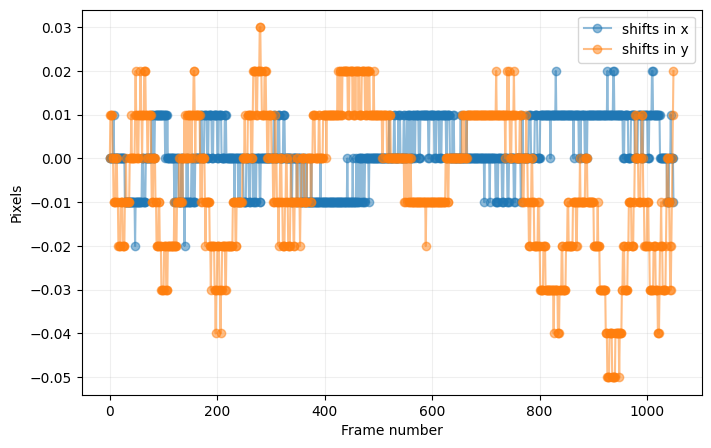

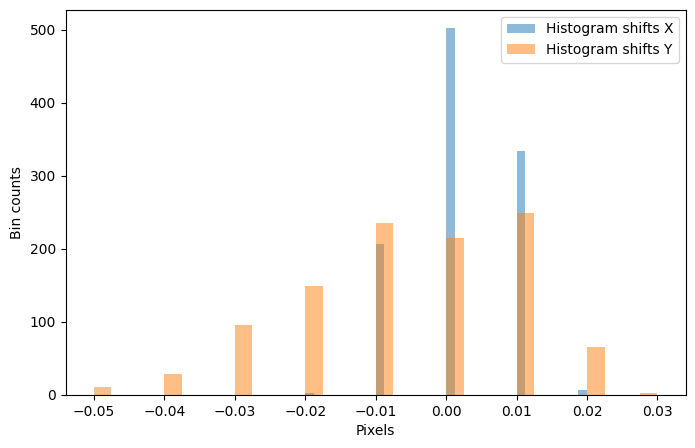

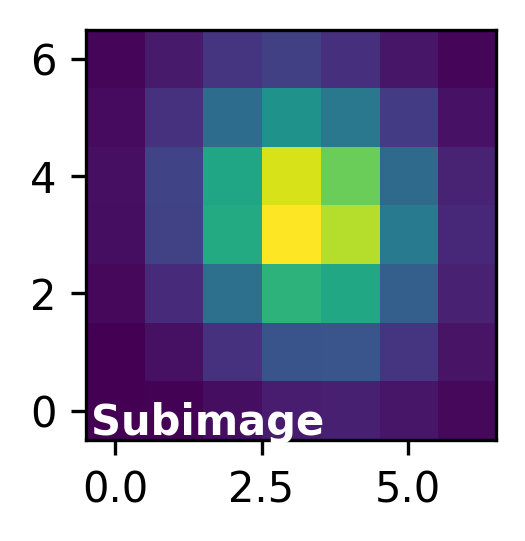

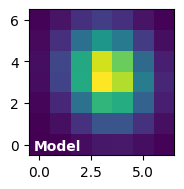

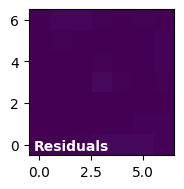

2025-02-25 09:12:06,693 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:12:06,693 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['y'].values[maskl] = median_values[1]



FWHM_y = 3.447920417936473
FWHM_x = 2.9384030935257 

centroid y = 28.318422276750702
centroid x = 29.268978718084945
centroid y subim = 3.318422276750703
centroid x subim = 3.2689787180849437 

amplitude = 89951364581.31667
theta = 22.698972471945705
number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_psf_ch1-short_s3d: (29,28)
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
New shape: (7, 7)


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1050/1050 [00:01<00:00, 673.81it/s]
2025-02-25 09:12:13,256 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:12:13,257 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_psf_ch1-short_s3d: (29,28)
*** Recentering /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch1-medium_s3d ***
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2025-02-25 09:12:17
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
frames
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:03

Shifts in X and Y
0.0 0.0
0.0 -0.009999999776482582
0.009999999776482582 -0.009999999776482582
0.009999999776482582 -0.009999999776482582
0.

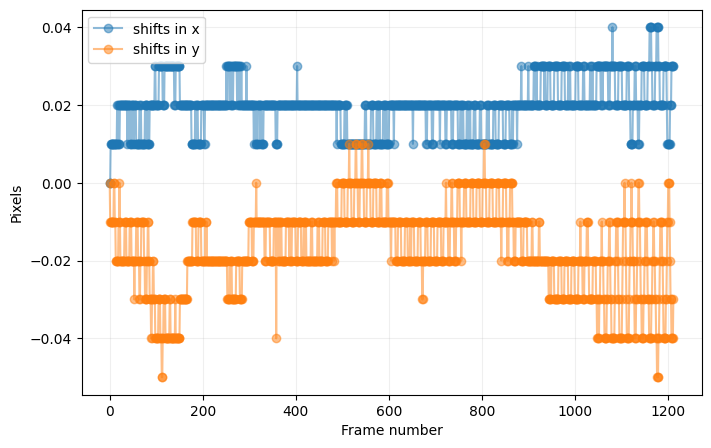

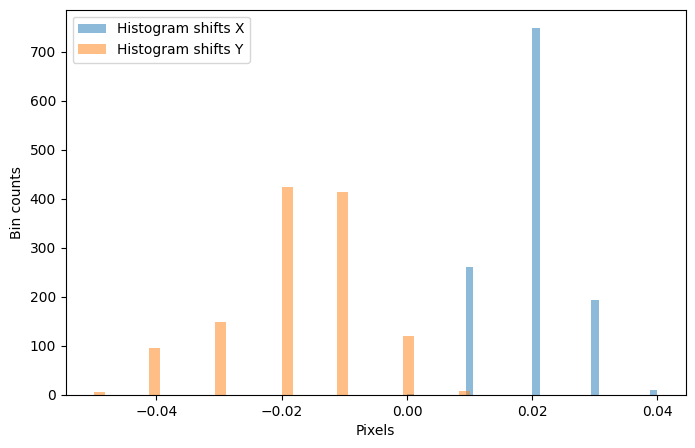

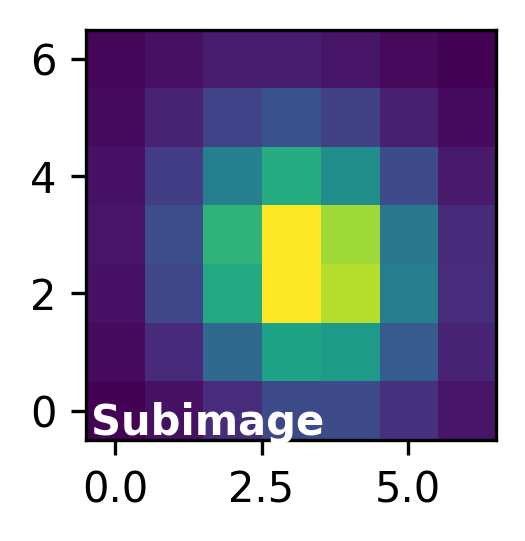

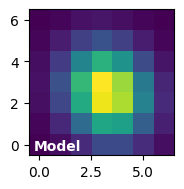

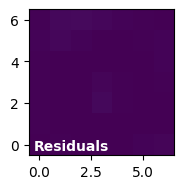

2025-02-25 09:12:22,526 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:12:22,526 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['y'].values[maskl] = median_values[1]



FWHM_y = 3.535727547885836
FWHM_x = 3.047969923944122 

centroid y = 28.521355408013285
centroid x = 28.261390058308866
centroid y subim = 2.521355408013287
centroid x subim = 3.261390058308865 

amplitude = 78912153721.63882
theta = 24.626883961616617
number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_psf_ch1-medium_s3d: (28,29)
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
New shape: (7, 7)


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1213/1213 [00:01<00:00, 672.77it/s]
2025-02-25 09:12:30,046 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:12:30,046 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_psf_ch1-medium_s3d: (28,29)
*** Recentering /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch1-long_s3d ***
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2025-02-25 09:12:35
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
frames
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:02

Shifts in X and Y
0.0 0.0
0.0 0.0
0.0 0.0
0.0 0.0
0.0 0.009999999776482582
0.0 0.0
0.0 0.0
0.0 0.0
0.0 0.0
0.0 0.0
0.0 0.0
0.0 0.0
0.0 0.0
0.

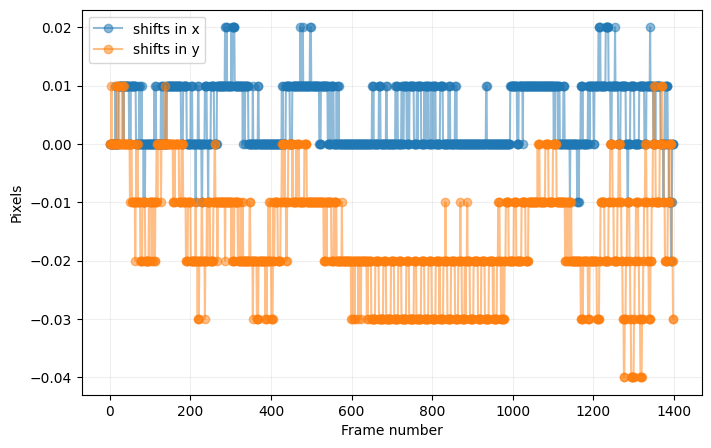

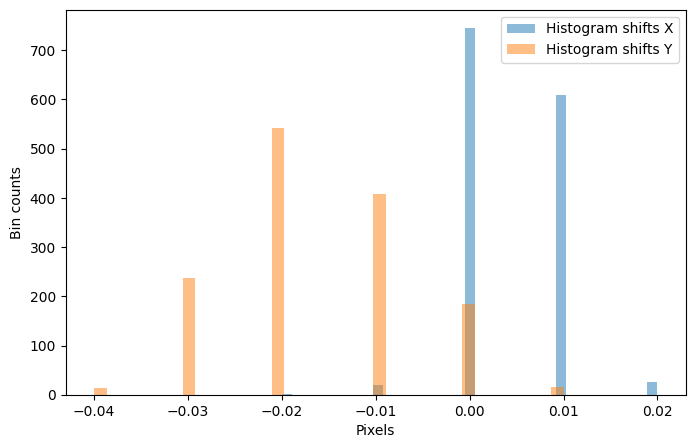

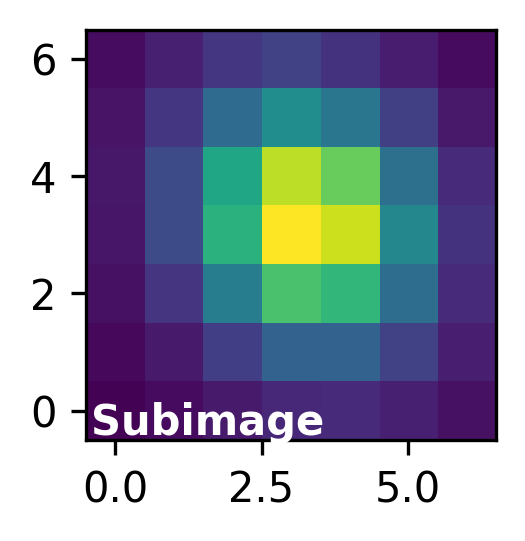

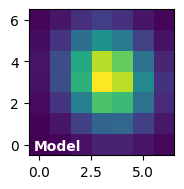

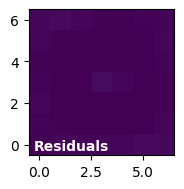

2025-02-25 09:12:39,588 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:12:39,588 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['y'].values[maskl] = median_values[1]



FWHM_y = 3.625869033649141
FWHM_x = 3.131844439277879 

centroid y = 29.210216719198655
centroid x = 30.290293532312013
centroid y subim = 3.2102167191986557
centroid x subim = 3.2902935323120124 

amplitude = 70598155673.1473
theta = 23.905302116819882
number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_psf_ch1-long_s3d: (30,29)
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
New shape: (7, 7)


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1400/1400 [00:02<00:00, 689.90it/s]
2025-02-25 09:12:48,053 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:12:48,053 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

number of bad center positions: 1
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_psf_ch1-long_s3d: (30,29)
*** Recentering /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch2-short_s3d ***
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2025-02-25 09:12:52
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
frames
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:02

Shifts in X and Y
0.0 0.0
0.0 0.009999999776482582
-0.009999999776482582 0.019999999552965164
-0.019999999552965164 0.03999999910593033
-0.029

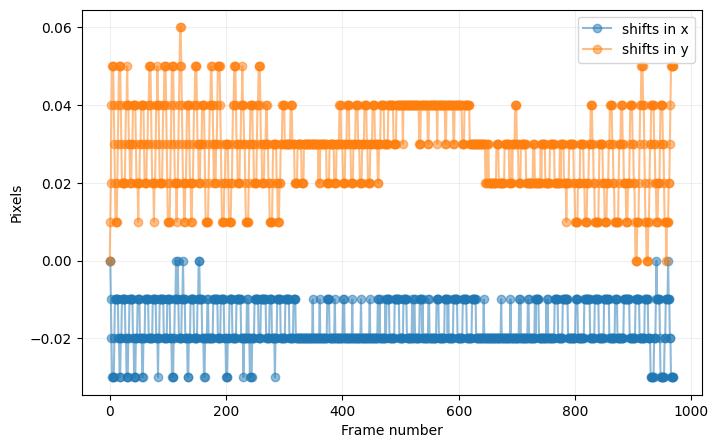

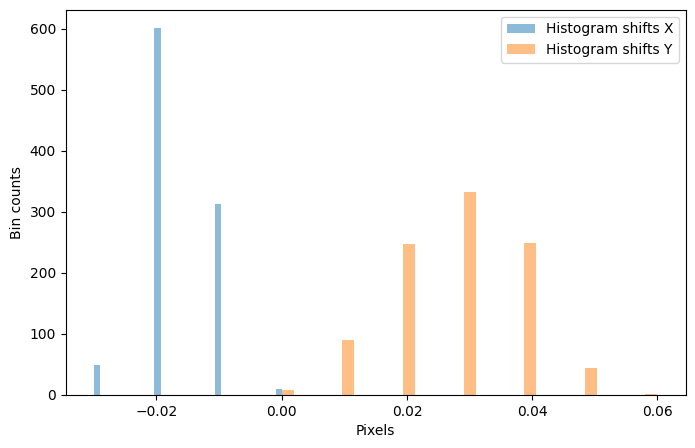

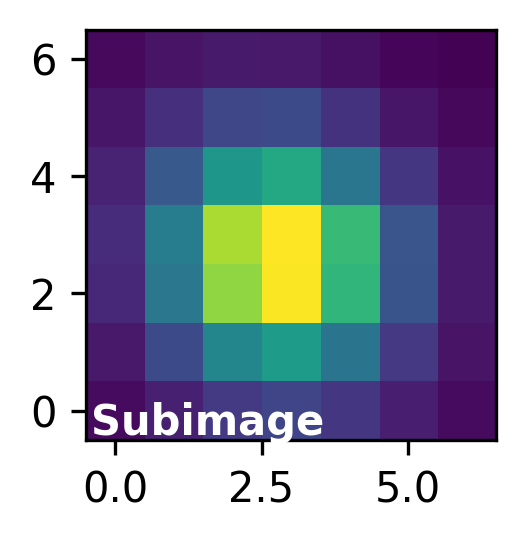

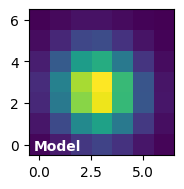

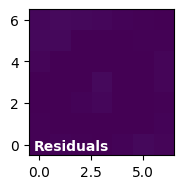

2025-02-25 09:12:55,564 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:12:55,565 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['y'].values[maskl] = median_values[1]



FWHM_y = 3.364543010084125
FWHM_x = 3.1719898198621124 

centroid y = 23.56520384601667
centroid x = 23.783648779710344
centroid y subim = 2.56520384601667
centroid x subim = 2.783648779710343 

amplitude = 37203034175.865585
theta = 28.36929764477557
number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_psf_ch2-short_s3d: (24,24)
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
New shape: (7, 7)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 970/970 [00:01<00:00, 620.26it/s]
2025-02-25 09:13:01,378 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:13:01,379 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_psf_ch2-short_s3d: (24,24)
*** Recentering /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch2-medium_s3d ***
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2025-02-25 09:13:05
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
frames
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:02

Shifts in X and Y
0.0 0.0
0.0 0.0
-0.009999999776482582 0.009999999776482582
-0.019999999552965164 0.019999999552965164
-0.01999999955296516

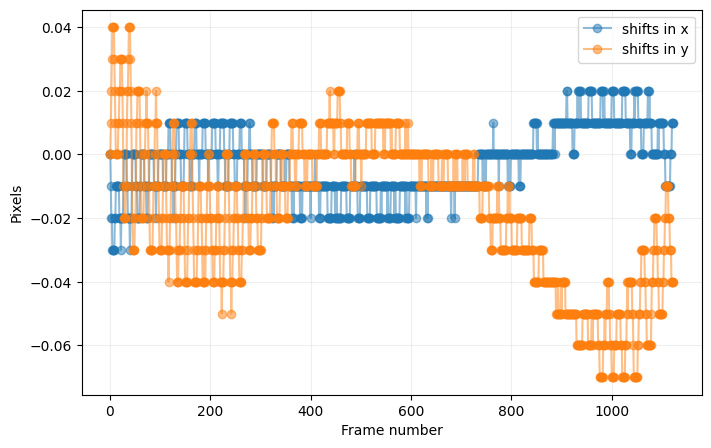

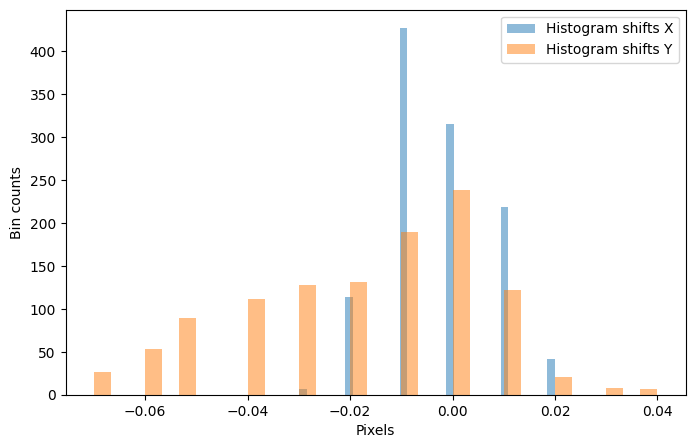

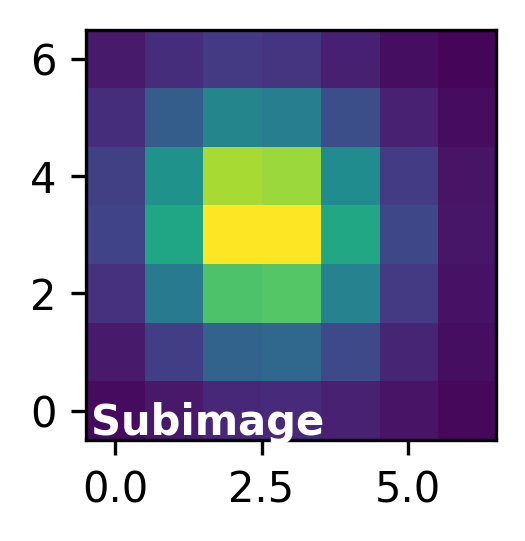

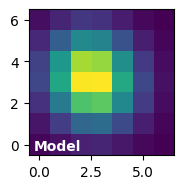

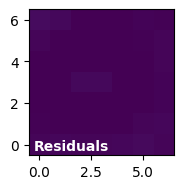

2025-02-25 09:13:09,039 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:13:09,039 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['y'].values[maskl] = median_values[1]



FWHM_y = 3.542037862005489
FWHM_x = 3.263888547531001 

centroid y = 23.16137447908956
centroid x = 23.50066287812738
centroid y subim = 3.1613744790895595
centroid x subim = 2.500662878127379 

amplitude = 34198261834.77608
theta = 26.437174094091713
number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_psf_ch2-medium_s3d: (24,23)
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
New shape: (7, 7)


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1124/1124 [00:01<00:00, 660.32it/s]
2025-02-25 09:13:15,572 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:13:15,573 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_psf_ch2-medium_s3d: (24,23)
*** Recentering /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch2-long_s3d ***
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2025-02-25 09:13:19
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
frames
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:02

Shifts in X and Y
0.0 0.0
0.0 0.009999999776482582
-0.009999999776482582 0.019999999552965164
-0.009999999776482582 0.029999999329447746
-0.0

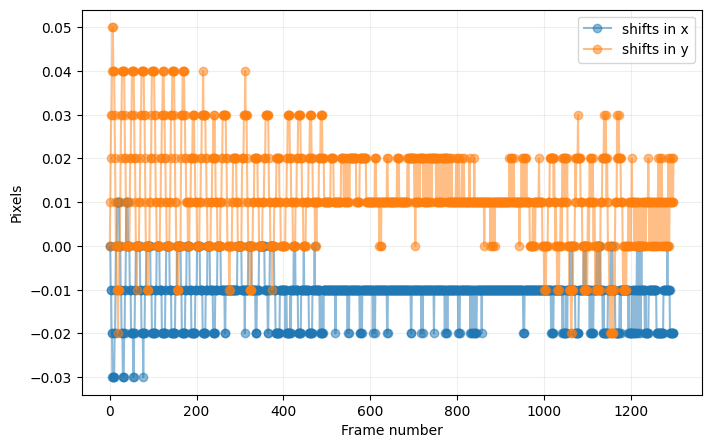

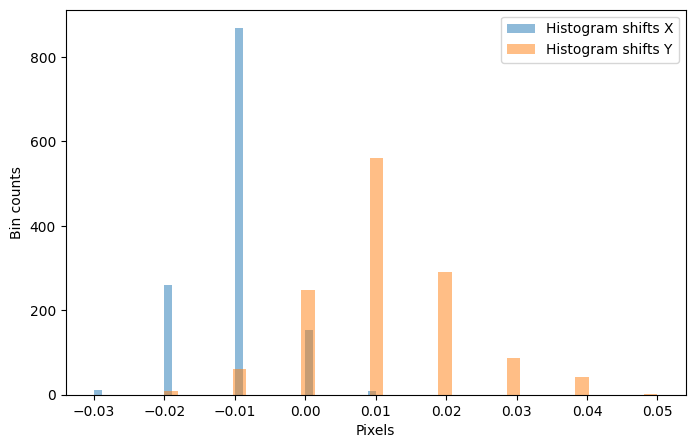

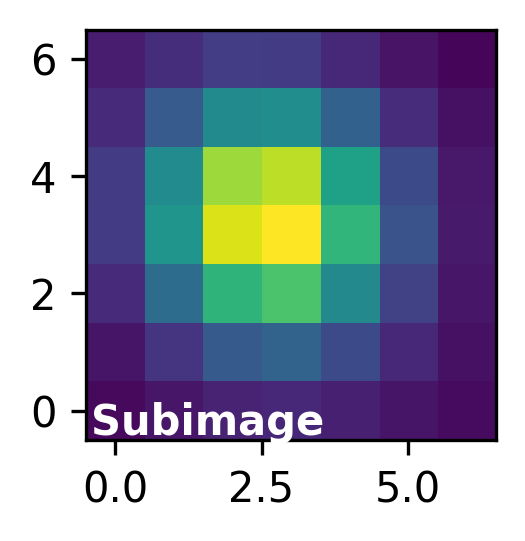

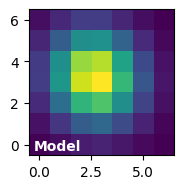

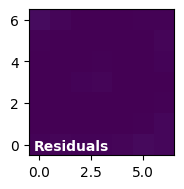

2025-02-25 09:13:23,905 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:13:23,906 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['y'].values[maskl] = median_values[1]



FWHM_y = 3.612566676338888
FWHM_x = 3.3616576178865514 

centroid y = 23.252886106207715
centroid x = 22.640170485801995
centroid y subim = 3.252886106207714
centroid x subim = 2.640170485801996 

amplitude = 53415050635.39155
theta = 25.880292966749074
number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_psf_ch2-long_s3d: (23,23)
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
New shape: (7, 7)


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1300/1300 [00:01<00:00, 653.19it/s]
2025-02-25 09:13:31,209 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:13:31,210 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_psf_ch2-long_s3d: (23,23)
*** Recentering /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch3-short_s3d ***
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2025-02-25 09:13:34
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
frames
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:01

Shifts in X and Y
0.0 0.0
-0.009999999776482582 0.019999999552965164
-0.009999999776482582 0.029999999329447746
-0.019999999552965164 0.050000

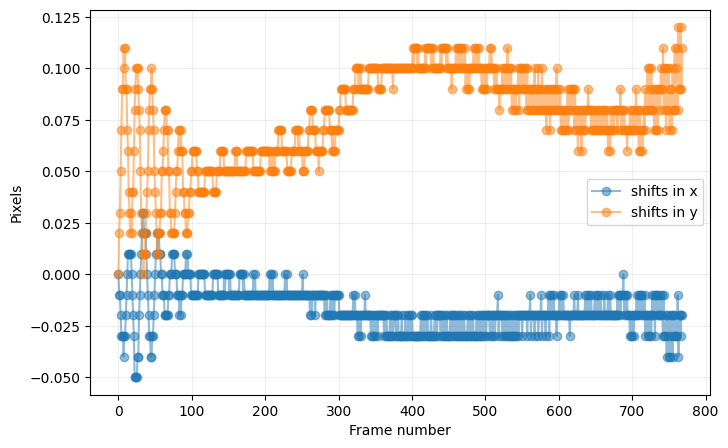

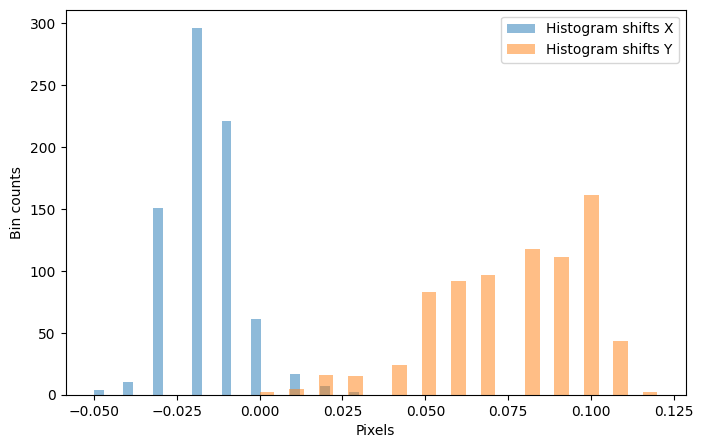

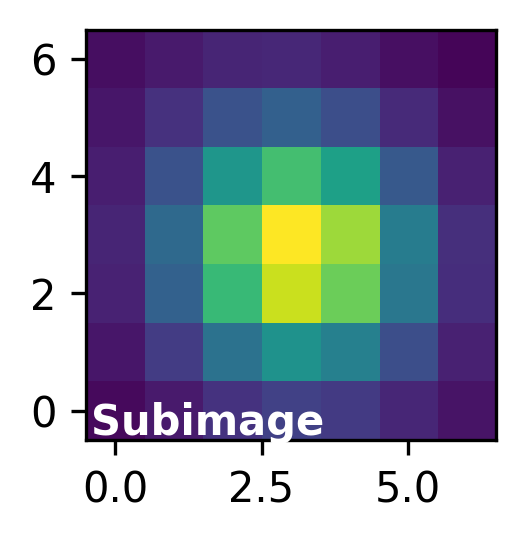

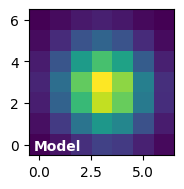

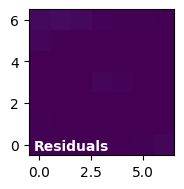

2025-02-25 09:13:37,414 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:13:37,415 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['y'].values[maskl] = median_values[1]



FWHM_y = 3.632579706685699
FWHM_x = 3.4395654745914728 

centroid y = 23.71599459037598
centroid x = 28.107819471710997
centroid y subim = 2.7159945903759826
centroid x subim = 3.107819471710997 

amplitude = 5293008722.856639
theta = 30.386286412135945
number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_psf_ch3-short_s3d: (28,24)
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
New shape: (7, 7)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 769/769 [00:01<00:00, 708.39it/s]
2025-02-25 09:13:42,103 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:13:42,103 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_psf_ch3-short_s3d: (28,24)
*** Recentering /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch3-medium_s3d ***
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2025-02-25 09:13:45
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
frames
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:01

Shifts in X and Y
0.0 0.0
0.0 -0.009999999776482582
0.0 -0.009999999776482582
0.0 -0.009999999776482582
0.009999999776482582 -0.019999999552

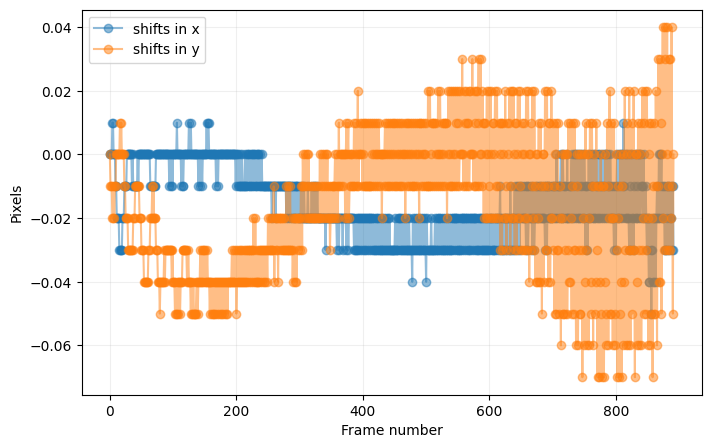

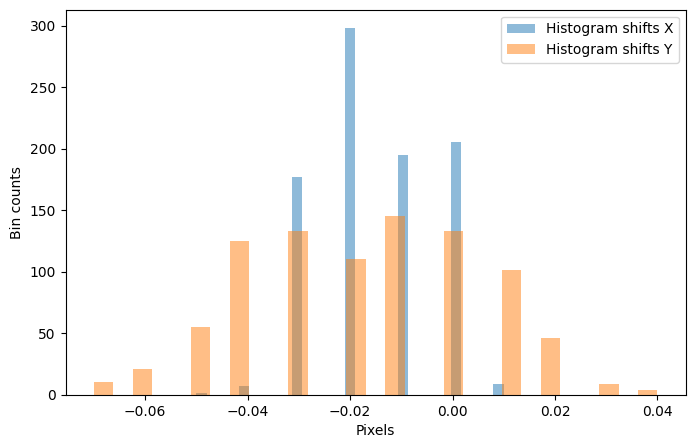

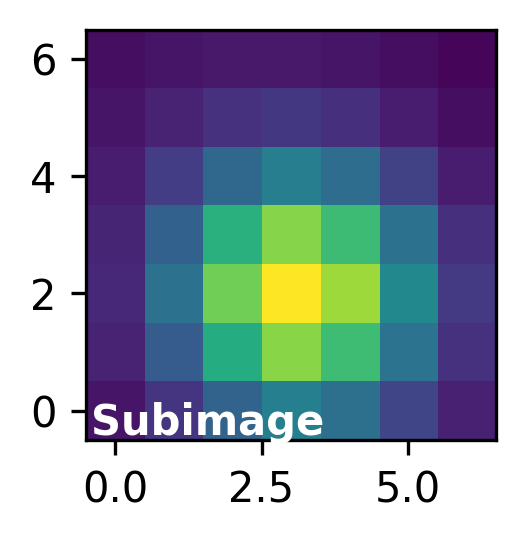

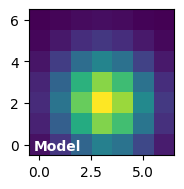

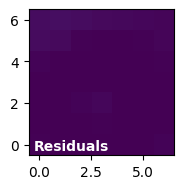

2025-02-25 09:13:48,161 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:13:48,161 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['y'].values[maskl] = median_values[1]



FWHM_y = 3.7430009107503204
FWHM_x = 3.5878536241686225 

centroid y = 22.01661442238465
centroid x = 26.117389843165856
centroid y subim = 2.016614422384649
centroid x subim = 3.117389843165857 

amplitude = 2753277447.964509
theta = 25.245833395817836
number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_psf_ch3-medium_s3d: (26,22)
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
New shape: (7, 7)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 892/892 [00:01<00:00, 667.25it/s]
2025-02-25 09:13:53,385 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:13:53,385 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_psf_ch3-medium_s3d: (26,22)
*** Recentering /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch3-long_s3d ***
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2025-02-25 09:13:56
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
frames
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:02

Shifts in X and Y
0.0 0.0
0.0 0.0
0.0 -0.009999999776482582
0.0 -0.009999999776482582
0.0 0.0
0.0 -0.019999999552965164
0.0 -0.01999999955296

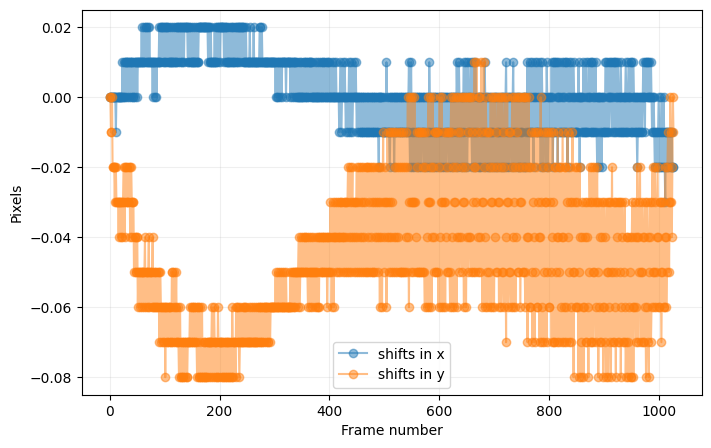

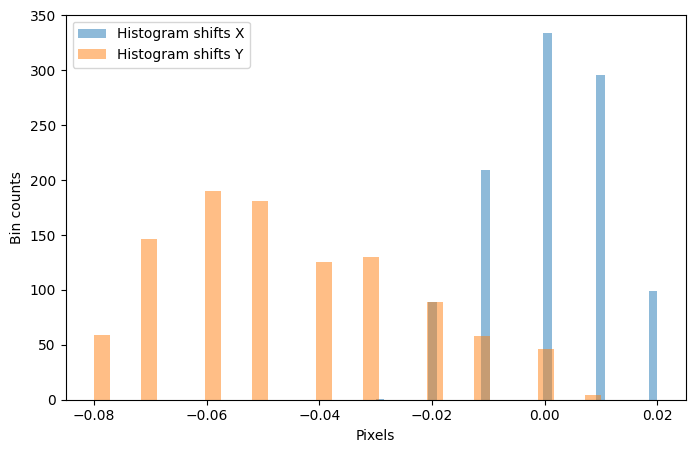

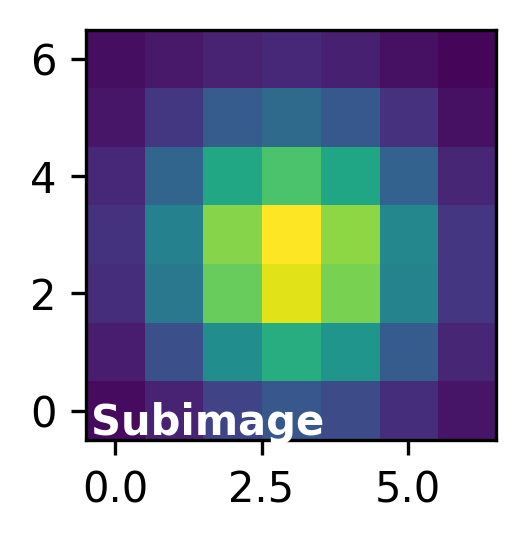

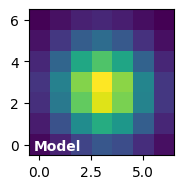

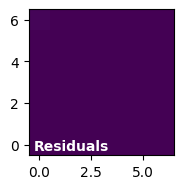

2025-02-25 09:14:00,287 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:14:00,287 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['y'].values[maskl] = median_values[1]



FWHM_y = 3.9365388114244517
FWHM_x = 3.731518465541509 

centroid y = 22.634625690793527
centroid x = 26.03617666604654
centroid y subim = 2.634625690793528
centroid x subim = 3.0361766660465395 

amplitude = 6346651428.9223995
theta = 28.188063846130255
number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_psf_ch3-long_s3d: (26,23)
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
New shape: (7, 7)


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1028/1028 [00:01<00:00, 708.84it/s]
2025-02-25 09:14:06,145 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:14:06,146 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_psf_ch3-long_s3d: (26,23)
*** Recentering /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch4-short_s3d ***
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2025-02-25 09:14:08
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
frames
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:01

Shifts in X and Y
0.0 0.0
0.0 0.0
0.0 0.0
0.0 -0.009999999776482582
0.0 0.0
0.0 0.0
0.0 0.0
0.0 0.0
0.0 0.0
0.0 0.0
0.0 0.0
0.0 0.009999999776

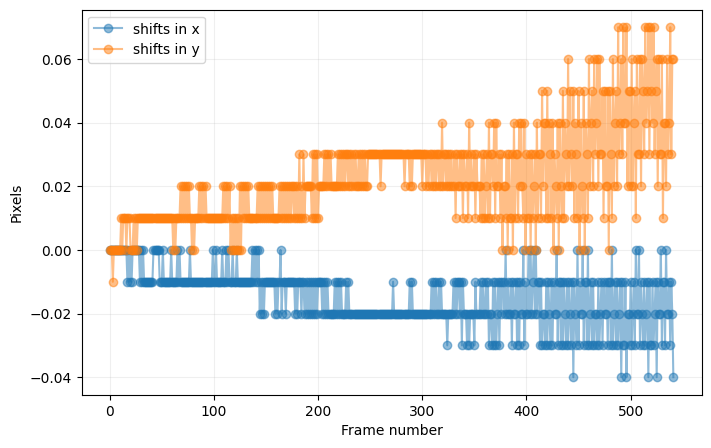

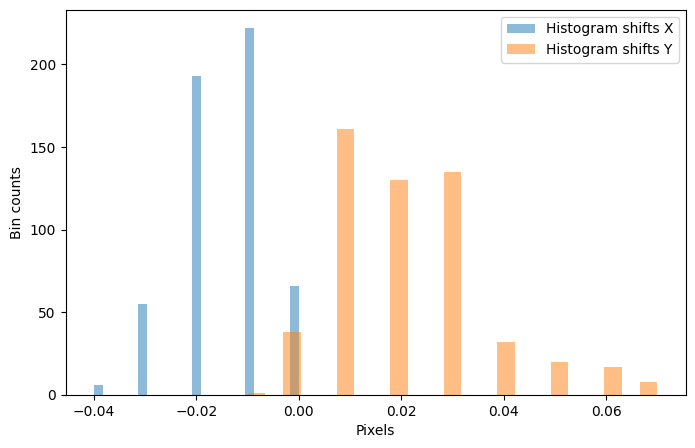

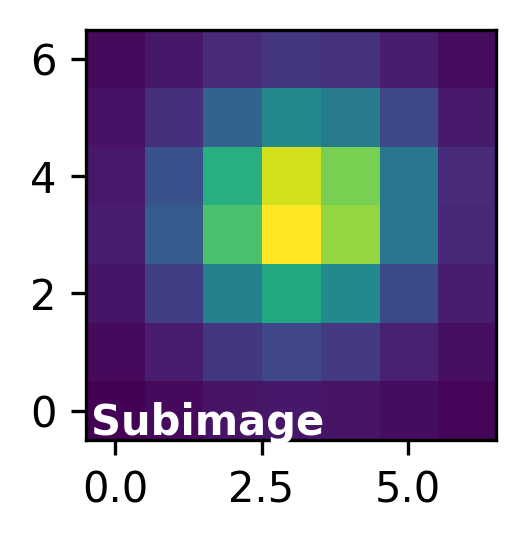

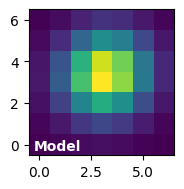

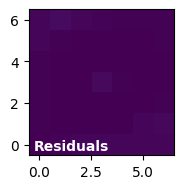

2025-02-25 09:14:11,038 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:14:11,038 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['y'].values[maskl] = median_values[1]



FWHM_y = 3.1158836737562505
FWHM_x = 3.2969193396914687 

centroid y = 19.369819911620404
centroid x = 17.165136104689157
centroid y subim = 3.3698199116204046
centroid x subim = 3.1651361046891564 

amplitude = 1894199343.9312952
theta = 31.51165556380904
number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_psf_ch4-short_s3d: (17,19)
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
New shape: (7, 7)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 542/542 [00:01<00:00, 521.91it/s]
2025-02-25 09:14:14,152 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:14:14,152 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_psf_ch4-short_s3d: (17,19)
*** Recentering /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch4-medium_s3d ***
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2025-02-25 09:14:16
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
frames
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:01

Shifts in X and Y
0.0 0.0
0.019999999552965164 -0.009999999776482582
0.009999999776482582 0.009999999776482582
0.0 -0.009999999776482582
0.0

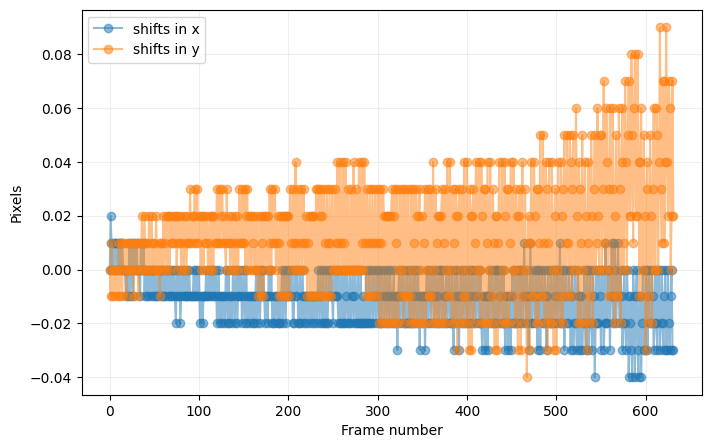

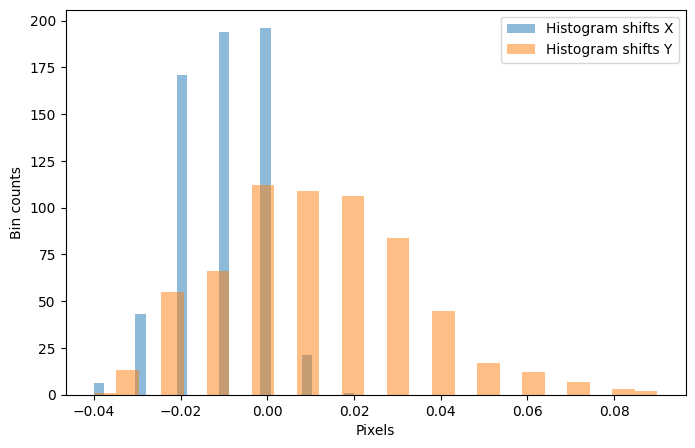

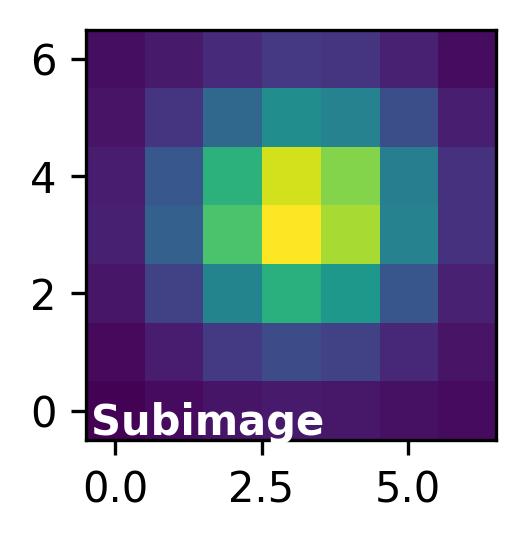

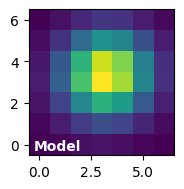

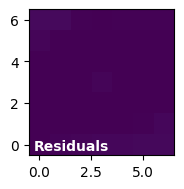

2025-02-25 09:14:18,141 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:14:18,141 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['y'].values[maskl] = median_values[1]



FWHM_y = 3.254924407747387
FWHM_x = 3.3926041088107417 

centroid y = 19.35669255630067
centroid x = 17.205847192465914
centroid y subim = 3.356692556300668
centroid x subim = 3.2058471924659124 

amplitude = 932849895.9253399
theta = 20.417346485574118
number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_psf_ch4-medium_s3d: (17,19)
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
New shape: (7, 7)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 632/632 [00:00<00:00, 673.75it/s]
2025-02-25 09:14:21,426 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:14:21,426 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_psf_ch4-medium_s3d: (17,19)
*** Recentering /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch4-long_s3d ***
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2025-02-25 09:14:23
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
frames
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:01

Shifts in X and Y
0.0 0.0
-0.009999999776482582 0.009999999776482582
-0.009999999776482582 0.019999999552965164
-0.009999999776482582 0.0
-0.

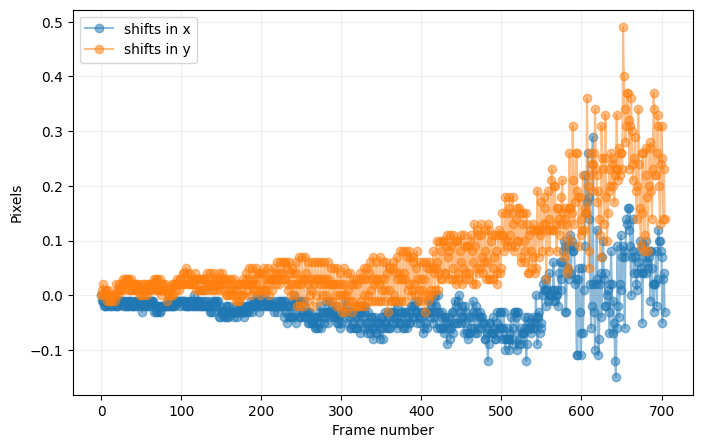

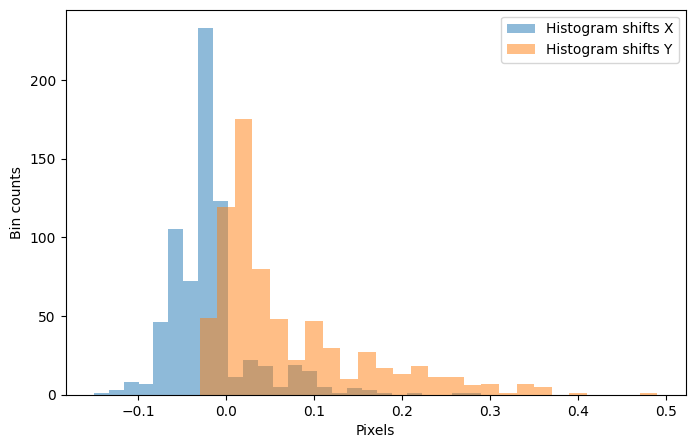

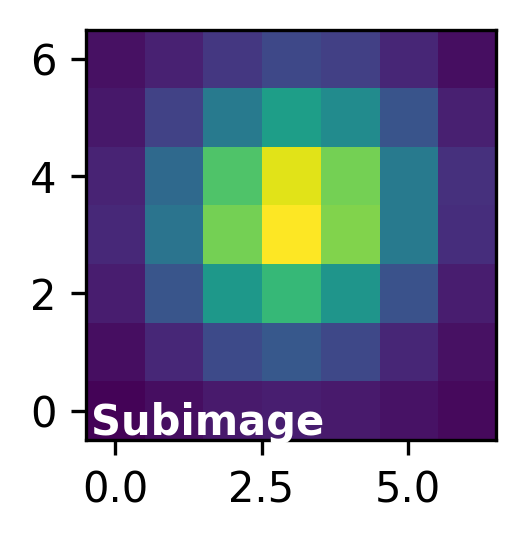

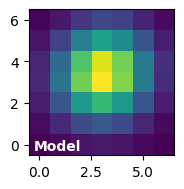

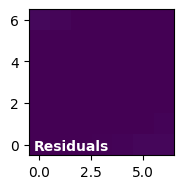

2025-02-25 09:14:25,976 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:14:25,977 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['y'].values[maskl] = median_values[1]



FWHM_y = 3.4307495616856736
FWHM_x = 3.6096161352461844 

centroid y = 19.386348438059816
centroid x = 17.059635737434487
centroid y subim = 3.386348438059817
centroid x subim = 3.0596357374344865 

amplitude = 419687688.07685673
theta = -131.6388128354937
number of bad center positions: 4
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_psf_ch4-long_s3d: (17,19)
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
New shape: (7, 7)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 705/705 [00:01<00:00, 556.10it/s]
2025-02-25 09:14:29,801 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:14:29,802 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

number of bad center positions: 15
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_psf_ch4-long_s3d: (17,19)


In [60]:
discard_idx_band = []
if discard_band_cen is not None:
    for dd in discard_band_cen:
        discard_idx_band.append(convert_band_to_idx(dd)) 
cxy_med = []
cx_all = []
cy_all = []
for ff, file in enumerate(calfiles):
    bname = splitext(file)[0]
    print("*** Recentering {} ***".format(bname))
    if bname[-5:] == '_bpc3':
        bname = bname[:-5]
    outname = bname+'_cen.fits'
    if ff in discard_idx_band:
        os.system("cp {} {}".format(file, outname))
        cube = fits.getdata(file, 'SCI')
        cy, cx = frame_center(cube)
        cxy_med.append((cx,cy))
    else:
        cen_res = recenter_cubes(file, sig=5, method=cen_method, imlib=imlib, crop_sz=crop_sz, debug=show_plots,
                                 suffix='_cen', verbose=True, overwrite=True, full_output=True)
        cxy_med.append(cen_res[:2])
        cx_all.append(cen_res[2])
        cy_all.append(cen_res[3])
        if make_centroid_and_fwhm_plots:
            cen_res = recenter_cubes(file, sig=5, method='gauss', imlib=imlib, debug=False, 
                                     crop_sz=crop_sz, suffix='_gauss', verbose=True, overwrite=True,
                                     full_output=True) # this saves results of the 2D fit in a csv file ending in 2d_fit_robust.csv
        if show_plots:
            plt.show()
    ## if no centering just copy input file
#         if cen_method is None:
#             os.system("cp {} {}".format(file, outname))
#    os.system("cp {} {}/.".format(outname, fin3_dir)) #    os.system("cp {} {}/.".format(outname, fin3_dir)) --> NOW done after potential residual BKG subtraction
if discard_band_cen is not None:
    # for bands with very low signal from the star, replace centroid coordinates with median of good coordinates in the same channel
    for ff in discard_idx_band:
        msg = "WARNING: centroid in band#{} will be replaced by ".format(ff)
        if ff%3 == 0:
            good_ff = [ff_tmp+ff for ff_tmp in [1,2] if ff_tmp+ff not in discard_idx_band]
        elif ff%3 == 1:
            good_ff = [ff_tmp+ff for ff_tmp in [-1,1] if ff_tmp+ff not in discard_idx_band]
        else:
            good_ff = [ff_tmp+ff for ff_tmp in [-2,-1] if ff_tmp+ff not in discard_idx_band]
        if len(good_ff)==2:
            cxy_med[ff] = (np.median([cxy_med[good_ff[0]][0],cxy_med[good_ff[1]][0]]),
                           np.median([cxy_med[good_ff[0]][1],cxy_med[good_ff[1]][1]]))
            msg += "median of centroid inferred in bands# {} and {}: {}".format(good_ff[0], good_ff[1], cxy_med[ff])
        elif len(good_ff)==1:
            cxy_med[ff] = (cxy_med[good_ff[0]][0], cxy_med[good_ff[0]][1])
            msg += "centroid inferred in band# {}: {}".format(good_ff[0], cxy_med[ff])
        else:
            msg += "center of field of view: {}".format(cxy_med[ff])
        print(msg)

In [61]:
write_fits(join(spec3_dir,"cxy_med.fits"), np.array(cxy_med)) # write a first time to auto-generate some header keywords
_, head = open_fits(join(spec3_dir,"cxy_med.fits"), header=True)
chs = [1, 2, 3, 4]
bands = ['SHORT','MEDIUM','LONG']
print("XY coordinates of the star inferred in the sky-aligned cubes (not used for spectrum extraction - only the ifu-aligned cubes are used): ")
c=0
for i in chs:
    for j in bands:
        print("CH.{} {}: {}".format(i, j, cxy_med[c]))
        c+=1
        head['C_PAIR{}'.format(c)] = 'CH.{} {}'.format(i,j)
write_fits(join(spec3_dir,"cxy_med.fits"), np.array(cxy_med), header=head)
#print(cxy_med)
os.system("cp {} {}/.".format(join(spec3_dir,"cxy_med.fits"), fin3_dir))

FITS file successfully overwritten
FITS HDU-0 data and header successfully loaded. Data shape: (12, 2)
XY coordinates of the star inferred in the sky-aligned cubes (not used for spectrum extraction - only the ifu-aligned cubes are used): 
CH.1 SHORT: (29.268978718084945, 28.318422276750702)
CH.1 MEDIUM: (28.261390058308866, 28.521355408013285)
CH.1 LONG: (30.290293532312013, 29.210216719198655)
CH.2 SHORT: (23.783648779710344, 23.56520384601667)
CH.2 MEDIUM: (23.50066287812738, 23.16137447908956)
CH.2 LONG: (22.640170485801995, 23.252886106207715)
CH.3 SHORT: (28.107819471710997, 23.71599459037598)
CH.3 MEDIUM: (26.117389843165856, 22.01661442238465)
CH.3 LONG: (26.03617666604654, 22.634625690793527)
CH.4 SHORT: (17.165136104689157, 19.369819911620404)
CH.4 MEDIUM: (17.205847192465914, 19.35669255630067)
CH.4 LONG: (17.059635737434487, 19.386348438059816)
FITS file successfully overwritten


0

**For ifualign cubes:**

In [62]:
# List relevant files
calfiles_ifua=sorted(glob.glob(join(spec3_dir,'Level3_ifua{}*{}.fits'.format(suffix[0],suf))))
calfiles_ifua = sort_files_wl(calfiles_ifua)
print(len(calfiles_ifua))

12


In [63]:
calfiles_ifua

['/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-short_s3d.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-medium_s3d.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-long_s3d.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-short_s3d.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-medium_s3d.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-long_s3d.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch3-short_s3d.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch3-medium_s3d.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch3-long_s3d.fits',
 '/Users/valentin/D

*** Recentering /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-short_s3d ***
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2025-02-25 09:14:32
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
frames
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:02

Shifts in X and Y
0.0 0.0
-0.009999999776482582 0.0
-0.009999999776482582 0.0
-0.019999999552965164 0.0
-0.009999999776482582 0.0
-0.009999999776482582 0.0
0.0 0.0
0.009999999776482582 0.0
0.0 0.0
0.0 0.0
0.0 0.0
0.0 0.0
0.0 0.0
-0.009999999776482582 0.0
0.0 0.0
0.009999999776482582 0.0
0.009999999776482582 0.0
0.009999999776482582 -0.009999999776482582
0.009999999776482582 -0.009999999776482582
0.009999999776482582 -0.009999999776482582
0.0 0.0
0.0 0.0
0.0 -0.009999999776482582
0.0 -0.009999999776

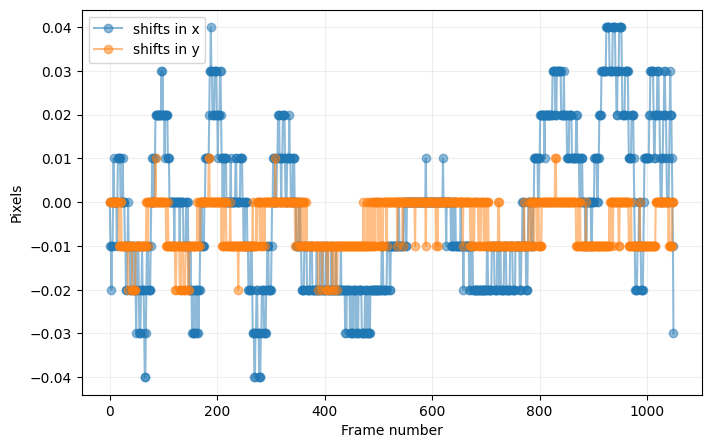

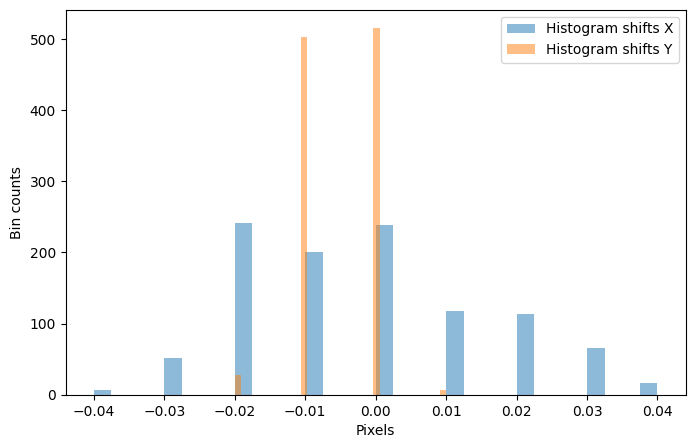

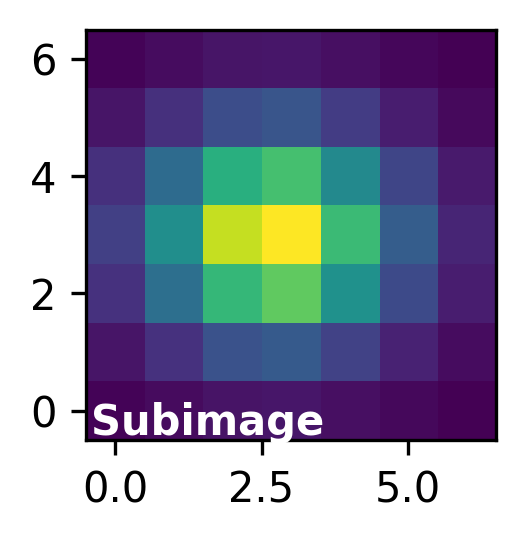

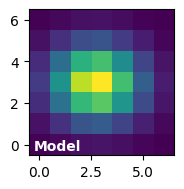

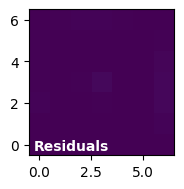

2025-02-25 09:14:36,168 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:14:36,168 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['y'].values[maskl] = median_values[1]



FWHM_y = 2.942446664110974
FWHM_x = 3.4563147434370487 

centroid y = 22.95927954899827
centroid x = 23.72321327612675
centroid y subim = 2.9592795489982713
centroid x subim = 2.7232132761267507 

amplitude = 87535605049.3747
theta = -1.7916410118120714
number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_ifua_psf_ch1-short_s3d: (24,23)
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
New shape: (7, 7)


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1050/1050 [00:01<00:00, 700.83it/s]
2025-02-25 09:14:42,203 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:14:42,203 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_ifua_psf_ch1-short_s3d: (24,23)
*** Recentering /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-medium_s3d ***
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2025-02-25 09:14:46
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
frames
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:03

Shifts in X and Y
0.0 0.0
0.009999999776482582 0.0
0.009999999776482582 0.0
0.019999999552965164 0.0
0.019999999552965164 0.0
0.01

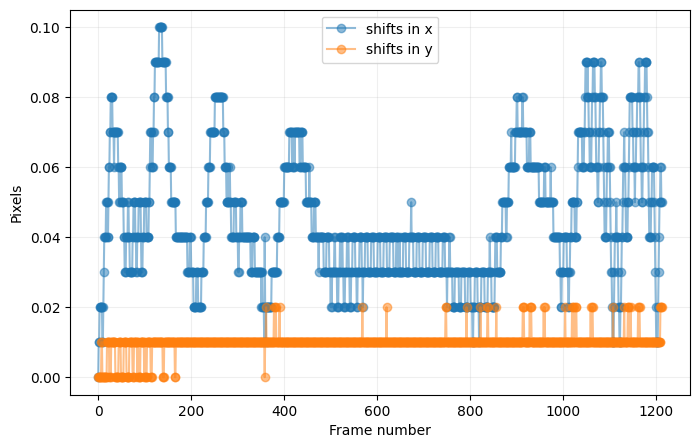

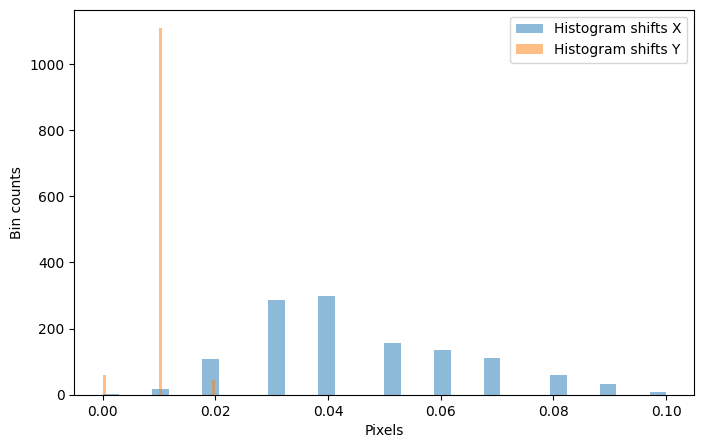

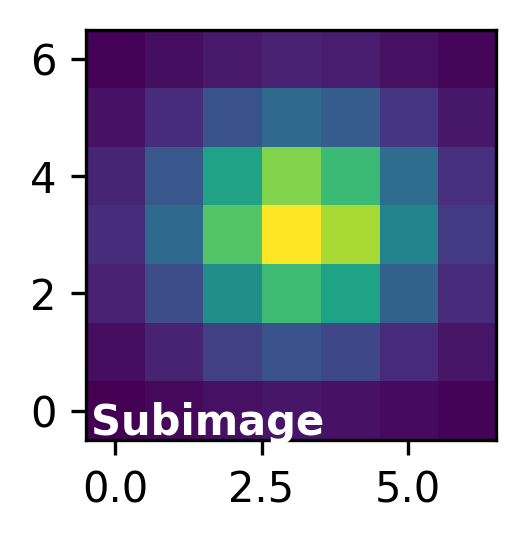

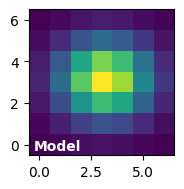

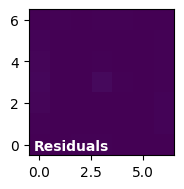

2025-02-25 09:14:50,540 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:14:50,540 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['y'].values[maskl] = median_values[1]



FWHM_y = 3.053498471788071
FWHM_x = 3.524157176249957 

centroid y = 22.12595050533582
centroid x = 23.157005818798588
centroid y subim = 3.1259505053358194
centroid x subim = 3.157005818798587 

amplitude = 77609390203.51207
theta = -0.12387590107697415
number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_ifua_psf_ch1-medium_s3d: (23,22)
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
New shape: (7, 7)


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1213/1213 [00:01<00:00, 708.90it/s]
2025-02-25 09:14:57,278 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:14:57,278 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_ifua_psf_ch1-medium_s3d: (23,22)
*** Recentering /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-long_s3d ***
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2025-02-25 09:15:01
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
frames
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:03

Shifts in X and Y
0.0 0.0
0.0 0.0
0.0 0.0
0.0 0.0
0.0 0.0
0.0 0.0
0.0 0.0
0.009999999776482582 0.0
0.009999999776482582 0.0
0.00999

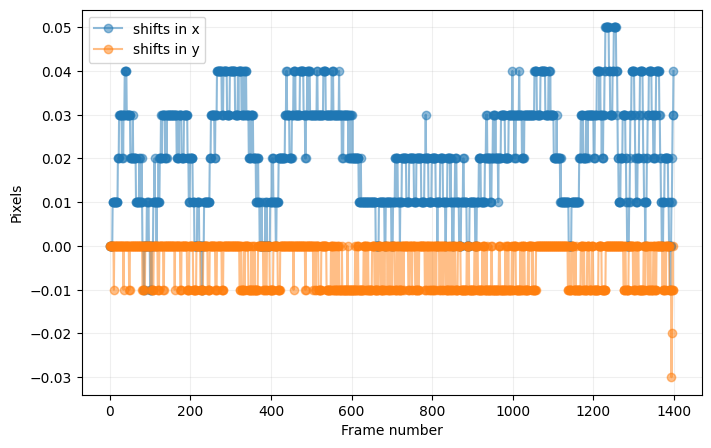

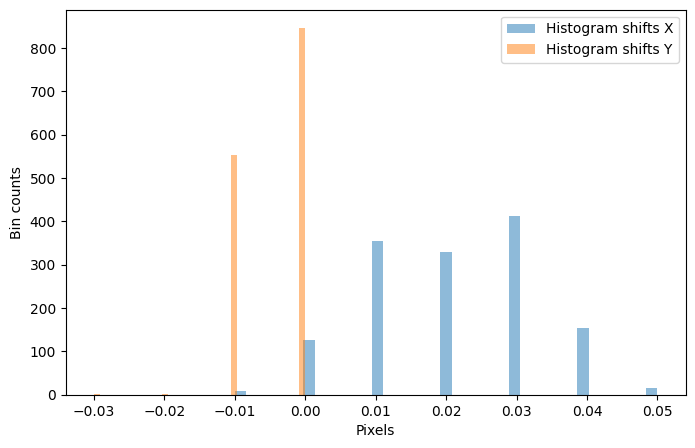

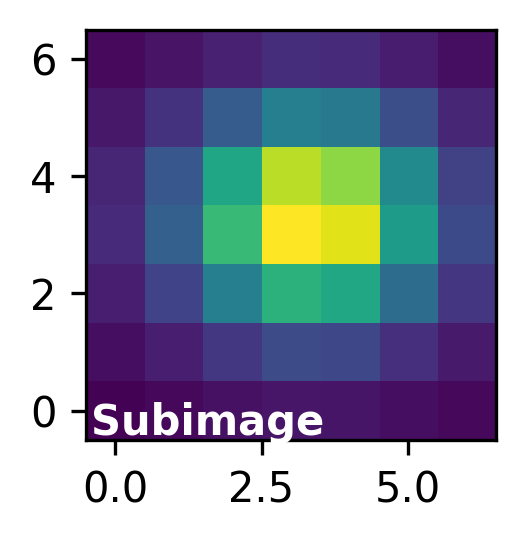

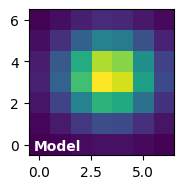

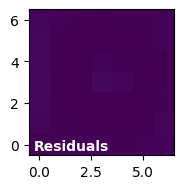

2025-02-25 09:15:06,469 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:15:06,470 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['y'].values[maskl] = median_values[1]



FWHM_y = 3.1511537845181743
FWHM_x = 3.605721072161483 

centroid y = 24.273262617092918
centroid x = 23.341481979955518
centroid y subim = 3.2732626170929193
centroid x subim = 3.341481979955519 

amplitude = 69755534114.90686
theta = -1.1517900653011846
number of bad center positions: 1
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_ifua_psf_ch1-long_s3d: (23,24)
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
New shape: (7, 7)


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1400/1400 [00:02<00:00, 676.67it/s]
2025-02-25 09:15:14,062 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:15:14,063 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

number of bad center positions: 2
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_ifua_psf_ch1-long_s3d: (23,24)
*** Recentering /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-short_s3d ***
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2025-02-25 09:15:18
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
frames
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:02

Shifts in X and Y
0.0 0.0
-0.009999999776482582 0.0
-0.019999999552965164 0.0
-0.03999999910593033 0.0
-0.05000000074505806 -0.00999

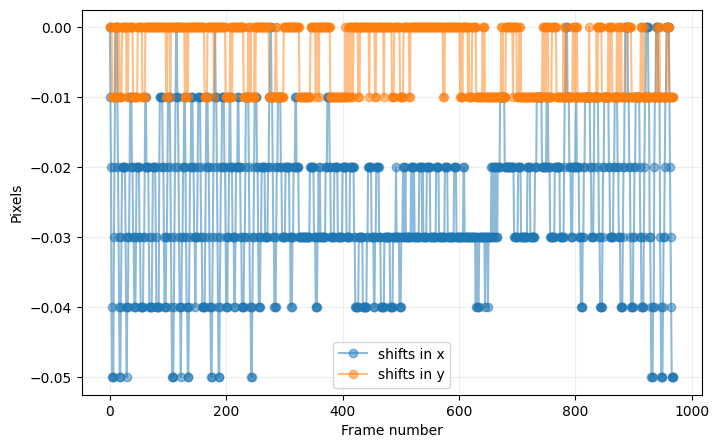

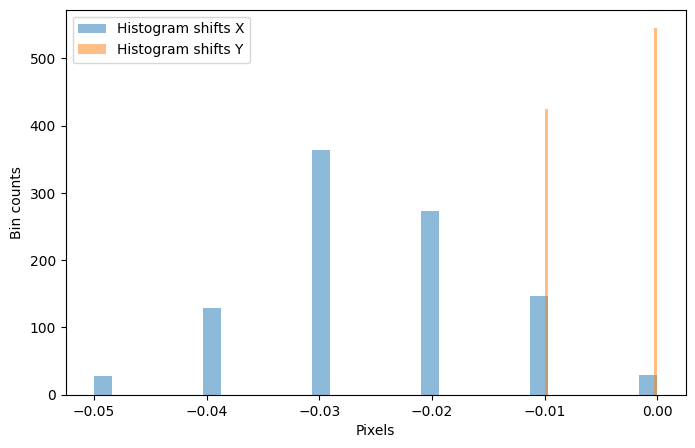

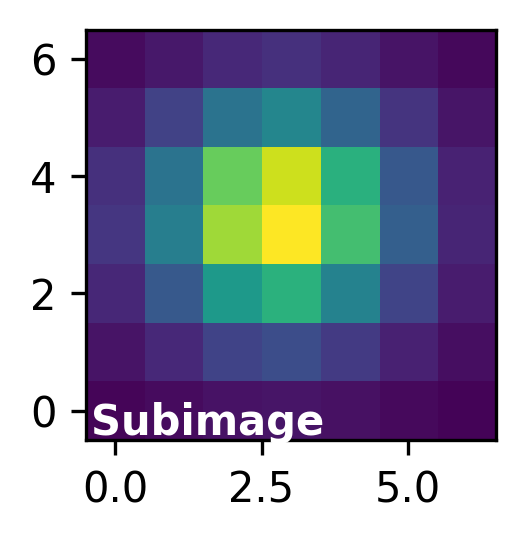

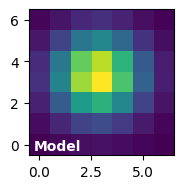

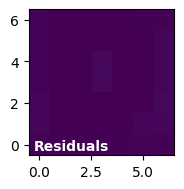

2025-02-25 09:15:21,841 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:15:21,842 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['y'].values[maskl] = median_values[1]



FWHM_y = 3.1871662490525745
FWHM_x = 3.3805153924546913 

centroid y = 18.300801678946137
centroid x = 20.82494066825802
centroid y subim = 3.3008016789461356
centroid x subim = 2.824940668258019 

amplitude = 38245844645.37741
theta = 2.9990012725856294
number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_ifua_psf_ch2-short_s3d: (21,18)
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
New shape: (7, 7)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 970/970 [00:01<00:00, 691.10it/s]
2025-02-25 09:15:27,085 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:15:27,085 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_ifua_psf_ch2-short_s3d: (21,18)
*** Recentering /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-medium_s3d ***
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2025-02-25 09:15:30
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
frames
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:02

Shifts in X and Y
0.0 0.0
-0.009999999776482582 0.0
-0.009999999776482582 -0.009999999776482582
-0.029999999329447746 -0.009999999

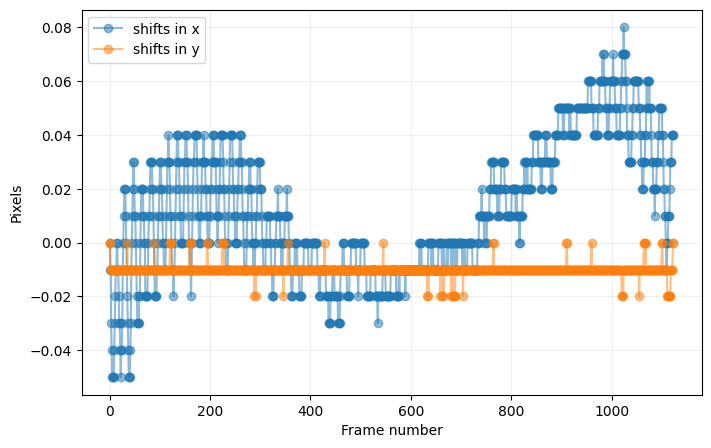

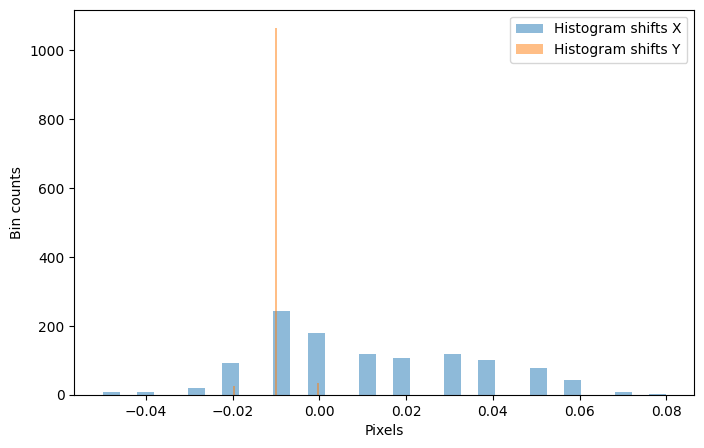

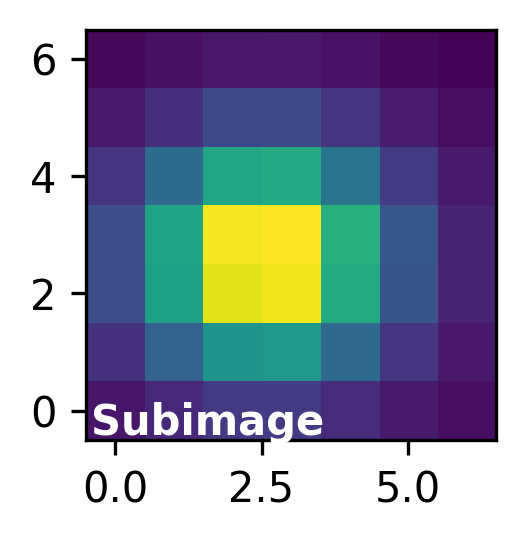

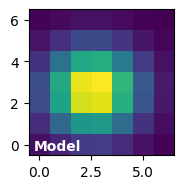

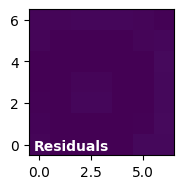

2025-02-25 09:15:34,135 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:15:34,135 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['y'].values[maskl] = median_values[1]



FWHM_y = 3.264718758839574
FWHM_x = 3.5374899241788804 

centroid y = 16.583042365962715
centroid x = 21.56380571232434
centroid y subim = 2.5830423659627146
centroid x subim = 2.56380571232434 

amplitude = 33104622799.50106
theta = 1.2275212124029076
number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_ifua_psf_ch2-medium_s3d: (22,17)
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
New shape: (7, 7)


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1124/1124 [00:01<00:00, 783.83it/s]
2025-02-25 09:15:39,702 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:15:39,702 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_ifua_psf_ch2-medium_s3d: (22,17)
*** Recentering /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-long_s3d ***
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2025-02-25 09:15:43
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
frames
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:02

Shifts in X and Y
0.0 0.0
-0.009999999776482582 0.0
-0.019999999552965164 0.0
-0.029999999329447746 0.0
-0.03999999910593033 0.0
-0

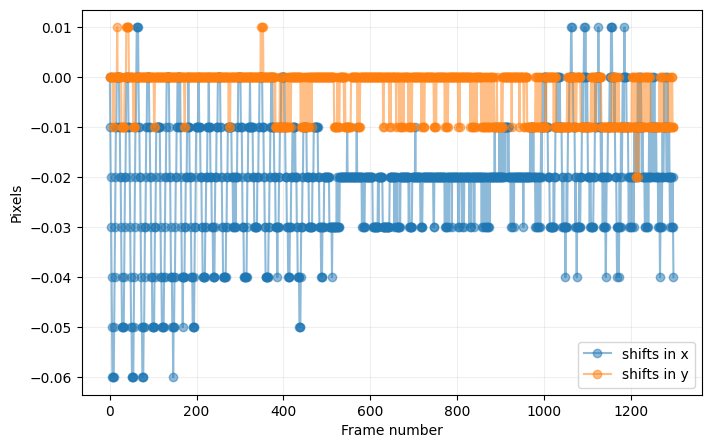

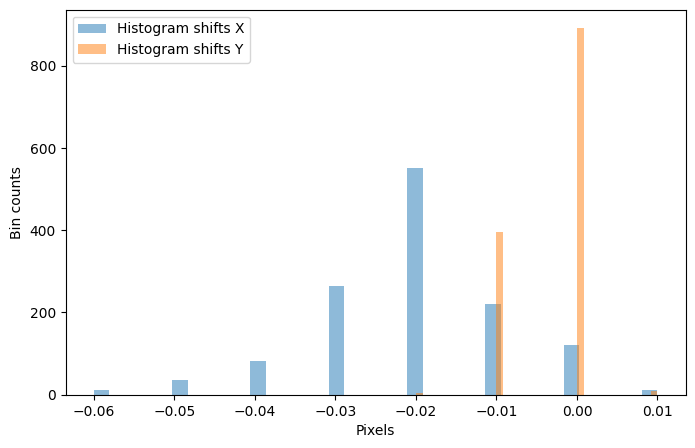

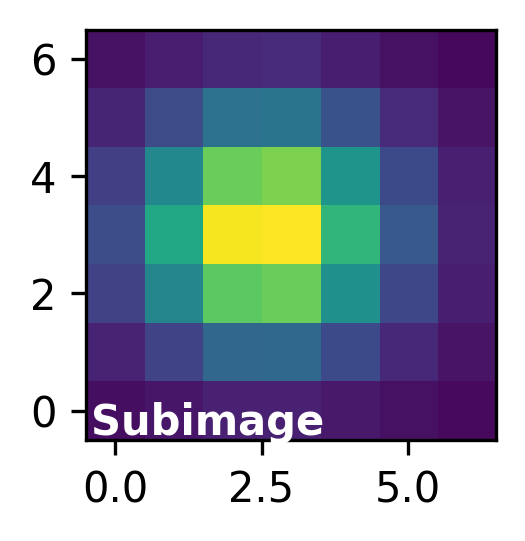

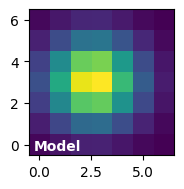

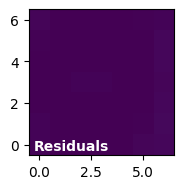

2025-02-25 09:15:47,524 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:15:47,524 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['y'].values[maskl] = median_values[1]



FWHM_y = 3.370043732518142
FWHM_x = 3.6054192132451606 

centroid y = 17.047226865498402
centroid x = 20.578194971030072
centroid y subim = 3.0472268654984016
centroid x subim = 2.578194971030071 

amplitude = 48846958330.21308
theta = 0.9213999415470115
number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_ifua_psf_ch2-long_s3d: (21,17)
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
New shape: (7, 7)


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1300/1300 [00:01<00:00, 770.92it/s]
2025-02-25 09:15:54,640 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:15:54,640 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_ifua_psf_ch2-long_s3d: (21,17)
*** Recentering /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch3-short_s3d ***
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2025-02-25 09:15:57
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
frames
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:01

Shifts in X and Y
0.0 0.0
-0.019999999552965164 0.0
-0.019999999552965164 0.0
-0.05000000074505806 0.0
-0.07000000029802322 0.0
-0.0

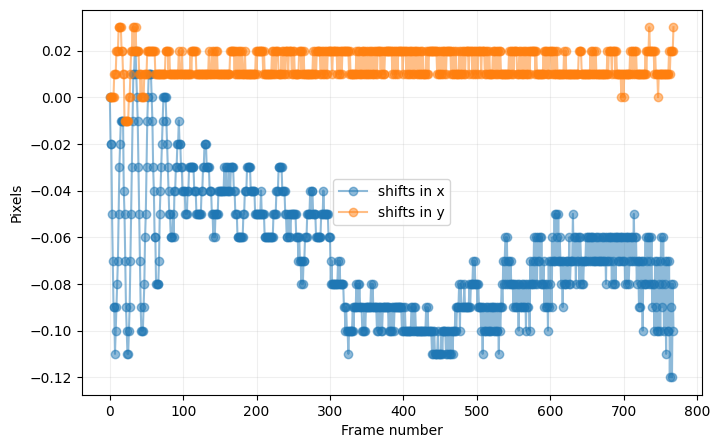

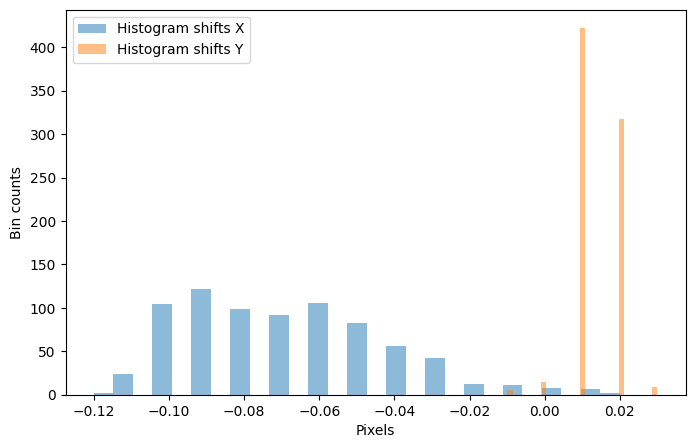

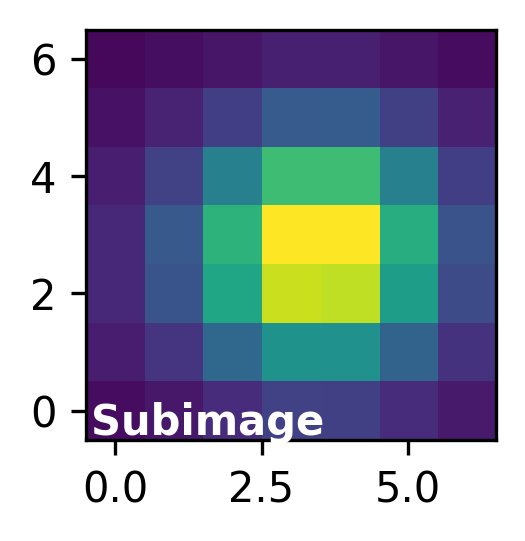

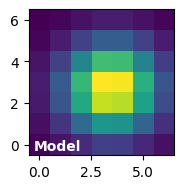

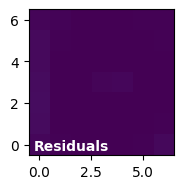

2025-02-25 09:16:00,387 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:16:00,387 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['y'].values[maskl] = median_values[1]



FWHM_y = 3.48271345969549
FWHM_x = 3.6362097599972882 

centroid y = 21.704431325158687
centroid x = 25.459717390618277
centroid y subim = 2.704431325158687
centroid x subim = 3.4597173906182754 

amplitude = 4752237636.5079155
theta = 7.099228387340156
number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_ifua_psf_ch3-short_s3d: (25,22)
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
New shape: (7, 7)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 769/769 [00:01<00:00, 764.65it/s]
2025-02-25 09:16:04,465 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:16:04,466 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

number of bad center positions: 6
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_ifua_psf_ch3-short_s3d: (26,22)
*** Recentering /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch3-medium_s3d ***
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2025-02-25 09:16:07
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
frames
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:01

Shifts in X and Y
0.0 0.0
0.0 0.0
0.009999999776482582 0.0
0.009999999776482582 0.0
0.009999999776482582 0.0
0.009999999776482582 

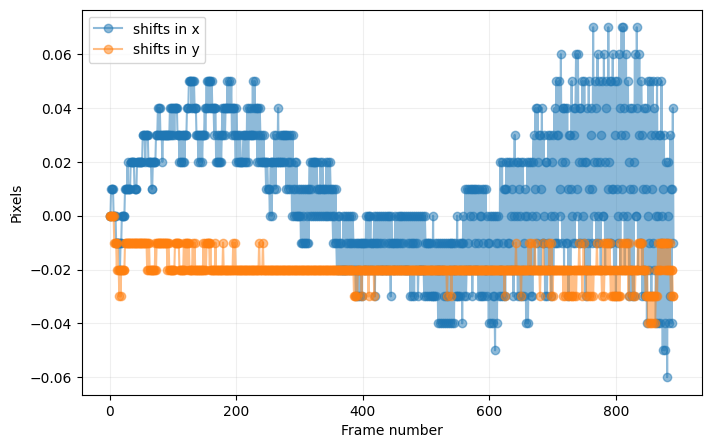

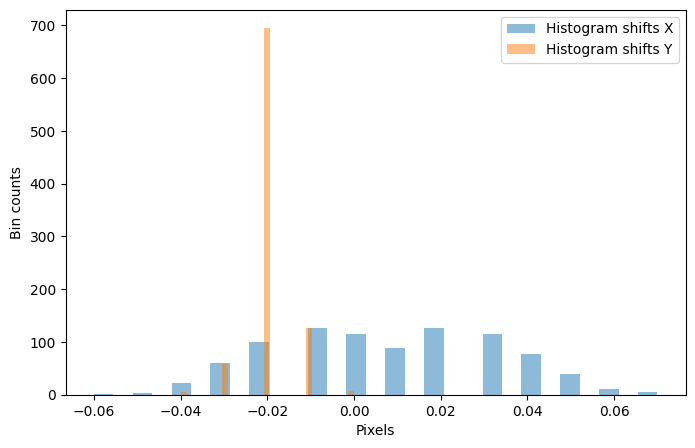

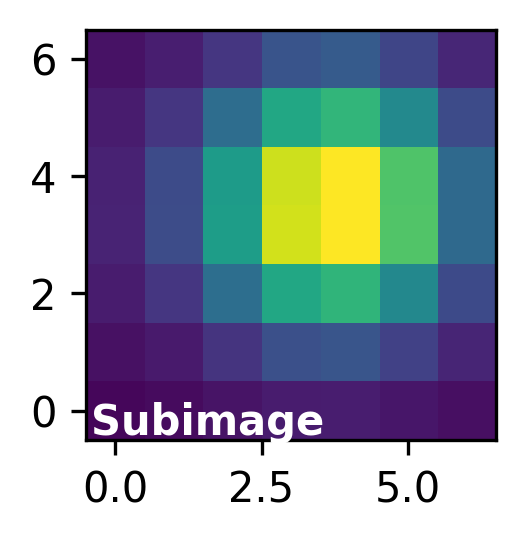

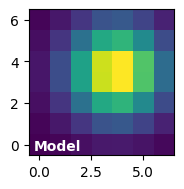

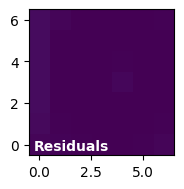

2025-02-25 09:16:09,919 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:16:09,920 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['y'].values[maskl] = median_values[1]



FWHM_y = 3.628367689768355
FWHM_x = 3.741892755723308 

centroid y = 20.50555652592305
centroid x = 25.700553317205312
centroid y subim = 3.5055565259230517
centroid x subim = 3.70055331720531 

amplitude = 3135614785.818204
theta = 2.612342250341689
number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_ifua_psf_ch3-medium_s3d: (26,21)
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
New shape: (7, 7)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 892/892 [00:01<00:00, 775.08it/s]
2025-02-25 09:16:14,530 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:16:14,530 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_ifua_psf_ch3-medium_s3d: (26,21)
*** Recentering /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch3-long_s3d ***
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2025-02-25 09:16:17
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
frames
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:01

Shifts in X and Y
0.0 0.0
0.0 0.0
0.009999999776482582 0.0
0.019999999552965164 0.0
0.009999999776482582 0.0
0.029999999329447746 -

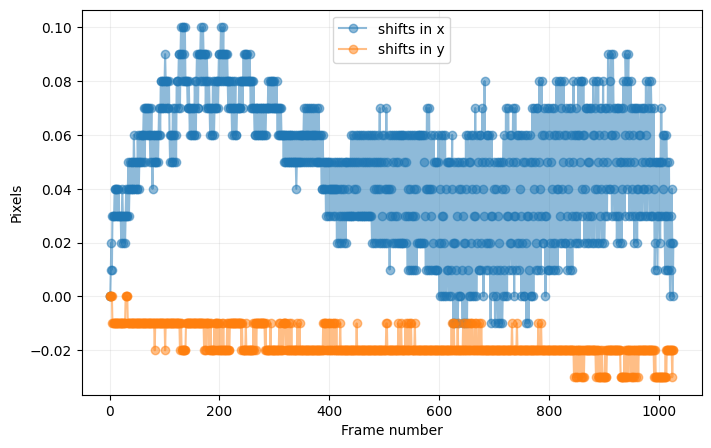

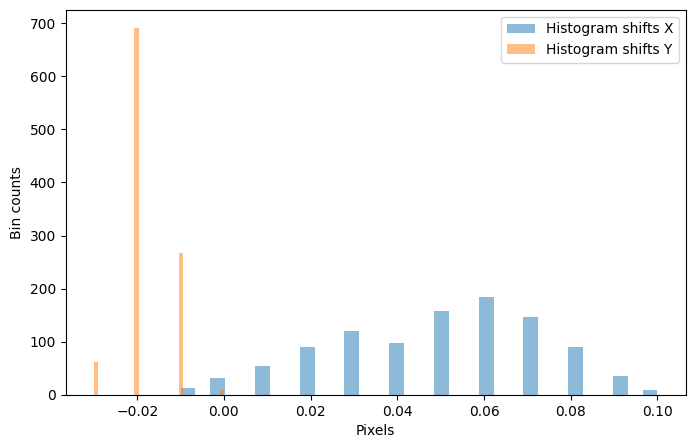

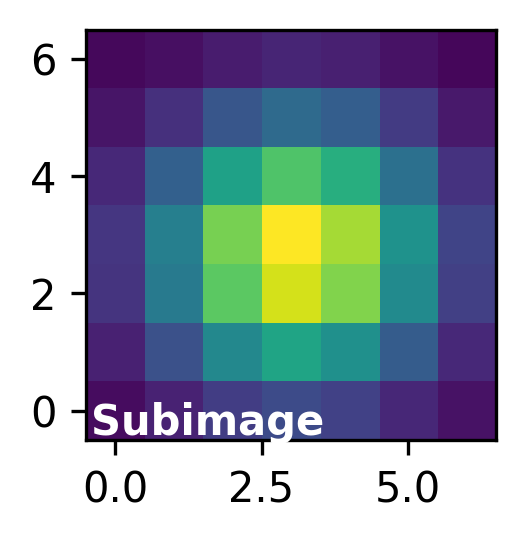

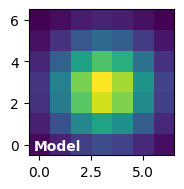

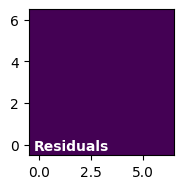

2025-02-25 09:16:20,763 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:16:20,763 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['y'].values[maskl] = median_values[1]



FWHM_y = 3.7764868658752326
FWHM_x = 3.928089380932849 

centroid y = 20.67983614743281
centroid x = 25.10788028057891
centroid y subim = 2.6798361474328094
centroid x subim = 3.107880280578909 

amplitude = 6877364092.849796
theta = 3.8205451589535273
number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_ifua_psf_ch3-long_s3d: (25,21)
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
New shape: (7, 7)


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1028/1028 [00:01<00:00, 796.09it/s]
2025-02-25 09:16:26,083 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:16:26,083 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_ifua_psf_ch3-long_s3d: (25,21)
*** Recentering /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch4-short_s3d ***
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2025-02-25 09:16:28
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
frames
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:01

Shifts in X and Y
0.0 0.0
0.0 0.0
0.0 0.0
0.009999999776482582 0.0
0.009999999776482582 0.0
0.009999999776482582 0.0
0.0099999997764

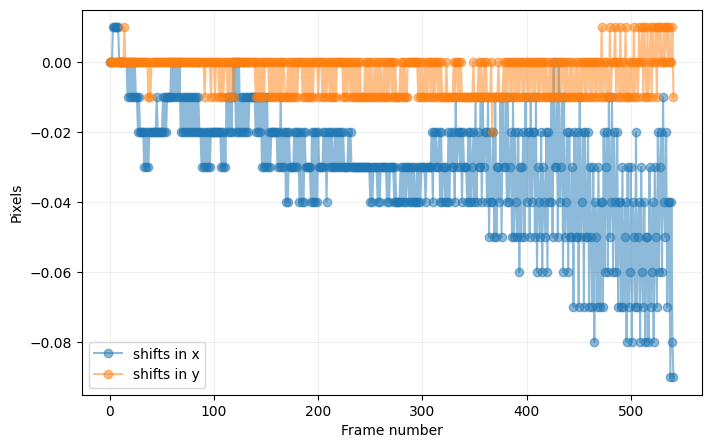

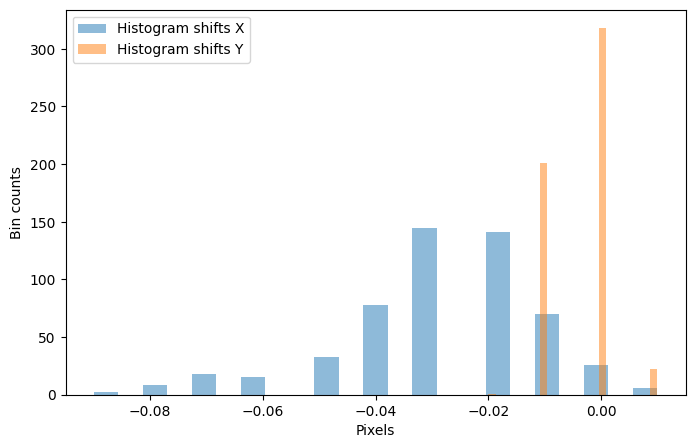

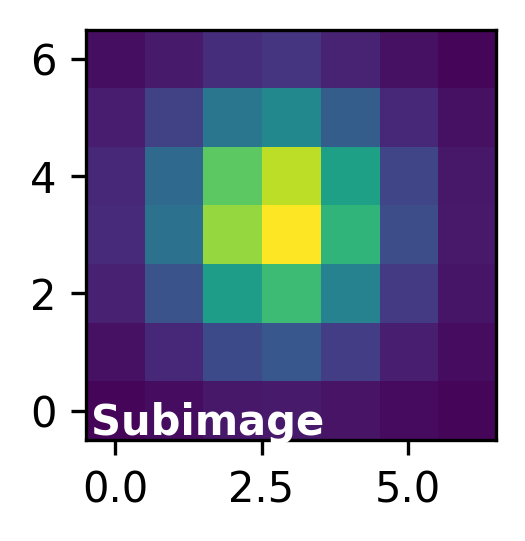

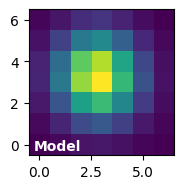

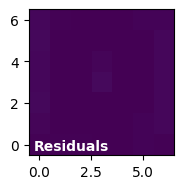

2025-02-25 09:16:30,015 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:16:30,015 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['y'].values[maskl] = median_values[1]



FWHM_y = 3.321318240656569
FWHM_x = 3.1065685314398164 

centroid y = 13.261383346193053
centroid x = 13.793350632976162
centroid y subim = 3.261383346193053
centroid x subim = 2.7933506329761624 

amplitude = 1859562691.2382262
theta = 8.460458870352847
number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_ifua_psf_ch4-short_s3d: (14,13)
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
New shape: (7, 7)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 542/542 [00:00<00:00, 661.79it/s]
2025-02-25 09:16:32,585 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:16:32,585 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_ifua_psf_ch4-short_s3d: (14,13)
*** Recentering /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch4-medium_s3d ***
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2025-02-25 09:16:34
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
frames
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:01

Shifts in X and Y
0.0 0.0
0.019999999552965164 0.009999999776482582
0.0 0.009999999776482582
0.009999999776482582 0.0
0.0099999997

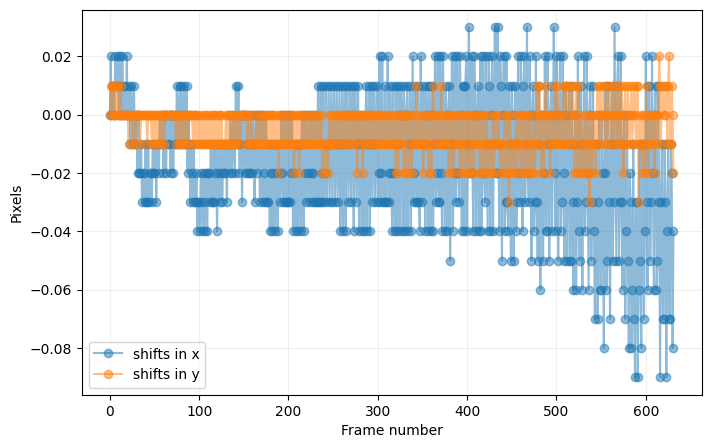

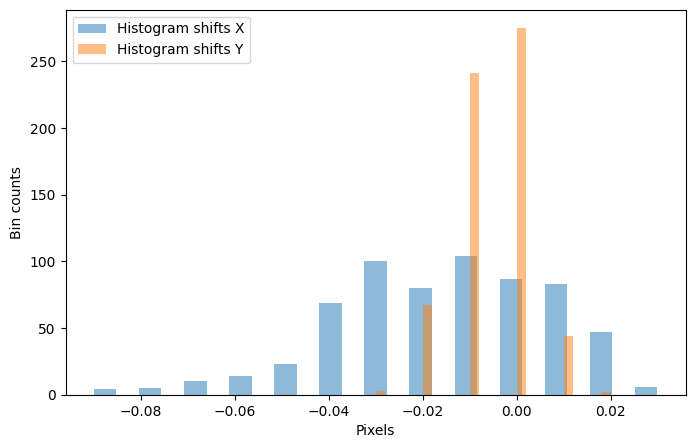

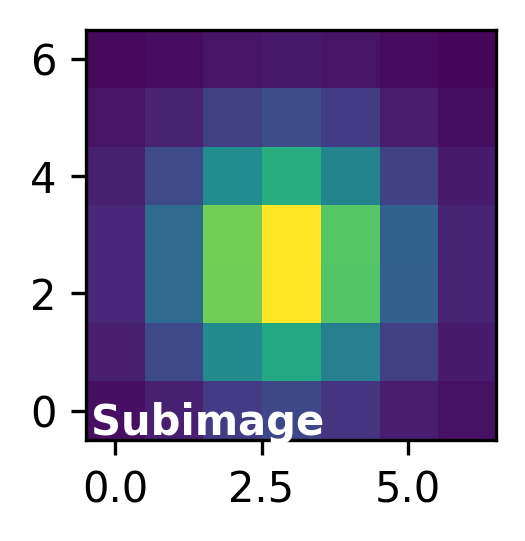

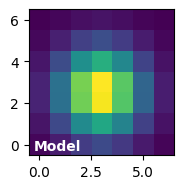

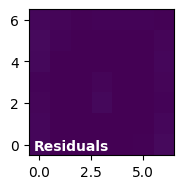

2025-02-25 09:16:36,119 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:16:36,119 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['y'].values[maskl] = median_values[1]



FWHM_y = 3.4002598251711045
FWHM_x = 3.2578222279530142 

centroid y = 13.527491723242212
centroid x = 13.93693717168203
centroid y subim = 2.527491723242212
centroid x subim = 2.936937171682031 

amplitude = 944059459.2438638
theta = 0.46001847438875487
number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_ifua_psf_ch4-medium_s3d: (14,14)
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
New shape: (7, 7)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 632/632 [00:01<00:00, 615.25it/s]
2025-02-25 09:16:39,125 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:16:39,125 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

number of bad center positions: 0
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_ifua_psf_ch4-medium_s3d: (14,14)
*** Recentering /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch4-long_s3d ***
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2025-02-25 09:16:41
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
frames
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:01

Shifts in X and Y
0.0 0.0
-0.009999999776482582 0.0
-0.019999999552965164 0.0
-0.009999999776482582 -0.009999999776482582
-0.009999

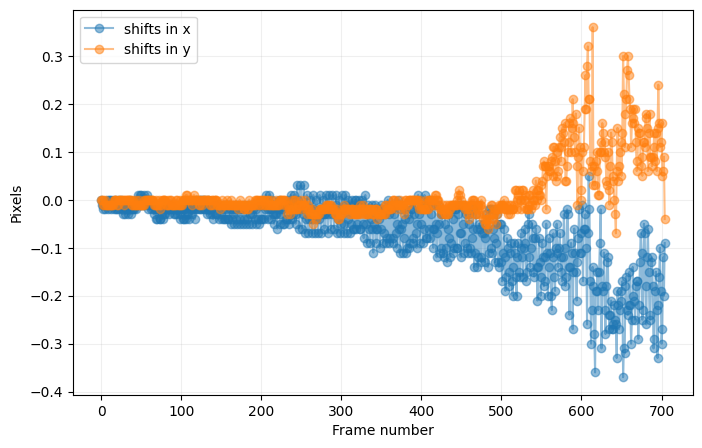

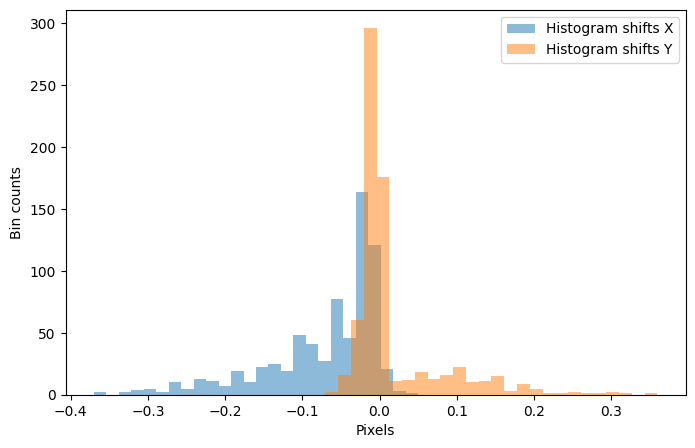

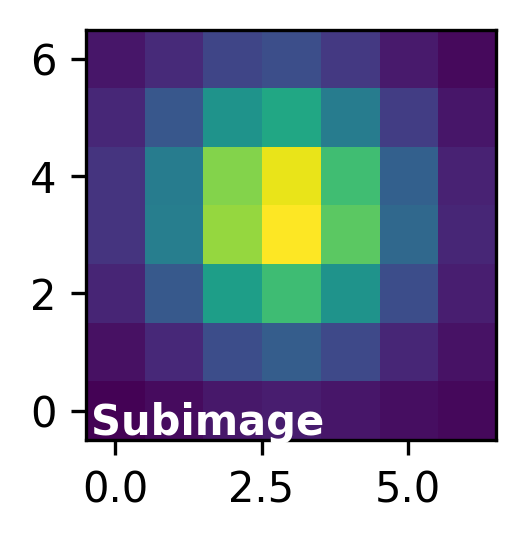

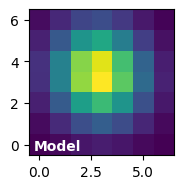

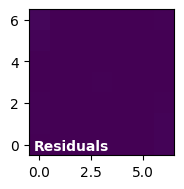

FWHM_y = 3.658163050159565
FWHM_x = 3.4399556788337833 

centroid y = 13.399715737166133
centroid x = 13.857519826521742
centroid y subim = 3.399715737166133
centroid x subim = 2.8575198265217416 

amplitude = 418905481.3368529
theta = 22.777152613430683


2025-02-25 09:16:42,947 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:16:42,948 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['y'].values[maskl] = median_values[1]



number of bad center positions: 6
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_ifua_psf_ch4-long_s3d: (14,13)
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
New shape: (7, 7)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 705/705 [00:01<00:00, 652.00it/s]
2025-02-25 09:16:46,247 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:350: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  fit_results['x'].values[maskl] = median_values[0]

2025-02-25 09:16:46,247 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/phot.py:351: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

number of bad center positions: 27
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00
Centroid median xy pixel coordinates for Level3_ifua_psf_ch4-long_s3d: (14,13)


In [64]:
discard_idx_band = []
if discard_band_cen is not None:
    for dd in discard_band_cen:
        discard_idx_band.append(convert_band_to_idx(dd)) 
cxy_med_ifua = []
cx_all_ifua = []
cy_all_ifua = []
for ff, file in enumerate(calfiles_ifua):
    bname = splitext(file)[0]
    print("*** Recentering {} ***".format(bname))
    if bname[-5:] == '_bpc3':
        bname = bname[:-5]
    outname = bname+'_cen.fits'
    if ff in discard_idx_band:
        os.system("cp {} {}".format(file, outname))
        cube = fits.getdata(file, 'SCI')
        cy, cx = frame_center(cube)
        cxy_med_ifua.append((cx,cy))
    else:
        cen_res = recenter_cubes(file, sig=5, method=cen_method, imlib=imlib, debug=show_plots, 
                                 crop_sz=crop_sz, suffix='_cen', verbose=True, overwrite=True,
                                 full_output=True)
        cxy_med_ifua.append(cen_res[:2])
        cx_all_ifua.append(cen_res[2])
        cy_all_ifua.append(cen_res[3])
        if make_centroid_and_fwhm_plots:
            cen_res = recenter_cubes(file, sig=5, method='gauss', imlib=imlib, debug=False, 
                                     crop_sz=crop_sz, suffix='_gauss', verbose=True, overwrite=True,
                                     full_output=True)
        if show_plots:
            plt.show()
    ## if no centering just copy input file
#         if cen_method is None:
#             os.system("cp {} {}".format(file, outname))
#    os.system("cp {} {}/.".format(outname, fin3_dir)) --> NOW done after potential residual BKG subtraction
if discard_band_cen is not None:
    # for bands with very low signal from the star, replace centroid coordinates with median of good coordinates in the same channel
    for ff in discard_idx_band:
        msg = "WARNING: centroid in band#{} will be replaced by ".format(ff)
        if ff%3 == 0:
            good_ff = [ff_tmp+ff for ff_tmp in [1,2] if ff_tmp+ff not in discard_idx_band]
        elif ff%3 == 1:
            good_ff = [ff_tmp+ff for ff_tmp in [-1,1] if ff_tmp+ff not in discard_idx_band]
        else:
            good_ff = [ff_tmp+ff for ff_tmp in [-2,-1] if ff_tmp+ff not in discard_idx_band]
        if len(good_ff)==2:
            cxy_med_ifua[ff] = (np.median([cxy_med_ifua[good_ff[0]][0],cxy_med_ifua[good_ff[1]][0]]),
                                np.median([cxy_med_ifua[good_ff[0]][1],cxy_med_ifua[good_ff[1]][1]]))
            msg += "median of centroid inferred in bands# {} and {}: {}".format(good_ff[0], good_ff[1], cxy_med_ifua[ff])
        elif len(good_ff)==1:
            cxy_med_ifua[ff] = (cxy_med_ifua[good_ff[0]][0], cxy_med_ifua[good_ff[0]][1])
            msg += "centroid inferred in band# {}: {}".format(good_ff[0], cxy_med_ifua[ff])
        else:
            msg += "center of field of view: {}".format(cxy_med_ifua[ff])
        print(msg)

In [65]:
write_fits(join(spec3_dir,"cxy_med_ifua.fits"), np.array(cxy_med_ifua)) # write a first time to auto-generate some header keywords
_, head = open_fits(join(spec3_dir,"cxy_med_ifua.fits"), header=True)
chs = [1, 2, 3, 4]
bands = ['SHORT', 'MEDIUM','LONG']
c = 0    
print("Assumed XY coordinates for source spectrum extraction in the IFU-aligned cubes: ")
for i in chs:
    for j in bands:
        print("CH.{} {}: {}".format(i, j, cxy_med_ifua[c]))
        c+=1
        head['C_PAIR{}'.format(c)] = 'CH.{} {}'.format(i,j)
write_fits(join(spec3_dir,"cxy_med_ifua.fits"), np.array(cxy_med_ifua), header=head)
os.system("cp {} {}/.".format(join(spec3_dir,"cxy_med_ifua.fits"), fin3_dir))

FITS file successfully overwritten
FITS HDU-0 data and header successfully loaded. Data shape: (12, 2)
Assumed XY coordinates for source spectrum extraction in the IFU-aligned cubes: 
CH.1 SHORT: (23.72321327612675, 22.95927954899827)
CH.1 MEDIUM: (23.157005818798588, 22.12595050533582)
CH.1 LONG: (23.341481979955518, 24.273262617092918)
CH.2 SHORT: (20.82494066825802, 18.300801678946137)
CH.2 MEDIUM: (21.56380571232434, 16.583042365962715)
CH.2 LONG: (20.578194971030072, 17.047226865498402)
CH.3 SHORT: (25.459717390618277, 21.704431325158687)
CH.3 MEDIUM: (25.700553317205312, 20.50555652592305)
CH.3 LONG: (25.10788028057891, 20.67983614743281)
CH.4 SHORT: (13.793350632976162, 13.261383346193053)
CH.4 MEDIUM: (13.93693717168203, 13.527491723242212)
CH.4 LONG: (13.857519826521742, 13.399715737166133)
FITS file successfully overwritten


0

### 5.3.2. Residual background subtraction

**For skyalign cubes:** 

In [66]:
# List relevant files
calfiles=sorted(glob.glob(join(spec3_dir,'Level3{}*{}_cen.fits'.format(suffix[0],suf))))
calfiles = sort_files_wl(calfiles)
print(len(calfiles))

12


*** Removing residual background in Level3_psf_ch1-short_s3d_cen.fits ***
Smoothing background estimates using a Sav-Gol filter 
of window 51 from ch. 0 to 1050
*** CH. 1 SHORT***


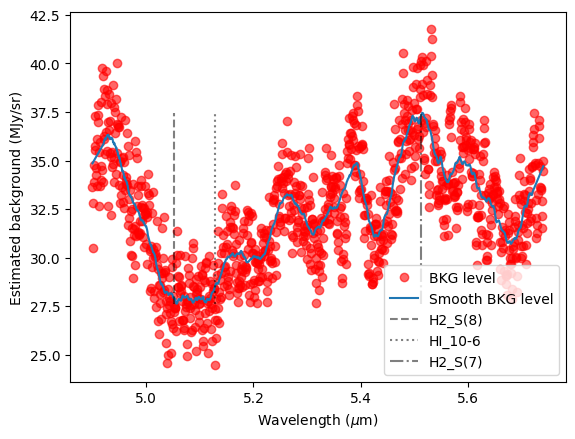

*** Removing residual background in Level3_psf_ch1-medium_s3d_cen.fits ***
Smoothing background estimates using a Sav-Gol filter 
of window 51 from ch. 0 to 1213
*** CH. 1 MEDIUM***


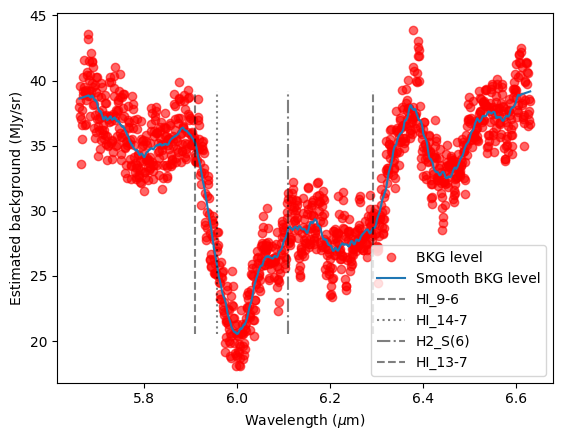

*** Removing residual background in Level3_psf_ch1-long_s3d_cen.fits ***
Smoothing background estimates using a Sav-Gol filter 
of window 51 from ch. 0 to 1400
*** CH. 1 LONG***


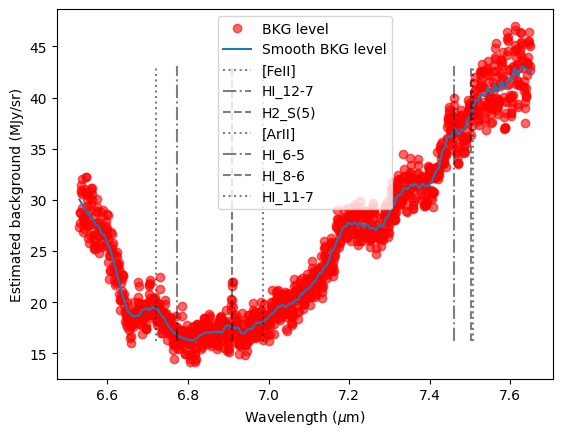

*** Removing residual background in Level3_psf_ch2-short_s3d_cen.fits ***
Smoothing background estimates using a Sav-Gol filter 
of window 51 from ch. 0 to 970
*** CH. 2 SHORT***


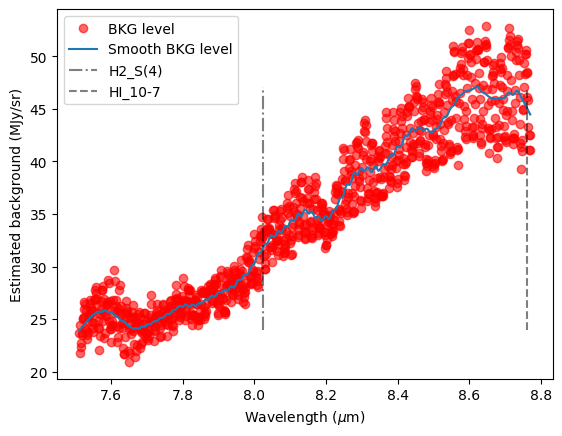

*** Removing residual background in Level3_psf_ch2-medium_s3d_cen.fits ***
Smoothing background estimates using a Sav-Gol filter 
of window 51 from ch. 0 to 1124
*** CH. 2 MEDIUM***


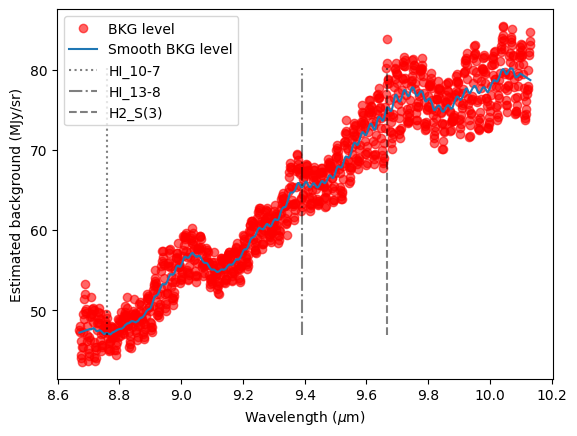

*** Removing residual background in Level3_psf_ch2-long_s3d_cen.fits ***
Smoothing background estimates using a Sav-Gol filter 
of window 51 from ch. 0 to 1300
*** CH. 2 LONG***


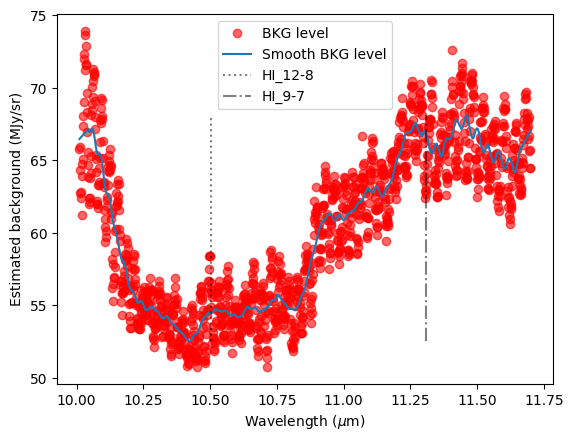

*** Removing residual background in Level3_psf_ch3-short_s3d_cen.fits ***
Smoothing background estimates using a Sav-Gol filter 
of window 51 from ch. 0 to 769
*** CH. 3 SHORT***


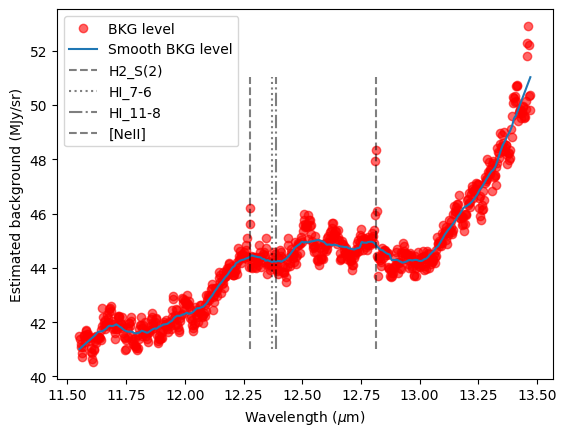

*** Removing residual background in Level3_psf_ch3-medium_s3d_cen.fits ***
Smoothing background estimates using a Sav-Gol filter 
of window 51 from ch. 0 to 892
*** CH. 3 MEDIUM***


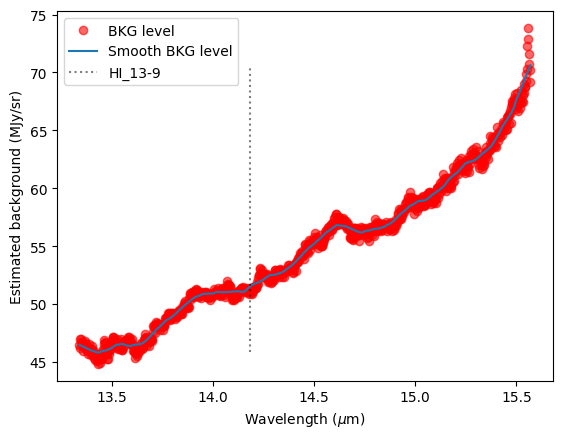

*** Removing residual background in Level3_psf_ch3-long_s3d_cen.fits ***
Smoothing background estimates using a Sav-Gol filter 
of window 51 from ch. 0 to 1028
*** CH. 3 LONG***


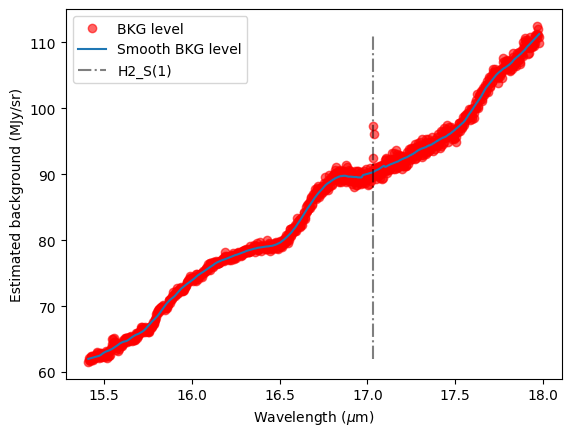

*** Removing residual background in Level3_psf_ch4-short_s3d_cen.fits ***
Smoothing background estimates using a Sav-Gol filter 
of window 51 from ch. 0 to 542
*** CH. 4 SHORT***


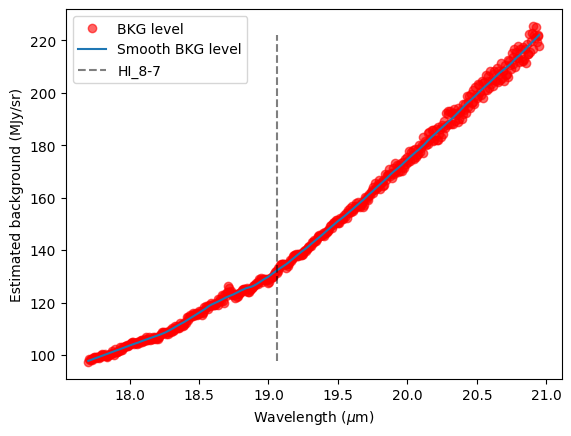

*** Removing residual background in Level3_psf_ch4-medium_s3d_cen.fits ***
Smoothing background estimates using a Sav-Gol filter 
of window 51 from ch. 0 to 632
*** CH. 4 MEDIUM***


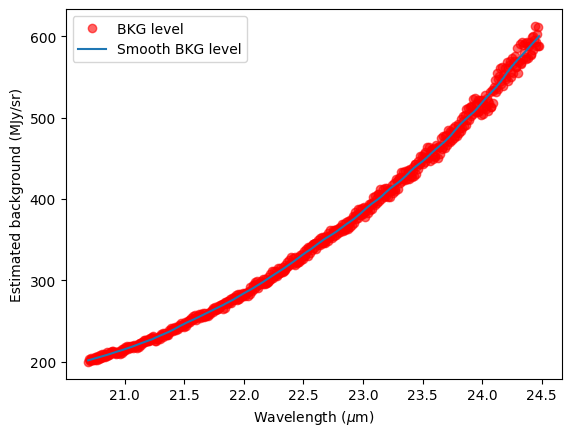

*** Removing residual background in Level3_psf_ch4-long_s3d_cen.fits ***


2025-02-25 09:16:52,802 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/bkg.py:701: RuntimeWarning: All-NaN slice encountered
  rbgsub[ch] = np.nanmedian(cube[ch]*full_mask[ch])



Smoothing background estimates using a Sav-Gol filter 
of window 51 from ch. 0 to 717
*** CH. 4 LONG***


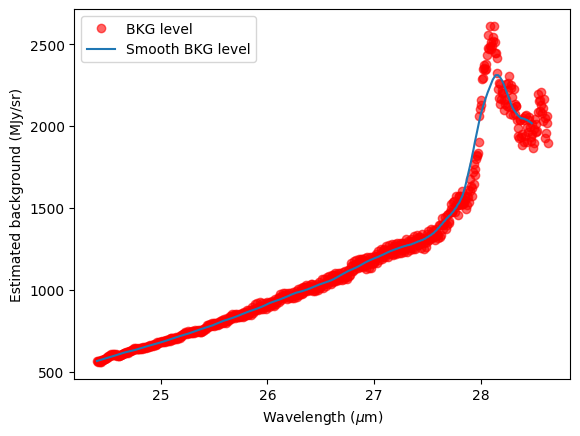

In [67]:
if subtract_residual_bkg or make_contsub_images:
    line_styles = ['--', ':', '-.']
    cl = 0
    nls = len(line_styles)
    for f, file in enumerate(calfiles):
        file_x1d = file.replace('{}_cen'.format(suf),'x1d')
        bkg_lev = res_bkg_sub(file, file_x1d, cxy_med[f], r_min=r_min_res_bg_sub[f], suffix='_rbgsub', 
                              verbose=True, smooth_bkg=smooth_bkg, perc=perc_rbg, overwrite=overwrite_53)
        print("*** CH. {} {}***".format(1+f//3, bands[f%3]))
        plt.figure()
        plt.plot(bkg_lev[0], bkg_lev[1], 'ro', alpha=0.6, label="BKG level")
        if smooth_bkg:
            plt.plot(bkg_lev[0], bkg_lev[-1], label="Smooth BKG level")
        for li, line in enumerate(test_lines):
            if line >= bkg_lev[0][0] and line <= bkg_lev[0][-1]:
                minsh = np.amin(bkg_lev[-1])
                maxsh = np.amax(bkg_lev[-1])
                plt.plot([line]*10, np.linspace(minsh, maxsh, 10), 'k'+line_styles[cl%nls], label=test_labels[li], alpha=0.5)
                cl += 1
        plt.xlabel(r"Wavelength ($\mu$m)")
        plt.ylabel(r"Estimated background (MJy/sr)")
        plt.legend()
        plt.show()

In [68]:
plt.close()

**For ifualign cubes:**

In [69]:
# List relevant files
calfiles_ifua=sorted(glob.glob(join(spec3_dir,'Level3_ifua{}*{}_cen.fits'.format(suffix[0], suf))))
calfiles_ifua = sort_files_wl(calfiles_ifua)
print(len(calfiles_ifua))

12


In [70]:
bands_abc = ['A', 'B', 'C']

*** Removing residual background in Level3_ifua_psf_ch1-short_s3d_cen.fits ***
Smoothing background estimates using a Sav-Gol filter 
of window 51 from ch. 0 to 1050
*** CH. 1 A***


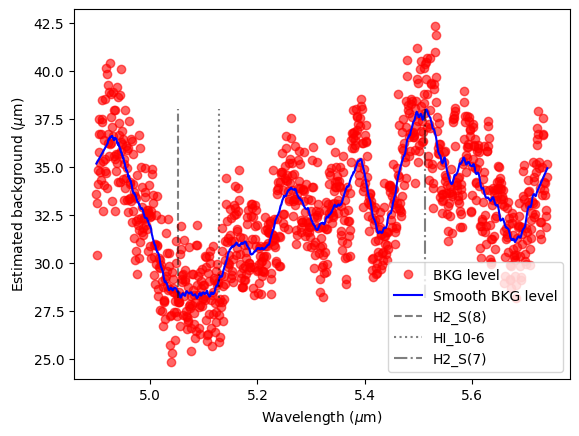

*** Removing residual background in Level3_ifua_psf_ch1-medium_s3d_cen.fits ***
Smoothing background estimates using a Sav-Gol filter 
of window 51 from ch. 0 to 1213
*** CH. 1 B***


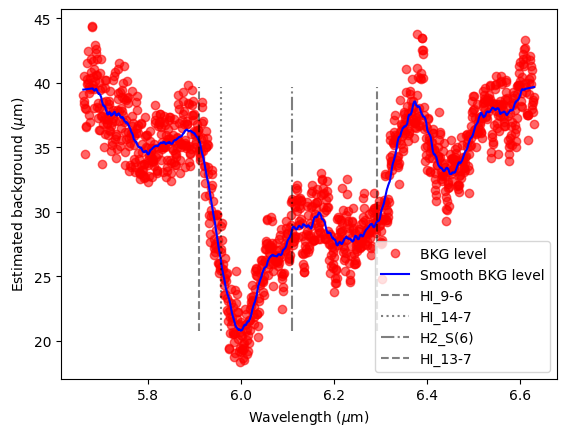

*** Removing residual background in Level3_ifua_psf_ch1-long_s3d_cen.fits ***
Smoothing background estimates using a Sav-Gol filter 
of window 51 from ch. 0 to 1400
*** CH. 1 C***


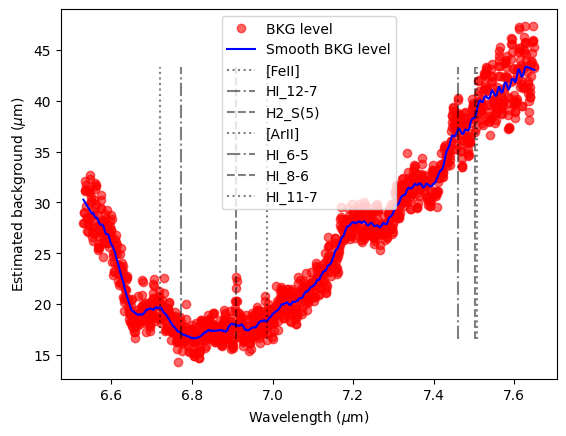

*** Removing residual background in Level3_ifua_psf_ch2-short_s3d_cen.fits ***
Smoothing background estimates using a Sav-Gol filter 
of window 51 from ch. 0 to 970
*** CH. 2 A***


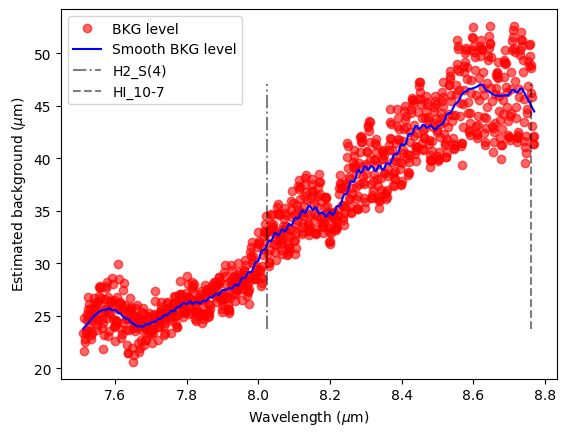

*** Removing residual background in Level3_ifua_psf_ch2-medium_s3d_cen.fits ***
Smoothing background estimates using a Sav-Gol filter 
of window 51 from ch. 0 to 1124
*** CH. 2 B***


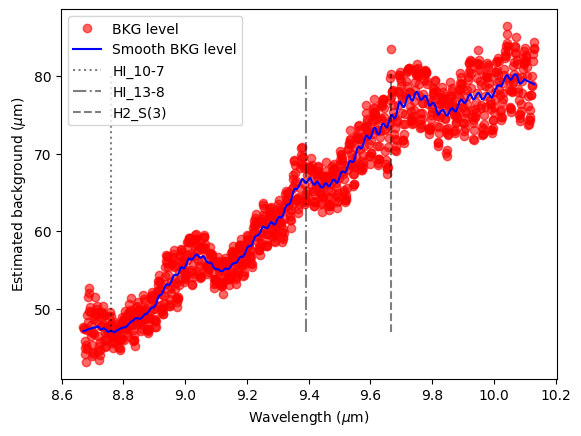

*** Removing residual background in Level3_ifua_psf_ch2-long_s3d_cen.fits ***
Smoothing background estimates using a Sav-Gol filter 
of window 51 from ch. 0 to 1300
*** CH. 2 C***


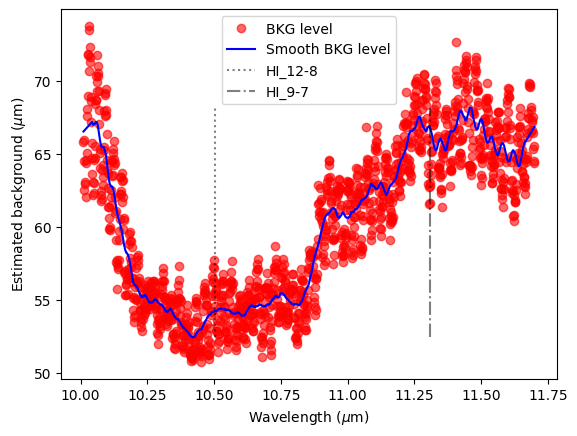

*** Removing residual background in Level3_ifua_psf_ch3-short_s3d_cen.fits ***
Smoothing background estimates using a Sav-Gol filter 
of window 51 from ch. 0 to 769
*** CH. 3 A***


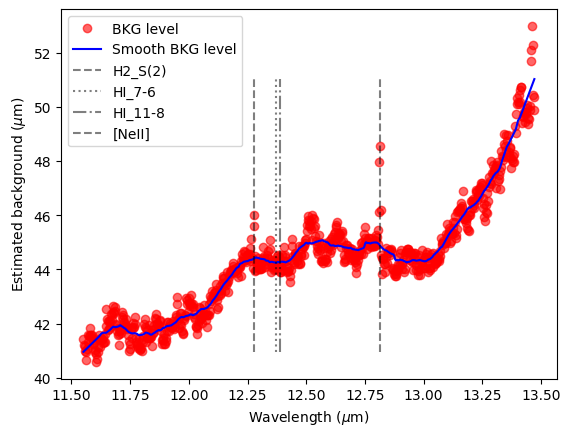

*** Removing residual background in Level3_ifua_psf_ch3-medium_s3d_cen.fits ***
Smoothing background estimates using a Sav-Gol filter 
of window 51 from ch. 0 to 892
*** CH. 3 B***


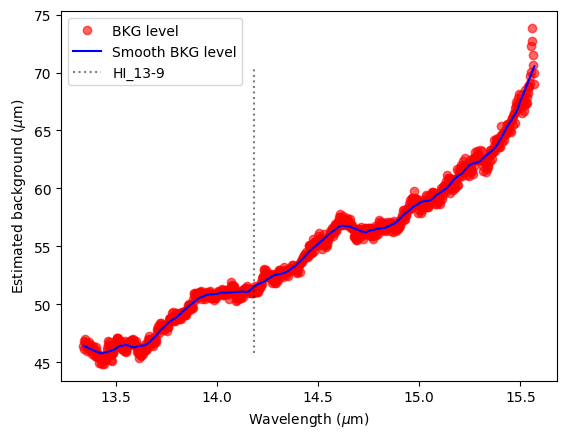

*** Removing residual background in Level3_ifua_psf_ch3-long_s3d_cen.fits ***
Smoothing background estimates using a Sav-Gol filter 
of window 51 from ch. 0 to 1028
*** CH. 3 C***


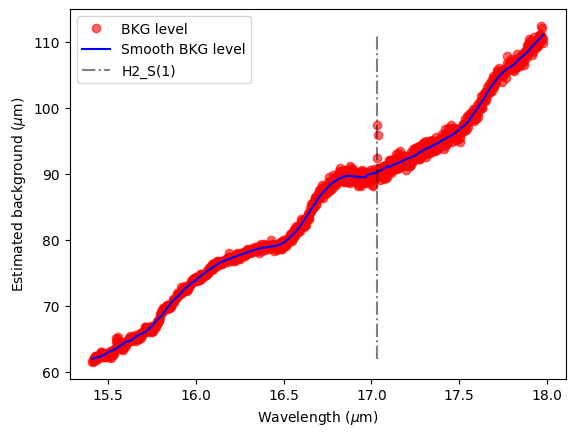

*** Removing residual background in Level3_ifua_psf_ch4-short_s3d_cen.fits ***
Smoothing background estimates using a Sav-Gol filter 
of window 51 from ch. 0 to 542
*** CH. 4 A***


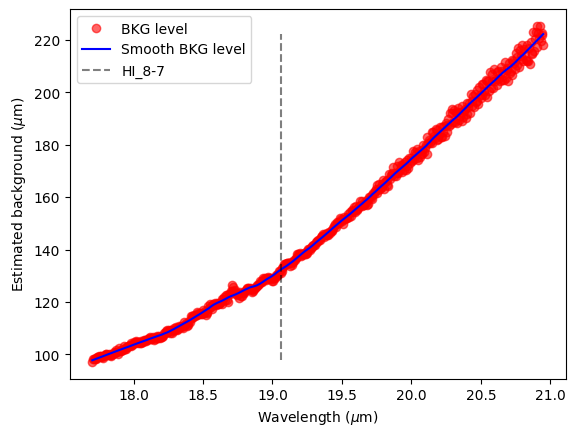

*** Removing residual background in Level3_ifua_psf_ch4-medium_s3d_cen.fits ***
Smoothing background estimates using a Sav-Gol filter 
of window 51 from ch. 0 to 632
*** CH. 4 B***


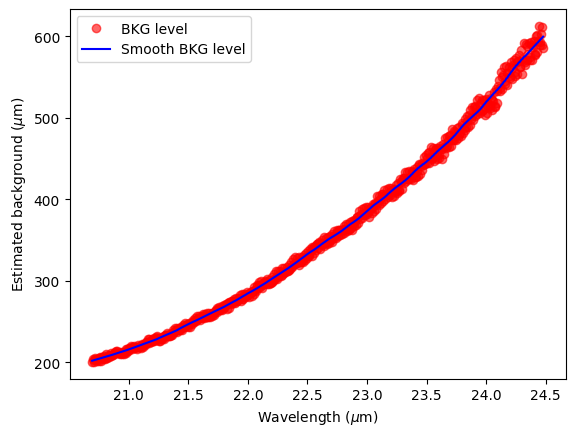

*** Removing residual background in Level3_ifua_psf_ch4-long_s3d_cen.fits ***


2025-02-25 09:16:57,555 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/minds/bkg.py:701: RuntimeWarning: All-NaN slice encountered
  rbgsub[ch] = np.nanmedian(cube[ch]*full_mask[ch])



Smoothing background estimates using a Sav-Gol filter 
of window 51 from ch. 0 to 717
*** CH. 4 C***


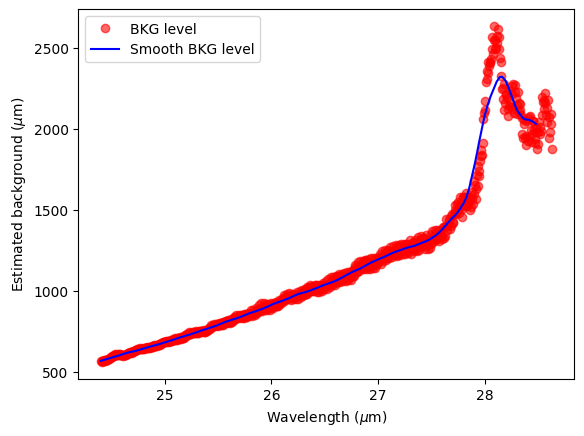

In [71]:
if subtract_residual_bkg or make_contsub_images:
    line_styles = ['--', ':', '-.']
    cl = 0
    nls = len(line_styles)
    for f, file in enumerate(calfiles_ifua):
        file_x1d = file.replace('{}_cen'.format(suf),'x1d')
        bkg_lev = res_bkg_sub(file, file_x1d, cxy_med_ifua[f], r_min=r_min_res_bg_sub[f], suffix='_rbgsub', 
                              verbose=True, smooth_bkg=smooth_bkg, perc=perc_rbg, overwrite=overwrite_53)
        print("*** CH. {} {}***".format(1+f//3, bands_abc[f%3]))
        plt.figure()
        plt.plot(bkg_lev[0], bkg_lev[1], 'ro', alpha=0.6, label="BKG level")
        if smooth_bkg:
            plt.plot(bkg_lev[0], bkg_lev[-1], 'b', label="Smooth BKG level")
        for li, line in enumerate(test_lines):
            if line >= bkg_lev[0][0] and line <= bkg_lev[0][-1]:
                minsh = np.amin(bkg_lev[-1])
                maxsh = np.amax(bkg_lev[-1])
                plt.plot([line]*10, np.linspace(minsh, maxsh, 10), 'k'+line_styles[cl%nls], label=test_labels[li], alpha=0.5)
                cl += 1
        plt.xlabel(r"Wavelength ($\mu$m)")
        plt.ylabel(r"Estimated background ($\mu$m)")
        plt.legend()
        plt.savefig(fig_dir+"Estimated_residual_background_CH{}{}.pdf".format(1+f//3, bands[f%3]))
        plt.show()

In [72]:
if subtract_residual_bkg or make_contsub_images:
    suf_bkg = '_rbgsub'
else:
    suf_bkg = ''

In [73]:
calfiles_ifua

['/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-short_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-medium_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-long_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-short_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-medium_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-long_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch3-short_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch3-medium_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch3-lon

Write s3d cubes after potential subtraction of residual background level in final output directory:

In [74]:
for ff, file in enumerate(calfiles):
    bname = splitext(file)[0]
    outname = bname+'{}.fits'.format(suf_bkg)
    print("Copying to final directory: {}".format(outname))
    os.system("cp {} {}/.".format(outname, fin3_dir)) #    os.system("cp {} {}/.".format(outname, fin3_dir)) --> NOW done after potential residual BKG subtraction

for ff, file in enumerate(calfiles_ifua):
    bname = splitext(file)[0]
    outname = bname+'{}.fits'.format(suf_bkg)
    print("Copying to final directory: {}".format(outname))
    os.system("cp {} {}/.".format(outname, fin3_dir))

Copying to final directory: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch1-short_s3d_cen_rbgsub.fits
Copying to final directory: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch1-medium_s3d_cen_rbgsub.fits
Copying to final directory: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch1-long_s3d_cen_rbgsub.fits
Copying to final directory: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch2-short_s3d_cen_rbgsub.fits
Copying to final directory: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch2-medium_s3d_cen_rbgsub.fits
Copying to final directory: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch2-long_s3d_cen_rbgsub.fits
Copying to final directory: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch3-short_s3d_cen_rbgsub.fits
Copying to final directory:

### 5.3.3. Aperture photometry + spike filtering

**Using `extract_1d`**

Note 1: the aperture correction factors are not used in `extract_1d` if src_type is defined as EXTENDED.

Note 2: we systematically run `extract_1d` whether it is the desired output or not. In the latter case, it is used to save the manually extracted spectrum into the same format.

In [75]:
def extractspec(filename, outdir, overwrite, cxy=None, autocen=False,
                do_rfc1d_e1d=False, subtract_background=False):
    #print(filename)
    #suffix = make_spec1d_suffix(autocen=autocen, do_rfc1d_e1d=do_rfc1d_e1d, 
    #                            subtract_background=subtract_background)
    suffix = 'x1d_minds'
    if do_rfc1d_e1d:
        suffix += '_rfc1d'
    outfile = splitext(filename)[0]+'_'+suffix+'.fits'

    print(outfile)
    if not isfile(outfile) or overwrite:
        crds_config = Extract1dStep.get_config_from_reference(filename)
        e1d = Extract1dStep.from_config_section(crds_config) # Instantiate the pipeline

        if autocen:
            e1d.ifu_autocen = True
        else:
            e1d.center_xy = list(cxy)
            e1d.ifu_autocen = False
        
        if do_rfc1d_e1d:
            e1d.ifu_rfcorr = True
            
        if overwrite_target_classification:
            e1d.ifu_set_srctype = new_sourcetype
        e1d.ifu_rscale = apsize
        
        e1d.subtract_background = subtract_background
        
        # force the center of the aperture to be at the center of the images (since they've been recentered)
        #if extended:
        #    e1d.apply_apcorr=False
        e1d.suffix = suffix
        e1d.save_results = True 
        e1d.output_dir = outdir
        e1d(filename) # Run the pipeline on the science calibrated files
        
    return outfile, suffix

In [76]:
# List relevant files
calfiles_skya=sorted(glob.glob(join(spec3_dir,'Level3{}*{}_cen.fits'.format(suffix[0], suf)))) #don't take manually sub residual bkg - done better internally
calfiles_skya = sort_files_wl(calfiles_skya)
if bkg_method=='annulus':
    calfiles=sorted(glob.glob(join(spec3_dir,'Level3_ifua{}*{}_cen.fits'.format(suffix[0], suf)))) #don't take manually sub residual bkg - done better internally
else:
    calfiles=sorted(glob.glob(join(spec3_dir,'Level3_ifua{}*{}_cen{}.fits'.format(suffix[0], suf, suf_bkg))))
calfiles = sort_files_wl(calfiles)
bkgfiles=[]
for c in calfiles:
    if bkg_method=='sdither':
        basecal = basename(c).replace('Level3_ifua_psf','Level3_ifua_bkg')
        basecal = basecal.replace('_cen.fits','.fits')
        bkgfiles.append(join(spec3_dir,basecal))
    else:
        bkgfiles.append(None)
print(len(calfiles))

12


Run extractspec a first time without 1D residual fringe correction:

In [77]:
if not psff:
    calfiles_x1d = []
    for f, file in enumerate(calfiles):
        cf, fin_suff = extractspec(file, spec3_dir,
                                   cxy=(cxy_med_ifua[f][0],cxy_med_ifua[f][1]), overwrite=overwrite_53,
                                   autocen=autocen, do_rfc1d_e1d=False, 
                                   subtract_background=(bkg_method == "annulus"))
        calfiles_x1d.append(cf)

/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-short_s3d_cen_x1d_minds.fits


2025-02-25 09:19:08,003 - CRDS - INFO -  Calibration SW Found: jwst 1.17.1 (/Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/jwst-1.17.1.dist-info)
2025-02-25 09:19:12,781 - stpipe - INFO - PARS-EXTRACT1DSTEP parameters found: /Users/valentin/crds_cache/references/jwst/miri/jwst_miri_pars-extract1dstep_0001.asdf
2025-02-25 09:19:12,788 - stpipe.Extract1dStep - INFO - Extract1dStep instance created.
2025-02-25 09:19:12,789 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/jwst/stpipe/core.py:109: UserWarning: Step.__call__ is deprecated. It is equivalent to Step.run and is not recommended. See https://jwst-pipeline.readthedocs.io/en/latest/jwst/user_documentation/running_pipeline_python.html#advanced-use-pipeline-run-vs-pipeline-call for more details.
  warnings.warn(

2025-02-25 09:19:12,790 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/stpipe/step.py:580: UserWarning: St

/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-medium_s3d_cen_x1d_minds.fits


2025-02-25 09:19:20,154 - stpipe.Extract1dStep - INFO - Step Extract1dStep parameters are:
  pre_hooks: []
  post_hooks: []
  output_file: None
  output_dir: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/
  output_ext: .fits
  output_use_model: False
  output_use_index: True
  save_results: True
  skip: False
  suffix: x1d_minds
  search_output_file: True
  input_dir: ''
  subtract_background: True
  apply_apcorr: True
  use_source_posn: None
  smoothing_length: None
  bkg_fit: None
  bkg_order: None
  log_increment: 50
  save_profile: False
  save_scene_model: False
  center_xy:
  - 23.157005818798588
  - 22.12595050533582
  ifu_autocen: False
  bkg_sigma_clip: 3.0
  ifu_rfcorr: False
  ifu_set_srctype: POINT
  ifu_rscale: 2.0
  ifu_covar_scale: 1.8
  soss_atoca: True
  soss_threshold: 0.01
  soss_n_os: 2
  soss_wave_grid_in: None
  soss_wave_grid_out: None
  soss_estimate: None
  soss_rtol: 0.0001
  soss_max_grid_size: 20000
  soss_tikfac: None
  soss_width: 4

/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-long_s3d_cen_x1d_minds.fits


2025-02-25 09:19:24,286 - stpipe.Extract1dStep - INFO - Step Extract1dStep parameters are:
  pre_hooks: []
  post_hooks: []
  output_file: None
  output_dir: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/
  output_ext: .fits
  output_use_model: False
  output_use_index: True
  save_results: True
  skip: False
  suffix: x1d_minds
  search_output_file: True
  input_dir: ''
  subtract_background: True
  apply_apcorr: True
  use_source_posn: None
  smoothing_length: None
  bkg_fit: None
  bkg_order: None
  log_increment: 50
  save_profile: False
  save_scene_model: False
  center_xy:
  - 23.341481979955518
  - 24.273262617092918
  ifu_autocen: False
  bkg_sigma_clip: 3.0
  ifu_rfcorr: False
  ifu_set_srctype: POINT
  ifu_rscale: 2.0
  ifu_covar_scale: 1.8
  soss_atoca: True
  soss_threshold: 0.01
  soss_n_os: 2
  soss_wave_grid_in: None
  soss_wave_grid_out: None
  soss_estimate: None
  soss_rtol: 0.0001
  soss_max_grid_size: 20000
  soss_tikfac: None
  soss_width: 

/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-short_s3d_cen_x1d_minds.fits


2025-02-25 09:19:28,820 - stpipe.Extract1dStep - INFO - Step Extract1dStep parameters are:
  pre_hooks: []
  post_hooks: []
  output_file: None
  output_dir: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/
  output_ext: .fits
  output_use_model: False
  output_use_index: True
  save_results: True
  skip: False
  suffix: x1d_minds
  search_output_file: True
  input_dir: ''
  subtract_background: True
  apply_apcorr: True
  use_source_posn: None
  smoothing_length: None
  bkg_fit: None
  bkg_order: None
  log_increment: 50
  save_profile: False
  save_scene_model: False
  center_xy:
  - 20.82494066825802
  - 18.300801678946137
  ifu_autocen: False
  bkg_sigma_clip: 3.0
  ifu_rfcorr: False
  ifu_set_srctype: POINT
  ifu_rscale: 2.0
  ifu_covar_scale: 1.8
  soss_atoca: True
  soss_threshold: 0.01
  soss_n_os: 2
  soss_wave_grid_in: None
  soss_wave_grid_out: None
  soss_estimate: None
  soss_rtol: 0.0001
  soss_max_grid_size: 20000
  soss_tikfac: None
  soss_width: 4

/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-medium_s3d_cen_x1d_minds.fits


2025-02-25 09:19:32,474 - stpipe.Extract1dStep - INFO - Step Extract1dStep parameters are:
  pre_hooks: []
  post_hooks: []
  output_file: None
  output_dir: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/
  output_ext: .fits
  output_use_model: False
  output_use_index: True
  save_results: True
  skip: False
  suffix: x1d_minds
  search_output_file: True
  input_dir: ''
  subtract_background: True
  apply_apcorr: True
  use_source_posn: None
  smoothing_length: None
  bkg_fit: None
  bkg_order: None
  log_increment: 50
  save_profile: False
  save_scene_model: False
  center_xy:
  - 21.56380571232434
  - 16.583042365962715
  ifu_autocen: False
  bkg_sigma_clip: 3.0
  ifu_rfcorr: False
  ifu_set_srctype: POINT
  ifu_rscale: 2.0
  ifu_covar_scale: 1.8
  soss_atoca: True
  soss_threshold: 0.01
  soss_n_os: 2
  soss_wave_grid_in: None
  soss_wave_grid_out: None
  soss_estimate: None
  soss_rtol: 0.0001
  soss_max_grid_size: 20000
  soss_tikfac: None
  soss_width: 4

/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-long_s3d_cen_x1d_minds.fits


2025-02-25 09:19:36,378 - stpipe.Extract1dStep - INFO - Step Extract1dStep parameters are:
  pre_hooks: []
  post_hooks: []
  output_file: None
  output_dir: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/
  output_ext: .fits
  output_use_model: False
  output_use_index: True
  save_results: True
  skip: False
  suffix: x1d_minds
  search_output_file: True
  input_dir: ''
  subtract_background: True
  apply_apcorr: True
  use_source_posn: None
  smoothing_length: None
  bkg_fit: None
  bkg_order: None
  log_increment: 50
  save_profile: False
  save_scene_model: False
  center_xy:
  - 20.578194971030072
  - 17.047226865498402
  ifu_autocen: False
  bkg_sigma_clip: 3.0
  ifu_rfcorr: False
  ifu_set_srctype: POINT
  ifu_rscale: 2.0
  ifu_covar_scale: 1.8
  soss_atoca: True
  soss_threshold: 0.01
  soss_n_os: 2
  soss_wave_grid_in: None
  soss_wave_grid_out: None
  soss_estimate: None
  soss_rtol: 0.0001
  soss_max_grid_size: 20000
  soss_tikfac: None
  soss_width: 

/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch3-short_s3d_cen_x1d_minds.fits


2025-02-25 09:19:40,691 - stpipe.Extract1dStep - INFO - Step Extract1dStep parameters are:
  pre_hooks: []
  post_hooks: []
  output_file: None
  output_dir: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/
  output_ext: .fits
  output_use_model: False
  output_use_index: True
  save_results: True
  skip: False
  suffix: x1d_minds
  search_output_file: True
  input_dir: ''
  subtract_background: True
  apply_apcorr: True
  use_source_posn: None
  smoothing_length: None
  bkg_fit: None
  bkg_order: None
  log_increment: 50
  save_profile: False
  save_scene_model: False
  center_xy:
  - 25.459717390618277
  - 21.704431325158687
  ifu_autocen: False
  bkg_sigma_clip: 3.0
  ifu_rfcorr: False
  ifu_set_srctype: POINT
  ifu_rscale: 2.0
  ifu_covar_scale: 1.8
  soss_atoca: True
  soss_threshold: 0.01
  soss_n_os: 2
  soss_wave_grid_in: None
  soss_wave_grid_out: None
  soss_estimate: None
  soss_rtol: 0.0001
  soss_max_grid_size: 20000
  soss_tikfac: None
  soss_width: 

/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch3-medium_s3d_cen_x1d_minds.fits


2025-02-25 09:19:43,870 - stpipe.Extract1dStep - INFO - Step Extract1dStep parameters are:
  pre_hooks: []
  post_hooks: []
  output_file: None
  output_dir: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/
  output_ext: .fits
  output_use_model: False
  output_use_index: True
  save_results: True
  skip: False
  suffix: x1d_minds
  search_output_file: True
  input_dir: ''
  subtract_background: True
  apply_apcorr: True
  use_source_posn: None
  smoothing_length: None
  bkg_fit: None
  bkg_order: None
  log_increment: 50
  save_profile: False
  save_scene_model: False
  center_xy:
  - 25.700553317205312
  - 20.50555652592305
  ifu_autocen: False
  bkg_sigma_clip: 3.0
  ifu_rfcorr: False
  ifu_set_srctype: POINT
  ifu_rscale: 2.0
  ifu_covar_scale: 1.8
  soss_atoca: True
  soss_threshold: 0.01
  soss_n_os: 2
  soss_wave_grid_in: None
  soss_wave_grid_out: None
  soss_estimate: None
  soss_rtol: 0.0001
  soss_max_grid_size: 20000
  soss_tikfac: None
  soss_width: 4

/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch3-long_s3d_cen_x1d_minds.fits


2025-02-25 09:19:47,326 - stpipe.Extract1dStep - INFO - Step Extract1dStep parameters are:
  pre_hooks: []
  post_hooks: []
  output_file: None
  output_dir: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/
  output_ext: .fits
  output_use_model: False
  output_use_index: True
  save_results: True
  skip: False
  suffix: x1d_minds
  search_output_file: True
  input_dir: ''
  subtract_background: True
  apply_apcorr: True
  use_source_posn: None
  smoothing_length: None
  bkg_fit: None
  bkg_order: None
  log_increment: 50
  save_profile: False
  save_scene_model: False
  center_xy:
  - 25.10788028057891
  - 20.67983614743281
  ifu_autocen: False
  bkg_sigma_clip: 3.0
  ifu_rfcorr: False
  ifu_set_srctype: POINT
  ifu_rscale: 2.0
  ifu_covar_scale: 1.8
  soss_atoca: True
  soss_threshold: 0.01
  soss_n_os: 2
  soss_wave_grid_in: None
  soss_wave_grid_out: None
  soss_estimate: None
  soss_rtol: 0.0001
  soss_max_grid_size: 20000
  soss_tikfac: None
  soss_width: 40

/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch4-short_s3d_cen_x1d_minds.fits


2025-02-25 09:19:51,078 - stpipe.Extract1dStep - INFO - Step Extract1dStep parameters are:
  pre_hooks: []
  post_hooks: []
  output_file: None
  output_dir: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/
  output_ext: .fits
  output_use_model: False
  output_use_index: True
  save_results: True
  skip: False
  suffix: x1d_minds
  search_output_file: True
  input_dir: ''
  subtract_background: True
  apply_apcorr: True
  use_source_posn: None
  smoothing_length: None
  bkg_fit: None
  bkg_order: None
  log_increment: 50
  save_profile: False
  save_scene_model: False
  center_xy:
  - 13.793350632976162
  - 13.261383346193053
  ifu_autocen: False
  bkg_sigma_clip: 3.0
  ifu_rfcorr: False
  ifu_set_srctype: POINT
  ifu_rscale: 2.0
  ifu_covar_scale: 1.8
  soss_atoca: True
  soss_threshold: 0.01
  soss_n_os: 2
  soss_wave_grid_in: None
  soss_wave_grid_out: None
  soss_estimate: None
  soss_rtol: 0.0001
  soss_max_grid_size: 20000
  soss_tikfac: None
  soss_width: 

/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch4-medium_s3d_cen_x1d_minds.fits


2025-02-25 09:19:53,750 - stpipe.Extract1dStep - INFO - Step Extract1dStep parameters are:
  pre_hooks: []
  post_hooks: []
  output_file: None
  output_dir: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/
  output_ext: .fits
  output_use_model: False
  output_use_index: True
  save_results: True
  skip: False
  suffix: x1d_minds
  search_output_file: True
  input_dir: ''
  subtract_background: True
  apply_apcorr: True
  use_source_posn: None
  smoothing_length: None
  bkg_fit: None
  bkg_order: None
  log_increment: 50
  save_profile: False
  save_scene_model: False
  center_xy:
  - 13.93693717168203
  - 13.527491723242212
  ifu_autocen: False
  bkg_sigma_clip: 3.0
  ifu_rfcorr: False
  ifu_set_srctype: POINT
  ifu_rscale: 2.0
  ifu_covar_scale: 1.8
  soss_atoca: True
  soss_threshold: 0.01
  soss_n_os: 2
  soss_wave_grid_in: None
  soss_wave_grid_out: None
  soss_estimate: None
  soss_rtol: 0.0001
  soss_max_grid_size: 20000
  soss_tikfac: None
  soss_width: 4

/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch4-long_s3d_cen_x1d_minds.fits


2025-02-25 09:19:56,638 - stpipe.Extract1dStep - INFO - Step Extract1dStep parameters are:
  pre_hooks: []
  post_hooks: []
  output_file: None
  output_dir: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/
  output_ext: .fits
  output_use_model: False
  output_use_index: True
  save_results: True
  skip: False
  suffix: x1d_minds
  search_output_file: True
  input_dir: ''
  subtract_background: True
  apply_apcorr: True
  use_source_posn: None
  smoothing_length: None
  bkg_fit: None
  bkg_order: None
  log_increment: 50
  save_profile: False
  save_scene_model: False
  center_xy:
  - 13.857519826521742
  - 13.399715737166133
  ifu_autocen: False
  bkg_sigma_clip: 3.0
  ifu_rfcorr: False
  ifu_set_srctype: POINT
  ifu_rscale: 2.0
  ifu_covar_scale: 1.8
  soss_atoca: True
  soss_threshold: 0.01
  soss_n_os: 2
  soss_wave_grid_in: None
  soss_wave_grid_out: None
  soss_estimate: None
  soss_rtol: 0.0001
  soss_max_grid_size: 20000
  soss_tikfac: None
  soss_width: 

If requested, run extractspec a second time with 1D residual fringe correction:

In [78]:
if not psff and do_rfc1d:
    calfiles_x1d_rfc1d = []
    for f, file in enumerate(calfiles):
        cf, fin_suff_rfc1d = extractspec(file, spec3_dir,
                                         cxy=(cxy_med_ifua[f][0],cxy_med_ifua[f][1]), overwrite=overwrite_53,
                                         autocen=autocen, do_rfc1d_e1d=do_rfc1d_bef_leak, 
                                         subtract_background=(bkg_method == "annulus"))
        calfiles_x1d_rfc1d.append(cf)

2025-02-25 09:19:59,657 - stpipe - INFO - PARS-EXTRACT1DSTEP parameters found: /Users/valentin/crds_cache/references/jwst/miri/jwst_miri_pars-extract1dstep_0001.asdf
2025-02-25 09:19:59,662 - stpipe.Extract1dStep - INFO - Extract1dStep instance created.
2025-02-25 09:19:59,663 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/jwst/stpipe/core.py:109: UserWarning: Step.__call__ is deprecated. It is equivalent to Step.run and is not recommended. See https://jwst-pipeline.readthedocs.io/en/latest/jwst/user_documentation/running_pipeline_python.html#advanced-use-pipeline-run-vs-pipeline-call for more details.
  warnings.warn(

2025-02-25 09:19:59,663 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/stpipe/step.py:580: UserWarning: Step.__call__ is deprecated. It is equivalent to Step.run and is not recommended.
  warnings.warn(

2025-02-25 09:19:59,771 - stpipe.Extract1dStep - INFO - Step Extract1dStep

/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-short_s3d_cen_x1d_minds_rfc1d.fits


2025-02-25 09:19:59,773 - stpipe.Extract1dStep - INFO - Step Extract1dStep parameters are:
  pre_hooks: []
  post_hooks: []
  output_file: None
  output_dir: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/
  output_ext: .fits
  output_use_model: False
  output_use_index: True
  save_results: True
  skip: False
  suffix: x1d_minds_rfc1d
  search_output_file: True
  input_dir: ''
  subtract_background: True
  apply_apcorr: True
  use_source_posn: None
  smoothing_length: None
  bkg_fit: None
  bkg_order: None
  log_increment: 50
  save_profile: False
  save_scene_model: False
  center_xy:
  - 23.72321327612675
  - 22.95927954899827
  ifu_autocen: False
  bkg_sigma_clip: 3.0
  ifu_rfcorr: True
  ifu_set_srctype: POINT
  ifu_rscale: 2.0
  ifu_covar_scale: 1.8
  soss_atoca: True
  soss_threshold: 0.01
  soss_n_os: 2
  soss_wave_grid_in: None
  soss_wave_grid_out: None
  soss_estimate: None
  soss_rtol: 0.0001
  soss_max_grid_size: 20000
  soss_tikfac: None
  soss_widt

/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-medium_s3d_cen_x1d_minds_rfc1d.fits


2025-02-25 09:20:04,333 - stpipe.Extract1dStep - INFO - Step Extract1dStep parameters are:
  pre_hooks: []
  post_hooks: []
  output_file: None
  output_dir: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/
  output_ext: .fits
  output_use_model: False
  output_use_index: True
  save_results: True
  skip: False
  suffix: x1d_minds_rfc1d
  search_output_file: True
  input_dir: ''
  subtract_background: True
  apply_apcorr: True
  use_source_posn: None
  smoothing_length: None
  bkg_fit: None
  bkg_order: None
  log_increment: 50
  save_profile: False
  save_scene_model: False
  center_xy:
  - 23.157005818798588
  - 22.12595050533582
  ifu_autocen: False
  bkg_sigma_clip: 3.0
  ifu_rfcorr: True
  ifu_set_srctype: POINT
  ifu_rscale: 2.0
  ifu_covar_scale: 1.8
  soss_atoca: True
  soss_threshold: 0.01
  soss_n_os: 2
  soss_wave_grid_in: None
  soss_wave_grid_out: None
  soss_estimate: None
  soss_rtol: 0.0001
  soss_max_grid_size: 20000
  soss_tikfac: None
  soss_wid

/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-long_s3d_cen_x1d_minds_rfc1d.fits


2025-02-25 09:20:09,062 - stpipe.Extract1dStep - INFO - Step Extract1dStep parameters are:
  pre_hooks: []
  post_hooks: []
  output_file: None
  output_dir: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/
  output_ext: .fits
  output_use_model: False
  output_use_index: True
  save_results: True
  skip: False
  suffix: x1d_minds_rfc1d
  search_output_file: True
  input_dir: ''
  subtract_background: True
  apply_apcorr: True
  use_source_posn: None
  smoothing_length: None
  bkg_fit: None
  bkg_order: None
  log_increment: 50
  save_profile: False
  save_scene_model: False
  center_xy:
  - 23.341481979955518
  - 24.273262617092918
  ifu_autocen: False
  bkg_sigma_clip: 3.0
  ifu_rfcorr: True
  ifu_set_srctype: POINT
  ifu_rscale: 2.0
  ifu_covar_scale: 1.8
  soss_atoca: True
  soss_threshold: 0.01
  soss_n_os: 2
  soss_wave_grid_in: None
  soss_wave_grid_out: None
  soss_estimate: None
  soss_rtol: 0.0001
  soss_max_grid_size: 20000
  soss_tikfac: None
  soss_wi

/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-short_s3d_cen_x1d_minds_rfc1d.fits


2025-02-25 09:20:14,295 - stpipe.Extract1dStep - INFO - Step Extract1dStep parameters are:
  pre_hooks: []
  post_hooks: []
  output_file: None
  output_dir: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/
  output_ext: .fits
  output_use_model: False
  output_use_index: True
  save_results: True
  skip: False
  suffix: x1d_minds_rfc1d
  search_output_file: True
  input_dir: ''
  subtract_background: True
  apply_apcorr: True
  use_source_posn: None
  smoothing_length: None
  bkg_fit: None
  bkg_order: None
  log_increment: 50
  save_profile: False
  save_scene_model: False
  center_xy:
  - 20.82494066825802
  - 18.300801678946137
  ifu_autocen: False
  bkg_sigma_clip: 3.0
  ifu_rfcorr: True
  ifu_set_srctype: POINT
  ifu_rscale: 2.0
  ifu_covar_scale: 1.8
  soss_atoca: True
  soss_threshold: 0.01
  soss_n_os: 2
  soss_wave_grid_in: None
  soss_wave_grid_out: None
  soss_estimate: None
  soss_rtol: 0.0001
  soss_max_grid_size: 20000
  soss_tikfac: None
  soss_wid

/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-medium_s3d_cen_x1d_minds_rfc1d.fits


2025-02-25 09:20:19,120 - stpipe.Extract1dStep - INFO - Step Extract1dStep parameters are:
  pre_hooks: []
  post_hooks: []
  output_file: None
  output_dir: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/
  output_ext: .fits
  output_use_model: False
  output_use_index: True
  save_results: True
  skip: False
  suffix: x1d_minds_rfc1d
  search_output_file: True
  input_dir: ''
  subtract_background: True
  apply_apcorr: True
  use_source_posn: None
  smoothing_length: None
  bkg_fit: None
  bkg_order: None
  log_increment: 50
  save_profile: False
  save_scene_model: False
  center_xy:
  - 21.56380571232434
  - 16.583042365962715
  ifu_autocen: False
  bkg_sigma_clip: 3.0
  ifu_rfcorr: True
  ifu_set_srctype: POINT
  ifu_rscale: 2.0
  ifu_covar_scale: 1.8
  soss_atoca: True
  soss_threshold: 0.01
  soss_n_os: 2
  soss_wave_grid_in: None
  soss_wave_grid_out: None
  soss_estimate: None
  soss_rtol: 0.0001
  soss_max_grid_size: 20000
  soss_tikfac: None
  soss_wid

/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-long_s3d_cen_x1d_minds_rfc1d.fits


2025-02-25 09:20:24,683 - stpipe.Extract1dStep - INFO - Step Extract1dStep parameters are:
  pre_hooks: []
  post_hooks: []
  output_file: None
  output_dir: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/
  output_ext: .fits
  output_use_model: False
  output_use_index: True
  save_results: True
  skip: False
  suffix: x1d_minds_rfc1d
  search_output_file: True
  input_dir: ''
  subtract_background: True
  apply_apcorr: True
  use_source_posn: None
  smoothing_length: None
  bkg_fit: None
  bkg_order: None
  log_increment: 50
  save_profile: False
  save_scene_model: False
  center_xy:
  - 20.578194971030072
  - 17.047226865498402
  ifu_autocen: False
  bkg_sigma_clip: 3.0
  ifu_rfcorr: True
  ifu_set_srctype: POINT
  ifu_rscale: 2.0
  ifu_covar_scale: 1.8
  soss_atoca: True
  soss_threshold: 0.01
  soss_n_os: 2
  soss_wave_grid_in: None
  soss_wave_grid_out: None
  soss_estimate: None
  soss_rtol: 0.0001
  soss_max_grid_size: 20000
  soss_tikfac: None
  soss_wi

/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch3-short_s3d_cen_x1d_minds_rfc1d.fits


2025-02-25 09:20:31,746 - stpipe.Extract1dStep - INFO - Step Extract1dStep parameters are:
  pre_hooks: []
  post_hooks: []
  output_file: None
  output_dir: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/
  output_ext: .fits
  output_use_model: False
  output_use_index: True
  save_results: True
  skip: False
  suffix: x1d_minds_rfc1d
  search_output_file: True
  input_dir: ''
  subtract_background: True
  apply_apcorr: True
  use_source_posn: None
  smoothing_length: None
  bkg_fit: None
  bkg_order: None
  log_increment: 50
  save_profile: False
  save_scene_model: False
  center_xy:
  - 25.459717390618277
  - 21.704431325158687
  ifu_autocen: False
  bkg_sigma_clip: 3.0
  ifu_rfcorr: True
  ifu_set_srctype: POINT
  ifu_rscale: 2.0
  ifu_covar_scale: 1.8
  soss_atoca: True
  soss_threshold: 0.01
  soss_n_os: 2
  soss_wave_grid_in: None
  soss_wave_grid_out: None
  soss_estimate: None
  soss_rtol: 0.0001
  soss_max_grid_size: 20000
  soss_tikfac: None
  soss_wi

/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch3-medium_s3d_cen_x1d_minds_rfc1d.fits


2025-02-25 09:20:36,072 - stpipe.Extract1dStep - INFO - Step Extract1dStep parameters are:
  pre_hooks: []
  post_hooks: []
  output_file: None
  output_dir: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/
  output_ext: .fits
  output_use_model: False
  output_use_index: True
  save_results: True
  skip: False
  suffix: x1d_minds_rfc1d
  search_output_file: True
  input_dir: ''
  subtract_background: True
  apply_apcorr: True
  use_source_posn: None
  smoothing_length: None
  bkg_fit: None
  bkg_order: None
  log_increment: 50
  save_profile: False
  save_scene_model: False
  center_xy:
  - 25.700553317205312
  - 20.50555652592305
  ifu_autocen: False
  bkg_sigma_clip: 3.0
  ifu_rfcorr: True
  ifu_set_srctype: POINT
  ifu_rscale: 2.0
  ifu_covar_scale: 1.8
  soss_atoca: True
  soss_threshold: 0.01
  soss_n_os: 2
  soss_wave_grid_in: None
  soss_wave_grid_out: None
  soss_estimate: None
  soss_rtol: 0.0001
  soss_max_grid_size: 20000
  soss_tikfac: None
  soss_wid

/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch3-long_s3d_cen_x1d_minds_rfc1d.fits


2025-02-25 09:20:40,284 - stpipe.Extract1dStep - INFO - Step Extract1dStep parameters are:
  pre_hooks: []
  post_hooks: []
  output_file: None
  output_dir: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/
  output_ext: .fits
  output_use_model: False
  output_use_index: True
  save_results: True
  skip: False
  suffix: x1d_minds_rfc1d
  search_output_file: True
  input_dir: ''
  subtract_background: True
  apply_apcorr: True
  use_source_posn: None
  smoothing_length: None
  bkg_fit: None
  bkg_order: None
  log_increment: 50
  save_profile: False
  save_scene_model: False
  center_xy:
  - 25.10788028057891
  - 20.67983614743281
  ifu_autocen: False
  bkg_sigma_clip: 3.0
  ifu_rfcorr: True
  ifu_set_srctype: POINT
  ifu_rscale: 2.0
  ifu_covar_scale: 1.8
  soss_atoca: True
  soss_threshold: 0.01
  soss_n_os: 2
  soss_wave_grid_in: None
  soss_wave_grid_out: None
  soss_estimate: None
  soss_rtol: 0.0001
  soss_max_grid_size: 20000
  soss_tikfac: None
  soss_widt

/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch4-short_s3d_cen_x1d_minds_rfc1d.fits


2025-02-25 09:20:44,701 - stpipe.Extract1dStep - INFO - Step Extract1dStep parameters are:
  pre_hooks: []
  post_hooks: []
  output_file: None
  output_dir: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/
  output_ext: .fits
  output_use_model: False
  output_use_index: True
  save_results: True
  skip: False
  suffix: x1d_minds_rfc1d
  search_output_file: True
  input_dir: ''
  subtract_background: True
  apply_apcorr: True
  use_source_posn: None
  smoothing_length: None
  bkg_fit: None
  bkg_order: None
  log_increment: 50
  save_profile: False
  save_scene_model: False
  center_xy:
  - 13.793350632976162
  - 13.261383346193053
  ifu_autocen: False
  bkg_sigma_clip: 3.0
  ifu_rfcorr: True
  ifu_set_srctype: POINT
  ifu_rscale: 2.0
  ifu_covar_scale: 1.8
  soss_atoca: True
  soss_threshold: 0.01
  soss_n_os: 2
  soss_wave_grid_in: None
  soss_wave_grid_out: None
  soss_estimate: None
  soss_rtol: 0.0001
  soss_max_grid_size: 20000
  soss_tikfac: None
  soss_wi

/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch4-medium_s3d_cen_x1d_minds_rfc1d.fits


2025-02-25 09:20:47,793 - stpipe.Extract1dStep - INFO - Step Extract1dStep parameters are:
  pre_hooks: []
  post_hooks: []
  output_file: None
  output_dir: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/
  output_ext: .fits
  output_use_model: False
  output_use_index: True
  save_results: True
  skip: False
  suffix: x1d_minds_rfc1d
  search_output_file: True
  input_dir: ''
  subtract_background: True
  apply_apcorr: True
  use_source_posn: None
  smoothing_length: None
  bkg_fit: None
  bkg_order: None
  log_increment: 50
  save_profile: False
  save_scene_model: False
  center_xy:
  - 13.93693717168203
  - 13.527491723242212
  ifu_autocen: False
  bkg_sigma_clip: 3.0
  ifu_rfcorr: True
  ifu_set_srctype: POINT
  ifu_rscale: 2.0
  ifu_covar_scale: 1.8
  soss_atoca: True
  soss_threshold: 0.01
  soss_n_os: 2
  soss_wave_grid_in: None
  soss_wave_grid_out: None
  soss_estimate: None
  soss_rtol: 0.0001
  soss_max_grid_size: 20000
  soss_tikfac: None
  soss_wid

/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch4-long_s3d_cen_x1d_minds_rfc1d.fits


2025-02-25 09:20:51,482 - stpipe.Extract1dStep - INFO - Step Extract1dStep parameters are:
  pre_hooks: []
  post_hooks: []
  output_file: None
  output_dir: /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/
  output_ext: .fits
  output_use_model: False
  output_use_index: True
  save_results: True
  skip: False
  suffix: x1d_minds_rfc1d
  search_output_file: True
  input_dir: ''
  subtract_background: True
  apply_apcorr: True
  use_source_posn: None
  smoothing_length: None
  bkg_fit: None
  bkg_order: None
  log_increment: 50
  save_profile: False
  save_scene_model: False
  center_xy:
  - 13.857519826521742
  - 13.399715737166133
  ifu_autocen: False
  bkg_sigma_clip: 3.0
  ifu_rfcorr: True
  ifu_set_srctype: POINT
  ifu_rscale: 2.0
  ifu_covar_scale: 1.8
  soss_atoca: True
  soss_threshold: 0.01
  soss_n_os: 2
  soss_wave_grid_in: None
  soss_wave_grid_out: None
  soss_estimate: None
  soss_rtol: 0.0001
  soss_max_grid_size: 20000
  soss_tikfac: None
  soss_wi

**Manual extraction method based on `photutils`**

In [79]:
# Extract spectra from the science residual_fringes files (if no specific bg observation)
#calfiles_x1d=sorted(glob.glob(join(spec3_dir,'*Level3{}*_x1d.fits'.format(suffix[0]))))  # used to create outputs with the same format

nfile=len(calfiles)

if isinstance(spike_filtering, bool):
    spike_filtering = [spike_filtering]*nfile
if np.isscalar(sp_sig):
    sp_sig = [sp_sig]*nfile

base_suffix = '_s3d_cen'
if bkg_method != 'annulus':
    base_suffix += suf_bkg

if psff:
    calfiles_x1d=[calfiles[i].replace('s3d_cen{}'.format(suf_bkg),'x1d') for i in range(len(calfiles))]
    suffix_ex1d = base_suffix+'_x1d_ap{:.1f}FWHM'.format(apsize)
    if suf_bkg == '':
        nchar = 13 # number of characters to be removed from suffix_ex1d when printing labels in plots
    else:
        nchar = 20
    if do_sec5:
        for ii in range(nfile):
            extract_ap(calfiles[ii], calfiles_x1d[ii], suffix=suffix_ex1d, fname_bkg=bkgfiles[ii], cxy=cxy_med_ifua[ii], 
                       apcorr=apcorr, apcorr_fn=apcorr_fn, list_aps=list_aps, apsize=apsize, 
                       spike_filtering=spike_filtering[ii], sp_corr_win=sp_corr_win, sp_sig=sp_sig[ii], 
                       include_bkg_err=(bkg_method=='sdither'), ann_removal=(bkg_method=='annulus'), 
                       max_nspax=max_nspax, neg_only=neg_only, verbose=True, overwrite=overwrite_53, debug=False)
elif do_rfc1d:# and do_rfc1d_bef_leak:
    suffix_ex1d = base_suffix+'_'+fin_suff_rfc1d #'_x1d_minds_rfc1d'
    nchar = len(suffix_ex1d) # number of characters to be removed from suffix_ex1d when printing labels in plots
else:
    suffix_ex1d = base_suffix+'_'+fin_suff #'_x1d_minds'
    nchar = len(suffix_ex1d) # number of characters to be removed from suffix_ex1d when printing labels in plots
    
# rename existing x1d files from vanilla pipeline run
if do_rfc1d:
    sstring = os.path.join(spec3_dir, f'Level3_ifua_rfc1d_psf*x1d.fits')
else:
    sstring = os.path.join(spec3_dir, f'Level3_ifua_psf*x1d.fits')
x1d_files = sorted(glob.glob(sstring))
x1d_files = [x1d_files[i] for i in range(len(x1d_files)) if not '_{}_cen'.format(suf) in x1d_files[i]]
if len(x1d_files) != 12:
    print("{} 'vanilla' files found, which is different than 12. Check this is the intended behaviour.".format(len(x1d_files)))
    pdb.set_trace()
for xff, xfile in enumerate(x1d_files):
    nxfile = xfile.replace('_x1d.fits', '_x1d_vanilla.fits')
    # CORRECT RFC1D HERE and include in x1d_vanilla
    os.system("cp {} {}".format(os.path.join(spec3_dir, xfile),
                                os.path.join(spec3_dir, nxfile)))

### 5.3.4. Spectral leak fix in band 3A
<div class="alert alert-block alert-warning">
This step runs the spectral leak fix to remove the flux at 12.2 micron leaking through the dichroics - on the spectra extracted at the centroid locations inferred in the MINDS notebook (otherwise it is also done in stage 3 for the default pipeline-extracted spectrum).
</div>

In [80]:
def writel3asn(scifiles, asnfile, prodname, bg_files=None):
    # Define the basic association of science files
    asn = afl.asn_from_list(scifiles, rule=DMS_Level3_Base, product_name=prodname)
        
    if bg_files is not None:   # Add background files to the association
        nbg=len(bg_files)
        for ii in range(0, nbg):
            asn['products'][0]['members'].append({'expname': bg_files[ii], 'exptype': 'background'})
        
    # Write the association to a json file
    _, serialized = asn.dump()
    with open(asnfile, 'w') as outfile:
        outfile.write(serialized)
        
        outname_ifua = 'Level3_ifua{}'.format(suffix[s])

In [81]:
if do_sec5 and do_leak_correction: # and version.parse(vjwst) < version.parse("1.16.0"):
    import stpipe
    # open files as datamodel
    file_list = calfiles_x1d
    print(calfiles_x1d)
    for i in range(len(calfiles_x1d)):
        if 'ch1-medium' in calfiles_x1d[i]:
            ind1b = i
        if 'ch3-short' in calfiles_x1d[i]:
            ind3a = i

    dm1b = fits.open(calfiles_x1d[ind1b])
    dm3a = fits.open(calfiles_x1d[ind3a])
        
    if psff:
        ## get columns
        dm1b_tab = dm1b[1].data
        wavelength1b = dm1b_tab['WAVELENGTH']
        flux1b = dm1b_tab['FLUX']

        dm3a_tab = dm3a[1].data
        wavelength3a = dm3a_tab['WAVELENGTH']
        flux3a = dm3a_tab['FLUX']
        dm1b.close()
        
        # Read the measured transmission curves from the csv files
        # zeroth colum is wavelength [micrometer]
        # first column is room temperature transmission
        # second column is 7K transmission
        col = 2
        filterWave= np.genfromtxt(join(psff_dir,'MRSFilterTransmissions/',"fm_dichroics_1a.csv"), delimiter=";")[:,0]
        D1A = np.genfromtxt(join(psff_dir,'MRSFilterTransmissions/', "fm_dichroics_1a.csv"), delimiter=";")[:,col]/100.
        D2A = np.genfromtxt(join(psff_dir,'MRSFilterTransmissions/', "fm_dichroics_2a.csv"), delimiter=";")[:,col]/100.
        D3A = np.genfromtxt(join(psff_dir,'MRSFilterTransmissions/', "fm_dichroics_3a.csv"), delimiter=";")[:,col]/100.
        system_transmission = D1A*D2A*(1-D3A)
        system_transmission_int = interp1d(filterWave+0.02,system_transmission)

        # correct
        corr = flux1b*system_transmission_int(wavelength1b)
        corr_int = interp1d(wavelength1b,corr)
        ind = np.where(np.array(wavelength3a)/2>wavelength1b[-1])[0][0]
        flux3a[:ind] = flux3a[:ind] - corr_int(np.array(wavelength3a[:ind])/2)

        dm3a[1].data['FLUX'] = flux3a
        dm3a.writeto(calfiles_x1d[ind3a], overwrite=True)
        dm3a.close()
    else:
        sls = SpectralLeakStep()
        mc_dm = ModelContainer(os.path.join(l3asn_dir, 'l3asn_ifua{}.json'.format(suffix[0])))#[idm1b, idm3a])
        vstpipe = stpipe.__version__
        if version.parse(vstpipe) < version.parse("0.8.0"):
            crds_config = sls.get_reference_file(mc_dm, 'mrsptcorr')
        else:
            crds_config = sls.get_reference_file(mc_dm[0], 'mrsptcorr')
        if do_rfc1d:
            files1b_x1d = calfiles_x1d_rfc1d[ind1b]
            files3a_x1d = calfiles_x1d_rfc1d[ind3a]
        else:
            files1b_x1d = calfiles_x1d[ind1b]
            files3a_x1d = calfiles_x1d[ind3a]        
        with datamodels.open(files1b_x1d) as idm1b:
            with datamodels.open(files3a_x1d) as idm3a:
                flux3a_corr = spectral_leak.do_correction(crds_config, idm1b, idm3a)
        dm1b.close()
        dm3a[1].data['FLUX'] = flux3a_corr
        if do_rfc1d:
            dm3a.writeto(calfiles_x1d_rfc1d[ind3a], overwrite=True)
        else:
            dm3a.writeto(calfiles_x1d[ind3a], overwrite=True)
        dm3a.close()

If rfc1d is requested **after** spectral leak correction, run it here:

In [82]:
if do_rfc1d and not do_rfc1d_bef_leak:
    for ff, file in enumerate(calfiles_x1d_rfc1d):
        print('processing {}'.format(basename(file)))

        hdul = fits.open(file)
        hdul.verify('ignore')
        channel = int(hdul[0].header['CHANNEL'])
        # open file as datamodel
        dm = fits.open(file)
        # get columns
        wavelength = dm.spec[0].spec_table['WAVELENGTH']
        temp_flux = dm.spec[0].spec_table['FLUX']
        surf_bright = dm.spec[0].spec_table['SURF_BRIGHT']
        background = dm.spec[0].spec_table['BACKGROUND']
        
        # Apply residual fringe to the flux array
        try:
            temp_flux = rfutils.fit_residual_fringes_1d(temp_flux, wavelength, channel=channel,
                                                        dichroic_only=False, max_amp=None)
        except Exception:
            log.info("Flux residual fringe correction failed- skipping.")

        # Apply residual fringe to the surf_bright array
        try:
            surf_bright = rfutils.fit_residual_fringes_1d(surf_bright, wavelength, channel=channel,
                                                          dichroic_only=False, max_amp=None)
        except Exception:
            log.info("Surf bright residual fringe correction failed- skipping.")

        # Apply residual fringe to the background array
        try:
            background = rfutils.fit_residual_fringes_1d(background, wavelength, channel=channel,
                                                         dichroic_only=False, max_amp=None)
        except Exception:
            log.info("Background residual fringe correction failed- skipping.")
            
        dm[1].data['FLUX'] = temp_flux
        dm[1].data['SURF_BRIGHT'] = surf_bright
        dm[1].data['BACKGROUND'] = background
        dm.close()

### 5.4. Stitch and write results in final directory

(+ if relevant: gathering of spectra obtained from past reductions, application of scaling factors to stitch bands)

<div class="alert alert-block alert-warning">
This step runs the additional Residual Fringe step to correct fringes originating in the MRS dichroics at the spectrum level (particularly for Channels 3 and 4). 
After running the Spec3pipeline, this step would be run on the x1d.fits files, producing _x1d_rfc1d.txt files and plotting them, together with the extracted spectra on which this final fringe correction is not performed for comparison.
    
**Note: if Danny's reference files that are optimised for point sources are used (i.e. `psff=True`), it is recommended to skip the residual fringe correction**

</div>

In [83]:
# gather the spectra
files = glob.glob(join(spec3_dir, 'Level3_ifua{}*{}.fits'.format(suffix[0], suffix_ex1d)))
# sort them by WL
files = sort_files_wl(files)
files_bn = [splitext(files[i])[0] for i in range(len(files))]
print("Found spectra:")
for f in files:
    print(f)

Found spectra:
/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-short_s3d_cen_x1d_minds_rfc1d.fits
/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-medium_s3d_cen_x1d_minds_rfc1d.fits
/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-long_s3d_cen_x1d_minds_rfc1d.fits
/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-short_s3d_cen_x1d_minds_rfc1d.fits
/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-medium_s3d_cen_x1d_minds_rfc1d.fits
/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-long_s3d_cen_x1d_minds_rfc1d.fits
/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch3-short_s3d_cen_x1d_minds_rfc1d.fits
/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch3-medium_s3d_cen_x1d_m

In [84]:
# define suffix for output filename, as a function of selected options
lab = ''
if use_agg_det1_params:
    lab += '_aggdet1'
if do_bpc1:
    lab += '_bpc1'
if not do_bpc2:
    lab += '_nobpc2'
if do_bpc3:
    lab += '_bpc3'
if bg_observation:
    lab += '_bg_observation'
else:
    lab += '_'+bkg_method
if cen_method is not None:
    lab += '_'+cen_method
if not psff:
    lab += '_nopsff'
if dith_combi_method != 'drizzle':
    lab += '_{}'.format(dith_combi_method) # {'drizzle', 'emsm', 'msm'}
if do_rfc1d and '_rfc1d' not in files[0]: # second condition added - to be tested.
    lab += '_rfc1d'
if correct_jumps is not None:
    lab += '_'+correct_jumps
if psff:
    if np.sum(spike_filtering) == 0: # spike_filtering is necessarily a list of 12 elements at this stage
        lab += '_nospikefilt'
    else:
        if neg_only:
            lab += '_neg-spikefilt'
        if np.sum(spike_filtering) < 12:
            spfilt_int = [str(int(spike_filtering[i])) for i in range(len(spike_filtering))]
            if neg_only:
                lab += ''.join(spfilt_int)
            else:
                lab += '_spikefilt'+''.join(spfilt_int)
if overwrite_target_classification and not psff:
    lab += '_'+new_sourcetype
lab

'_nobpc2_annulus_cc_nopsff_POINT'

In [85]:
# find other existing spectra (e.g. from previous reduction with different parameters)
all_txt_files = glob.glob(join(spec3_dir, '*.txt'))
other_txt_files = [txtf for txtf in all_txt_files if basename(txtf).startswith('Level3_ifua{}'.format(suffix[0]))]
for file_tmp in files_bn:
    for ot_files in other_txt_files:
        if file_tmp in ot_files and basename(ot_files).endswith(lab+'.txt'):
            other_txt_files.remove(ot_files)
            break

nsuff = len(other_txt_files)//len(files)
suff_tmp = []
o_nchars = [] # number of characters to remove for labels in plots, for other files
for f, ftmp in enumerate(other_txt_files):
    if ftmp.startswith(splitext(files[0])[0][:-len(suffix_ex1d)]):# or ftmp.startswith(splitext(other_txt_files[0])[0][:-len(suffix_ex1d)]):
        flen = len(files[0][:-len(suffix_ex1d+'.fits')])
        if "_x1d_ap" in ftmp:
            add_len = len('_s3d_cen_x1d_')
            suff_tmp.append(splitext(ftmp[flen+add_len:])[0])
        else:
            add_len = len('_s3d_cen_x1d_minds_')
            suff_tmp.append(splitext(ftmp[flen+add_len:])[0])
            
if len(suff_tmp) != nsuff:
    pdb.set_trace() # double-check why there is a problem.

if nsuff>0:
    other_files = [None]*nsuff    
    for s in range(nsuff):
        sorted_ofiles = glob.glob(join(spec3_dir, '*{}.txt'.format(suff_tmp[s])))
        if spec_mode == 'per_band':
            sorted_ofiles.sort()
            # sort by wavelength (i.e. not alphabetically for bands spectra)
            sorted_otfiles = []
            for ff, fi in enumerate(sorted_ofiles):
                if ff%3 == 1 or ff%3 == 2:
                    sorted_otfiles.insert(len(sorted_otfiles)-ff%3, fi)
                else:
                    sorted_otfiles.append(fi)
        other_files[s] = sorted_otfiles
else:
    other_files = []

In [86]:
nfiles = len(files)
all_wavelengths = []
all_fluxes = []
all_scal_facs = []
# Find scaling factors to correct for jumps between bands. Use Occam Razor argument to either scale or correct for slope.
nbad_ch_for_scaling = 5 # number of edge channels removed when considering stitching based on overlapping wavelengths

for ff, file in enumerate(files):
    print('processing {}'.format(basename(file)))
    
    # open file as datamodel
    dm = datamodels.open(file)
    # get columns
    ori_wavelength = dm.spec[0].spec_table['WAVELENGTH']
    flux = dm.spec[0].spec_table['FLUX']
    
    
#     if type(nch_cut_per_band) == str:
#         if "red" in nch_cut_per_band:
#             if ff < len(files)-1:
#                 dm_next = datamodels.open(files[ff+1])
#                 next_wavelengths = dm_next.spec[0].spec_table['WAVELENGTH']
#                 idx_overlap = find_nearest(ori_wavelength, next_wavelengths[0], constraint='floor')
#                 if ff == 0:
#                     nch_bad_per_band = [(0,len(ori_wavelength)-idx_overlap-1)]
#                 else: 
#                     nch_bad_per_band.append((0,len(ori_wavelength)-idx_overlap-1))
#             else:
#                 idx_overlap = len(ori_wavelength)-1
#                 nch_bad_per_band.append((0,0))
#             wavelength = ori_wavelength[:idx_overlap+1]
#             flux = flux[:idx_overlap+1]
#         else:
#             if ff == 0:
#                 idx_overlap = 0
#                 nch_bad_per_band = [(0,0)]
#             else:
#                 dm_prev = datamodels.open(files[ff-1])
#                 prev_wavelengths = dm_prev.spec[0].spec_table['WAVELENGTH']
#                 idx_overlap = find_nearest(ori_wavelength, prev_wavelengths[-1], constraint='ceil')
#                 nch_bad_per_band.append((idx_overlap,0))
#             wavelength = ori_wavelength[idx_overlap:]
#             flux = flux[idx_overlap:]           
#    elif nch_bad_per_band[ff][0]>0 or nch_bad_per_band[ff][1]>0:
#         wavelength = ori_wavelength[nch_bad_per_band[ff][0]:len(ori_wavelength)-nch_bad_per_band[ff][1]]
#         flux = flux[nch_bad_per_band[ff][0]:len(flux)-nch_bad_per_band[ff][1]]
#     else:
#         wavelength=ori_wavelength

    wavelength = ori_wavelength[nbad_ch_for_scaling:-nbad_ch_for_scaling]
    flux = flux[nbad_ch_for_scaling:-nbad_ch_for_scaling]

    all_wavelengths.append(wavelength)
    all_fluxes.append(flux)
    
    # calculate first guess rescaling factors between bands, based on overlapping wavelengths
    if ff and correct_jumps is not None:
        try:
            scal_fac = calc_scal_fac(all_wavelengths[ff-1], all_wavelengths[ff], all_fluxes[ff-1], all_fluxes[ff])
            print("First guess scale factor for Ch. {} band {}: {:.2f}".format(((ff//3)+1), (ff%3)+1, scal_fac))
        except:
            scal_fac = 1 # e.g. for lack of overlapping channels (as between CH4B and CH4C, after removing bad channels of CH4B)
    else:
        scal_fac = 1
    all_scal_facs.append(scal_fac)

processing Level3_ifua_psf_ch1-short_s3d_cen_x1d_minds_rfc1d.fits
processing Level3_ifua_psf_ch1-medium_s3d_cen_x1d_minds_rfc1d.fits
processing Level3_ifua_psf_ch1-long_s3d_cen_x1d_minds_rfc1d.fits
processing Level3_ifua_psf_ch2-short_s3d_cen_x1d_minds_rfc1d.fits
processing Level3_ifua_psf_ch2-medium_s3d_cen_x1d_minds_rfc1d.fits
processing Level3_ifua_psf_ch2-long_s3d_cen_x1d_minds_rfc1d.fits
processing Level3_ifua_psf_ch3-short_s3d_cen_x1d_minds_rfc1d.fits
processing Level3_ifua_psf_ch3-medium_s3d_cen_x1d_minds_rfc1d.fits
processing Level3_ifua_psf_ch3-long_s3d_cen_x1d_minds_rfc1d.fits
processing Level3_ifua_psf_ch4-short_s3d_cen_x1d_minds_rfc1d.fits
processing Level3_ifua_psf_ch4-medium_s3d_cen_x1d_minds_rfc1d.fits
processing Level3_ifua_psf_ch4-long_s3d_cen_x1d_minds_rfc1d.fits


In [87]:
# infer when to scale and when to bend spectrum
if correct_jumps == 'occam':
    final_scal_facs, do_bend = identify_scalefac_vs_bending(all_scal_facs, thr=thr_occam)
    for i in range(len(do_bend)):
        print("CH.{} B{}: scaling factor = {:.2f}, bend spectrum slope? {}".format((i//3)+1, (i%3)+1, final_scal_facs[i], do_bend[i]))
elif correct_jumps == 'scale_only':
    final_scal_facs = [all_scal_facs[0]]
    for i in range(1,len(all_scal_facs)):
        final_scal_facs.append(all_scal_facs[i]*final_scal_facs[i-1])
    do_bend = [None]*len(all_scal_facs)
else:
    final_scal_facs = [1]*len(all_scal_facs)
    do_bend = [None]*len(all_scal_facs)

In [88]:
final_scal_facs

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]

In [89]:
# remove existing spectra from final output directory, before writing new ones
exist_specfiles = glob.glob(join(fin3_dir, 'Level3_ifua_psf*.txt'))
for e, efile in enumerate(exist_specfiles):
    os.system("rm {}".format(efile))

exist_specfiles = glob.glob(join(fin3_dir, 'Level3_ifua_psf*x1d*fits'))
for e, efile in enumerate(exist_specfiles):
    os.system("rm {}".format(efile))
    
for ff, file in enumerate(files):
    print('processing {}'.format(basename(file)))
    
    hdul = fits.open(file)
    hdul.verify('ignore')
    channel = hdul[0].header['CHANNEL']
    # open file as datamodel
    dm = datamodels.open(file)
    # get columns
    ori_wavelength = dm.spec[0].spec_table['WAVELENGTH']
    flux = dm.spec[0].spec_table['FLUX']
    
    if type(nch_cut_per_band) == str:
        if "red" in nch_cut_per_band:
            if ff < len(files)-1:
                dm_next = datamodels.open(files[ff+1])
                next_wavelengths = dm_next.spec[0].spec_table['WAVELENGTH']
                idx_overlap = find_nearest(ori_wavelength, next_wavelengths[0], constraint='floor')
                if ff == 0:
                    nch_bad_per_band = [(0,len(ori_wavelength)-idx_overlap-1)]
                else: 
                    nch_bad_per_band.append((0,len(ori_wavelength)-idx_overlap-1))
            else:
                idx_overlap = len(ori_wavelength)-1
                nch_bad_per_band.append((0,0))
            wavelength = ori_wavelength[:idx_overlap+1]
            flux = flux[:idx_overlap+1]
        else:
            if ff == 0:
                idx_overlap = 0
                nch_bad_per_band = [(0,0)]
            else:
                dm_prev = datamodels.open(files[ff-1])
                prev_wavelengths = dm_prev.spec[0].spec_table['WAVELENGTH']
                idx_overlap = find_nearest(ori_wavelength, prev_wavelengths[-1], constraint='ceil')
                nch_bad_per_band.append((idx_overlap,0))
            wavelength = ori_wavelength[idx_overlap:]
            flux = flux[idx_overlap:]
    elif nch_bad_per_band[ff][0]>0 or nch_bad_per_band[ff][1]>0:
        wavelength = ori_wavelength[nch_bad_per_band[ff][0]:len(ori_wavelength)-nch_bad_per_band[ff][1]]
        flux = flux[nch_bad_per_band[ff][0]:len(flux)-nch_bad_per_band[ff][1]]
    else:
        wavelength=ori_wavelength
    
    # identify first wavelength of CH4A
    if (ff//3)+1 == 4 and (ff%3)+1 == 1: #file == files[-3]:
        print("First wavelength of CH4A recorded")
        wl0_ch4a = wavelength[0]
    
    # apply either unique scaling factor or bending factors:
    if not ff:
        scal_fac = 1
    elif do_bend[ff]:
        scal_fac = bend_spectrum(final_scal_facs[ff], final_scal_facs[ff+1], wavelength)
        print("Bend spectrum for Ch. {} band {} (linear interp. from {:.2f} to {:.2f})".format(((ff//3)+1), (ff%3)+1, final_scal_facs[ff], final_scal_facs[ff+1]))
    else:
        scal_fac = final_scal_facs[ff]
        print("Final scale factor for Ch. {} band {}: {:.2f}".format(((ff//3)+1), (ff%3)+1, scal_fac))
    flux*= scal_fac
    
    # build final spectrum
    if ff==0:
        all_wavelength = list(wavelength)
        all_corrected_flux = list(flux)
    else:
        all_wavelength.extend(wavelength)
        all_corrected_flux.extend(flux)
    
    # save the spectrum to a text file
    out_name = splitext(file)[0] + '{}.txt'.format(lab)
    out_array = np.savetxt(out_name, np.array([wavelength, flux]).T)
    ## copy final spectrum to final output directory
    bname = basename(out_name)
    
    ## different suffixes for clarity
    out_name_tmp = join(fin3_dir,basename(splitext(file)[0]))
    if psff:
        out_name_tmp += '_psff'
    if do_rfc1d:
        out_name_tmp += '_rfc1d'
        
    out_name_txt = out_name_tmp + '.txt'
    out_name_x1d = out_name_tmp + '.fits'
    
    os.system("cp {} {}".format(out_name, out_name_txt))
    
    write_x1d(out_name_x1d, file, wavelength, flux, overwrite=True)

processing Level3_ifua_psf_ch1-short_s3d_cen_x1d_minds_rfc1d.fits
processing Level3_ifua_psf_ch1-medium_s3d_cen_x1d_minds_rfc1d.fits
Final scale factor for Ch. 1 band 2: 1.00
processing Level3_ifua_psf_ch1-long_s3d_cen_x1d_minds_rfc1d.fits
Final scale factor for Ch. 1 band 3: 1.00
processing Level3_ifua_psf_ch2-short_s3d_cen_x1d_minds_rfc1d.fits
Final scale factor for Ch. 2 band 1: 1.00
processing Level3_ifua_psf_ch2-medium_s3d_cen_x1d_minds_rfc1d.fits
Final scale factor for Ch. 2 band 2: 1.00
processing Level3_ifua_psf_ch2-long_s3d_cen_x1d_minds_rfc1d.fits
Final scale factor for Ch. 2 band 3: 1.00
processing Level3_ifua_psf_ch3-short_s3d_cen_x1d_minds_rfc1d.fits
Final scale factor for Ch. 3 band 1: 1.00
processing Level3_ifua_psf_ch3-medium_s3d_cen_x1d_minds_rfc1d.fits
Final scale factor for Ch. 3 band 2: 1.00
processing Level3_ifua_psf_ch3-long_s3d_cen_x1d_minds_rfc1d.fits
Final scale factor for Ch. 3 band 3: 1.00
processing Level3_ifua_psf_ch4-short_s3d_cen_x1d_minds_rfc1d.fits
Firs

### 5.5. Continuum subtraction

#### 5.5.1. At the spectrum level

Let's first make a csv file compiling the spectrum of all bands together.

For this, let's define a routine to turn all individual 1d spectrum files into a DataFrame table. This puts all channels into one table and adds columns with fringe corrected spectrum, band etc (e.g. for easier plotting):

In [90]:
def x1d_files_to_table(x1d_fnames, x1d_fnames_rfc1d=None, nch_bad_per_band=None, correct_jumps=None, 
                       final_scal_facs=None, do_bend=None, contsub_spectrum=None):
    def _correct_spectrum(ff, x1d_fname):
        try:
            dm = datamodels.open(x1d_fname)
            wl = np.array(dm.spec[0].spec_table['WAVELENGTH'])
        except:
            hdu = fits.open(x1d_fname)
            wl = hdu[1].data['WAVELENGTH']
            
        hdul = fits.open(x1d_fname)
        hdul.verify('ignore')
        channel = hdul[0].header['CHANNEL']
        table = hdul[1].data
        cols = hdul[1].columns
        ncols = cols.names
        wl = table['WAVELENGTH']
        flux = table['FLUX']
        flux_error = table['FLUX_ERROR']
        
        hdul.close()        
        
        # remove bad chs at edge of bands
        if nch_bad_per_band is None:
            raise ValueError("Run Sec. 5.4 to define nch_bad_per_band")
        elif nch_bad_per_band[ff][0]>0 or nch_bad_per_band[ff][1]>0:
            wl2 = wl[nch_bad_per_band[ff][0]:len(wl)-nch_bad_per_band[ff][1]]
            flux2 = flux[nch_bad_per_band[ff][0]:len(flux)-nch_bad_per_band[ff][1]]
            flux_error2 = flux_error[nch_bad_per_band[ff][0]:len(flux_error)-nch_bad_per_band[ff][1]]
        else:
            wl2 = np.empty(len(wl))
            wl2[:] = wl
            flux2 = np.empty(len(flux))
            flux2[:] = flux
            flux_error2 = np.empty(len(flux_error))
            flux_error2[:] = flux_error
        # remove channels with no information
        wl2 = wl2[np.where(flux2!=0)]
        flux2 = flux2[np.where(flux2!=0)]
        flux_error2 = flux_error2[np.where(flux2!=0)]
            
        basename, _ = os.path.splitext(os.path.basename(fname_x1d))
        print(basename)
        if 'long' in basename:
            band = 'long'
            band_num = 'C'
        elif 'medium' in basename:
            band = 'medium'
            band_num = 'B'
        elif 'short' in basename:
            band ='short'
            band_num = 'A'

        hdul = fits.open(fname_x1d)
        hdul.verify('ignore')
        channel = hdul[0].header['CHANNEL']
        table = hdul[1].data
        cols = hdul[1].columns
        ncols = cols.names
        wl = table['WAVELENGTH']
        flux = table['FLUX']
        flux_error = table['FLUX_ERROR']
        
        hdul.close()
            
        return wl2, flux2, flux_error2, band, band_num, channel 
    
    def _stitch(flux2, correct_jumps, do_bend):
        # correct jumps
        if correct_jumps is not None:
            # apply either unique scaling factor or bending factors:
            if not ff:
                scal_fac = 1
            elif do_bend[ff]:
                scal_fac = bend_spectrum(final_scal_facs[ff], final_scal_facs[ff+1], wavelength)
                print("Bend spectrum for Ch. {} band {} (linear interp. from {:.2f} to {:.2f})".format(((ff//3)+1), (ff%3)+1, final_scal_facs[ff], final_scal_facs[ff+1]))
            else:
                scal_fac = final_scal_facs[ff]
                print("Final scale factor for Ch. {} band {}: {:.2f}".format(((ff//3)+1), (ff%3)+1, scal_fac))
            flux2*=scal_fac
        return flux2

    spectra = []
    flux2_st = None
    flux2_rfc1d = None
    for ff, fname_x1d in enumerate(x1d_fnames):
        wl2, flux2, flux_error2, band, band_num, channel = _correct_spectrum(ff, fname_x1d)
        spectrum = pd.DataFrame({'wavelength': wl2, 'flux': flux2, 'flux_error': flux_error2})
        
        if correct_jumps is not None: 
            flux2_st = _stitch(flux2, correct_jumps, do_bend)
            spectrum['flux_stitch_{}'.format(correct_jumps)] = flux2
                
        if x1d_fnames_rfc1d is not None:
            wl2, flux2_rfc1d, flux_error2_rfc1d, _, _, _ = _correct_spectrum(ff, x1d_fnames_rfc1d[ff])   
            spectrum['flux_fcorr'] = flux2_rfc1d
            spectrum['flux_fcorr_error'] = flux_error2_rfc1d
            if correct_jumps is not None: 
                flux2_st = _stitch(flux2_rfc1d, correct_jumps, do_bend)
                spectrum['flux_stitch_{}_fcorr'.format(correct_jumps)] = flux2_st
                    
        if contsub_spectrum is not None:
            wl_contsub = np.array(contsub_spectrum['Wavelength'])
            spec_contsub = np.array(contsub_spectrum['CSFlux'])
            idx0 = find_nearest(wl_contsub, wl2[0])
            idxN = find_nearest(wl_contsub, wl2[-1])
            if flux2_rfc1d is not None:
                if flux2_st is not None:
                    spectrum['flux_continuum_fcorr'] = flux2_st-spec_contsub[idx0:idxN+1]
                else:
                    spectrum['flux_continuum_fcorr'] = flux2_rfc1d-spec_contsub[idx0:idxN+1]
            spectrum['flux_continuum'] = flux2-spec_contsub[idx0:idxN+1]
            spectrum['flux_contsub'] = spec_contsub[idx0:idxN+1]

        spectrum['CHANNEL'] = channel
        spectrum['BAND'] = band
        spectrum['BAND_NUM'] = band_num
        band_id = f'{channel}'+f'{band_num}'
        spectrum['BAND_ID'] = band_id
        spectrum['wavelength_index'] = spectrum.index
        spectra.append(spectrum)

    spectrum_df = pd.concat(spectra, ignore_index=True)
    
    return spectrum_df

Now let's save the data frames:

In [91]:
# let's first save the vanilla jwst pipeline spectrum (no rescaling involved)
sstring = os.path.join(spec3_dir, f'Level3_ifua_psf*x1d.fits')
x1d_files = sorted(glob.glob(sstring))
x1d_files = sort_files_wl(x1d_files)
x1d_files = [x1d_files[i] for i in range(len(x1d_files)) if '_{}_cen'.format(suf) not in x1d_files[i]] # just to be sure, do not consider "s3d_cen" suffix
for ff, fin_file in enumerate(x1d_files):
    bname, _ = os.path.splitext(os.path.basename(fin_file))
    os.system("cp {} {}".format(fin_file, os.path.join(fin3_dir, bname+'_vanilla.fits')))
spectrum_df_vanilla_pip = x1d_files_to_table(x1d_files, nch_bad_per_band=nch_bad_per_band)
spectrum_df_vanilla_pip.to_csv(os.path.join(fin3_dir, f"spectrum_vanilla.csv"))

# now let's save the MINDS-processed spectrum
if psff:
    sstring = os.path.join(spec3_dir, f'Level3_ifua_psf*'+'{}.fits'.format(suffix_ex1d))
    x1d_files = sorted(glob.glob(sstring))
    x1d_files = sort_files_wl(x1d_files)
    spectrum_df = x1d_files_to_table(x1d_files, nch_bad_per_band=nch_bad_per_band, correct_jumps=correct_jumps, 
                                     final_scal_facs=final_scal_facs, do_bend=do_bend)
    spectrum_df.to_csv(os.path.join(fin3_dir, f"spectrum_minds_ap{apsize}FWHM_psff.csv"))
else:
    # note: this will save the MINDS-enhanced pipeline-extracted spectrum
    sstring = os.path.join(spec3_dir, f'Level3_ifua_psf*_minds.fits')
    x1d_files = sorted(glob.glob(sstring))
    x1d_files = sort_files_wl(x1d_files)
    if bkg_method == 'annulus':
        x1d_suf = '_{}_cen'.format(suf)
    else:
        x1d_suf = '_{}_cen{}'.format(suf, suf_bkg)
    x1d_files = [x1d_files[i] for i in range(len(x1d_files)) if x1d_suf in x1d_files[i]]
    ## also include x1d_minds_rfc1d if they exist
    if do_rfc1d:
        sstring = os.path.join(spec3_dir, f'Level3_ifua_psf*_minds_rfc1d.fits')
        x1d_files_rfc1d = sorted(glob.glob(sstring))
        x1d_files_rfc1d = sort_files_wl(x1d_files_rfc1d)
        x1d_files_rfc1d = [x1d_files_rfc1d[i] for i in range(len(x1d_files_rfc1d)) if x1d_suf in x1d_files_rfc1d[i]]
        spectrum_df = x1d_files_to_table(x1d_files, x1d_files_rfc1d, nch_bad_per_band=nch_bad_per_band,
                                         correct_jumps=correct_jumps, final_scal_facs=final_scal_facs,
                                         do_bend=do_bend)
    else:
        x1d_files = [x1d_files[i] for i in range(len(x1d_files)) if '_minds_rfc1d.fits' not in x1d_files[i]] ## do not include any potential "rfc1d" files that may exist from a previous run
        spectrum_df = x1d_files_to_table(x1d_files, nch_bad_per_band=nch_bad_per_band, correct_jumps=correct_jumps, 
                                         final_scal_facs=final_scal_facs, do_bend=do_bend)
    spectrum_df.to_csv(os.path.join(fin3_dir, f"spectrum_minds.csv"))

Level3_ifua_psf_ch1-short_x1d
Level3_ifua_psf_ch1-medium_x1d
Level3_ifua_psf_ch1-long_x1d
Level3_ifua_psf_ch2-short_x1d
Level3_ifua_psf_ch2-medium_x1d
Level3_ifua_psf_ch2-long_x1d
Level3_ifua_psf_ch3-short_x1d
Level3_ifua_psf_ch3-medium_x1d
Level3_ifua_psf_ch3-long_x1d
Level3_ifua_psf_ch4-short_x1d
Level3_ifua_psf_ch4-medium_x1d
Level3_ifua_psf_ch4-long_x1d
Level3_ifua_psf_ch1-short_s3d_cen_x1d_minds
Level3_ifua_psf_ch1-short_s3d_cen_x1d_minds
Level3_ifua_psf_ch1-medium_s3d_cen_x1d_minds
Level3_ifua_psf_ch1-medium_s3d_cen_x1d_minds
Level3_ifua_psf_ch1-long_s3d_cen_x1d_minds
Level3_ifua_psf_ch1-long_s3d_cen_x1d_minds
Level3_ifua_psf_ch2-short_s3d_cen_x1d_minds
Level3_ifua_psf_ch2-short_s3d_cen_x1d_minds
Level3_ifua_psf_ch2-medium_s3d_cen_x1d_minds
Level3_ifua_psf_ch2-medium_s3d_cen_x1d_minds
Level3_ifua_psf_ch2-long_s3d_cen_x1d_minds
Level3_ifua_psf_ch2-long_s3d_cen_x1d_minds
Level3_ifua_psf_ch3-short_s3d_cen_x1d_minds
Level3_ifua_psf_ch3-short_s3d_cen_x1d_minds
Level3_ifua_psf_ch3-medi

In [92]:
if contsub:
    if psff:
        Spectrum = pd.read_csv(os.path.join(fin3_dir, f"spectrum_minds_ap{apsize}FWHM_psff.csv"))#, 
                               #skiprows=1, usecols=[1,2], names=['Wavelength', 'Flux'])
    else:
        Spectrum = pd.read_csv(os.path.join(fin3_dir, f"spectrum_minds.csv"))#, skiprows=1, 
                               #usecols=[1,2], names=['Wavelength', 'Flux'])
    print(Spectrum)
    
    StitchedWav  = Spectrum['wavelength'].to_numpy()
    if do_rfc1d:
        if correct_jumps is not None:
            key = 'flux_stitch_{}_fcorr'.format(correct_jumps) 
        else:
            key = 'flux_fcorr'
    else:
        if correct_jumps is not None:
            key = 'flux_stitch_{}'.format(correct_jumps) 
        else:
            key = 'flux'   
    StitchedFlux = Spectrum[key].to_numpy()
        
    # Mask required for outlier detection in the continuum fitting algorithm - only done internally of Baseline() now
#     Mask         = (StitchedWav <= 27.8)
#     StitchedWav  = StitchedWav[Mask]
#     StitchedFlux = StitchedFlux[Mask]


       Unnamed: 0  wavelength      flux  flux_error  flux_fcorr  \
0               0      4.9004  0.150333    0.000367    0.150080   
1               1      4.9012  0.151228    0.000370    0.150847   
2               2      4.9020  0.150558    0.000352    0.150143   
3               3      4.9028  0.150304    0.000331    0.149953   
4               4      4.9036  0.149764    0.000339    0.149559   
...           ...         ...       ...         ...         ...   
10840       10840     28.6030  0.188008    0.014223    0.188008   
10841       10841     28.6090  0.155648    0.013984    0.155648   
10842       10842     28.6150  0.224850    0.014277    0.224850   
10843       10843     28.6210  0.259293    0.015396    0.259293   
10844       10844     28.6270  0.238490    0.034636    0.238490   

       flux_fcorr_error  CHANNEL   BAND BAND_NUM BAND_ID  wavelength_index  
0              0.000367        1  short        A      1A                 0  
1              0.000370        1  short  

In [93]:
if contsub:
    MaskFeature   = mask_12mu_feature
    OStitchedFlux = StitchedFlux.copy()
    if type(nch_cut_per_band) != str: # this means there may still be overlaps to be solved. Double-check:
        dlambda = StitchedWLs[1:]-StitchedWLs[:-1]
        if np.amin(dlambda) < 0:
            raise ValueError("Set nch_cut_per_band to either one of the 'no overlap' options, or to a list of int/tuples such that there is no overlap between bands.")
    ## Do not use the interpolated version for your analysis; it is unclear what the underlying spectrum actually is here!
    if MaskFeature:
        FMask = (StitchedWav >= 12.118) & (StitchedWav <= 12.132)

        Interpolation = I1D(x=StitchedWav[~FMask], y=StitchedFlux[~FMask], kind='cubic')
        StitchedFlux  = Interpolation(StitchedWav)
        pass

    BL, Mask = Baseline(Wavelength = StitchedWav,
                        Flux       = StitchedFlux,  ## The interpolated flux is being used for obtaining the continuum; if MaskFeature = True
                        WL         = bl_params['WL'],
                        NK         = int(np.ceil(len(StitchedWav)/bl_params['NKf'])),
                        Quant      = bl_params['Quant'],
                        SD         = bl_params['SD'],
                        DO         = bl_params['DO'],
                        MI         = bl_params['MI'],
                        Lam        = bl_params['Lam'],
                        Tol        = bl_params['Tol'],
                        sigma_clip = bl_params['sigma_clip'],
                        W_max_out  = bl_params['W_max_out'])

    StitchedBL     = BL
    StitchedMask   = Mask
    StitchedFluxCS = StitchedFlux - StitchedBL

N pts in spectrum: 10547 (298 outlier): 
N pts in spectrum: 10409 (138 outlier): 
N pts in spectrum: 10351 (58 outlier): 
N pts in spectrum: 10321 (30 outlier): 
N pts in spectrum: 10300 (21 outlier): 
N pts in spectrum: 10284 (16 outlier): 
N pts in spectrum: 10268 (16 outlier): 
N pts in spectrum: 10252 (16 outlier): 
N pts in spectrum: 10241 (11 outlier): 
N pts in spectrum: 10228 (13 outlier): 
N pts in spectrum: 10213 (15 outlier): 
N pts in spectrum: 10197 (16 outlier): 
N pts in spectrum: 10183 (14 outlier): 
N pts in spectrum: 10168 (15 outlier): 
N pts in spectrum: 10156 (12 outlier): 
N pts in spectrum: 10142 (14 outlier): 
N pts in spectrum: 10128 (14 outlier): 
N pts in spectrum: 10112 (16 outlier): 
N pts in spectrum: 10098 (14 outlier): 
N pts in spectrum: 10084 (14 outlier): 
N pts in spectrum: 10069 (15 outlier): 
N pts in spectrum: 10053 (16 outlier): 
N pts in spectrum: 10041 (12 outlier): 
N pts in spectrum: 10028 (13 outlier): 
N pts in spectrum: 10014 (14 outlier):

In [94]:
if contsub and bl_params['NKf_ch4'] != bl_params['NKf']:
    ## === Channel 4: smaller knot spacing
    WavMask1 = (StitchedWav >= wl0_ch4a)
    WavMask2 = (StitchedWav[~StitchedMask] >= wl0_ch4a)

    BL4ABC   = PureBaseline(Wavelength = StitchedWav[WavMask1],
                            MaskedWav  = StitchedWav[~StitchedMask][WavMask2],
                            MaskedFlux = StitchedFlux[~StitchedMask][WavMask2],
                            NK         = int(np.ceil(len(StitchedWav[WavMask1])/bl_params['NKf_ch4'])),
                            Quant      = bl_params['Quant_ch4'],
                            SD         = bl_params['SD'],
                            DO         = bl_params['DO'],
                            MI         = bl_params['MI'],
                            Lam        = bl_params['Lam'],
                            Tol        = bl_params['Tol'])

    BL[WavMask1]   = BL4ABC
    
    if bl_params['IP_ch4']:
        IPMask = (StitchedWav >= wl0_ch4a-0.05) & (StitchedWav <= wl0_ch4a+0.05)
        Interpolation = I1D(x=StitchedWav[~IPMask], y=BL[~IPMask], kind='cubic')
        BL            = Interpolation(StitchedWav)
        pass
    
    StitchedBL = BL
    StitchedFluxCS = StitchedFlux - StitchedBL

In [95]:
if contsub:
    ## === Save the results:
    ContSubData = {'Wavelength': StitchedWav,
                   'Flux': OStitchedFlux,
                   'CSFlux': StitchedFluxCS,
                   'Mask': StitchedMask,
                   'Baseline': StitchedBL}
    pickle.dump(ContSubData, open(os.path.join(fin3_dir, f'FullSpectrum_CS.p'), 'wb'))

Let's write again the final csv file including a column for the continuum-subtracted spectrum:

In [96]:
if contsub:
    # this saves the MINDS pipeline-extracted spectrum, including columns for continuum estimation and continuum-subtracted spectra
    if psff:
        sstring = os.path.join(spec3_dir, f'Level3_ifua_psf*'+'{}.fits'.format(suffix_ex1d))
        x1d_files = sorted(glob.glob(sstring))
        x1d_files = sort_files_wl(x1d_files)
        spectrum_df = x1d_files_to_table(x1d_files, nch_bad_per_band=nch_bad_per_band, correct_jumps=correct_jumps, 
                                         final_scal_facs=final_scal_facs, do_bend=do_bend, contsub_spectrum=ContSubData)
        spectrum_df.to_csv(os.path.join(fin3_dir, f"spectrum_minds_ap{apsize}FWHM_psff.csv"))
    else:
        if do_rfc1d:
            spectrum_df = x1d_files_to_table(x1d_files, x1d_files_rfc1d, nch_bad_per_band, correct_jumps=correct_jumps, 
                                             final_scal_facs=final_scal_facs, do_bend=do_bend, contsub_spectrum=ContSubData)
        else:
            spectrum_df = x1d_files_to_table(x1d_files, nch_bad_per_band=nch_bad_per_band, correct_jumps=correct_jumps, 
                                             final_scal_facs=final_scal_facs, do_bend=do_bend, contsub_spectrum=ContSubData)
        spectrum_df.to_csv(os.path.join(fin3_dir, f"spectrum_minds.csv"))

Level3_ifua_psf_ch1-short_s3d_cen_x1d_minds
Level3_ifua_psf_ch1-short_s3d_cen_x1d_minds
Level3_ifua_psf_ch1-medium_s3d_cen_x1d_minds
Level3_ifua_psf_ch1-medium_s3d_cen_x1d_minds
Level3_ifua_psf_ch1-long_s3d_cen_x1d_minds
Level3_ifua_psf_ch1-long_s3d_cen_x1d_minds
Level3_ifua_psf_ch2-short_s3d_cen_x1d_minds
Level3_ifua_psf_ch2-short_s3d_cen_x1d_minds
Level3_ifua_psf_ch2-medium_s3d_cen_x1d_minds
Level3_ifua_psf_ch2-medium_s3d_cen_x1d_minds
Level3_ifua_psf_ch2-long_s3d_cen_x1d_minds
Level3_ifua_psf_ch2-long_s3d_cen_x1d_minds
Level3_ifua_psf_ch3-short_s3d_cen_x1d_minds
Level3_ifua_psf_ch3-short_s3d_cen_x1d_minds
Level3_ifua_psf_ch3-medium_s3d_cen_x1d_minds
Level3_ifua_psf_ch3-medium_s3d_cen_x1d_minds
Level3_ifua_psf_ch3-long_s3d_cen_x1d_minds
Level3_ifua_psf_ch3-long_s3d_cen_x1d_minds
Level3_ifua_psf_ch4-short_s3d_cen_x1d_minds
Level3_ifua_psf_ch4-short_s3d_cen_x1d_minds
Level3_ifua_psf_ch4-medium_s3d_cen_x1d_minds
Level3_ifua_psf_ch4-medium_s3d_cen_x1d_minds
Level3_ifua_psf_ch4-long_s3d_c

#### 5.5.2. At the image level

In [97]:
def sub_cont_ch(cube, ch, nmed=6, nch_line=4):
    ntot = cube.shape[0]
    lw = nch_line//2
    if ch-lw < nmed//2:
        nmed1 = max(0, ch-lw)
        nmed2 = nmed-nmed1
    elif ch+lw >= ntot-1-nmed//2:
        nmed2 = ntot-1-(ch+lw)
        nmed1 = nmed-nmed2
    else:
        nmed1 = nch_med//2
        nmed2 = nch_med//2
    idx = np.array([i for i in range(ch-lw-nmed1, ch-lw)]+[i for i in range(ch+lw, ch+lw+nmed2)])
    med_cont = np.nanmedian(cube[idx], axis=0)
    
    return cube[ch]-med_cont

IFU-aligned

In [98]:
calfiles_ifua

['/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-short_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-medium_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-long_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-short_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-medium_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-long_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch3-short_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch3-medium_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch3-lon

In [99]:
if make_contsub_images:
    all_plot_cont_and_line_imgs_ifua = []
    all_plot_contsub_imgs_ifua = []
    all_contsub_fwhms_ifua = []
    all_cx_all_line_ifua = []
    all_cy_all_line_ifua = []
    all_labels = []
    all_wls_contlines = []
    if cen_method is None:
        cen_lab = '_no_cen'
    else:
        cen_lab = '_'+cen_method
    
    for ll, line in enumerate(test_lines):
        print("Making continuum-subtracted image for {} (in IFU-aligned cubes)...".format(test_labels[ll]))
        for ff, file in enumerate(calfiles_ifua):
            
            x1dfile = fits.open(file.replace('_s3d_cen', '_x1d'))
            wls = np.array(x1dfile[1].data['WAVELENGTH'])
            dwls = np.nanmedian(wls[1:]-wls[:-1])
            x1dfile.close()
    
            CC_cenfile = fits.open(file.replace('_s3d_cen', '_s3d_cen_rbgsub'))
            cen_cube = CC_cenfile[1].data
            head = CC_cenfile[1].header
            plsc = np.sqrt((float(head['CDELT1'])*3600)**2+(float(head['CDELT2'])*3600)**2)
            # make residual cubes using median of 
            sub_cube = cen_cube.copy()
            nch = cen_cube.shape[0]
            if cen_method is None:
                cx_all_tmp = [cxy_med_ifua[ff][0]]*nch
                cy_all_tmp = [cxy_med_ifua[ff][1]]*nch
            else:
                cx_all_tmp = cx_all_ifua[ff]
                cy_all_tmp = cy_all_ifua[ff]
            
            plot_images = []
            plot_contline_images = []
            fwhms = []
            labels = []
            cx_all_line = []
            cy_all_line = []
            wls_contlines = []
            for z in range(nch):
                sub_cube[z] = sub_cont_ch(cen_cube, z, nmed=nch_med, nch_line=nch_line)
                if (wls[z] >= line-(nch_line+nch_med)*dwls/2) and (wls[z] <= line+(nch_line+nch_med)*dwls/2):
                    plot_contline_images.append(sub_cube[z])
                    wls_contlines.append(wls[z])
                if (wls[z] >= line-nch_line*dwls/2) and (wls[z] <= line+nch_line*dwls/2):
                    plot_images.append(sub_cube[z])
                    labels.append(r' {:.3f} $\mu$m'.format(wls[z]))
                    fwhms.append(wls[z]/plsc*0.31/8)
                    cx_all_line.append(cx_all_tmp[z])
                    cy_all_line.append(cy_all_tmp[z])
            all_cx_all_line_ifua.append(cx_all_line)
            all_cy_all_line_ifua.append(cy_all_line)
            all_contsub_fwhms_ifua.append(fwhms)
            all_plot_contsub_imgs_ifua.append(plot_images)
            all_plot_cont_and_line_imgs_ifua.append(plot_contline_images)
            
            CC_cenfile[1].data = sub_cube
            CC_cenfile.writeto(file.replace('_s3d_cen', '_s3d_cen_sub{}chline{}'.format(nch_line, cen_lab)), overwrite=True)
            CC_cenfile.close()
        
            labels = tuple(labels)
            all_labels.append(labels)
            all_wls_contlines.append(wls_contlines)

2025-02-25 09:21:01,800 - stpipe - WARNING - /var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_36140/3304716697.py:14: RuntimeWarning: All-NaN slice encountered
  med_cont = np.nanmedian(cube[idx], axis=0)



SKY-aligned

In [100]:
calfiles_skya

['/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch1-short_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch1-medium_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch1-long_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch2-short_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch2-medium_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch2-long_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch3-short_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch3-medium_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_psf_ch3-long_s3d_cen.fits',
 '/Users/valentin/Documents/

In [101]:
if make_contsub_images:
    all_plot_cont_and_line_imgs = []
    all_plot_contsub_imgs = []
    all_contsub_fwhms = []
    all_cx_all_line = []
    all_cy_all_line = []
    all_labels = []
    all_wls_contlines = []
    if cen_method is None:
        cen_lab = '_no_cen'
    else:
        cen_lab = '_'+cen_method
    
    for ll, line in enumerate(test_lines):
        print("Making continuum-subtracted image for {} (in sky-aligned cubes)...".format(test_labels[ll]))
        for ff, file in enumerate(calfiles_skya):
            
            x1dfile = fits.open(file.replace('_s3d_cen', '_x1d'))
            wls = np.array(x1dfile[1].data['WAVELENGTH'])
            dwls = np.nanmedian(wls[1:]-wls[:-1])
            x1dfile.close()
    
            CC_cenfile = fits.open(file.replace('_s3d_cen', '_s3d_cen_rbgsub'))
            cen_cube = CC_cenfile[1].data
            head = CC_cenfile[1].header
            plsc = np.sqrt((float(head['CDELT1'])*3600)**2+(float(head['CDELT2'])*3600)**2)
            # make residual cubes using median of 
            sub_cube = cen_cube.copy()
            nch = cen_cube.shape[0]
            
            if cen_method is None:
                cx_all_tmp = [cxy_med[ff][0]]*nch
                cy_all_tmp = [cxy_med[ff][1]]*nch
            else:
                cx_all_tmp = cx_all[ff]
                cy_all_tmp = cy_all[ff]
                
            plot_images = []
            plot_contline_images = []
            fwhms = []
            labels = []
            cx_all_line = []
            cy_all_line = []
            wls_contlines = []
            for z in range(nch):
                sub_cube[z] = sub_cont_ch(cen_cube, z, nmed=nch_med, nch_line=nch_line)
                if (wls[z] >= line-(nch_line+nch_med)*dwls/2) and (wls[z] <= line+(nch_line+nch_med)*dwls/2):
                    plot_contline_images.append(sub_cube[z])
                    wls_contlines.append(wls[z])
                if (wls[z] >= line-nch_line*dwls/2) and (wls[z] <= line+nch_line*dwls/2):
                    plot_images.append(sub_cube[z])
                    labels.append(r' {:.3f} $\mu$m'.format(wls[z]))
                    fwhms.append(wls[z]/plsc*0.31/8)
                    cx_all_line.append(cx_all_tmp[z])
                    cy_all_line.append(cy_all_tmp[z])
            all_cx_all_line.append(cx_all_line)
            all_cy_all_line.append(cy_all_line)
            all_contsub_fwhms.append(fwhms)
            all_plot_contsub_imgs.append(plot_images)
            all_plot_cont_and_line_imgs.append(plot_contline_images)
            
            CC_cenfile[1].data = sub_cube
            CC_cenfile.writeto(file.replace('_s3d_cen', '_s3d_subcen_nline{}{}'.format(nch_line, cen_lab)), overwrite=True)
            CC_cenfile.close()
        
            labels = tuple(labels)
            all_labels.append(labels)
            all_wls_contlines.append(wls_contlines)

2025-02-25 09:25:20,612 - stpipe - WARNING - /var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_36140/3304716697.py:14: RuntimeWarning: All-NaN slice encountered
  med_cont = np.nanmedian(cube[idx], axis=0)



## 6. Plots

In [102]:
# plot options
cols = ['b','g','orange','m','y','r','c']*2 # color list for: current reduction, Spitzer spectrum, and other reductions found in the same folder (if compare=True)
ls = ['-', ':', 'dashdot']

### 6.1. Plots with DataFrames

#### Example for simple plot (Matthias)

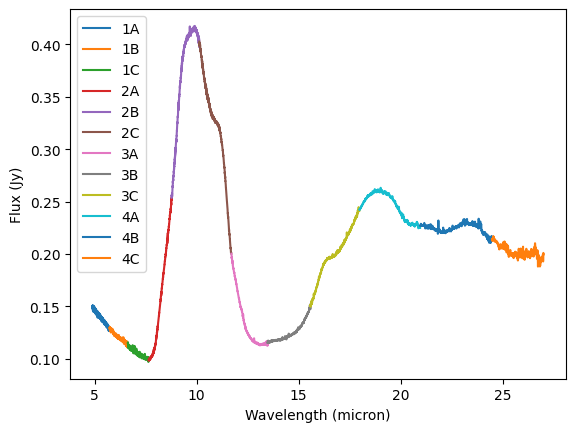

In [103]:
try:
    import seaborn as sns
    sns.set_context(context='talk', font_scale=1, rc=None)
    sns.set_style("ticks")
    plt.rcParams.update({"xtick.bottom" : True, "ytick.left" : True, "xtick.minor.visible" : True, "ytick.minor.visible": True})
except:
    pass

# vanilla
flux_col = 'flux'
plt.close('all')
band_ids = np.unique(spectrum_df_vanilla_pip['BAND_ID'])
for band in band_ids:
    mask_band = spectrum_df_vanilla_pip['BAND_ID'] == band
    spectrum_seg = spectrum_df_vanilla_pip[mask_band]
    mask_wavelength = spectrum_seg['wavelength'] < wl_max
    plt.plot(spectrum_seg['wavelength'][mask_wavelength].values,
             spectrum_seg[flux_col][mask_wavelength].values,
             label=band)
plt.xlabel('Wavelength (micron)')
plt.ylabel('Flux (Jy)')
plt.legend()
plt.savefig(os.path.join(figs_dir, f"spectrum_vanilla_pipeline.png"))
    
# psff    
if psff:
    flux_col = 'flux'
    if 'flux_fcorr' in spectrum_df.columns:
        flux_col = 'flux_fcorr'
    plt.close('all')
    band_ids = np.unique(spectrum_df['BAND_ID'])
    for band in band_ids:
        mask_band = spectrum_df['BAND_ID'] == band
        spectrum_seg = spectrum_df[mask_band]
        mask_wavelength = spectrum_seg['wavelength'] < wl_max
        plt.plot(spectrum_seg['wavelength'][mask_wavelength].values,
                 spectrum_seg[flux_col][mask_wavelength].values,
                 label=band)
    plt.xlabel('Wavelength (micron)')
    plt.ylabel('Flux (Jy)')
    plt.legend()
    plt.savefig(os.path.join(figs_dir, f"spectrum_minds_psff.png"))
else:       
    # minds + jwst
    flux_col = 'flux'
    if 'flux_fcorr' in spectrum_df.columns:
        flux_col = 'flux_fcorr'
    plt.close('all')
    band_ids = np.unique(spectrum_df['BAND_ID'])
    for band in band_ids:
        mask_band = spectrum_df['BAND_ID'] == band
        spectrum_seg = spectrum_df[mask_band]
        mask_wavelength = spectrum_seg['wavelength'] < wl_max
        plt.plot(spectrum_seg['wavelength'][mask_wavelength].values,
                 spectrum_seg[flux_col][mask_wavelength].values,
                 label=band)
    plt.xlabel('Wavelength (micron)')
    plt.ylabel('Flux (Jy)')
    plt.legend()
    plt.savefig(os.path.join(figs_dir, f"spectrum_minds.png"))

**Seaborn package works great for quickly plotting data frames, if you have seaborn installed try:**

**Does not work with newest version of Pandas and Seaborn. Waiting for fix....**

In [104]:
try:
    import seaborn as sns
    plot_fringes = True
    plot_legend = True
    if psff:
        g = sns.FacetGrid(spectrum_df, row="BAND_ID", sharex=False, sharey=False, aspect=5)
        g.map_dataframe(
            sns.lineplot, x="wavelength", y="flux_fcorr",
                        color='black', drawstyle='steps-mid',
                        label='Fringe correction')
        if plot_fringes:
            g.map_dataframe(
                sns.lineplot, x="wavelength", y="flux",
                alpha=0.5, color='orange', drawstyle='steps-mid',
                label='No fringe correction')
        if plot_legend:
            g.add_legend()
    else:
        g = sns.FacetGrid(spectrum_df_std_phot, row="BAND_ID", sharex=False, sharey=False, aspect=5)
        if rfc1d:
            label='Fringe correction'
        else:
            label='No fringe correction'
        label += "(std pipeline)"
        g.map_dataframe(
            sns.lineplot, x="wavelength", y="flux_fcorr",
                        color='black', drawstyle='steps-mid',
                        label=label)
except:
    pass

### 6.2. Comparison plots

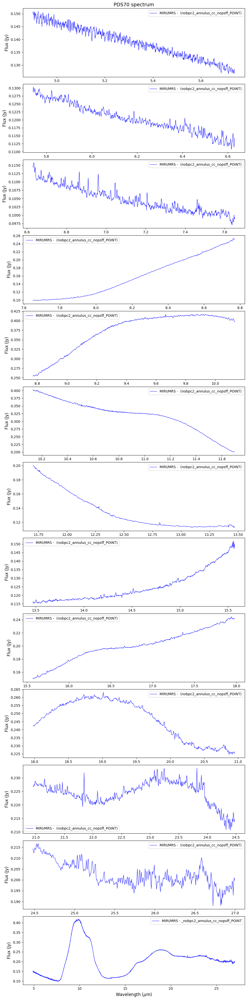

In [105]:
# plot the spectrum (last panel shows the full spectrum)
if spec_mode == 'per_band':
    npanels = 13
    fig, axs = plt.subplots(npanels, 1, figsize=(10, 40))#, sharex=True)
else: # per channel
    npanels = 5 
    fig, axs = plt.subplots(npanels, 1, figsize=(10, 20))#, sharex=True)
axs[0].set_title("{} spectrum".format(source), fontsize=14)

# PLOT SPITZER SPECTRUM AS 'SPACE TRUTH'
if spitzer_file is not None:
    #spitzer_spec = pd.read_csv(join(input_dir,"PDS70_Spitzer-CASSIS-LR.1.csv"), header=1, skiprows=0) ## old spectrum
    spitzer_spec = pd.read_csv(spitzer_file, header=0, skiprows=0, sep='       ', engine='python') # new Spitzer data reduction
    #swav = spitzer_spec['#lam:mic']
    swav = np.array(spitzer_spec['lambda'])
    sf = np.array(spitzer_spec['Flux'])
    sf_er = np.array(spitzer_spec['F_Er'])

    idx0 = find_nearest(swav, wl_min)
    idx1 = find_nearest(swav, wl_max)
    if npanels>4:
        axs[npanels-1].errorbar(swav[idx0:idx1], sf[idx0:idx1], sf_er[idx0:idx1], c=cols[1], markersize=0, \
                                linestyle='--', linewidth=1, 
                                label='Spitzer IRS LRS', alpha=0.8)
# plot photometry
if photom_file is not None:
    photom_data = pd.read_csv(photom_file, header=0, skiprows=0, sep='\t')
    wl_p = photom_data['wavelength']
    f_p = photom_data['flux']
    ferr_p = photom_data['err_flux']
    ins_p = photom_data['instrument']
    
    if npanels>4:
        for pp in range(len(wl_p)):
            if pp == 0:
                lab_tmp = 'Photometry'
            else:
                lab_tmp = None
            axs[npanels-1].errorbar(wl_p[pp], f_p[pp], ferr_p[pp], c='k', marker='s', markersize=3,
                                    label=lab_tmp, alpha=0.8)
 
# PLOT MRS spectra
for ff, file in enumerate(files):
    
    # Load the spectrum
    out_name = splitext(file)[0] + '{}.txt'.format(lab)
    wavelength, corrected_flux = np.loadtxt(out_name).T
    
    # plot MRS spectrum
    good_idx = np.where(wavelength<wl_max)
    axs[ff].plot(wavelength[good_idx], corrected_flux[good_idx], c=cols[0], markersize=0, linestyle='-', linewidth=1, 
                label='MIRI/MRS - {} ({})'.format(suffix_ex1d[nchar:], lab[1:]), alpha=0.8)
    if npanels>4:
        if ff == 0:
            label = 'MIRI/MRS - {}{}'.format(suffix_ex1d[nchar:], lab)
        else:
            label = None
        axs[npanels-1].plot(wavelength[good_idx], corrected_flux[good_idx], c=cols[0], markersize=0, linestyle='-', linewidth=1, 
                            label=label, alpha=0.8)
    
    # plot Spitzer spectrum
    if spitzer_file is not None:
        idx0s = find_nearest(swav, max(np.amin(wavelength), wl_min))
        idx1s = find_nearest(swav, min(np.amax(wavelength), wl_max))
        axs[ff].errorbar(swav[idx0s:idx1s], sf[idx0s:idx1s], sf_er[idx0s:idx1s], c=cols[1], markersize=0, linestyle='--', linewidth=1, 
                    label='Spitzer IRS LRS', alpha=0.8)

    # also plot other spectra if requested and if they exist
    if compare_spec and nsuff>0:
        other_plot_files = [other_files[i] for i in range(min(5,nsuff))]
        suff_tmp_plot = [suff_tmp[i] for i in range(min(5,nsuff))]
        lab_c = '_comparison'
        f_i = 2 # set to 0 if you wish reductions starting from the first one to be plotted
        f_n = 3 # set to -1 if you wish reductions up to the last one to be plotted
        for f, flist in enumerate(other_plot_files[f_i:f_n]): #adapt "5" to change max number of comparisons
            #if f!=1 and f!=2:
            arr = np.loadtxt(flist[ff])
            wavelength = arr[:,0]
            corrected_flux_autobg = arr[:,1]
            good_idx = np.where(wavelength<wl_max)
            axs[ff].plot(wavelength[good_idx], corrected_flux_autobg[good_idx], c=cols[2+f], markersize=0, linestyle='-', linewidth=1, 
                         label='MIRI/MRS - {}'.format(suff_tmp_plot[f_i+f]), alpha=0.8)
            if npanels>4:
                if ff == 0:
                    label = 'MIRI/MRS - {}'.format(suff_tmp_plot[f_i+f])
                else:
                    label = None
                axs[npanels-1].plot(wavelength[good_idx], corrected_flux_autobg[good_idx], c=cols[2+f], markersize=0, linestyle='-', linewidth=1, 
                                    label=label, alpha=0.8)
    else:
        lab_c = ''

    axs[ff].set_ylabel('Flux (Jy)', fontsize=12)
    axs[ff].legend(prop={'size': 10}, loc=0)
    axs[npanels-1].set_xlabel(r'Wavelength ($\mu$m)', fontsize=12)
    axs[npanels-1].set_ylabel('Flux (Jy)', fontsize=12)
    axs[npanels-1].legend(prop={'size': 10}, loc=0)
    
    plt.tight_layout(h_pad=0)
    if spec_mode == 'per_band' and npanels == 13:
        plt.savefig(join(figs_dir,"{}_spectra_band{}.pdf".format(source, lab_c)), bbox_inches='tight')
    elif spec_mode == 'per_channel' and npanels == 5:
        plt.savefig(join(figs_dir,"{}_spectra_channel{}.pdf".format(source, lab_c)), bbox_inches='tight')
    else:
        plt.savefig(join(figs_dir,"{}_spectra{}.pdf".format(source, lab_c)), bbox_inches='tight')
if show_plots:
    plt.show()
    
final_out_name = 'spectrum_minds.txt'
final_out_array = np.savetxt(join(fin3_dir,final_out_name), np.array([all_wavelength, all_corrected_flux]).T)

In [106]:
plt.close()

Make a single plot of the spectrum at all wavelengths

In [107]:
# plotting options
cols_b = ['b','y','r','k']
ls = ['-', '--',':', 'dashdot']
band_labs = ['SHORT', 'MEDIUM', 'LONG']

processing /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-short_s3d_cen_x1d_minds_rfc1d.fits
processing /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-medium_s3d_cen_x1d_minds_rfc1d.fits
processing /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-long_s3d_cen_x1d_minds_rfc1d.fits
processing /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-short_s3d_cen_x1d_minds_rfc1d.fits
processing /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-medium_s3d_cen_x1d_minds_rfc1d.fits
processing /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-long_s3d_cen_x1d_minds_rfc1d.fits
processing /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch3-short_s3d_cen_x1d_minds_rfc1d.fits
processing /Users/valentin/Documents/Postdoc/JWS

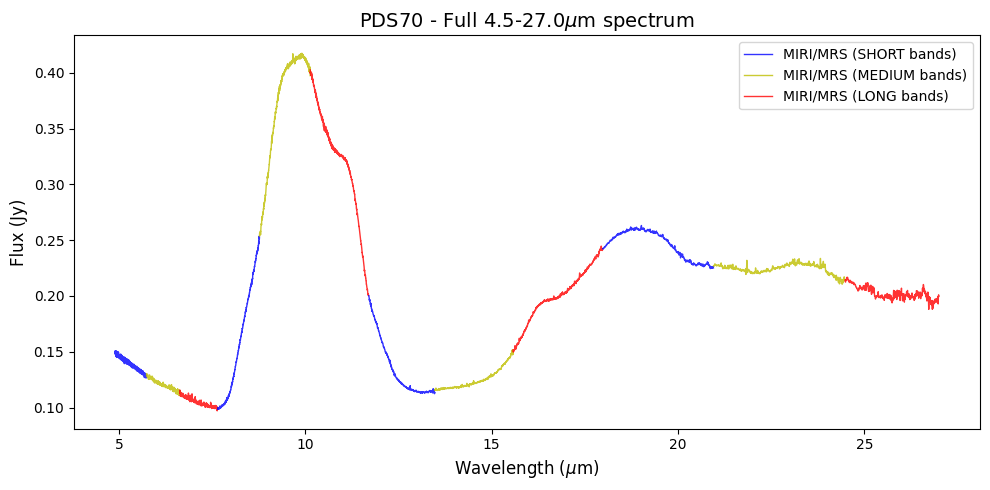

In [108]:
fig, axs = plt.subplots(1, 1, figsize=(10, 5))#, sharex=True)
axs.set_title("{} - Full {:.1f}-{:.1f}$\mu$m spectrum".format(source,wl_min,wl_max), fontsize=14)

# PLOT SPITZER SPECTRUM AS 'SPACE TRUTH'
if spitzer_file is not None:
    #spitzer_spec = pd.read_csv(join(input_dir,"PDS70_Spitzer-CASSIS-LR.1.csv"), header=1, skiprows=0) ## old spectrum
    spitzer_spec = pd.read_csv(spitzer_file, header=0, skiprows=0, sep='       ', engine='python') # new Spitzer data reduction
    #swav = spitzer_spec['#lam:mic']
    swav = np.array(spitzer_spec['lambda'])
    sf = np.array(spitzer_spec['Flux'])
    sf_er = np.array(spitzer_spec['F_Er'])

all_wavelengths = []
all_fluxes = []
for ff, file in enumerate(files):
    if ff>0:
        label=None
    print('processing {}'.format(file))
    
    # open file as datamodel
    dm = datamodels.open(file)
    ## get columns
    ori_wavelength = dm.spec[0].spec_table['WAVELENGTH']
    flux = dm.spec[0].spec_table['FLUX']
    if type(nch_bad_per_band) == str:
        if "red" in nch_bad_per_band:
            if ff < len(files)-1:
                dm_next = datamodels.open(files[ff+1])
                next_wavelengths = dm_next.spec[0].spec_table['WAVELENGTH']
                idx_overlap = find_nearest(next_wavelengths[0], ori_wavelength, constraint='floor')
                if ff == 0:
                    nch_bad_per_band = [(0,len(ori_wavelength)-idx_overlap-1)]
                else: 
                    nch_bad_per_band.append((0,len(ori_wavelength)-idx_overlap-1))
            else:
                idx_overlap = len(ori_wavelength)-1
                nch_bad_per_band.append((0,0))
            wavelength = ori_wavelength[:idx_overlap+1]
            flux = flux[:idx_overlap+1]
        else:
            if ff == 0:
                idx_overlap = 0
                nch_bad_per_band = [(0,0)]
            else:
                dm_prev = datamodels.open(files[ff-1])
                prev_wavelengths = dm_prev.spec[0].spec_table['WAVELENGTH']
                idx_overlap = find_nearest(prev_wavelengths[-1], ori_wavelength, constraint='ceil')
                nch_bad_per_band.append((idx_overlap,0))
            wavelength = ori_wavelength[idx_overlap:]
            flux = flux[idx_overlap:]
    elif nch_bad_per_band[ff][0]>0 or nch_bad_per_band[ff][1]>0:
        wavelength = ori_wavelength[nch_bad_per_band[ff][0]:len(ori_wavelength)-nch_bad_per_band[ff][1]]
        flux = flux[nch_bad_per_band[ff][0]:len(flux)-nch_bad_per_band[ff][1]]
    else:
        wavelength = ori_wavelength

    # load the spectrum from a text file
    out_name = splitext(file)[0] + '{}.txt'.format(lab)
    out_array = np.loadtxt(out_name)
    wavelength = out_array[:,0]
    corrected_flux = out_array[:,1]
        
    # plot MRS spectrum
    good_idx = np.where(wavelength<wl_max)
    if ff < 3:
        label_tmp = 'MIRI/MRS ({} bands)'.format(band_labs[ff%3])
    else:
        label_tmp = None
    axs.plot(wavelength[good_idx], corrected_flux[good_idx], c=cols_b[ff%3], markersize=0, linestyle=ls[0], linewidth=1, 
             label=label_tmp, alpha=0.8)
    
    # plot Spitzer spectrum
    if spitzer_file is not None:
        if ff == 0:
            label_tmp = 'Spitzer IRS LRS'
        else:
            label_tmp = None
        idx0s = find_nearest(swav, max(np.amin(ori_wavelength), wl_min))
        idx1s = find_nearest(swav, min(np.amax(ori_wavelength), wl_max))
        axs.errorbar(swav[idx0s:idx1s], sf[idx0s:idx1s], sf_er[idx0s:idx1s], c=cols[1], markersize=0, linestyle=ls[1], linewidth=1, 
                     label=label_tmp, alpha=0.8)
        
    # also plot other spectra if requested and if they exist
    if compare_spec:
        for f, flist in enumerate(other_files[2:3]):
            if f == 0 and ff==0:
                lab_tmp = 'MIRI/MRS - {}'.format(suff_tmp[2+f])
            else:
                lab_tmp = None
            arr = np.loadtxt(flist[ff])
            wavelength = arr[:,0]
            corrected_flux_autobg = arr[:,1]
            good_idx = np.where(wavelength<wl_max)
            axs.plot(wavelength[good_idx], corrected_flux_autobg[good_idx], c=cols_b[ff%3], markersize=0, linestyle=ls[2+f], linewidth=1, 
                    label=lab_tmp, alpha=0.8)
            
# plot photometry
if photom_file is not None:
    photom_data = pd.read_csv(photom_file, header=0, skiprows=0, sep='\t')
    wl_p = photom_data['wavelength']
    f_p = photom_data['flux']
    ferr_p = photom_data['err_flux']
    ins_p = photom_data['instrument']
    for pp in range(len(wl_p)):
        if pp == 0:
            lab_tmp = 'Photometry'
        else:
            lab_tmp = None
        axs.errorbar(wl_p[pp], f_p[pp], ferr_p[pp], c='k', marker='s',markersize=3,
                     label=lab_tmp, alpha=0.8)
            
axs.set_ylabel('Flux (Jy)', fontsize=12)
axs.set_xlabel(r'Wavelength ($\mu$m)', fontsize=12)
axs.legend(prop={'size': 10}, loc=0)

plt.tight_layout(h_pad=0)
plt.savefig(join(figs_dir,"{}_spectra_full{}.pdf".format(source,ver)), bbox_inches='tight')
if show_plots:
    plt.show()

In [109]:
plt.close()

### 6.3. Final plot

In [110]:
fwl_min=4.5      # min wavelength for the plot
fwl_max=26.8  # max wavelength for the plot
cols_f = ['k','c','b','g','orange','r','m','brown']
#compare_spec = True # whether to compare with other spectra

processing /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-short_s3d_cen_x1d_minds_rfc1d.fits
processing /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-medium_s3d_cen_x1d_minds_rfc1d.fits
processing /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-long_s3d_cen_x1d_minds_rfc1d.fits
processing /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-short_s3d_cen_x1d_minds_rfc1d.fits
processing /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-medium_s3d_cen_x1d_minds_rfc1d.fits
processing /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-long_s3d_cen_x1d_minds_rfc1d.fits
processing /Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch3-short_s3d_cen_x1d_minds_rfc1d.fits
processing /Users/valentin/Documents/Postdoc/JWS

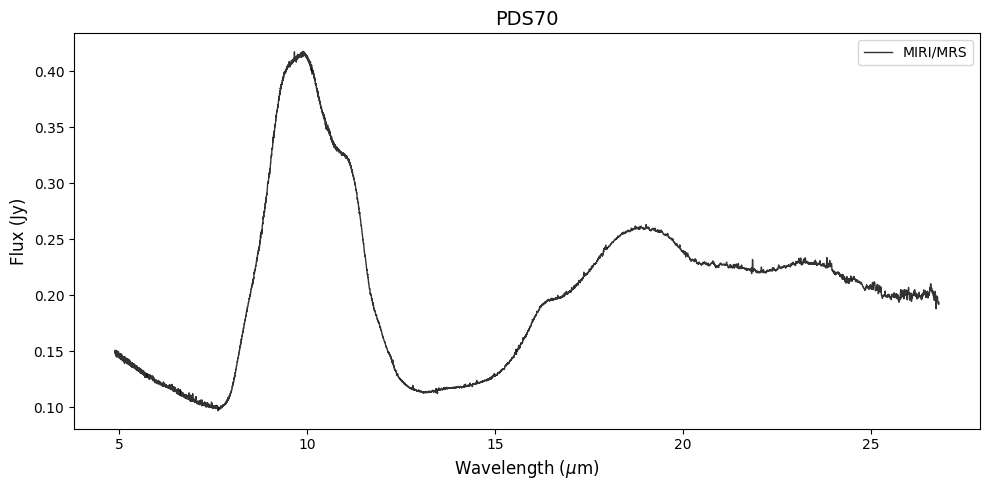

In [111]:
fig, axs = plt.subplots(1, 1, figsize=(10, 5))#, sharex=True)
axs.set_title("{}".format(source), #" - Full {:.1f}-{:.1f}$\mu$m spectrum".format(source,wl_min,wl_max), 
              fontsize=14)

# PLOT SPITZER SPECTRUM AS 'SPACE TRUTH'
if spitzer_file is not None and compare_spec:
    #spitzer_spec = pd.read_csv(join(input_dir,"PDS70_Spitzer-CASSIS-LR.1.csv"), header=1, skiprows=0) ## old spectrum
    spitzer_spec = pd.read_csv(spitzer_file, header=0, skiprows=0, sep='       ', engine='python') # new Spitzer data reduction
    #swav = spitzer_spec['#lam:mic']
    swav = np.array(spitzer_spec['lambda'])
    sf = np.array(spitzer_spec['Flux'])
    sf_er = np.array(spitzer_spec['F_Er'])

all_wavelengths = []
all_fluxes = []
for ff, file in enumerate(files):
    if ff>0:
        label=None
    print('processing {}'.format(file))
    
    # open file as datamodel
    dm = datamodels.open(file)
    ## get columns
    ori_wavelength = dm.spec[0].spec_table['WAVELENGTH']
    flux = dm.spec[0].spec_table['FLUX']
    if type(nch_bad_per_band) == str:
        if "red" in nch_bad_per_band:
            if ff < len(files)-1:
                dm_next = datamodels.open(files[ff+1])
                next_wavelengths = dm_next.spec[0].spec_table['WAVELENGTH']
                idx_overlap = find_nearest(next_wavelengths[0], ori_wavelength, constraint='floor')
                if ff == 0:
                    nch_bad_per_band = [(0,len(ori_wavelength)-idx_overlap-1)]
                else: 
                    nch_bad_per_band.append((0,len(ori_wavelength)-idx_overlap-1))
            else:
                idx_overlap = len(ori_wavelength)-1
                nch_bad_per_band.append((0,0))
            wavelength = ori_wavelength[:idx_overlap+1]
            flux = flux[:idx_overlap+1]
        else:
            if ff == 0:
                idx_overlap = 0
                nch_bad_per_band = [(0,0)]
            else:
                dm_prev = datamodels.open(files[ff-1])
                prev_wavelengths = dm_prev.spec[0].spec_table['WAVELENGTH']
                idx_overlap = find_nearest(prev_wavelengths[-1], ori_wavelength, constraint='ceil')
                nch_bad_per_band.append((idx_overlap,0))
            wavelength = ori_wavelength[idx_overlap:]
            flux = flux[idx_overlap:]
    elif nch_bad_per_band[ff][0]>0 or nch_bad_per_band[ff][1]>0:
        wavelength = ori_wavelength[nch_bad_per_band[ff][0]:-nch_bad_per_band[ff][1]]
        flux = flux[nch_bad_per_band[ff][0]:-nch_bad_per_band[ff][1]]
    else:
        wavelength = ori_wavelength

    # load the spectrum from a text file
    out_name = splitext(file)[0] + '{}.txt'.format(lab)
    out_array = np.loadtxt(out_name)
    wavelength = out_array[:,0]
    corrected_flux = out_array[:,1]
        
    # plot MRS spectrum
    good_idx = np.where(wavelength<fwl_max)
    if ff == 0:
        label_tmp = 'MIRI/MRS'
    else:
        label_tmp = None
    axs.plot(wavelength[good_idx], corrected_flux[good_idx], c=cols_f[0], markersize=0, linestyle=ls[0], linewidth=1, 
             label=label_tmp, alpha=0.8)

# plot photometry
if photom_file is not None:
    photom_data = pd.read_csv(photom_file, header=0, skiprows=0, sep='\t')
    wl_p = photom_data['wavelength']
    f_p = photom_data['flux']
    ferr_p = photom_data['err_flux']
    ins_p = photom_data['instrument']
    for pp in range(len(wl_p)):
        axs.errorbar(wl_p[pp], f_p[pp], ferr_p[pp], c=cols_f[1+pp], marker='s', markersize=3,
                     label=ins_p[pp], alpha=0.8)

# plot Spitzer spectrum
if spitzer_file is not None:# and compare_spec:
    label_tmp = 'Spitzer IRS LRS'
    idx0s = find_nearest(swav, fwl_min)
    idx1s = find_nearest(swav, fwl_max)
    axs.errorbar(swav[idx0s:idx1s], sf[idx0s:idx1s], sf_er[idx0s:idx1s], c=cols[1], markersize=0, linestyle=ls[1], 
                 linewidth=1, label=label_tmp, alpha=0.8)

axs.set_ylabel('Flux (Jy)', fontsize=12)
axs.set_xlabel(r'Wavelength ($\mu$m)', fontsize=12)
axs.legend(prop={'size': 10}, loc=0)

plt.tight_layout(h_pad=0)
plt.savefig(join(figs_dir,"{}_spectra_final{}.pdf".format(source,ver)), bbox_inches='tight')
if show_plots:
    plt.show()

**Plot the continuum-subtracted spectrum** (if requested)

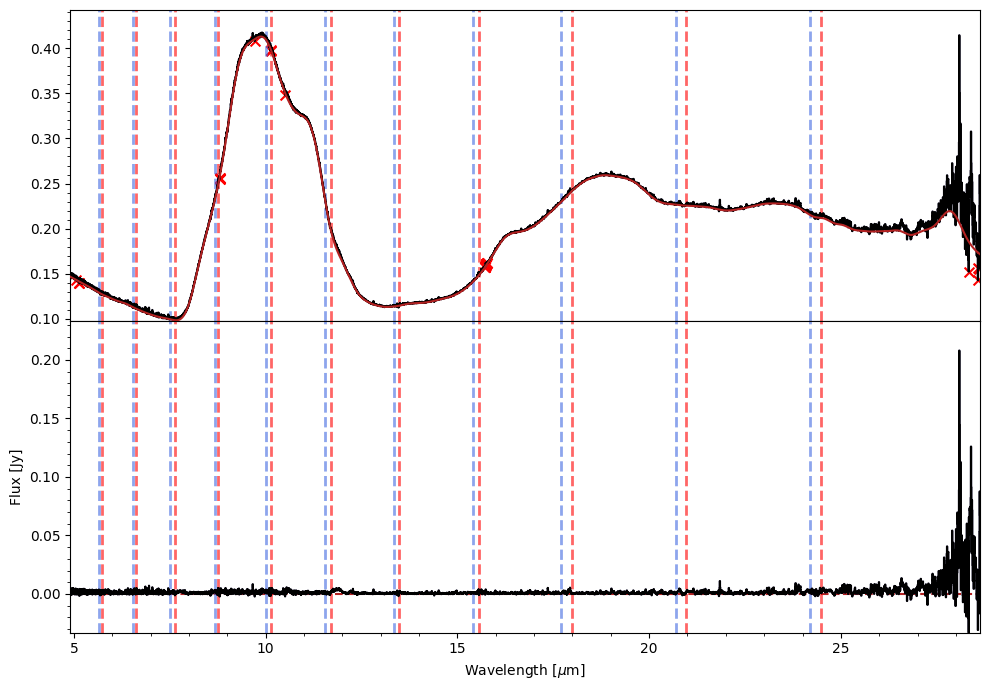

In [112]:
if contsub:
    ## === Plot results
    PlotSpectrum(Wav      = StitchedWav,
                 Flux     = OStitchedFlux,  ## Using the original stitched spectrum in the plotting.
                 Baseline = StitchedBL,
                 Mask     = StitchedMask,
                 dY       = 0.025,
                 SavePlot = os.path.join(figs_dir, f'FullSpectrum_CS'),
                 MaskFeature=MaskFeature)

### 6.4. Aperture image

Adapt cell below to include the wavelengths for which you would like to show a spectral image, along with the corresponding aperture size used for extracting the spectrum:

In [113]:
img_wls = [7.0, 14.9]

Let's define the number of pixels to crop from each side of the frames for the plot:

In [114]:
crop_px = [19, 12]

Most of the other cells should not be modified (only the cell with ellipse parameters if you wish to include a sketch of the disk):

In [115]:
from hciplot import plot_frames
if make_aperture_image:
    cxy_med = open_fits(join(fin3_dir,"cxy_med.fits")) # Note: order is CH1_LONG, CH1_MED, CH1_SHORT, CH2_LONG, etc.
    cxy_med

Find the indices of the bands in which requested wavelengths are located

In [116]:
if make_aperture_image:
    # gather the spectra
    afiles = glob.glob(join(spec3_dir, '*{}*{}*.fits'.format(suffix[0],suffix_ex1d)))
    afiles.sort()
    afiles = sort_files_wl(afiles)
    afiles

In [117]:
if make_aperture_image:
    calfiles=sorted(glob.glob(join(spec3_dir,'Level3{}*{}_cen{}.fits'.format(suffix[0],suf, suf_bkg))))
    calfiles = sort_files_wl(calfiles)
    print(calfiles)

In [118]:
if make_aperture_image:
    good_ffs = []
    good_wavelengths = []
    for ff, file in enumerate(afiles):
        # open file as datamodel
        dm = datamodels.open(file)
        # get wavelengths
        wavelength = dm.spec[0].spec_table['WAVELENGTH']
        for wl in img_wls:
            if wl > wavelength[0] and wl < wavelength[-1]:
                good_ffs.append(ff)
                good_wavelengths.append(wavelength)
    good_ffs

In [119]:
calfiles

['/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-short_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-medium_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch1-long_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-short_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-medium_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch2-long_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch3-short_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch3-medium_s3d_cen.fits',
 '/Users/valentin/Documents/Postdoc/JWST/MINDS/PDS70/stage3_MINDSv1.0.6/Level3_ifua_psf_ch3-lon

In [120]:
if make_aperture_image:
    good_frames = []
    good_plscs = []
    c = 0
    for ff, file in enumerate(calfiles):
        if ff in good_ffs:
            bname = basename(file)
            foutname = join(fin3_dir, bname)
            cube_cen, head = open_fits(foutname, header=True, n=1)
            dq_cube = fits.open(foutname, memmap=False)[3].data
            gp_cube = np.ones(dq_cube.shape)
            gp_cube[:] = np.nan
            gp_cube[np.where(dq_cube==np.nanmin(dq_cube))]=1
            pxscale1 = float(head['CDELT1'])
            pxscale2 = float(head['CDELT2'])
            good_plscs.append(float(np.mean([pxscale1, pxscale2])*3600))
            # now find closest channel to requested wavelength
            close_idx = find_nearest(good_wavelengths[c], img_wls[c])
            print(len(good_wavelengths[c]))
            good_frames.append(cube_cen[close_idx, crop_px[c]:-crop_px[c], crop_px[c]:-crop_px[c]]*gp_cube[close_idx,crop_px[c]:-crop_px[c],crop_px[c]:-crop_px[c]])
            # previously: using band-edge cropped spectra
            #good_frames.append(cube_cen[nch_bad_per_band[ff][0]+close_idx,crop_px[c]:-crop_px[c], crop_px[c]:-crop_px[c]]*gp_cube[nch_bad_per_band[ff][0]+close_idx,crop_px[c]:-crop_px[c],crop_px[c]:-crop_px[c]])
            c += 1

Show image:

In [121]:
if make_aperture_image and show_plots:
    circles = [(float(cxy_med[ff, 0])-crop_px[fc], float(cxy_med[ff, 1])-crop_px[fc]) for fc, ff in enumerate(good_ffs)]
    labels = [r"{:.1f} $\mu$m".format(img_wls[i]) for i in range(len(img_wls))]
    for ll, wl in enumerate(img_wls):
        vmin = abs(float(np.nanpercentile(good_frames[ll],0.01)))
        if np.isnan(vmin):
            vmin=0
        ticksep = 1./good_plscs[ll]
        fwhm = wl/good_plscs[ll]*0.31/8
        circ_rad = float(apsize*fwhm)
        plot_frames(good_frames[ll], label=labels[ll], dpi=300, colorbar=True, circle=circles[ll], cmap='inferno',
                    circle_radius=circ_rad, vmin=vmin, log=True, ang_scale=True, label_color='w',
                    ang_ticksep=ticksep, pxscale=good_plscs[ll], colorbar_label='MJy/sr')

Let's now save it:

In [122]:
if make_aperture_image:
    for ll, wl in enumerate(img_wls):
        vmin = abs(float(np.nanpercentile(good_frames[ll],0.01)))
        ticksep = 1./good_plscs[ll]
        fwhm = wl/good_plscs[ll]*0.31/8
        circ_rad = float(apsize*fwhm)
        plot_frames(good_frames[ll], label=labels[ll], dpi=300, colorbar=True, circle=circles[ll], cmap='inferno',
                    circle_radius=circ_rad, vmin=vmin, log=True, ang_scale=True, label_color='w',
                    save=join(figs_dir,'Aperture_{:.1f}mu.pdf'.format(wl)),
                    ang_ticksep=ticksep, pxscale=good_plscs[ll], colorbar_label='MJy/sr')

Let's now add a sketch of the system. Here for PDS 70, we add 2 planets, and ellipses corresponding to inner and outer disks - feel free to adapt accordingly:

In [123]:
if make_aperture_image:
    # planets
    b_dxy_as = (-0.112781, -0.111194) # expected position on 01/08/2022
    c_dxy_as = (0.210882, 0.005433)  # expected position on 01/08/2022
    # disk
    din_au = 18.*2 #diameter
    dout_au = 54.*2 #diameter
    dist = 113.43 #pc
    incl = 49.7 #deg
    PA_a = 158.6-90 # trigonometric

Final plot + save it:

In [124]:
if make_aperture_image:
    for ll, wl in enumerate(img_wls):
        vmin = abs(float(np.nanpercentile(good_frames[ll],0.01)))
        ticksep = 1./good_plscs[ll]
        fwhm = wl/good_plscs[ll]*0.31/8
        ap_rad = float(apsize*fwhm)
        # planet positions in frame
        b_xy = (circles[ll][0]+b_dxy_as[0]/good_plscs[ll], circles[ll][1]+b_dxy_as[1]/good_plscs[ll])
        c_xy = (circles[ll][0]+c_dxy_as[0]/good_plscs[ll], circles[ll][1]+c_dxy_as[1]/good_plscs[ll])
        sbc_circ = (circles[ll], b_xy, c_xy)
        circ_rads = (ap_rad, 0.1, 0.1)
        circle_colors = ('y', 'w', 'w')
        # ellipses in frame
        in_a = (din_au/dist)/good_plscs[ll]
        out_a = (dout_au/dist)/good_plscs[ll]
        ells = (circles[ll],circles[ll])
        ells_a = (in_a, out_a)
        ells_b = (in_a*np.cos(np.deg2rad(incl)), out_a*np.cos(np.deg2rad(incl)))
        ells_angs = (PA_a, PA_a)
        if show_plots:
            plot_frames(good_frames[ll], label=labels[ll], dpi=300, colorbar=True, cmap='inferno', 
                        circle=sbc_circ, circle_radius=circ_rads, circle_color=circle_colors, # circles
                        ellipse=ells, ellipse_a=ells_a, ellipse_b=ells_b, ellipse_angle=ells_angs, ellipse_label_color='g', # ellipses
                        vmin=vmin, log=True, ang_scale=True, label_color='w',
                        ang_ticksep=ticksep, pxscale=good_plscs[ll], colorbar_label='MJy/sr')
        # same but to save figure
        plot_frames(good_frames[ll], label=labels[ll], dpi=300, colorbar=True, cmap='inferno', 
                    circle=sbc_circ, circle_radius=circ_rads, circle_color=circle_colors, # circles
                    ellipse=ells, ellipse_a=ells_a, ellipse_b=ells_b, ellipse_angle=ells_angs, ellipse_label_color='g', # ellipses
                    vmin=vmin, log=True, ang_scale=True, label_color='w',
                    save=join(figs_dir,'Aperture_{:.1f}mu_annotated.pdf'.format(wl)),
                    ang_ticksep=ticksep, pxscale=good_plscs[ll], colorbar_label='MJy/sr')

### 6.5. Centroid locations and FWHM

In [125]:
cs = np.arange(1,5)
bs = ['A', 'B', 'C']
sbands = []
for i in cs:
    for j in bs:
        sbands.append("CH{:.0f}{}".format(i, j))
sbands

['CH1A',
 'CH1B',
 'CH1C',
 'CH2A',
 'CH2B',
 'CH2C',
 'CH3A',
 'CH3B',
 'CH3C',
 'CH4A',
 'CH4B',
 'CH4C']

2025-02-25 09:33:24,809 - stpipe - WARNING - /var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_36140/2007169989.py:25: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()



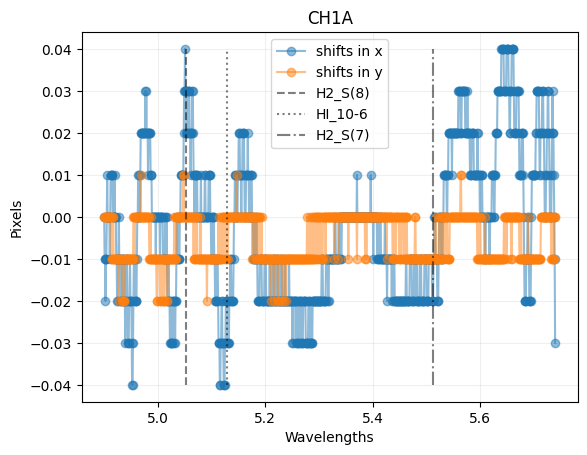

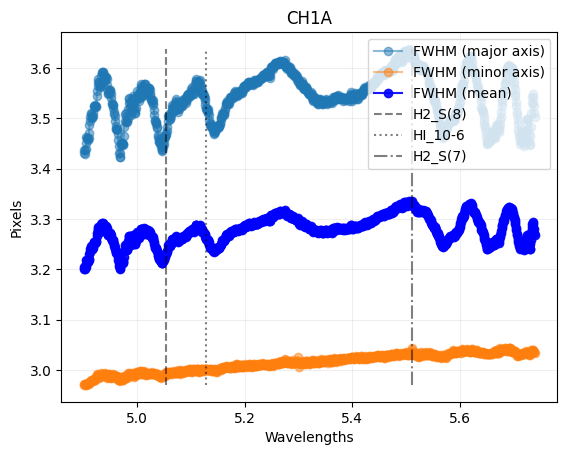

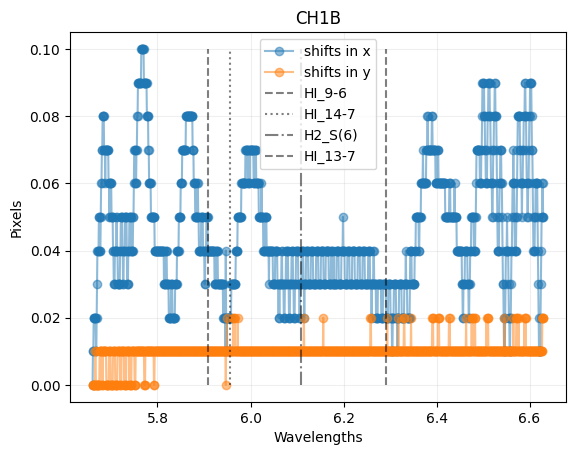

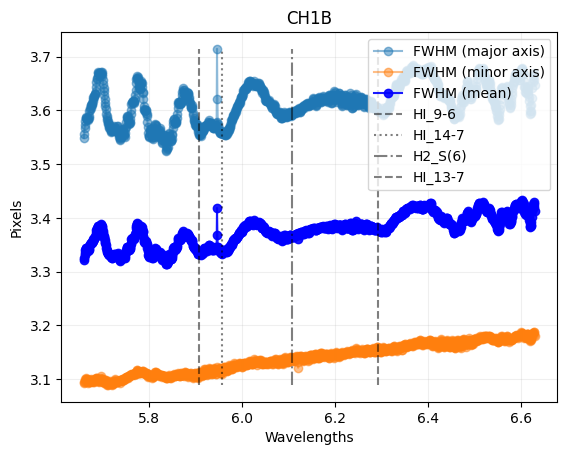

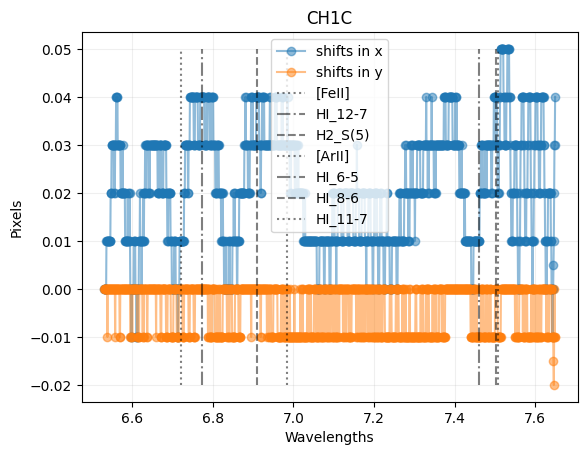

...

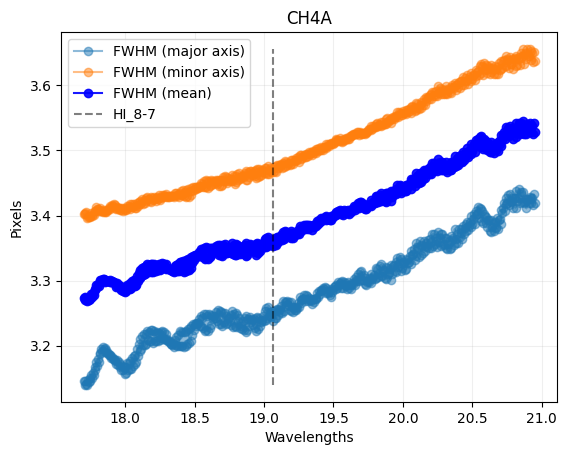

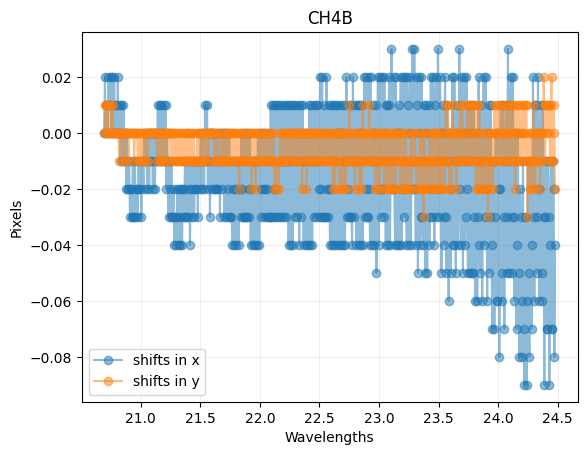

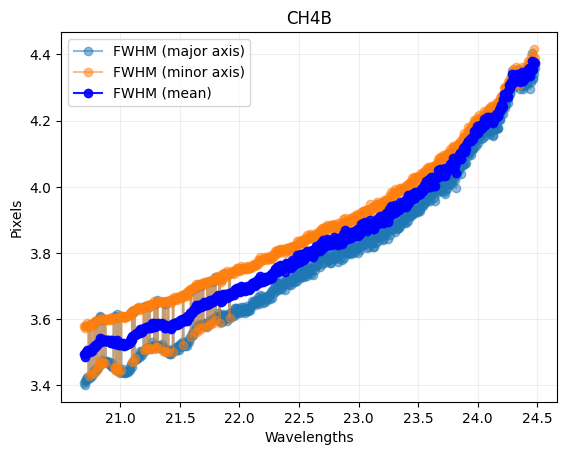

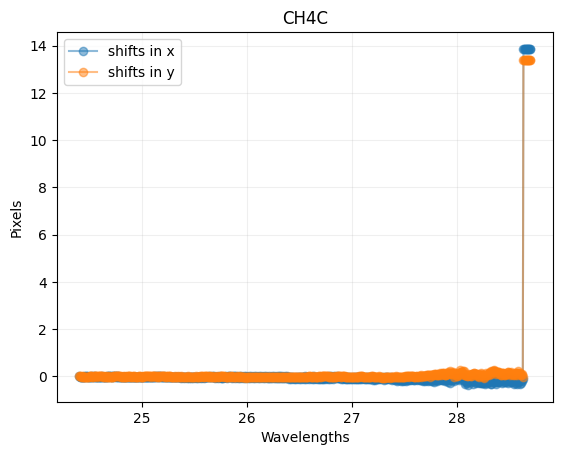

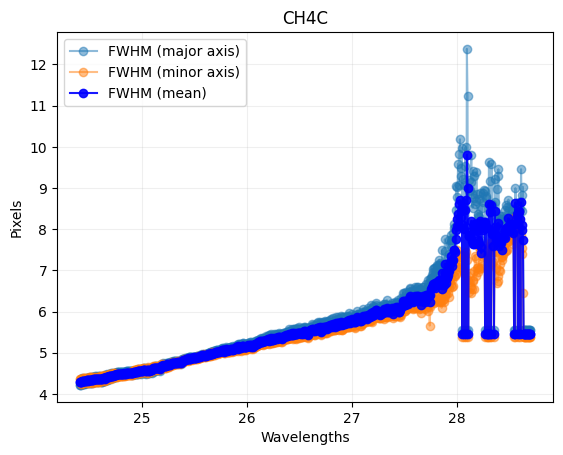

In [126]:
from pandas import read_csv
line_styles = ['--', ':', '-.']
cl = 0
cl2 = 0
nls = len(line_styles)

if make_centroid_and_fwhm_plots:
    if not isdir(fig_dir):
        os.makedirs(fig_dir)

    for ff, file in enumerate(calfiles_ifua):
        x1dfile_tmp = file.replace('Level3_psf_', 'Level3_ifua_psf_')
        x1dfile = fits.open(x1dfile_tmp.replace('_s3d_cen', '_x1d'))
        #x1dfile = fits.open(file.replace('_s3d_cen', '_x1d_vanilla'))
        wls = np.array(x1dfile[1].data['WAVELENGTH'])
        x1dfile.close()
        
        # plot shifts with wavelengths (if recentering done)
        if cen_method is not None:
            cxy_med = cxy_med_ifua[ff]
            cx_all = cx_all_ifua[ff]
            cy_all = cy_all_ifua[ff]
        
            # centroid plots
            plt.figure()
            plt.title('{}'.format(sbands[ff]))
            plt.plot(wls, cxy_med[0]-cx_all, 'o-', label='shifts in x', alpha=0.5)
            plt.plot(wls, cxy_med[1]-cy_all, 'o-', label='shifts in y', alpha=0.5)
            for li, line in enumerate(test_lines):
                if line >= wls[0] and line <= wls[-1]:
                    minsh = np.amin(np.array([cxy_med[0]-cx_all, cxy_med[1]-cy_all]))
                    maxsh = np.amax(np.array([cxy_med[0]-cx_all, cxy_med[1]-cy_all]))
                    plt.plot([line]*10, np.linspace(minsh, maxsh, 10), 'k'+line_styles[cl%nls], label=test_labels[li], alpha=0.5)
                    cl+=1
                    
            plt.legend(loc='best')
            plt.grid('on', alpha=0.2)
            plt.ylabel('Pixels')
            plt.xlabel('Wavelengths')
            plt.savefig(fig_dir+"Shifts_{}_ifu_aligned.pdf".format(sbands[ff]))
    
        # FWHM plots
        bname = splitext(file.replace('_s3d_cen', '_s3d'))[0]
        gauss_fit_res = read_csv(bname+'_2d_fit_robust.csv')
        fwhm_x_all_ifua = gauss_fit_res['fwhm_x']
        fwhm_y_all_ifua = gauss_fit_res['fwhm_y']
        fwhm_med_ifua = np.mean(np.array([fwhm_x_all_ifua, fwhm_y_all_ifua]), axis=0)
        
        plt.figure()
        plt.title('{}'.format(sbands[ff]))
        plt.plot(wls, fwhm_x_all_ifua, 'o-', label='FWHM (major axis)', alpha=0.5)
        plt.plot(wls, fwhm_y_all_ifua, 'o-', label='FWHM (minor axis)', alpha=0.5)
        plt.plot(wls, fwhm_med_ifua, 'bo-', label='FWHM (mean)', alpha=0.9)
        for li, line in enumerate(test_lines):
            if line >= wls[0] and line <= wls[-1]:
                minsh = np.amin(np.array([fwhm_x_all_ifua, fwhm_y_all_ifua]))
                maxsh = np.amax(np.array([fwhm_x_all_ifua, fwhm_y_all_ifua]))
                plt.plot([line]*10, np.linspace(minsh, maxsh, 10), 'k'+line_styles[cl2%nls], label=test_labels[li], alpha=0.5)
                cl2 += 1
                
        plt.legend(loc='best')
        plt.grid('on', alpha=0.2)
        plt.ylabel('Pixels')
        plt.xlabel('Wavelengths')
        plt.savefig(fig_dir+"FWHM_{}_ifu_aligned.pdf".format(sbands[ff]))

In [127]:
plt.close()

### 6.6. Continuum-subtracted line images

**IFU-aligned**

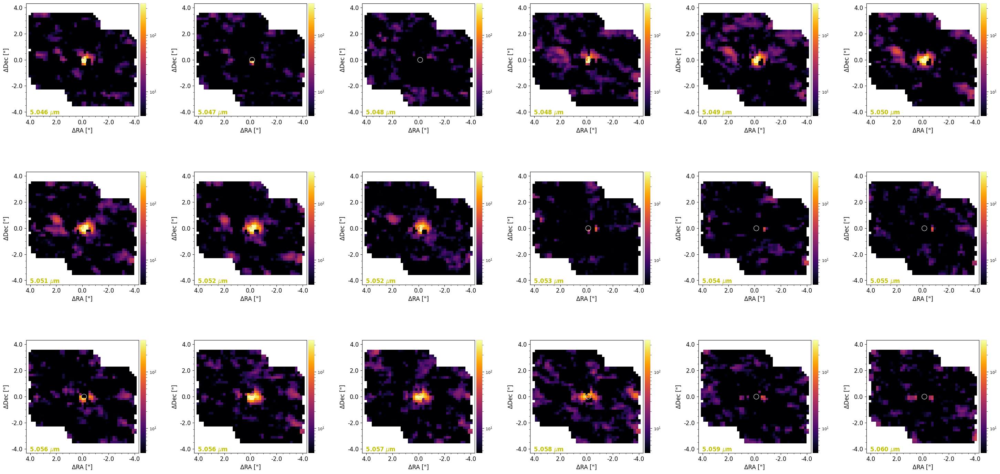

`Pixel scale set to 0.1838477563650063`


2025-02-25 09:33:30,613 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:33:30,614 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



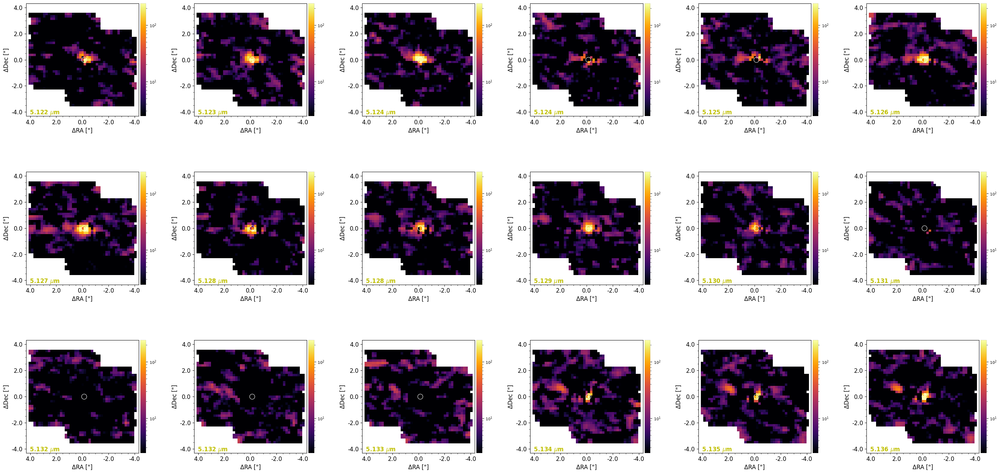

`Pixel scale set to 0.1838477563650063`


2025-02-25 09:33:34,692 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:33:34,692 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



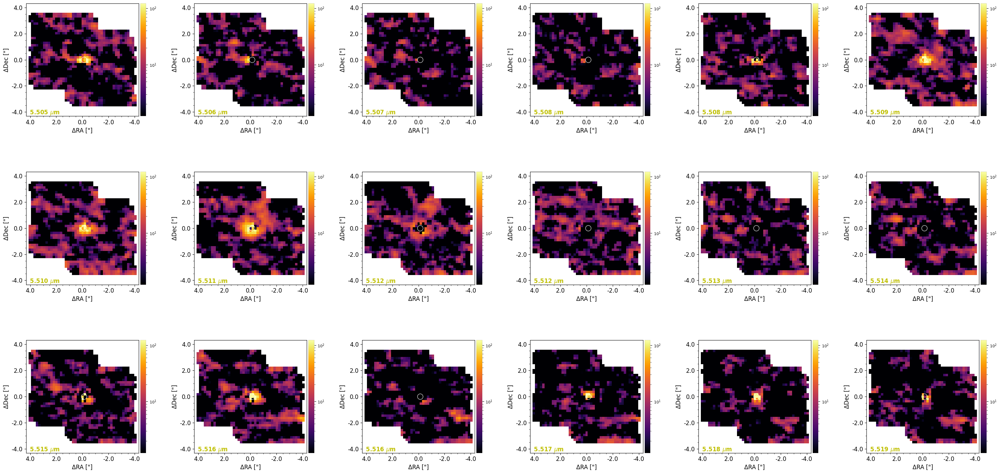

`Pixel scale set to 0.1838477563650063`


2025-02-25 09:33:38,657 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:33:38,657 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



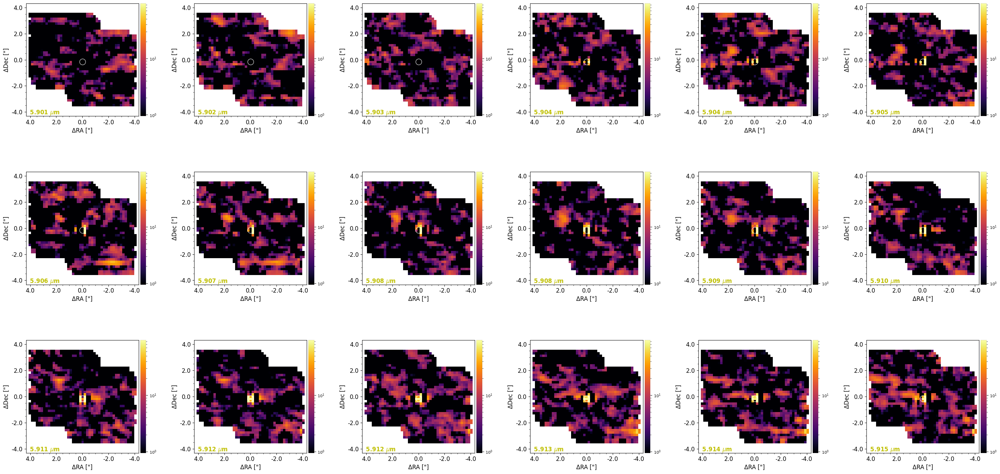

`Pixel scale set to 0.1838477563650063`


2025-02-25 09:33:42,497 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:33:42,497 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



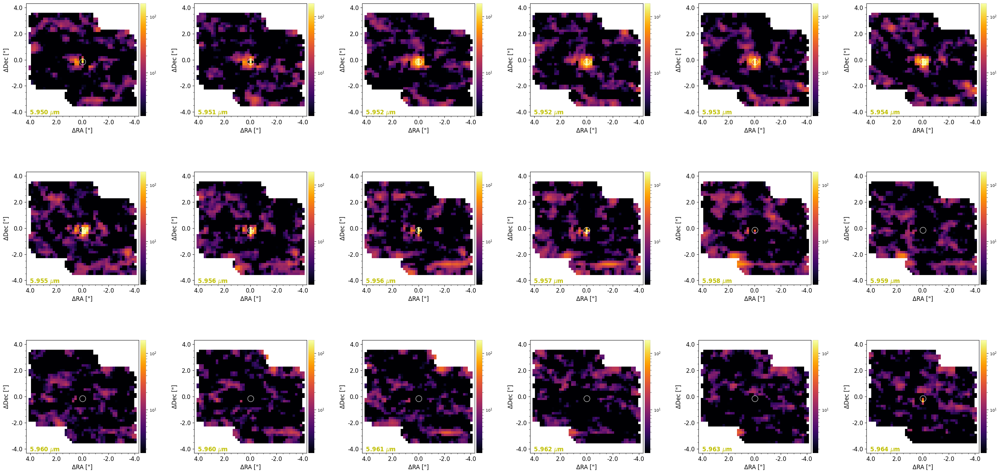

`Pixel scale set to 0.1838477563650063`


2025-02-25 09:33:46,798 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:33:46,798 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



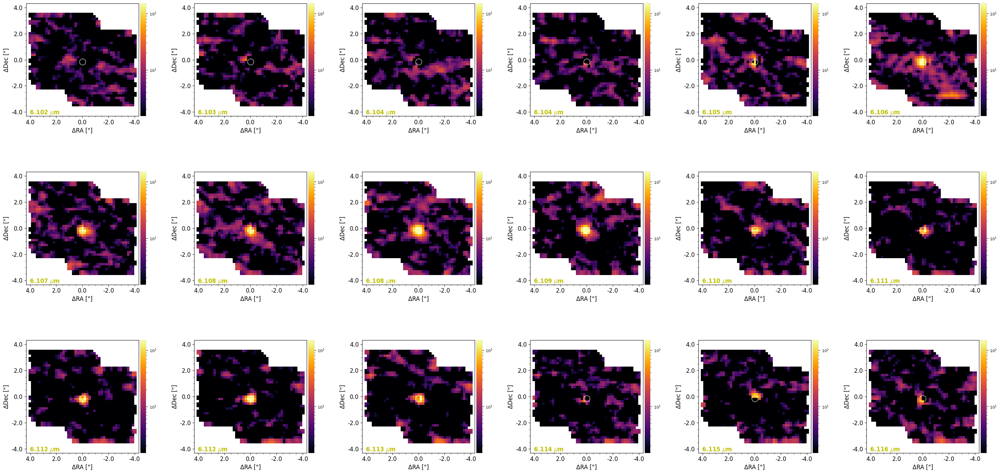

`Pixel scale set to 0.1838477563650063`


2025-02-25 09:33:50,777 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:33:50,777 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



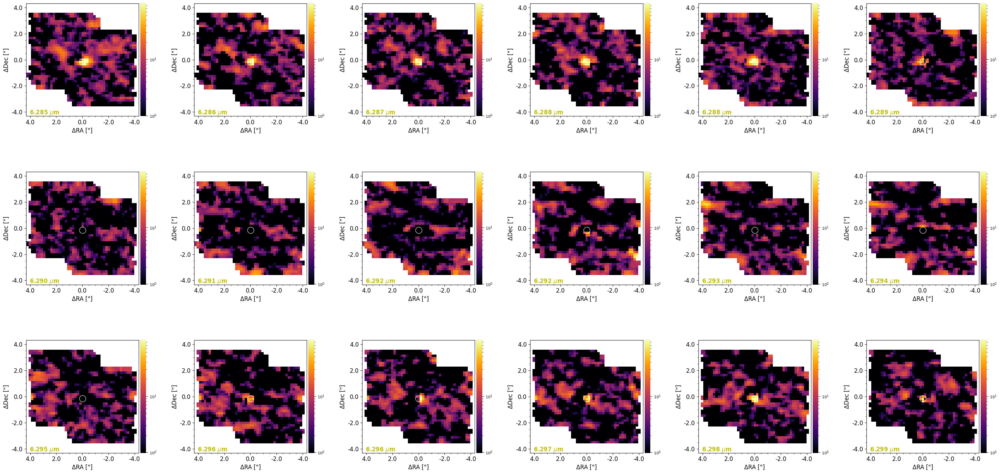

`Pixel scale set to 0.1838477563650063`


2025-02-25 09:33:54,798 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:33:54,798 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



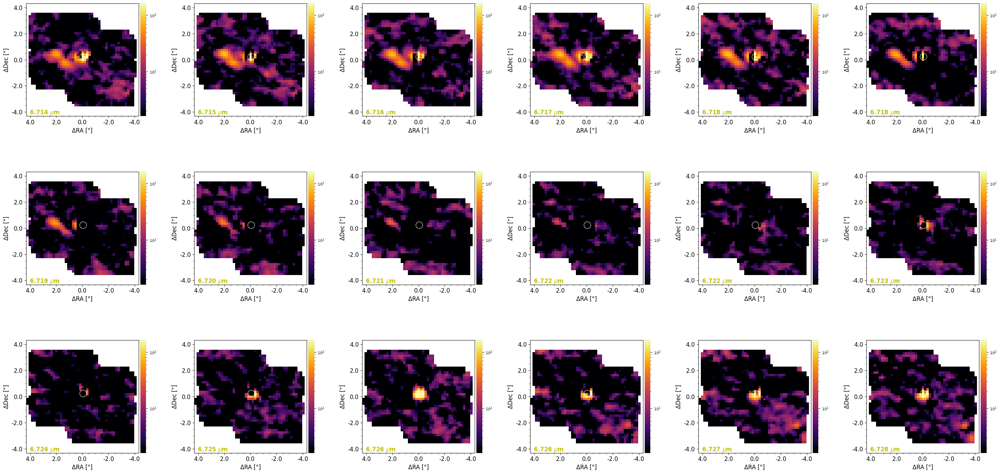

`Pixel scale set to 0.1838477563650063`


2025-02-25 09:33:58,940 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:33:58,940 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



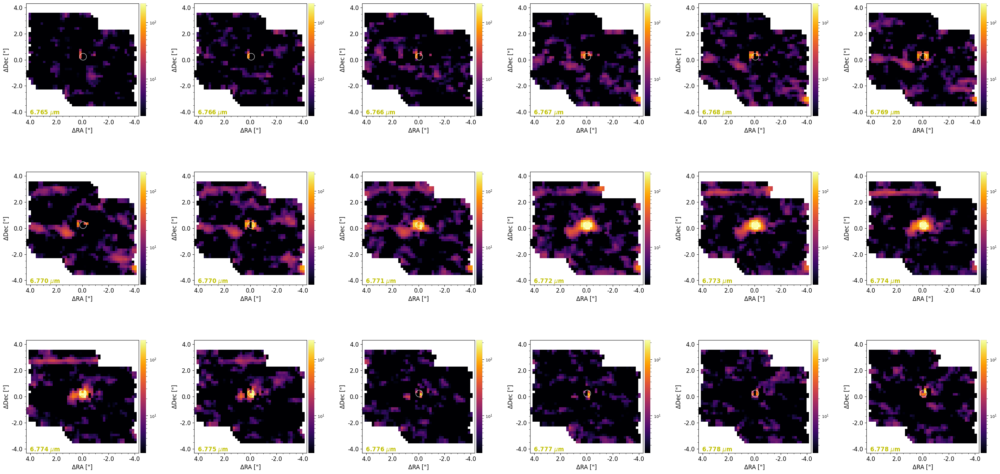

`Pixel scale set to 0.1838477563650063`


2025-02-25 09:34:02,847 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:34:02,847 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



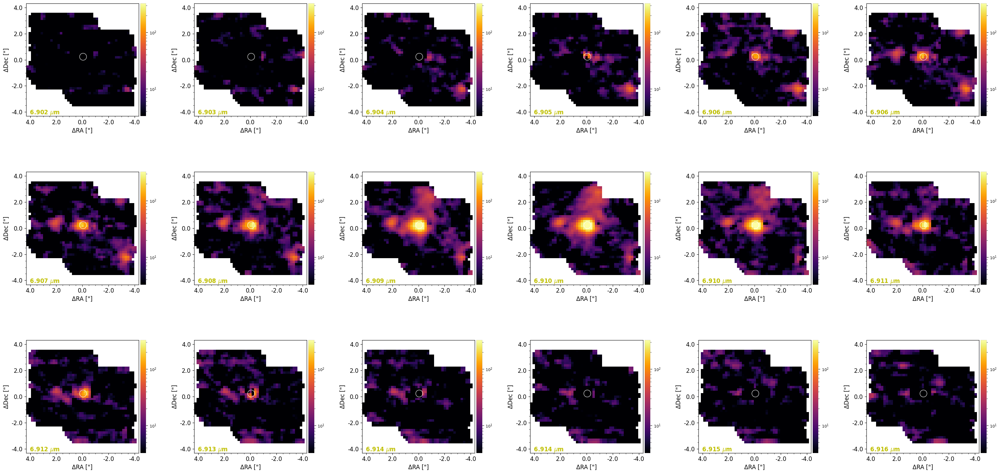

`Pixel scale set to 0.1838477563650063`


2025-02-25 09:34:07,140 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:34:07,140 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



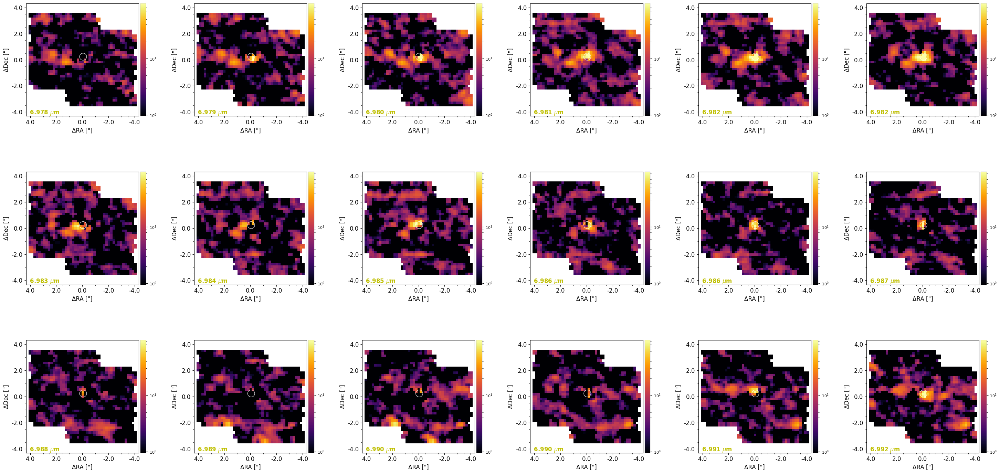

`Pixel scale set to 0.1838477563650063`


2025-02-25 09:34:11,133 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:34:11,134 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



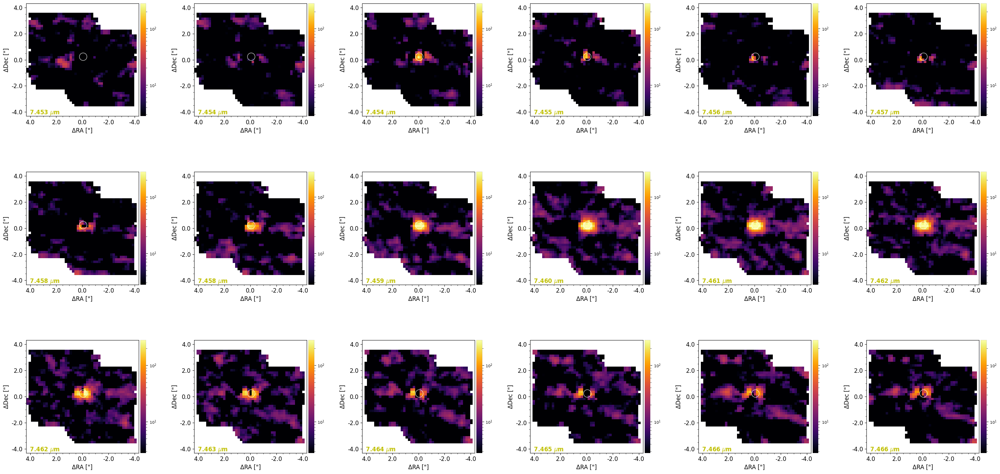

`Pixel scale set to 0.1838477563650063`


2025-02-25 09:34:15,169 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:34:15,169 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



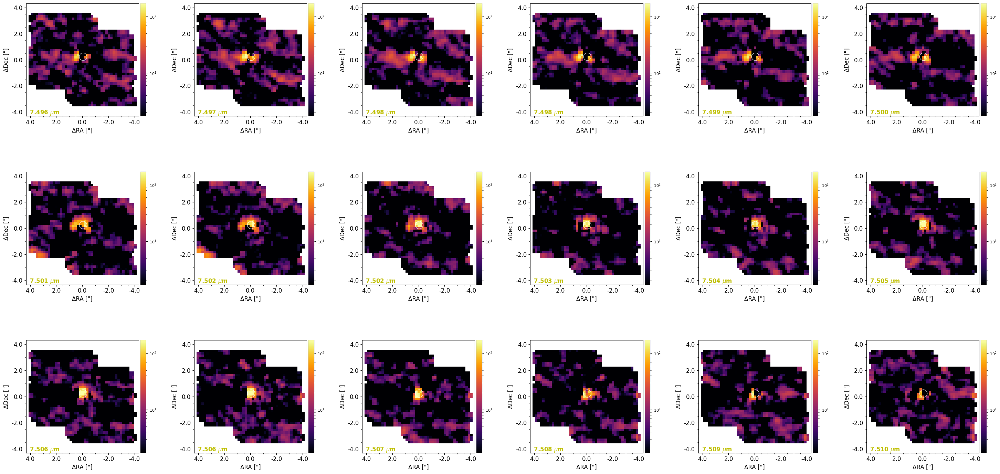

`Pixel scale set to 0.1838477563650063`


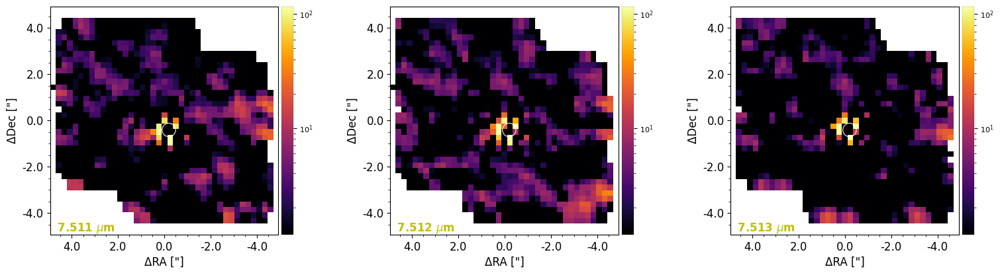

`Pixel scale set to 0.24041630813223655`


2025-02-25 09:34:19,855 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:34:19,856 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



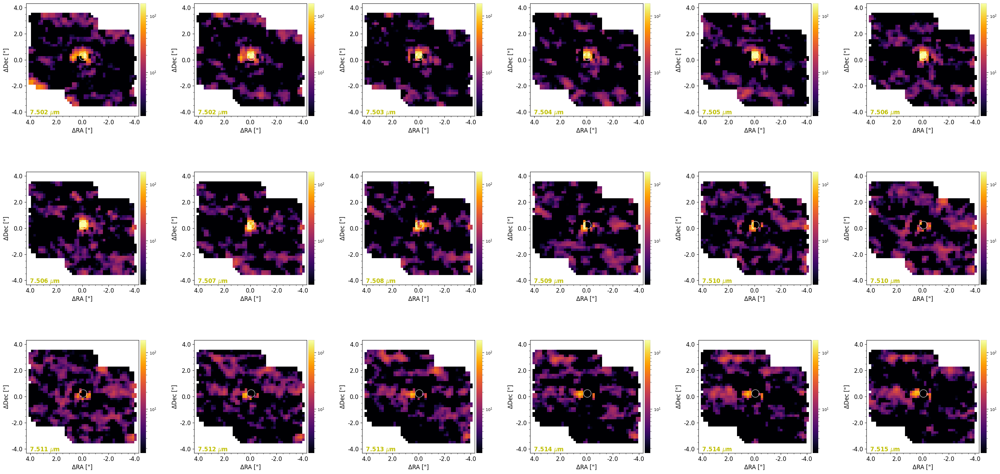

`Pixel scale set to 0.1838477563650063`


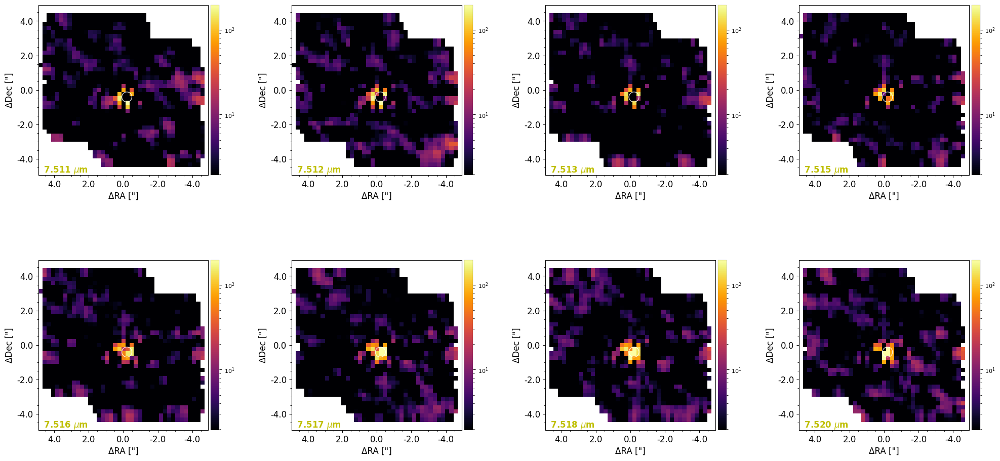

`Pixel scale set to 0.24041630813223655`


2025-02-25 09:34:25,596 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:34:25,596 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



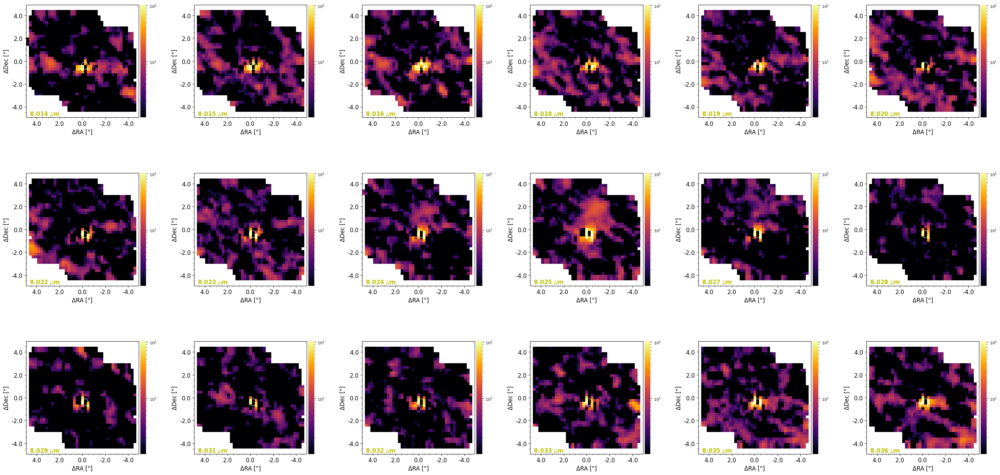

`Pixel scale set to 0.24041630813223655`


2025-02-25 09:34:29,927 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:34:29,927 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



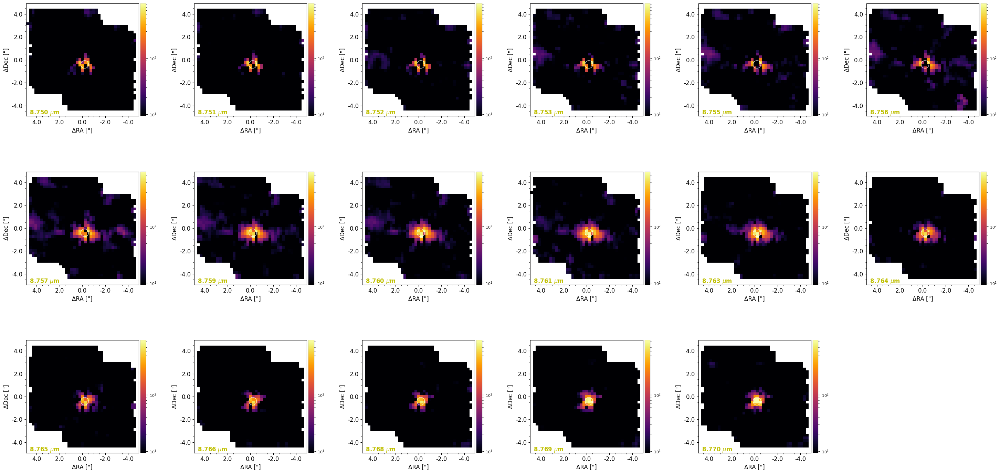

`Pixel scale set to 0.24041630813223655`


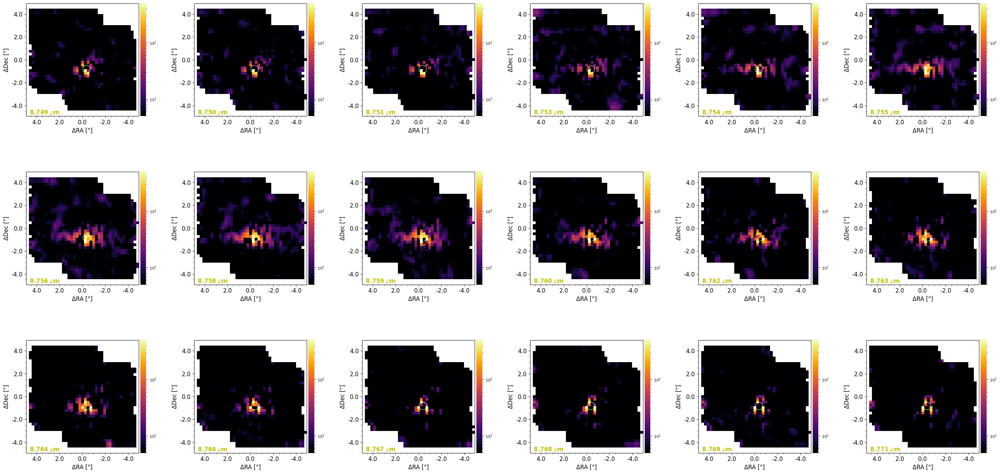

`Pixel scale set to 0.24041630813223655`


2025-02-25 09:34:37,970 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:34:37,970 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



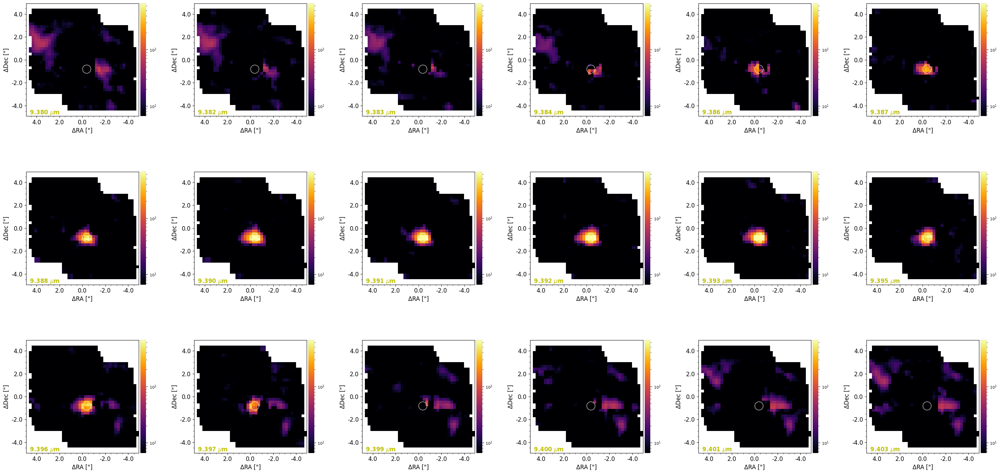

`Pixel scale set to 0.24041630813223655`


2025-02-25 09:34:41,998 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:34:41,998 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



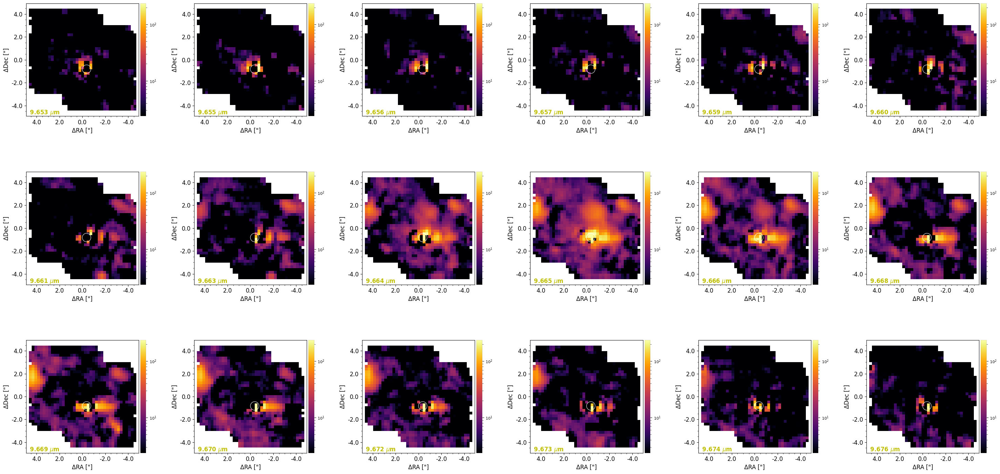

`Pixel scale set to 0.24041630813223655`


2025-02-25 09:34:46,164 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:34:46,165 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



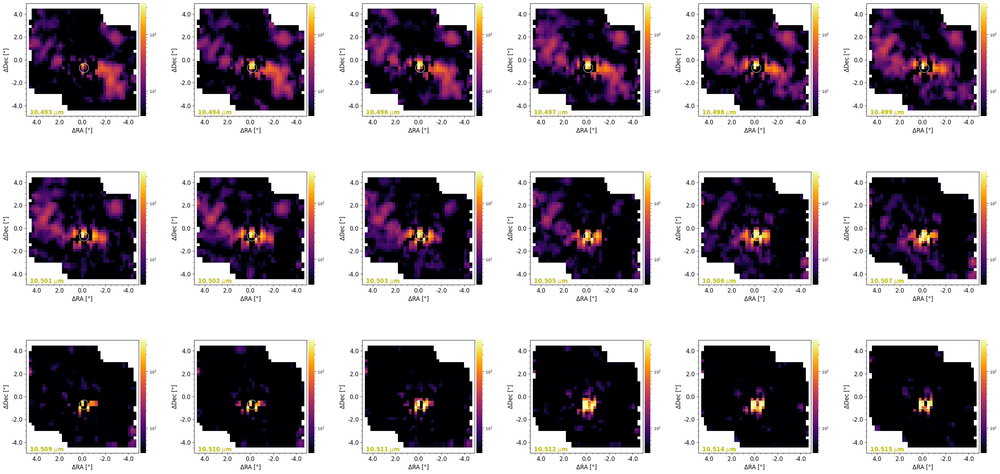

`Pixel scale set to 0.24041630813223655`


2025-02-25 09:34:50,307 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:34:50,307 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



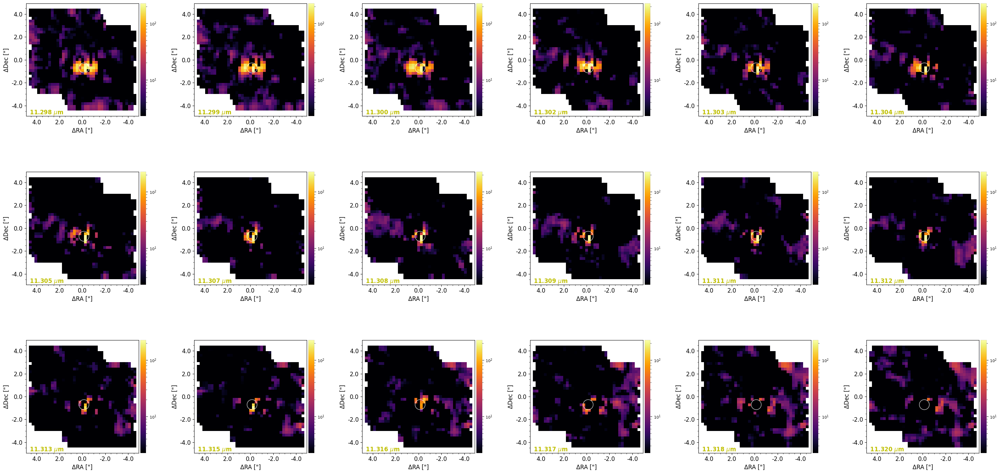

`Pixel scale set to 0.24041630813223655`


2025-02-25 09:34:54,375 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:34:54,375 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



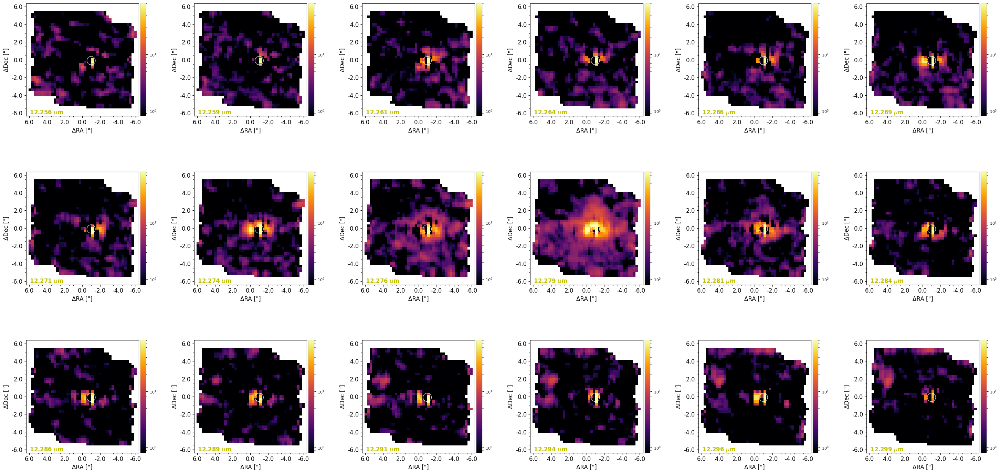

`Pixel scale set to 0.28284271668930366`


2025-02-25 09:34:58,736 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:34:58,736 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



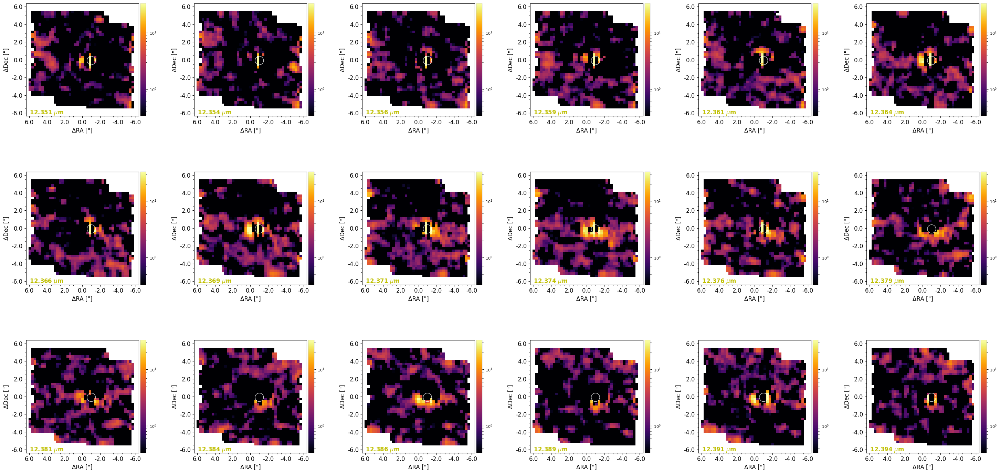

`Pixel scale set to 0.28284271668930366`


2025-02-25 09:35:03,317 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:35:03,318 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



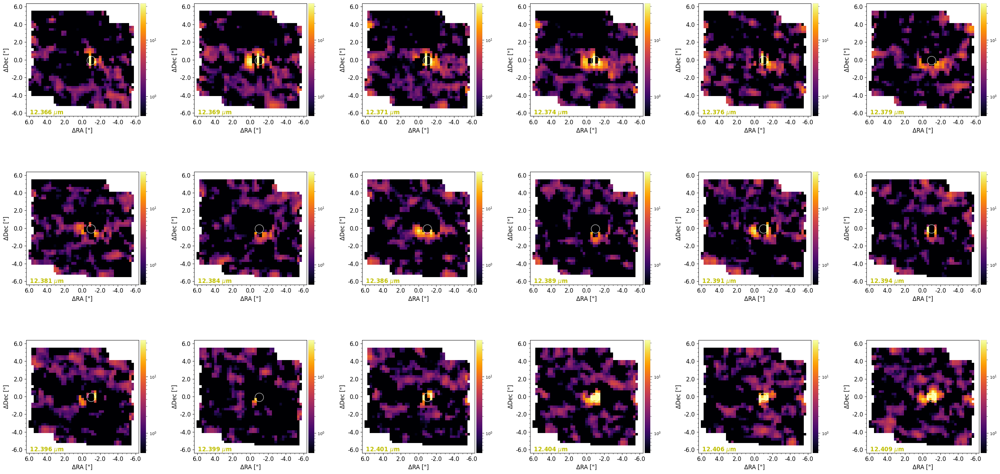

`Pixel scale set to 0.28284271668930366`


2025-02-25 09:35:08,040 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:35:08,041 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



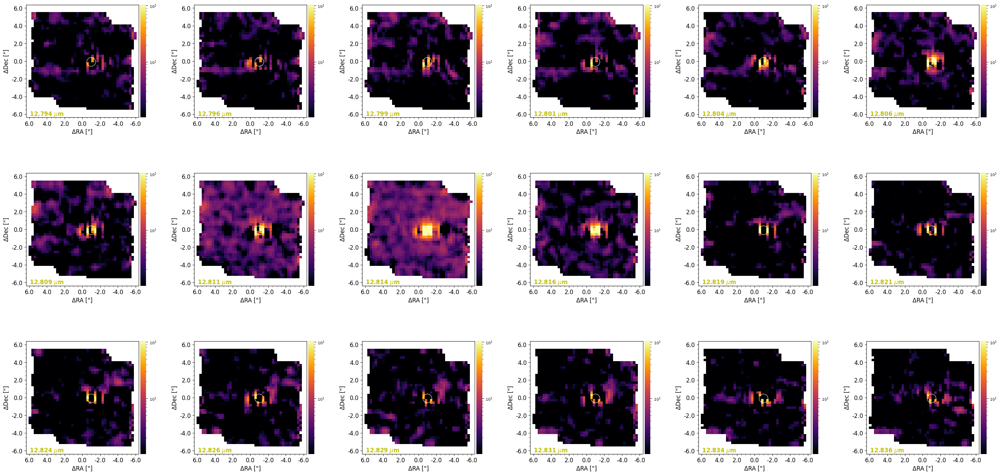

`Pixel scale set to 0.28284271668930366`


2025-02-25 09:35:12,546 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:35:12,547 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



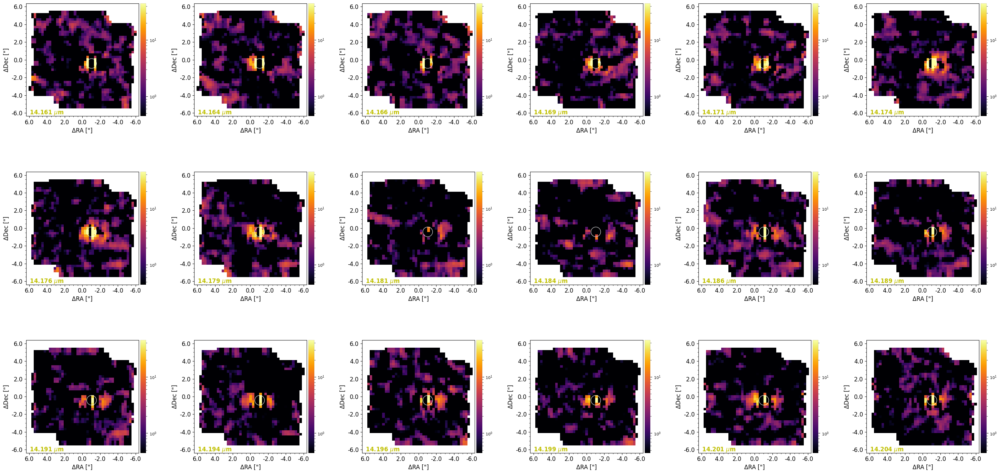

`Pixel scale set to 0.28284271668930366`


2025-02-25 09:35:17,273 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:35:17,273 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



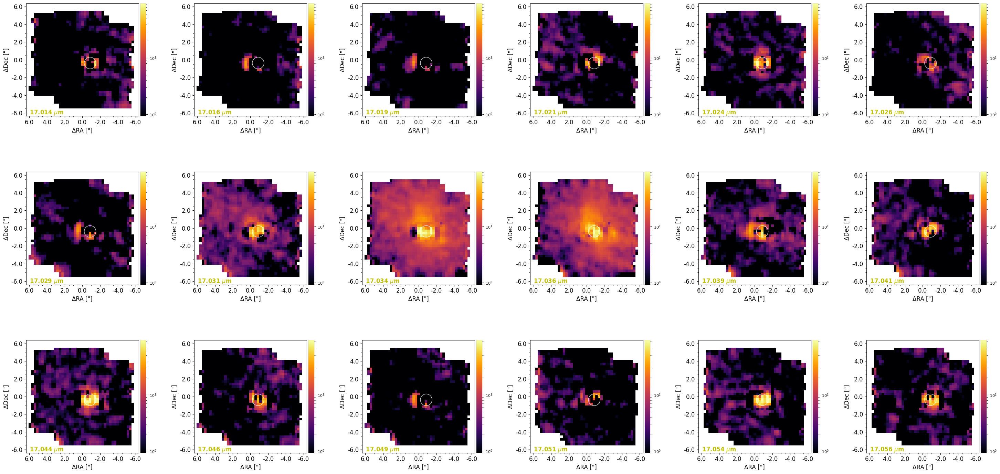

`Pixel scale set to 0.28284271668930366`


2025-02-25 09:35:22,217 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:35:22,218 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



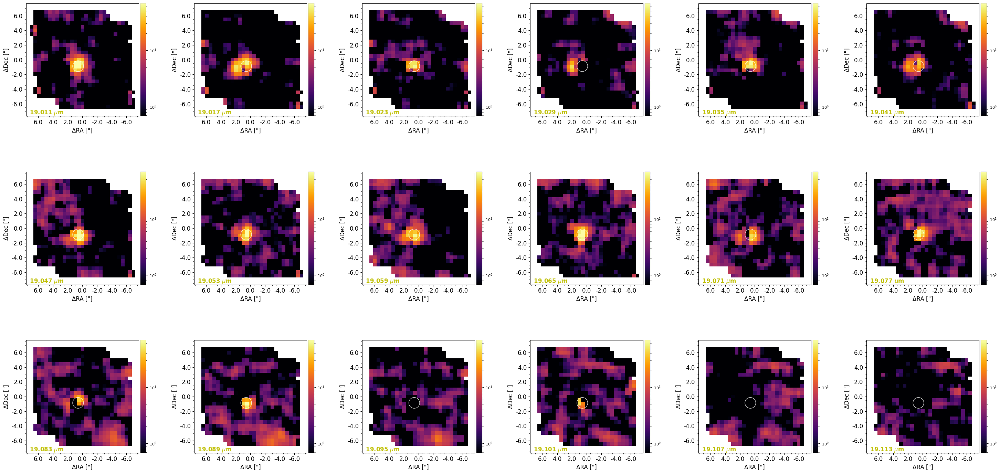

`Pixel scale set to 0.49497473840121337`


2025-02-25 09:35:28,035 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:35:28,035 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



In [128]:
if make_contsub_images:
    nf = len(calfiles_ifua)
    for ll, line in enumerate(test_lines):
        for ff, file in enumerate(calfiles_ifua):
            CC_cenfile = fits.open(file)
            cen_cube = CC_cenfile[1].data
            head = CC_cenfile[1].header
            plsc = np.sqrt((float(head['CDELT1'])*3600)**2+(float(head['CDELT2'])*3600)**2)
            # make residual cubes using median of 
            sub_cube = cen_cube.copy()
            nch = cen_cube.shape[0]
            
            fwhm_med = np.median(all_contsub_fwhms_ifua[ll*nf+ff])
            nim = len(all_plot_contsub_imgs_ifua[ll*nf+ff])
            cx_line_med = np.median(all_cx_all_line_ifua[ll*nf+ff])
            cy_line_med = np.median(all_cy_all_line_ifua[ll*nf+ff])
            if nim>0:
                vmin = np.nanpercentile(all_plot_contsub_imgs[ll*nf+ff], 0.1)
                vmax = np.nanpercentile(all_plot_contsub_imgs[ll*nf+ff], 99.9)
                plot_frames(all_plot_contsub_imgs_ifua[ll*nf+ff], log=True, cmap='inferno', pxscale=plsc, label=all_labels[ll*nf+ff],
                            rows=nim//6+int(nim%6 != 0), # play with this param to change number of rows of panels for the figure
                            ang_scale=True, ang_ticksep=2./plsc, circle=(cx_line_med, cy_line_med), circle_radius=fwhm_med,
                            label_color='y', vmin=vmin, vmax=vmax)
                plot_frames(all_plot_contsub_imgs_ifua[ll*nf+ff], log=True, cmap='inferno', pxscale=plsc, label=all_labels[ll*nf+ff],
                            rows=nim//6+int(nim%6 != 0), # play with this param to change number of rows of panels for the figure
                            ang_scale=True, ang_ticksep=2./plsc, circle=(cx_line_med, cy_line_med), circle_radius=fwhm_med,
                            label_color='y', vmin=vmin, vmax=vmax,
                            save=fig_dir+"Continuum_subtracted_{}_ifua_aligned.pdf".format(test_labels[ll]))
            CC_cenfile.close()

In [129]:
plt.close()

**SKY-aligned**

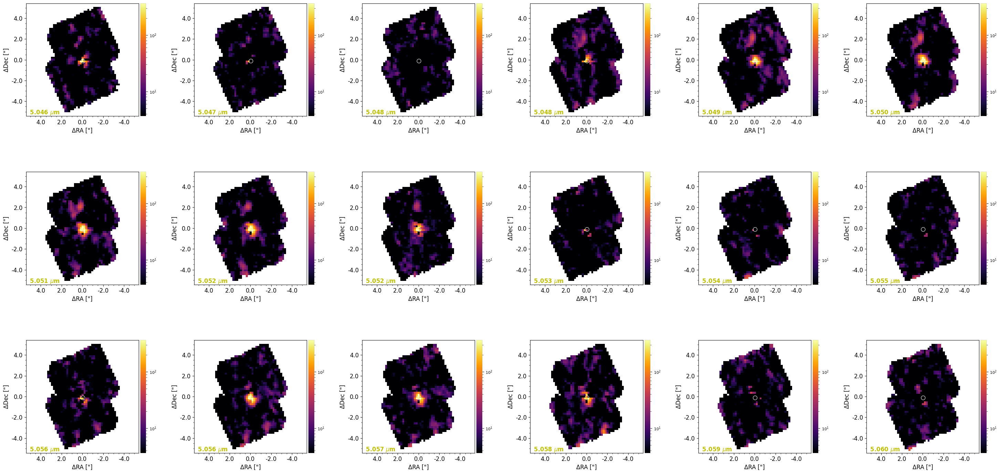

`Pixel scale set to 0.1838477563650063`


2025-02-25 09:35:32,895 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:35:32,896 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



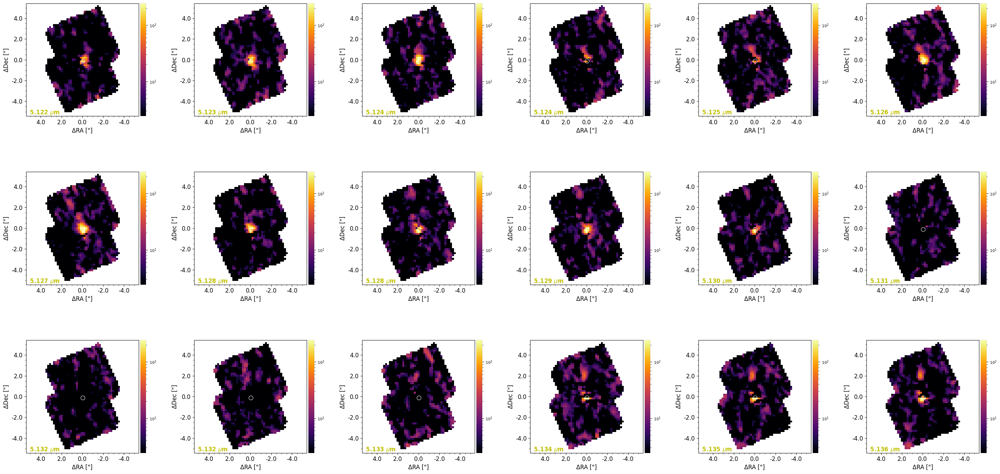

`Pixel scale set to 0.1838477563650063`


2025-02-25 09:35:38,018 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:35:38,018 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



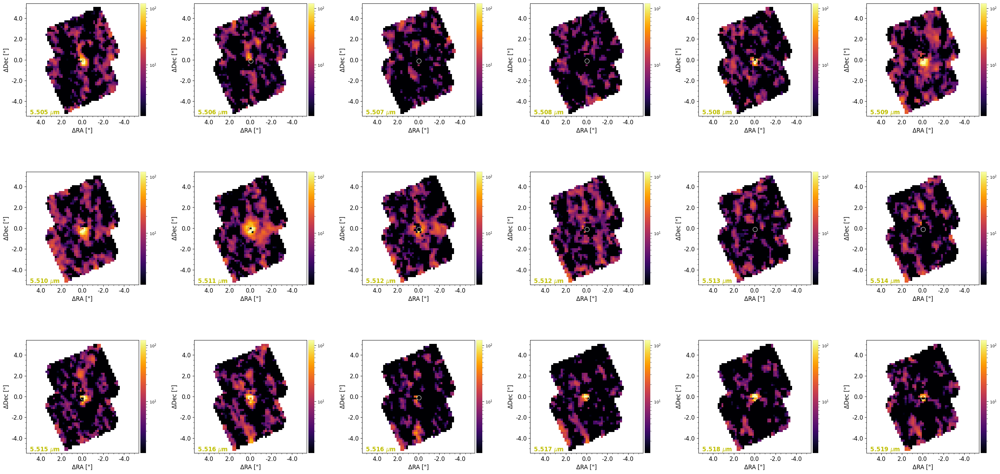

`Pixel scale set to 0.1838477563650063`


2025-02-25 09:35:43,093 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:35:43,093 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



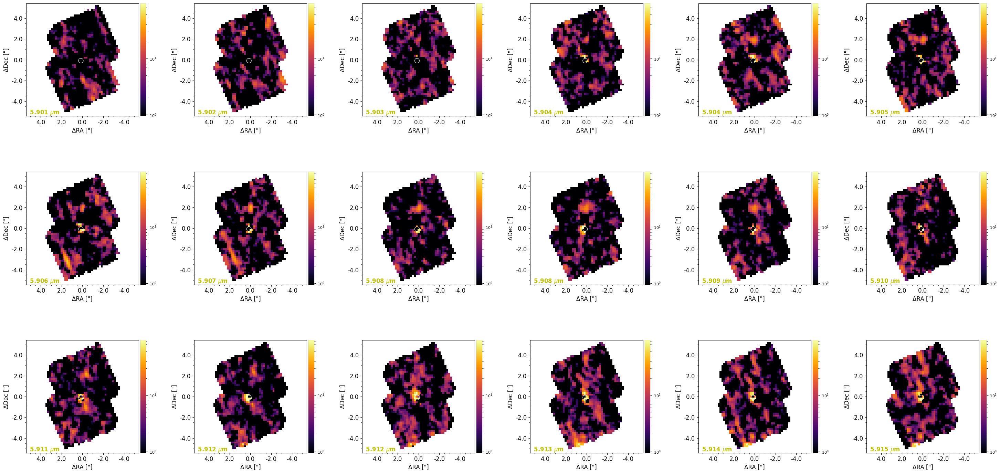

`Pixel scale set to 0.1838477563650063`


2025-02-25 09:35:48,116 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:35:48,117 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



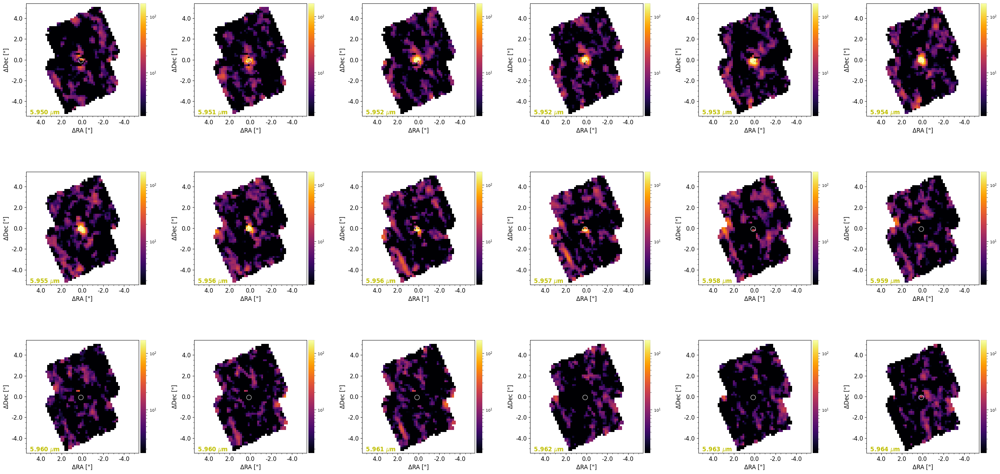

`Pixel scale set to 0.1838477563650063`


2025-02-25 09:35:52,888 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:35:52,888 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



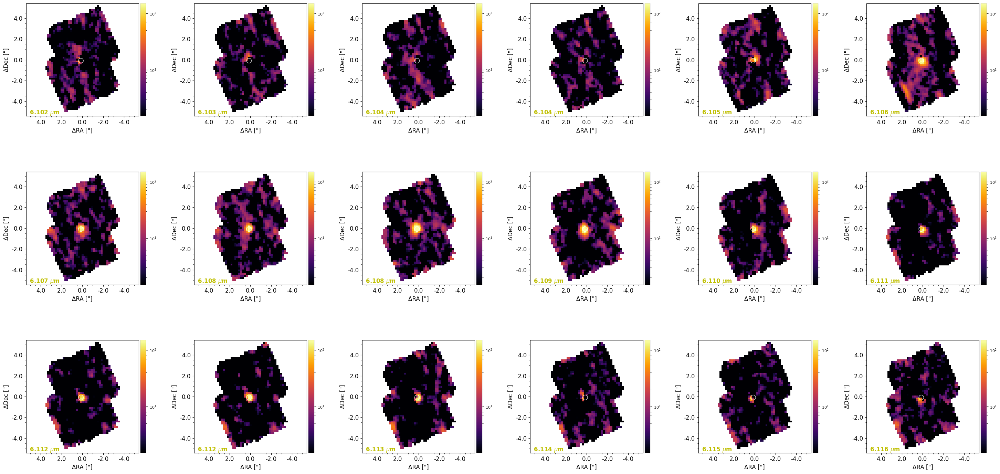

`Pixel scale set to 0.1838477563650063`


2025-02-25 09:35:57,813 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:35:57,813 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



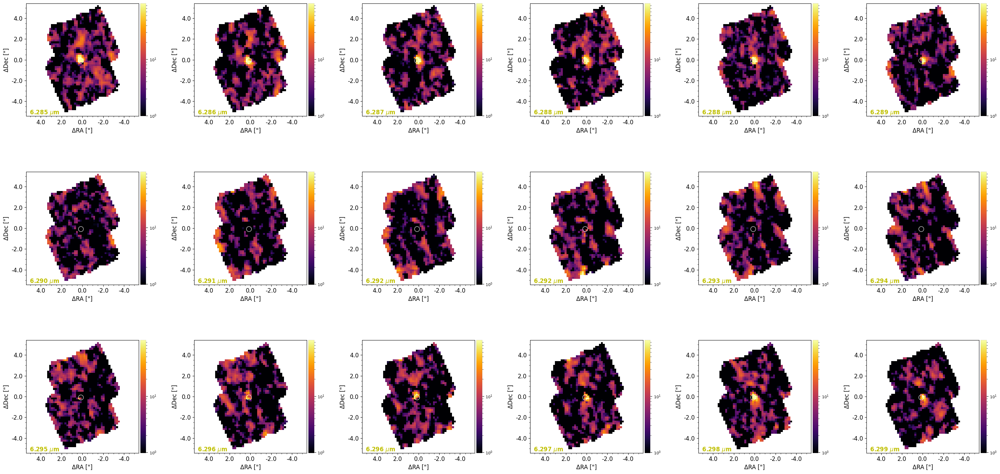

`Pixel scale set to 0.1838477563650063`


2025-02-25 09:36:02,714 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:36:02,715 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



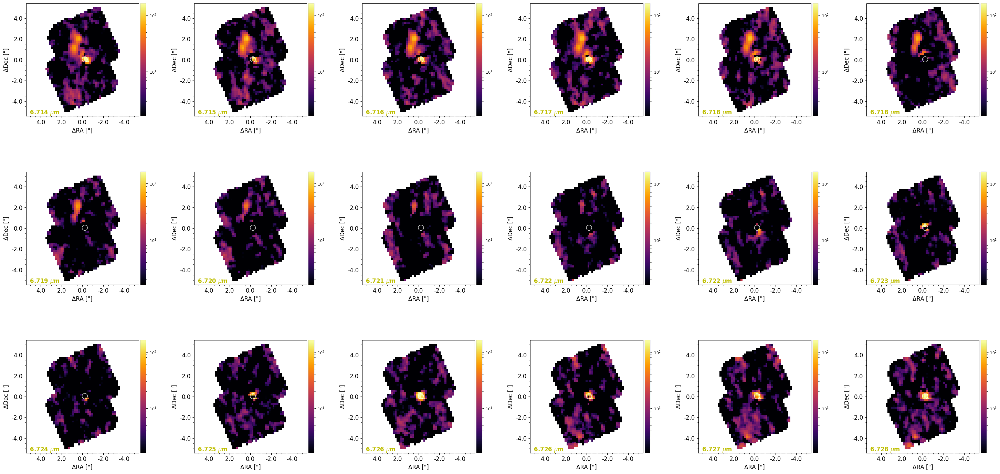

`Pixel scale set to 0.1838477563650063`


2025-02-25 09:36:07,413 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:36:07,413 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



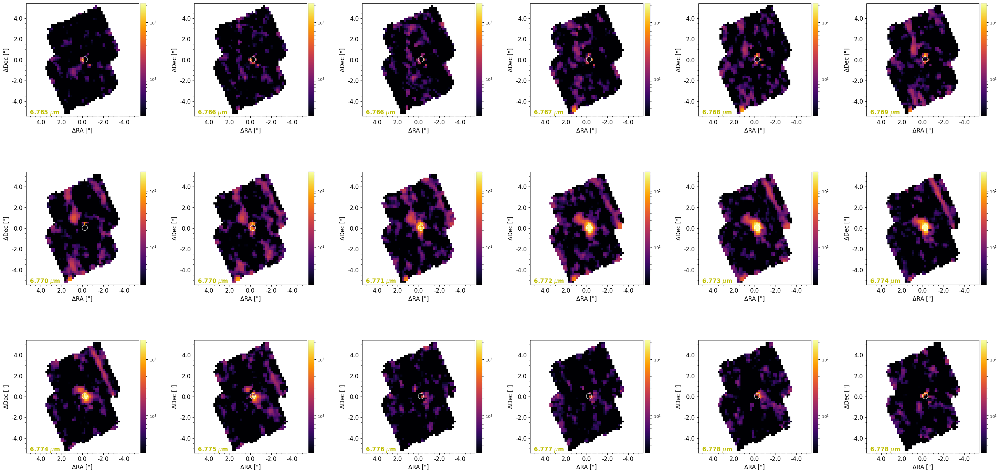

`Pixel scale set to 0.1838477563650063`


2025-02-25 09:36:11,585 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:36:11,585 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



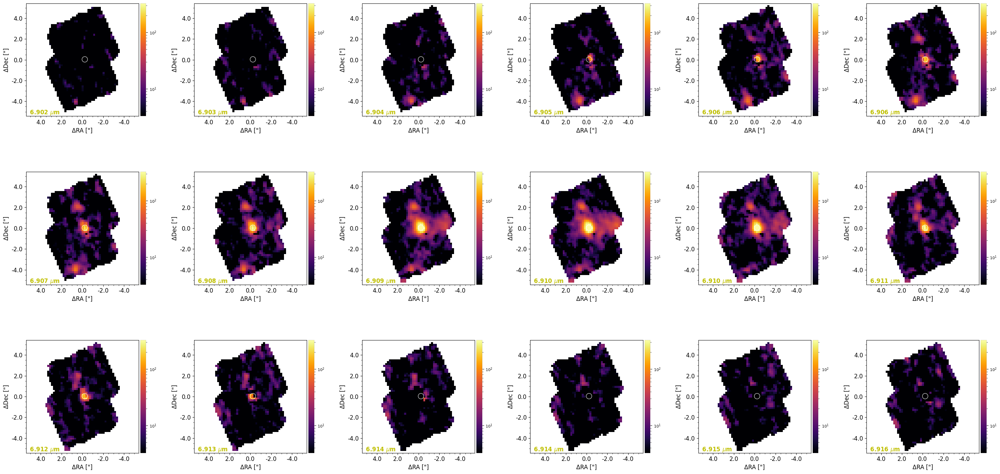

`Pixel scale set to 0.1838477563650063`


2025-02-25 09:36:15,834 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:36:15,834 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



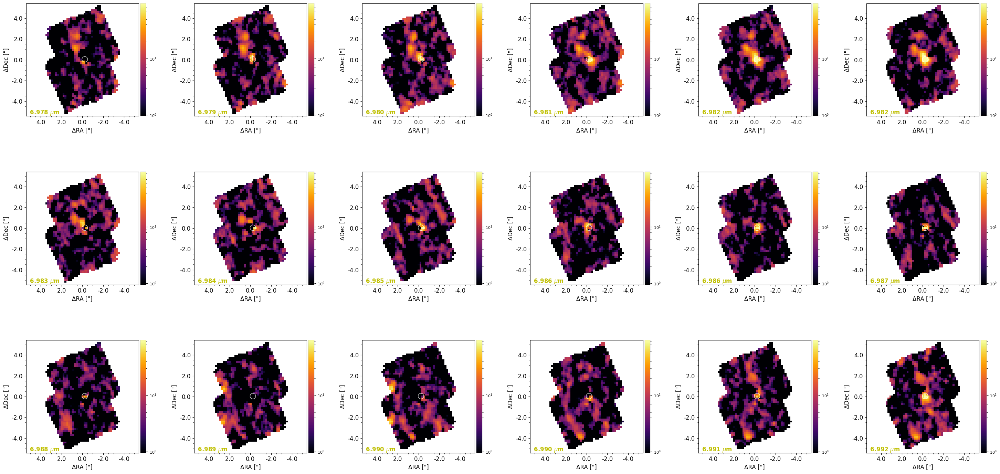

`Pixel scale set to 0.1838477563650063`


2025-02-25 09:36:20,496 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:36:20,496 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



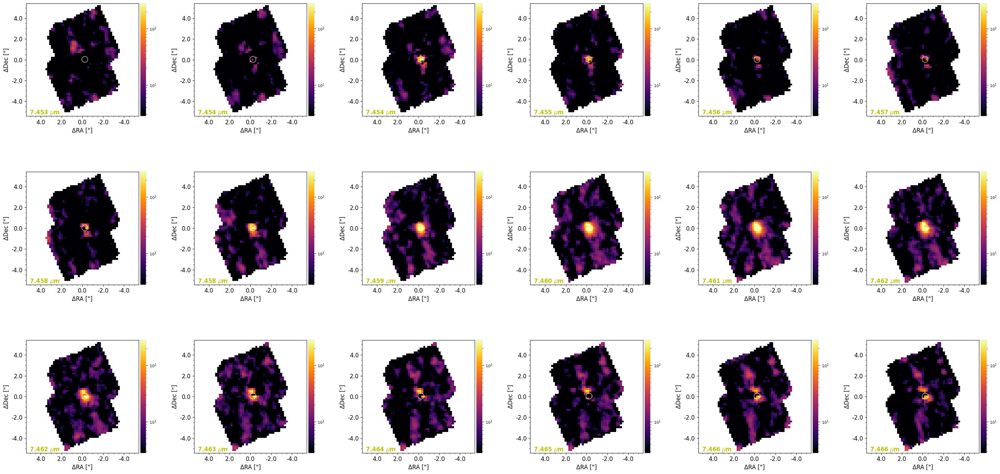

`Pixel scale set to 0.1838477563650063`


2025-02-25 09:36:24,950 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:36:24,950 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



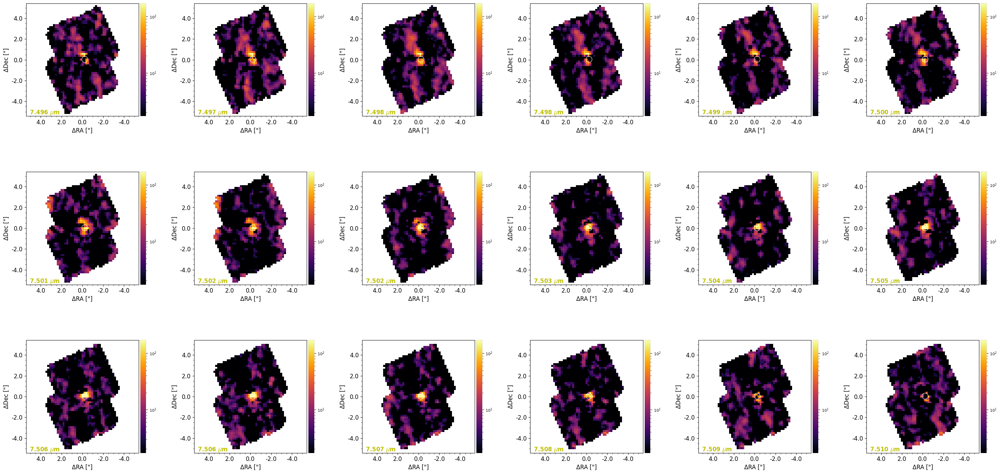

`Pixel scale set to 0.1838477563650063`


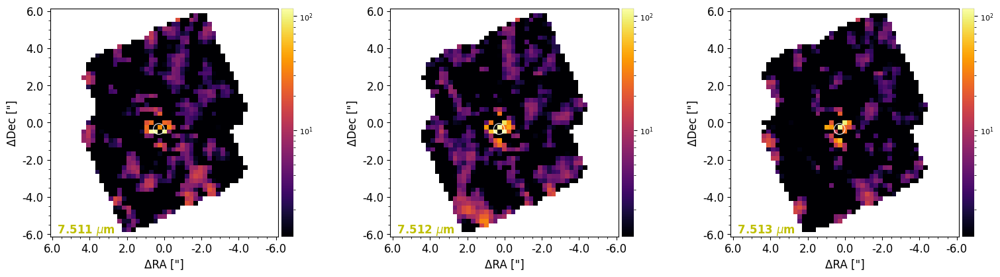

`Pixel scale set to 0.24041630813223655`


2025-02-25 09:36:30,087 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:36:30,088 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



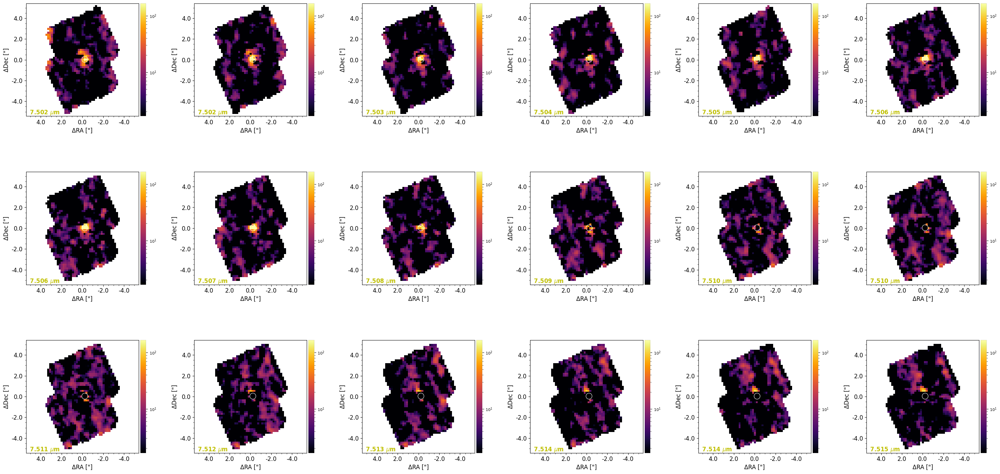

`Pixel scale set to 0.1838477563650063`


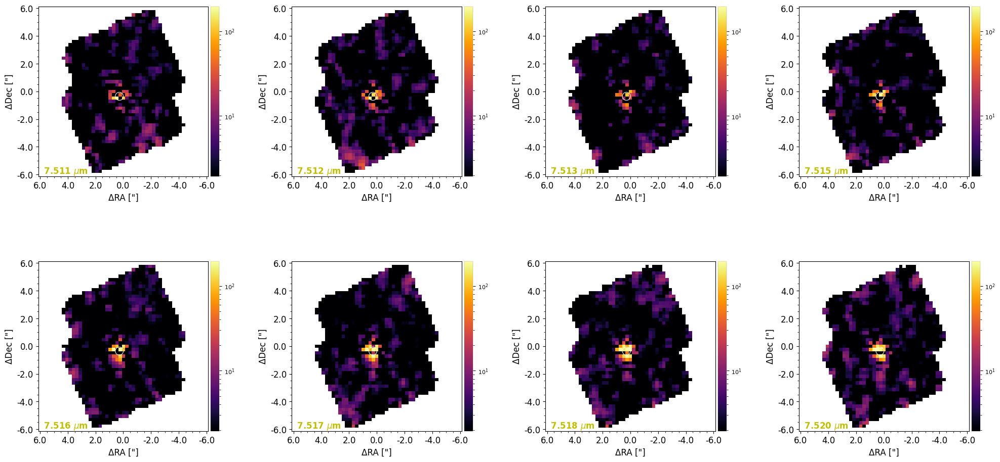

`Pixel scale set to 0.24041630813223655`


2025-02-25 09:36:36,276 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:36:36,276 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



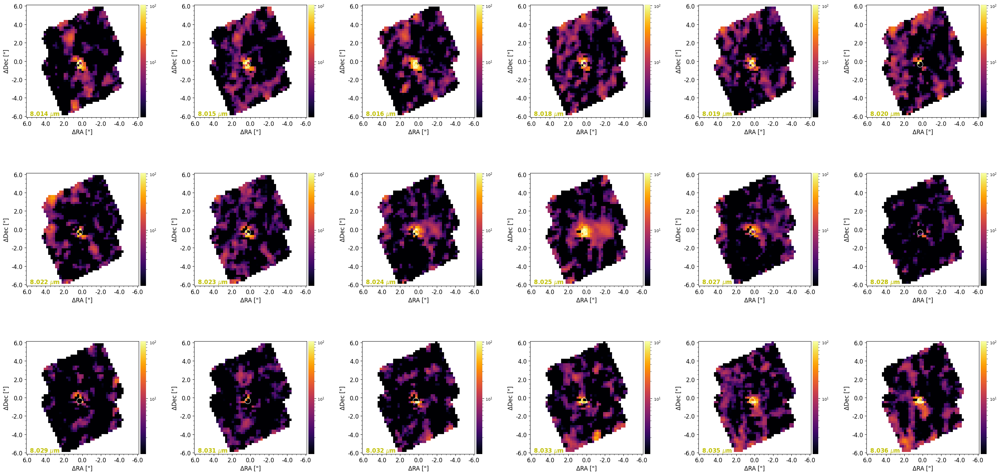

`Pixel scale set to 0.24041630813223655`


2025-02-25 09:36:40,968 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:36:40,968 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



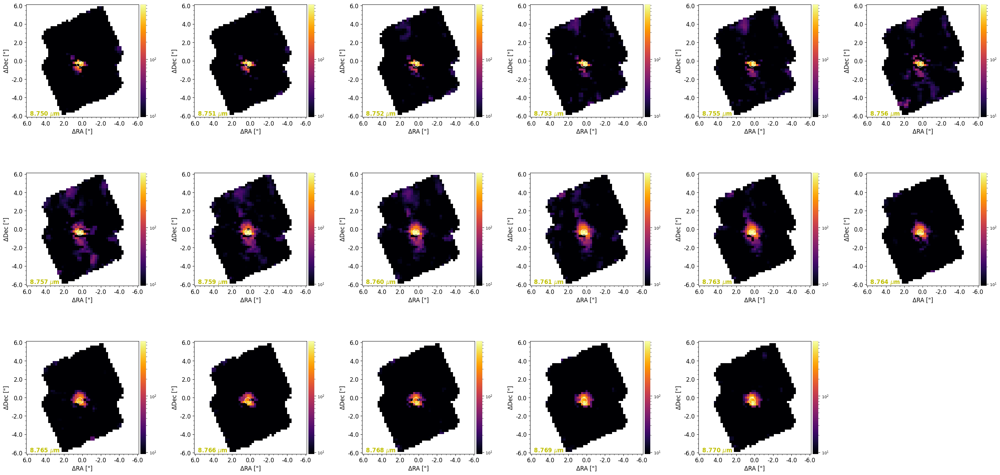

`Pixel scale set to 0.24041630813223655`


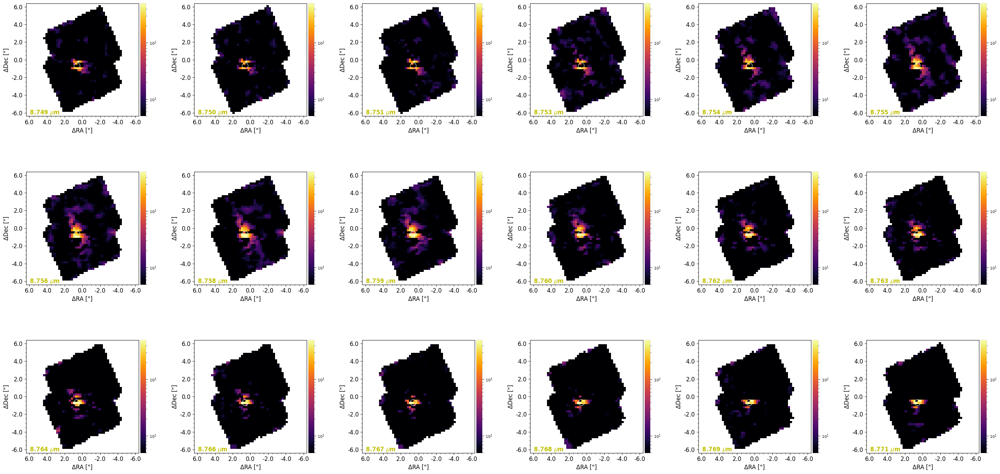

`Pixel scale set to 0.24041630813223655`


2025-02-25 09:36:49,658 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:36:49,659 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



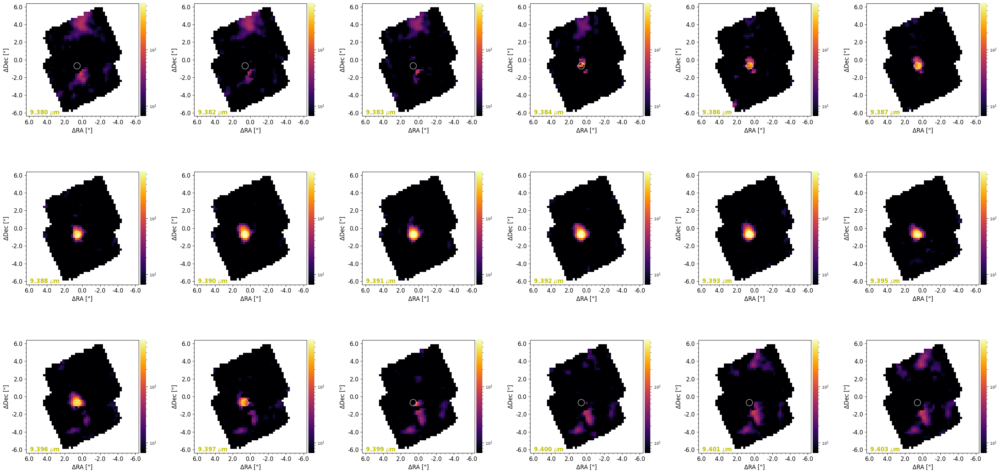

`Pixel scale set to 0.24041630813223655`


2025-02-25 09:36:54,134 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:36:54,134 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



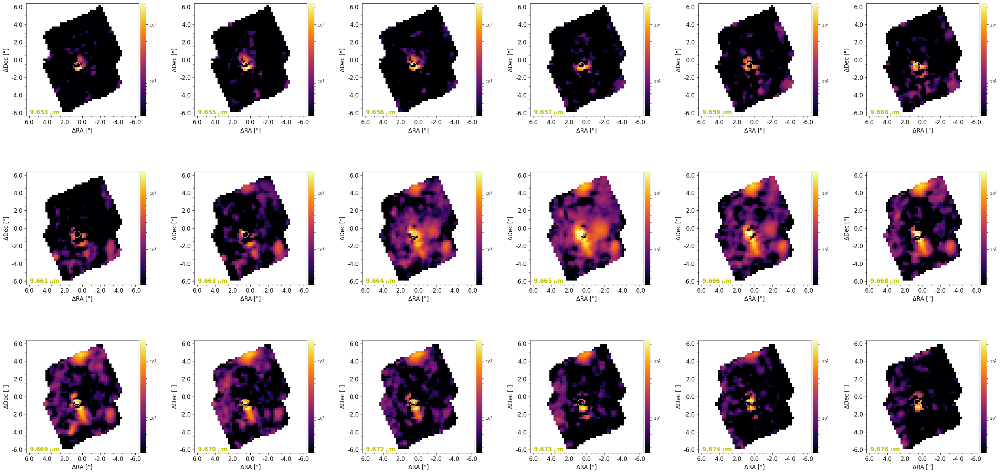

`Pixel scale set to 0.24041630813223655`


2025-02-25 09:36:58,888 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:36:58,889 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



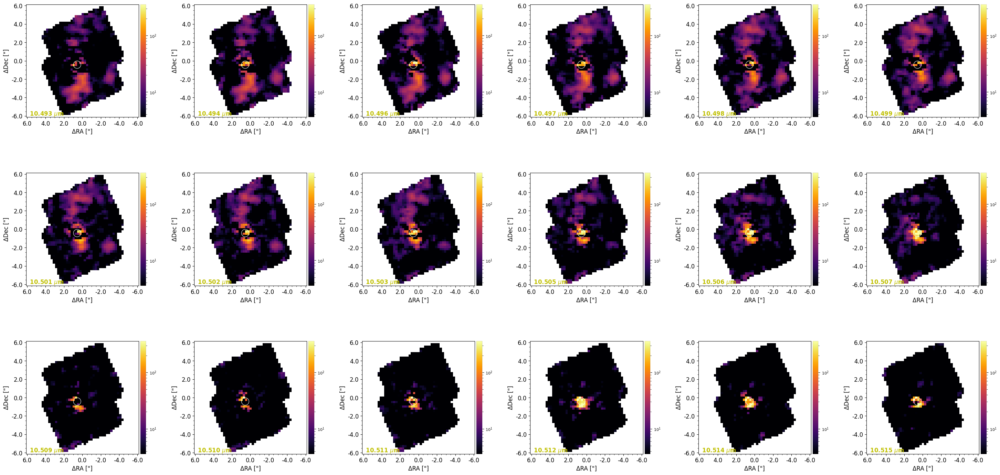

`Pixel scale set to 0.24041630813223655`


2025-02-25 09:37:03,491 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:37:03,492 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



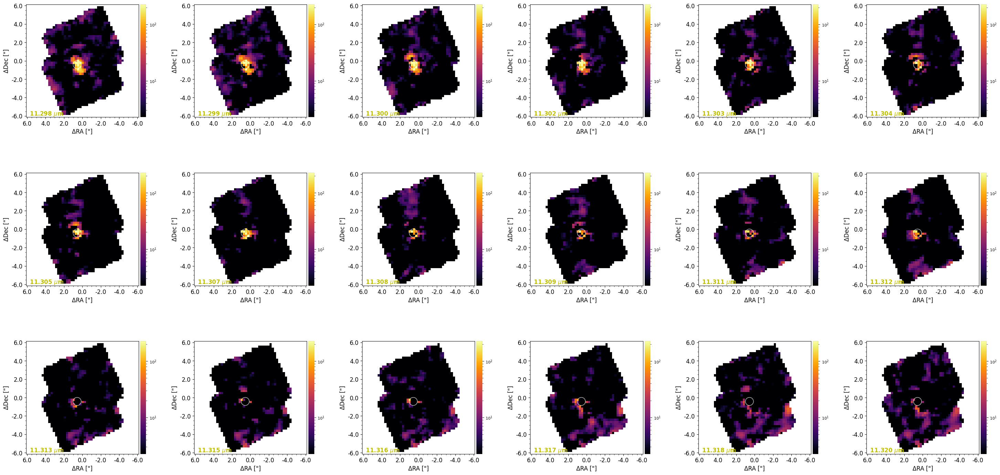

`Pixel scale set to 0.24041630813223655`


2025-02-25 09:37:08,295 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:37:08,295 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



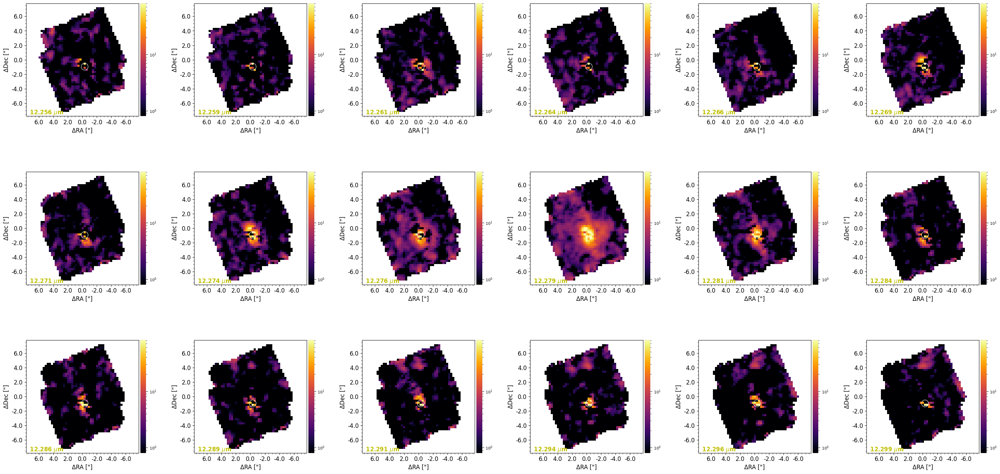

`Pixel scale set to 0.28284271668930366`


2025-02-25 09:37:13,517 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:37:13,518 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



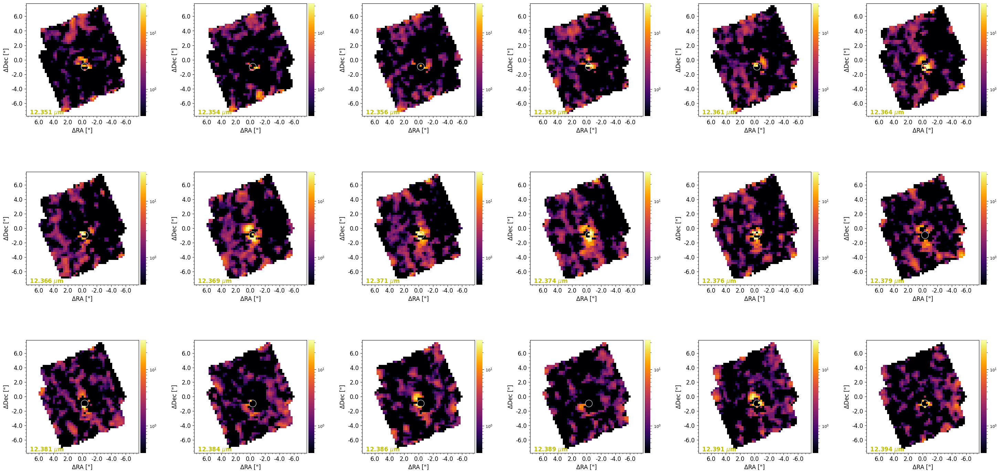

`Pixel scale set to 0.28284271668930366`


2025-02-25 09:37:19,050 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:37:19,050 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



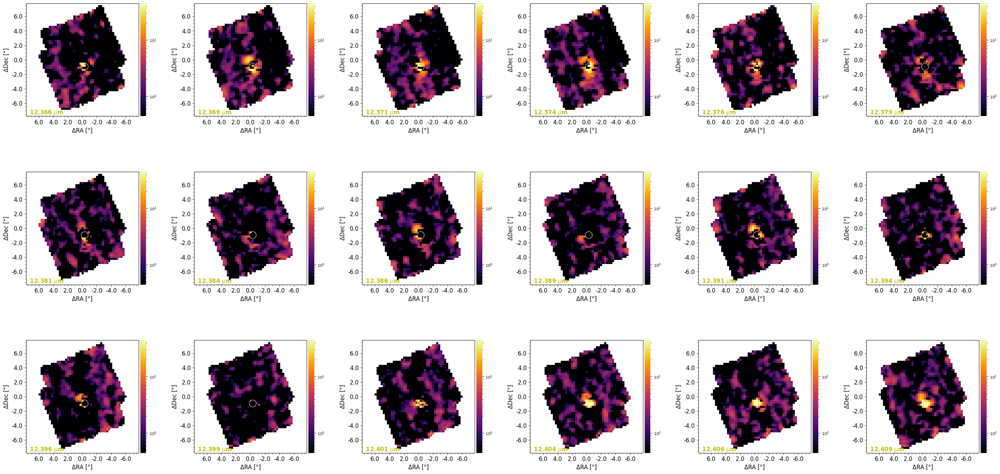

`Pixel scale set to 0.28284271668930366`


2025-02-25 09:37:24,619 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:37:24,620 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



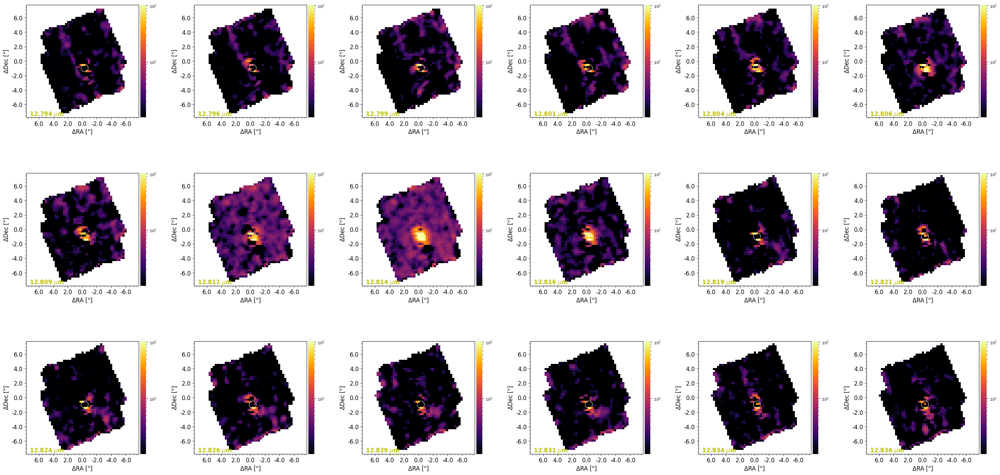

`Pixel scale set to 0.28284271668930366`


2025-02-25 09:37:30,329 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:37:30,330 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



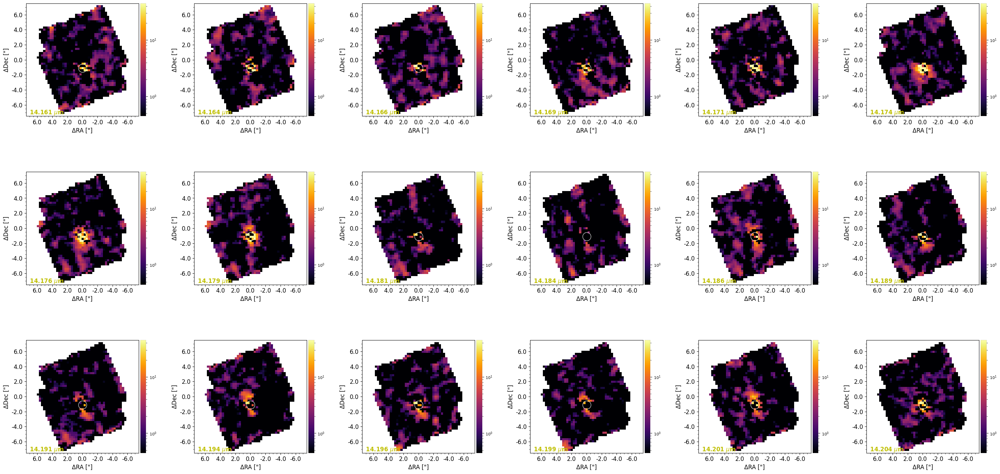

`Pixel scale set to 0.28284271668930366`


2025-02-25 09:37:35,708 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:37:35,708 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



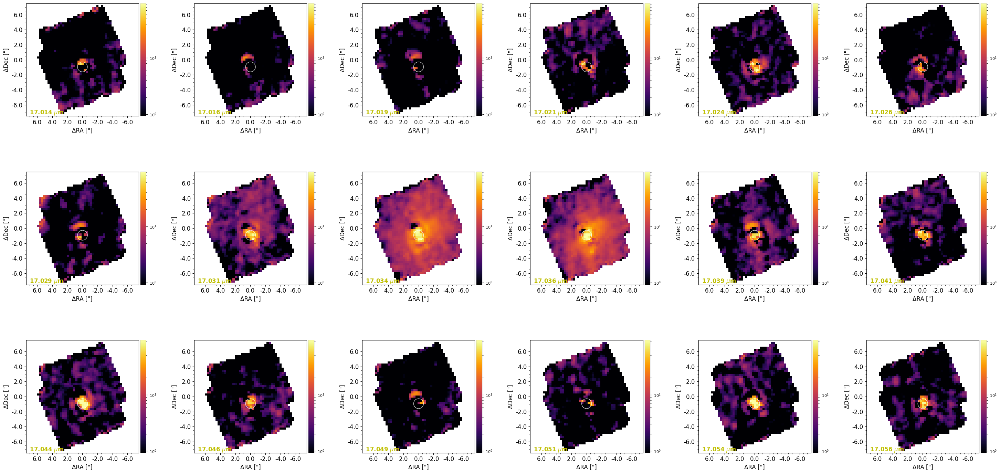

`Pixel scale set to 0.28284271668930366`


2025-02-25 09:37:41,248 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:37:41,248 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



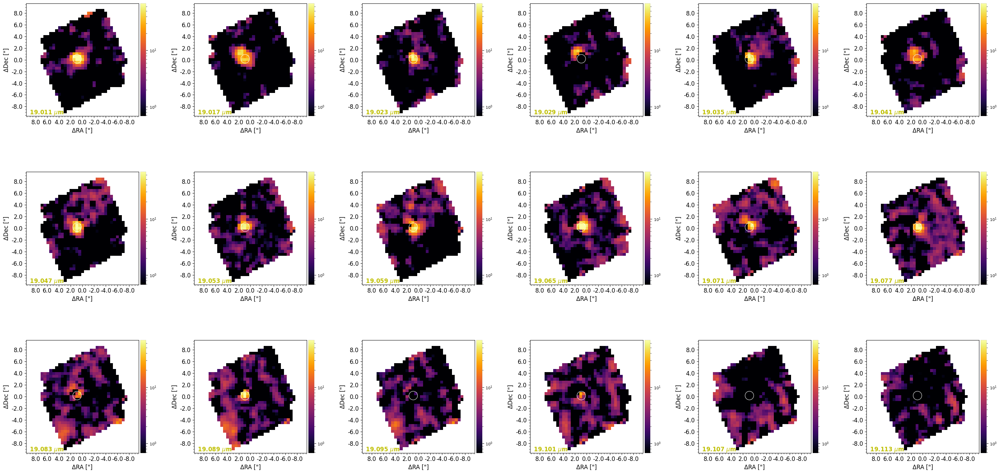

`Pixel scale set to 0.49497473840121337`


2025-02-25 09:37:46,893 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 09:37:46,893 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



In [130]:
if make_contsub_images:
    for ll, line in enumerate(test_lines):
        for ff, file in enumerate(calfiles):
            CC_cenfile = fits.open(file)
            cen_cube = CC_cenfile[1].data
            head = CC_cenfile[1].header
            plsc = np.sqrt((float(head['CDELT1'])*3600)**2+(float(head['CDELT2'])*3600)**2)
            # make residual cubes using median of 
            sub_cube = cen_cube.copy()
            nch = cen_cube.shape[0]
            
            fwhm_med = np.median(all_contsub_fwhms[ll*nf+ff])
            nim = len(all_plot_contsub_imgs[ll*nf+ff])
            cx_line_med = np.median(all_cx_all_line[ll*nf+ff])
            cy_line_med = np.median(all_cy_all_line[ll*nf+ff])
            if nim>0:
                vmin = np.nanpercentile(all_plot_contsub_imgs[ll*nf+ff], 0.1)
                vmax = np.nanpercentile(all_plot_contsub_imgs[ll*nf+ff], 99.9)
                plot_frames(all_plot_contsub_imgs[ll*nf+ff], log=True, cmap='inferno', pxscale=plsc, label=all_labels[ll*nf+ff],
                            rows=nim//6+int(nim%6 != 0), # play with this param to change number of rows of panels for the figure
                            ang_scale=True, ang_ticksep=2./plsc, circle=(cx_line_med, cy_line_med), circle_radius=fwhm_med,
                            label_color='y', vmin=vmin, vmax=vmax)
                plot_frames(all_plot_contsub_imgs[ll*nf+ff], log=True, cmap='inferno', pxscale=plsc, label=all_labels[ll*nf+ff],
                            rows=nim//6+int(nim%6 != 0), # play with this param to change number of rows of panels for the figure
                            ang_scale=True, ang_ticksep=2./plsc, circle=(cx_line_med, cy_line_med), circle_radius=fwhm_med,
                            label_color='y', vmin=vmin, vmax=vmax, 
                            save=fig_dir+"Continuum_subtracted_{}_sky_aligned.pdf".format(test_labels[ll]))
            CC_cenfile.close()

In [131]:
plt.close()

If after inspection of the sky-aligned frames you identify a feature in some lines to characterize, adapt the following variables (e.g. for a feature seen in H2 S(n) lines), to calculate its integrated flux, and produce **integrated maps**:

In [132]:
# Example case of no feature identified
feature_label = None # or '_blob', or '_star'
feature_xy_as = None # or (-2.1, 0.3) # in arcsec.
feature_lines = [] #['H2_S(7)','H2_S(6)', 'H2_S(5)', 'H2_S(4)', 'H2_S(3)', 'H2_S(2)', 'H2_S(1)']
smooth_im = False   
int_ch = None # or e.g. [(7, 9), (7, 10), (7, 11), (9, 10), (8, 11), (9, 10), (7,9)] # first and last channel image for integration.
feature_r_as = 1 # radius in arcsec for aperture used for integration

In [133]:
# Example case of a blob identified
feature_label = '_blob' #, or '_star'
feature_xy_as = (-2.1, 0.3) # in arcsec.
feature_lines = ['H2_S(7)','H2_S(6)', 'H2_S(5)', 'H2_S(4)', 'H2_S(3)', 'H2_S(2)', 'H2_S(1)']
smooth_im = True  # whether to low-pass filter the image before integration
int_ch = [(7, 9), (7, 10), (7, 11), (9, 10), (8, 11), (9, 10), (7,9)]  # first and last channel image for integration.
feature_r_as = 1 # radius in arcsec for aperture used for integration

In [134]:
from vip_hci.var import mask_circle, frame_filter_lowpass

2025-02-25 10:01:08,355 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 10:01:08,356 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



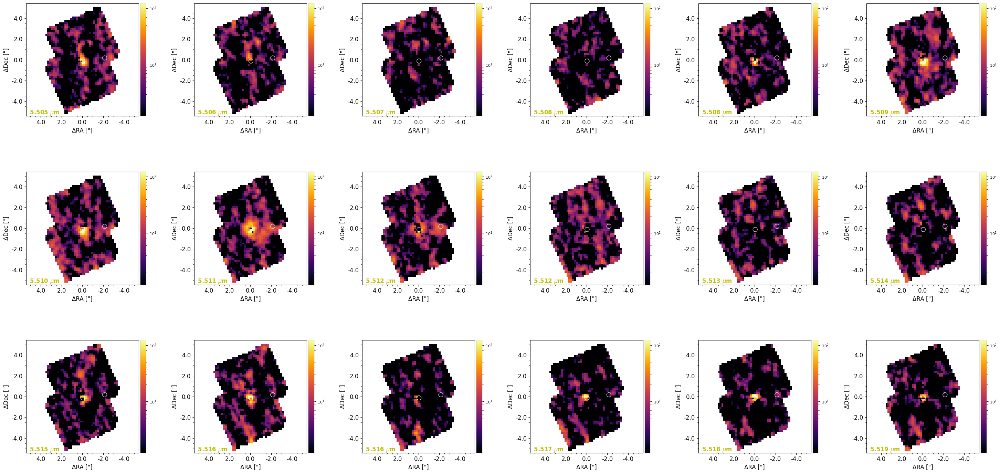

`Pixel scale set to 0.1838477563650063`
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00


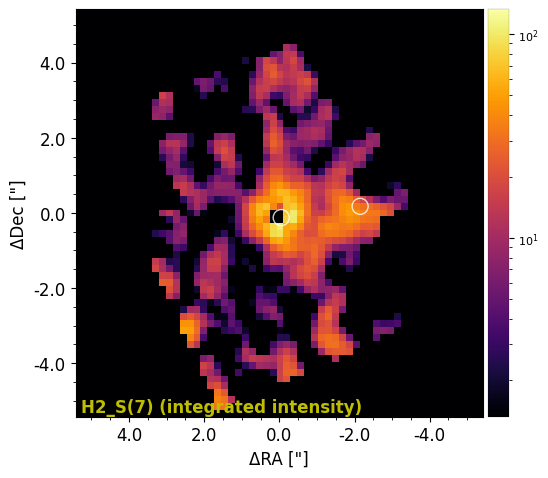

2025-02-25 10:01:13,742 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 10:01:13,744 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



`Pixel scale set to 0.1838477563650063`


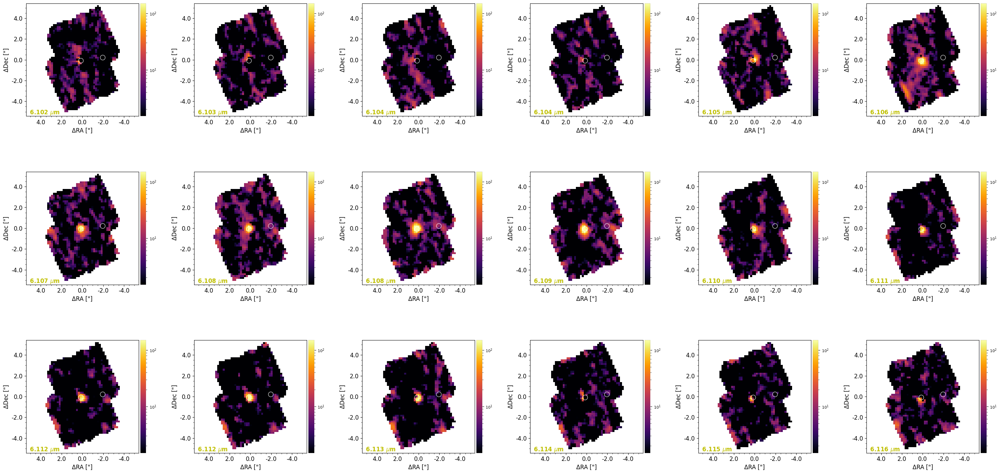

`Pixel scale set to 0.1838477563650063`
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00


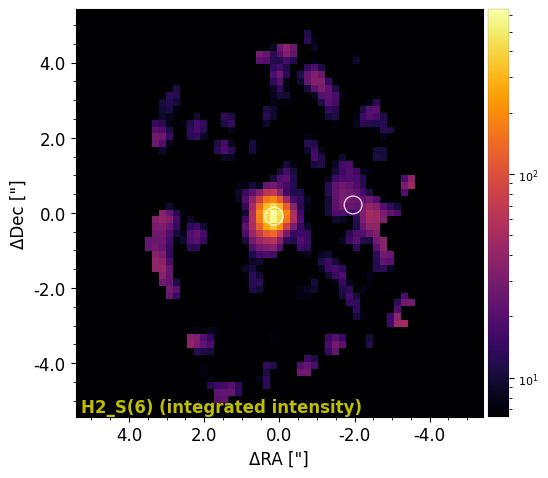

`Pixel scale set to 0.1838477563650063`


2025-02-25 10:01:18,793 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 10:01:18,794 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



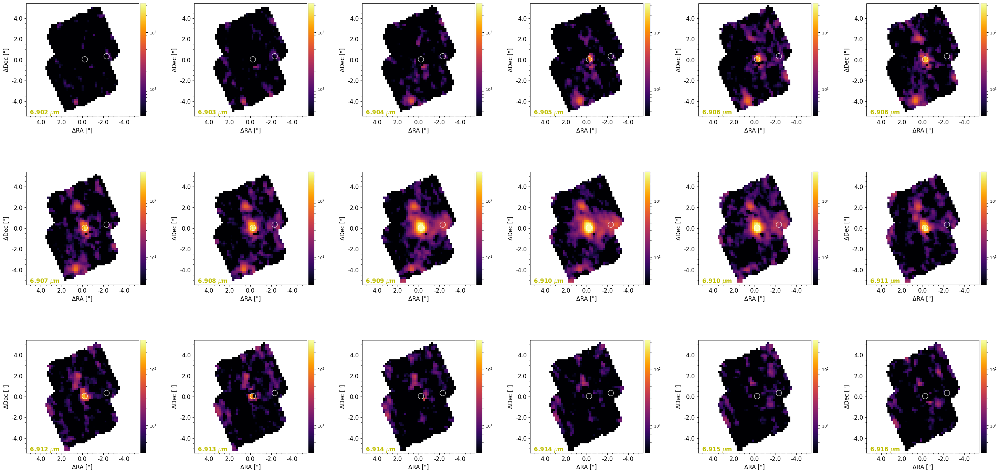

`Pixel scale set to 0.1838477563650063`
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00


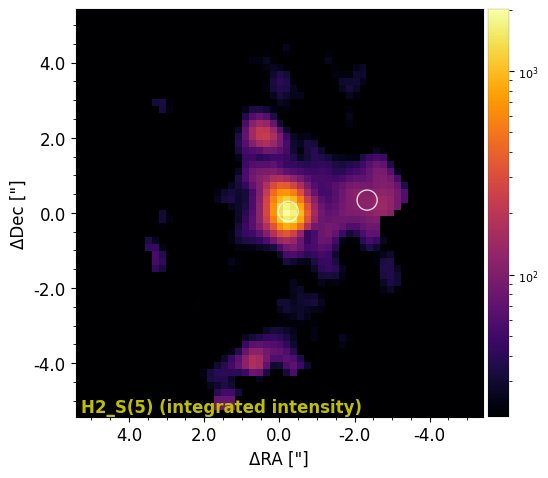

`Pixel scale set to 0.1838477563650063`


2025-02-25 10:01:23,866 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 10:01:23,867 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



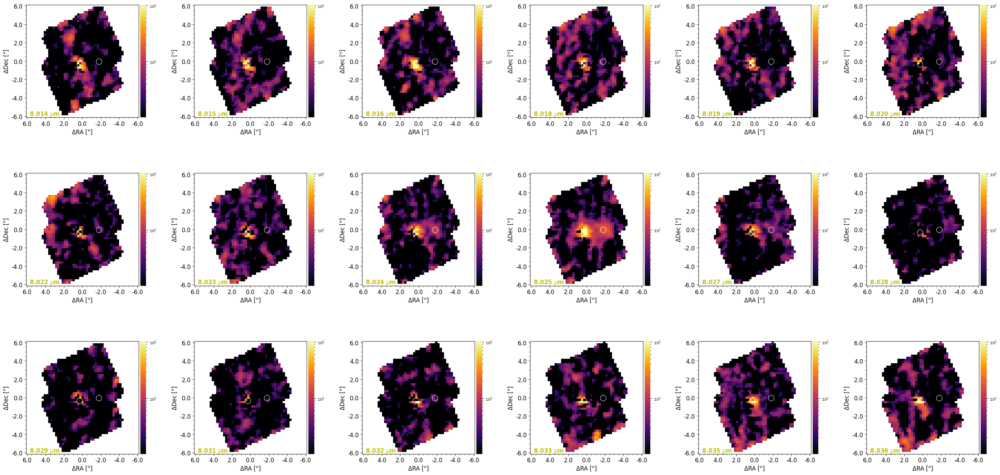

`Pixel scale set to 0.24041630813223655`
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00


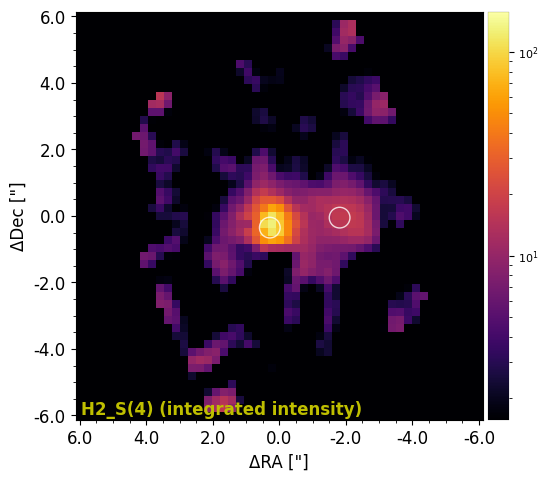

`Pixel scale set to 0.24041630813223655`


2025-02-25 10:01:29,219 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 10:01:29,220 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



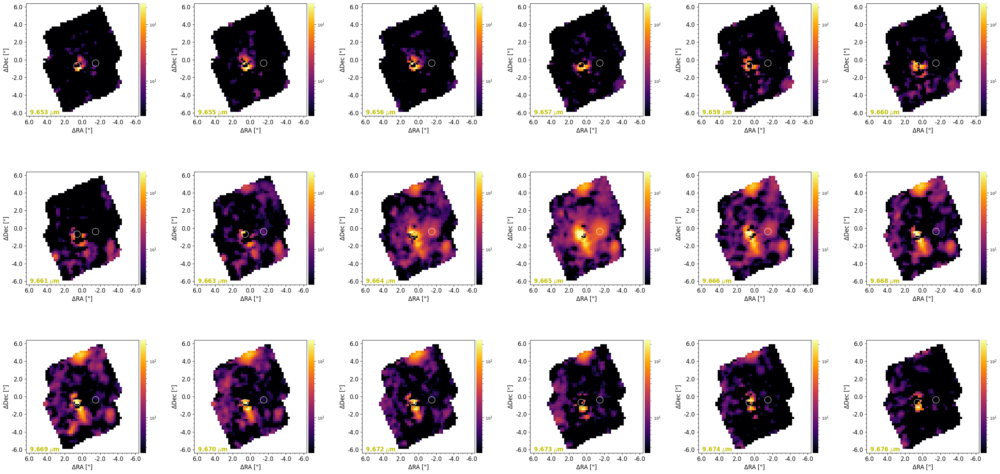

`Pixel scale set to 0.24041630813223655`
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00


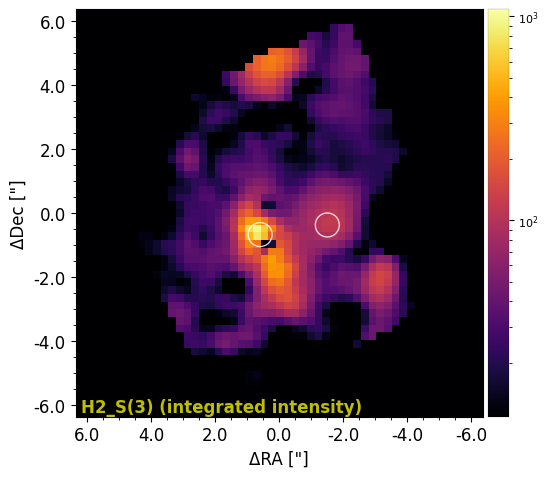

`Pixel scale set to 0.24041630813223655`


2025-02-25 10:01:34,593 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 10:01:34,593 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



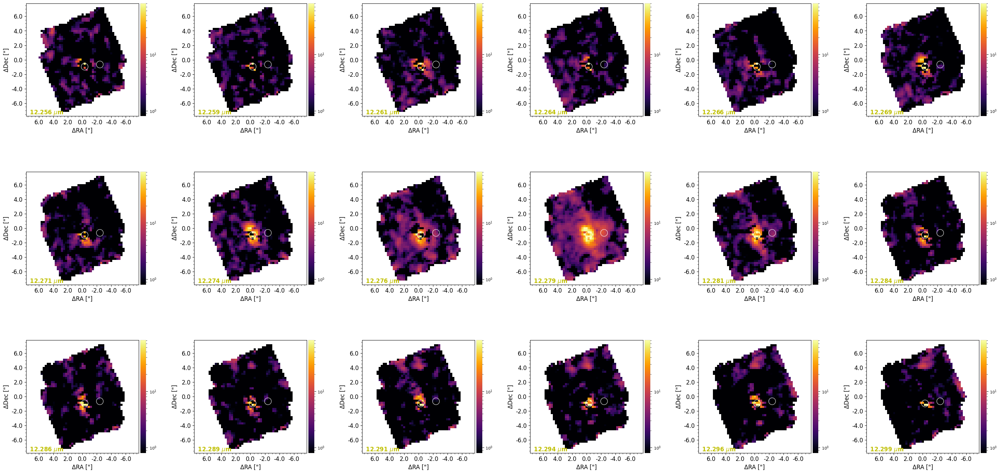

`Pixel scale set to 0.28284271668930366`
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00


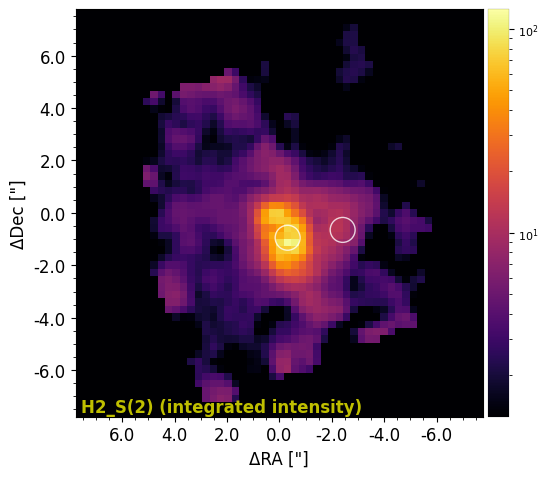

`Pixel scale set to 0.28284271668930366`


2025-02-25 10:01:40,334 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 10:01:40,335 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



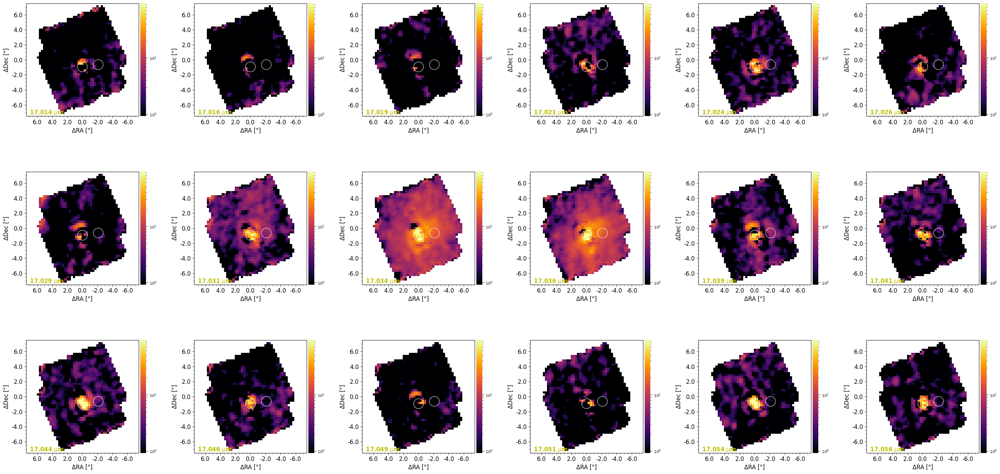

`Pixel scale set to 0.28284271668930366`
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:00


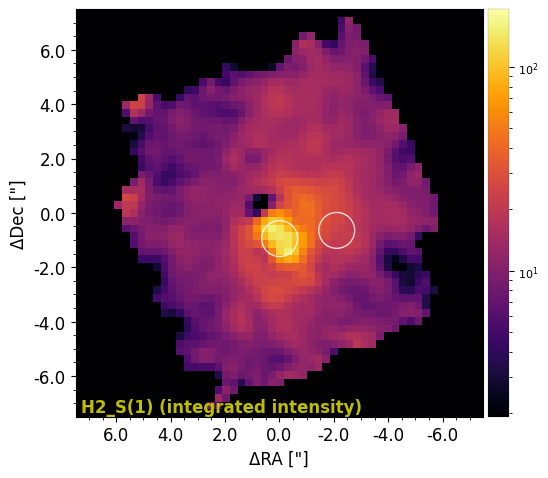

`Pixel scale set to 0.28284271668930366`


2025-02-25 10:01:46,339 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

2025-02-25 10:01:46,339 - stpipe - WARNING - /Users/valentin/anaconda3/envs/MINDS_env311/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)



In [155]:
if make_contsub_images:
    fluxes_blob = np.zeros(len(int_ch))
    fluxes_blob_neigh = np.zeros([len(int_ch), nch_line+nch_med])
    fluxes_err = np.zeros(len(int_ch))
    from vip_hci.var import frame_filter_lowpass, cube_filter_lowpass
    for ll, line in enumerate(test_lines):
        for ff, file in enumerate(calfiles):
            CC_cenfile = fits.open(file)
            cen_cube = CC_cenfile[1].data
            head = CC_cenfile[1].header
            plsc = np.sqrt((float(head['CDELT1'])*3600)**2+(float(head['CDELT2'])*3600)**2)
            pixar_sr = float(head['PIXAR_SR'])
            # make residual cubes using median of 
            sub_cube = cen_cube.copy()
            nch = cen_cube.shape[0]
            
            fwhm_med = np.median(all_contsub_fwhms[ll*nf+ff])
            nim = len(all_plot_contsub_imgs[ll*nf+ff])
            cx_line_med = np.median(all_cx_all_line[ll*nf+ff])
            cy_line_med = np.median(all_cy_all_line[ll*nf+ff])

            if feature_xy_as is not None:
                # update circle
                circle = ((cx_line_med, cy_line_med),
                          (cx_line_med-feature_xy_as[0]/plsc, cy_line_med+feature_xy_as[1]/plsc))
                circle_linestyle='-'
            else:
                circle=(cx_line_med, cy_line_med)
                circle_linestyle=(4, ('-', '--'))
            if nim>0 and test_labels[ll] in feature_lines:
                vmin = np.nanpercentile(all_plot_contsub_imgs[ll*nf+ff], 0.1)
                vmax = np.nanpercentile(all_plot_contsub_imgs[ll*nf+ff], 99.9)
                plot_frames(all_plot_contsub_imgs[ll*nf+ff], log=True, cmap='inferno', pxscale=plsc, label=all_labels[ll*nf+ff],
                            rows=nim//6+int(nim%6 != 0), # play with this param to change number of rows of panels for the figure
                            ang_scale=True, ang_ticksep=2./plsc, circle=circle, circle_color='w', 
                            circle_linestyle=circle_linestyle, circle_radius=fwhm_med,
                            label_color='y', vmin=vmin, vmax=vmax)
                plot_frames(all_plot_contsub_imgs[ll*nf+ff], log=True, cmap='inferno', pxscale=plsc, label=all_labels[ll*nf+ff],
                            rows=nim//6+int(nim%6 != 0), # play with this param to change number of rows of panels for the figure
                            ang_scale=True, ang_ticksep=2./plsc, circle=circle, circle_color='w', 
                            circle_linestyle=circle_linestyle, circle_radius=fwhm_med,
                            label_color='y', vmin=vmin, vmax=vmax, 
                            save=fig_dir+"Continuum_subtracted_{}_sky_aligned.pdf".format(test_labels[ll]))
                if int_ch is not None:  # also produce a collapsed map
                    index = feature_lines.index(test_labels[ll])
                    vmin = np.nanpercentile(np.sum(all_plot_contsub_imgs[ll*nf+ff][int_ch[index][0]:int_ch[index][1]], axis=0), 0.1)
                    vmax = np.nanpercentile(np.sum(all_plot_contsub_imgs[ll*nf+ff][int_ch[index][0]:int_ch[index][1]], axis=0), 99.9)
                    cub = np.array(all_plot_contsub_imgs[ll*nf+ff][int_ch[index][0]:int_ch[index][1]])
                    if smooth_im:
                        mask_nan = np.where(np.isnan(cub))
                        cub = cube_filter_lowpass(cub, fwhm_size=1.5)
                        cub[mask_nan] = np.nan
                    ima = np.nansum(cub, axis=0)
                    # estimate flux
                    if feature_xy_as is not None:
                        mask_blob = mask_circle(ima, radius=feature_r_as/plsc, fillwith=np.nan, mode='out',
                                                cy=circle[1][1], cx=circle[1][0], output="masked_arr")
                        fluxes_blob[index] = np.nansum(mask_blob)*pixar_sr*1e9
                        ## estimate uncertainty in other neighbouring maps
                        n_err_maps = nch_line+nch_med #nim-(int_ch[ll][1]-int_ch[ll][0])
                        err_tmp = []
                        for k in range(n_err_maps):
                            #fram_err = all_plot_contsub_imgs[ll*nf+ff][k]
                            fram_err = all_plot_cont_and_line_imgs[ll*nf+ff][k]
                            if smooth_im:
                                mask_nan = np.where(np.isnan(fram_err))
                                fram = frame_filter_lowpass(fram_err, fwhm_size=1.5)
                                fram[mask_nan] = np.nan
                            #ima_err = np.nansum(fram, axis=0)
                            mask_blob_err = mask_circle(fram, radius=feature_r_as/plsc, fillwith=np.nan, mode='out',
                                                        cy=circle[1][1], cx=circle[1][0], output="masked_arr")
                            fluxes_blob_neigh[index, k] = np.nansum(mask_blob_err)
                            ## just the ones used to estimate the uncertainty
                            if k < int_ch[index][0]+nch_med//2 or k >= int_ch[index][1]+nch_med//2:
                                err_tmp.append(np.nansum(mask_blob_err)*pixar_sr*1e9)
                        fluxes_err[index] = np.nanstd(err_tmp)
                    plot_frames(ima,
                                log=True, cmap='inferno', pxscale=plsc, label=test_labels[ll]+' (integrated intensity)',
                                rows=nim//6+int(nim%6 != 0), # play with this param to change number of rows of panels for the figure
                                ang_scale=True, ang_ticksep=2./plsc, circle=circle, circle_color='w', 
                                circle_linestyle=circle_linestyle, circle_radius=fwhm_med,
                                label_color='y', vmin=vmin, vmax=vmax)
                    plot_frames(ima,
                                log=True, cmap='inferno', pxscale=plsc, label=test_labels[ll]+' (integrated intensity)',
                                rows=nim//6+int(nim%6 != 0), # play with this param to change number of rows of panels for the figure
                                ang_scale=True, ang_ticksep=2./plsc, circle=circle, circle_color='w', 
                                circle_linestyle=circle_linestyle, circle_radius=fwhm_med,
                                label_color='y', vmin=vmin, vmax=vmax, 
                                save=fig_dir+"Continuum_subtracted_{}_sky_aligned_M0.pdf".format(test_labels[ll]))
            CC_cenfile.close()

In [156]:
plt.close()

If there is a blob, plot the flux vs wavelength, after unit conversion:

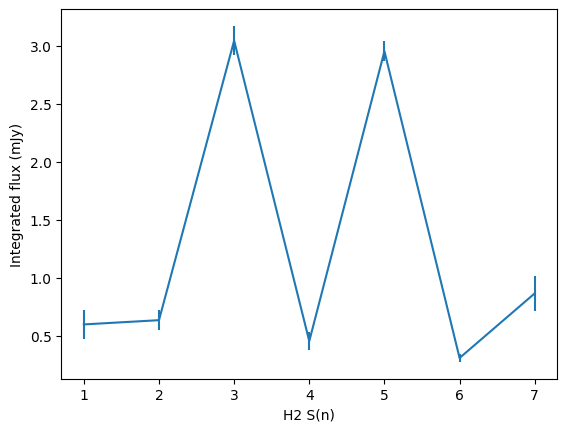

In [157]:
if feature_xy_as is not None:
    plt.errorbar(np.arange(1, len(fluxes_blob)+1), fluxes_blob, fluxes_err)
    plt.xlabel("H2 S(n)")
    plt.ylabel("Integrated flux (mJy)")
    plt.show()

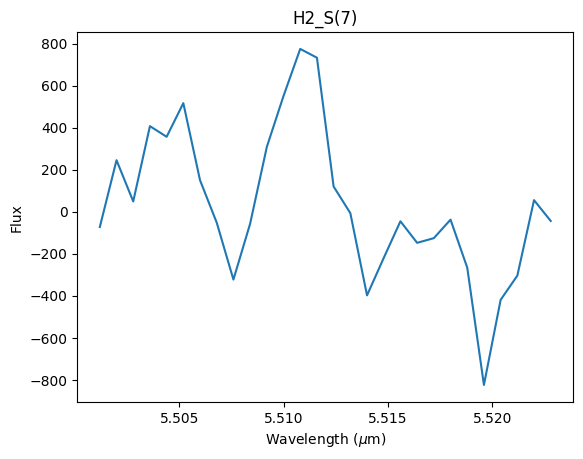

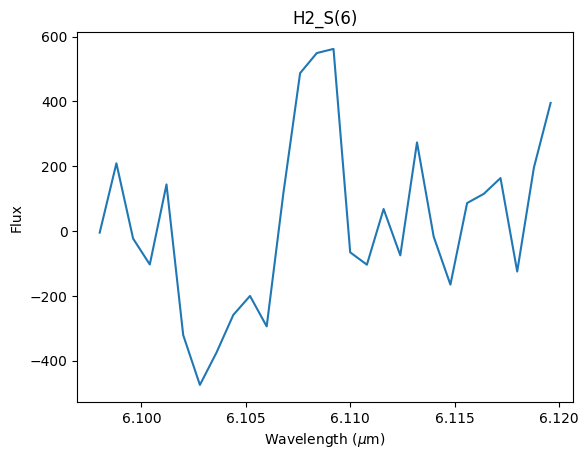

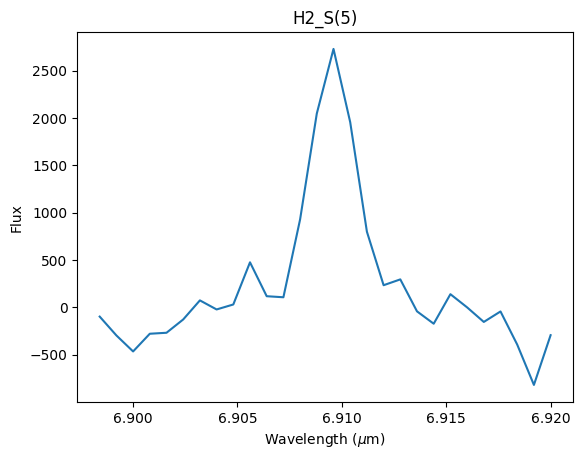

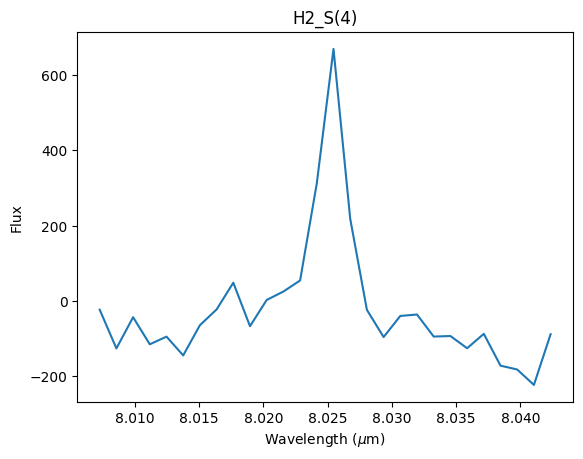

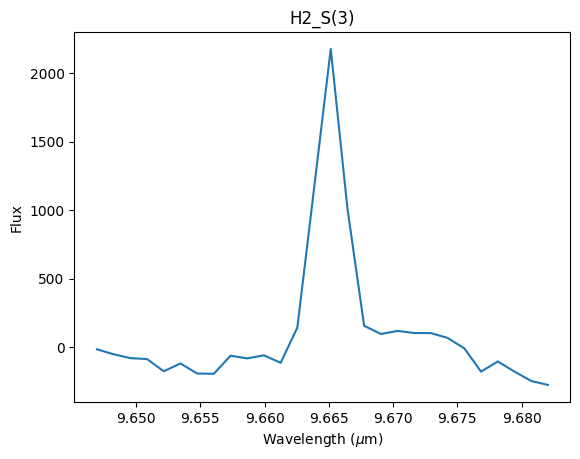

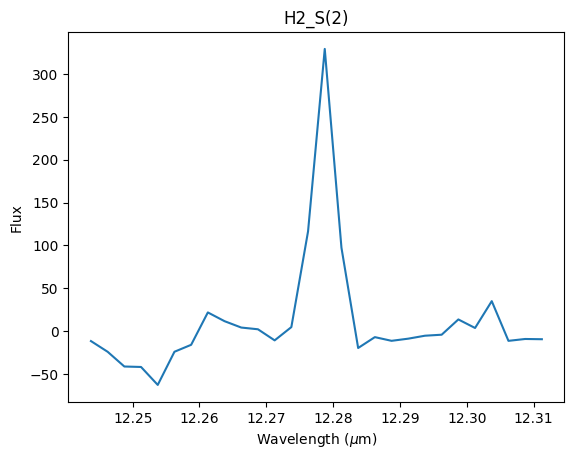

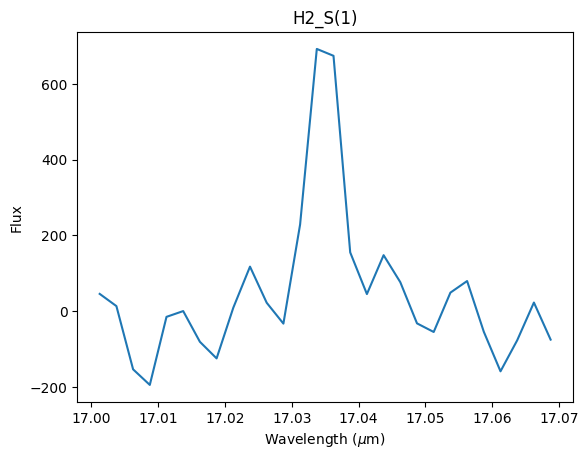

In [158]:
if feature_xy_as is not None:
    for ll, line in enumerate(test_lines):
        if test_labels[ll] in feature_lines:
            for ff, file in enumerate(calfiles):
                nim = len(all_plot_contsub_imgs[ll*nf+ff])
                index = feature_lines.index(test_labels[ll])
                if nim>0:
                    #plt.bar(all_wls_contlines[ll*nf+ff], fluxes_blob_neigh[ll], width=0.01)
                    plt.plot(all_wls_contlines[ll*nf+ff], fluxes_blob_neigh[index])
                    plt.xlabel(r"Wavelength ($\mu$m)")
                    plt.ylabel("Flux")
                    plt.title(test_labels[ll])
                    plt.savefig(fig_dir+"Line_profile_{}{}.pdf".format(test_labels[ll], feature_label))
                    plt.show()
                    spectrum = pd.DataFrame({'wavelength': all_wls_contlines[ll*nf+ff], 'flux_mJy': fluxes_blob_neigh[index]})
                    spectrum.to_csv(fig_dir+"Line_profile_{}{}.csv".format(test_labels[ll], feature_label), mode='w')

<hr style="border:1px solid gray"> </hr>

# <img style="float: center;" src="https://www.stsci.edu/~dlaw/stsci_logo.png" alt="stsci_logo" width="200px"/> 